# let's see the results if we run 100x with all the landmarks!

In [38]:
import cv2, os 
import numpy as np 
import warnings
warnings.filterwarnings('ignore')

In [39]:
import mediapipe as mp 
from PIL import Image as im 
import mediapipe as mp


def hand_locations(frame, min_detection_confidence = 0.5, min_tracking_confidence = 0.5): 
    hands = mp.solutions.hands.Hands(min_detection_confidence=min_detection_confidence, min_tracking_confidence=min_tracking_confidence) # MAKE SURE THIS IS ALL GOOD 
    results = hands.process(frame.astype('uint8'))
    X_locations = [0] * 42 # use 0 as default if the class is not there 
    Y_locations = [0] * 42 
    Z_locations = [0] * 42
    x = y = z = 0 
    if results.multi_hand_landmarks:
        for hand, hand_landmark in enumerate(results.multi_hand_landmarks):
            for i in range(0, 21):
                landmark = hand_landmark.landmark[i]
                X_locations[x] = landmark.x
                Y_locations[y] = landmark.y
                Z_locations[z] = landmark.z
                x += 1; y += 1; z += 1; 
    locations = np.concatenate([X_locations, Y_locations, Z_locations])
    hands.close()
    return locations 

In [40]:
#https://stackoverflow.com/questions/41908379/keras-plot-training-validation-and-test-set-accuracy
import matplotlib.pyplot as plt 
def plot(history, show_pr = False, num = None): 
    
    if num: 
        plt.plot(history.history['accuracy'], label = "train_acc")
        plt.plot(history.history['val_accuracy'], label = "val_acc")
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        plt.plot(history.history['loss'], label = "train_loss")
        plt.plot(history.history['val_loss'], label = "val_loss")
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        if show_pr: 
            plt.plot(history.history[f'precision_{num}'], label = "train_precision")
            plt.plot(history.history[f'val_precision_{num}'], label = "val_precision")
            plt.title('model precision')
            plt.ylabel('precision')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()

            plt.plot(history.history[f'recall_{num}'], label = "train_recall")
            plt.plot(history.history[f'val_recall_{num}'], label = "val_recall")
            plt.title('model recall')
            plt.ylabel('recall')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()
    else: 
        plt.plot(history.history['accuracy'], label = "train_acc")
        plt.plot(history.history['val_accuracy'], label = "val_acc")
        plt.title('model accuracy')
        plt.ylabel('accuracy')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        plt.plot(history.history['loss'], label = "train_loss")
        plt.plot(history.history['val_loss'], label = "val_loss")
        plt.title('model loss')
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend()
        plt.show()

        if show_pr: 
            plt.plot(history.history[f'precision'], label = "train_precision")
            plt.plot(history.history[f'val_precision'], label = "val_precision")
            plt.title('model precision')
            plt.ylabel('precision')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()

            plt.plot(history.history[f'recall'], label = "train_recall")
            plt.plot(history.history[f'val_recall'], label = "val_recall")
            plt.title('model recall')
            plt.ylabel('recall')
            plt.xlabel('epoch')
            plt.legend()
            plt.show()
    # let's see whether it can detect me not doing anything 

# we can create a padding function in order to pad 
def pad(locations, maxlen = 90, padding = "post", truncating = "post"): 
    new_locations = np.array(locations).tolist() 
    empty_row = np.zeros((1, 126))
    for i, video in tqdm(enumerate(new_locations)): 
        if len(video) < maxlen:  
            for new_row in range(maxlen - len(video)): 
                if padding == "post": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([new_locations[i], empty_row])
                if padding == "pre": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([empty_row, new_locations[i]])

        if len(video) > maxlen: 
            if truncating == "post": 
                new_locations[i] = new_locations[i][:maxlen]
            elif truncating == "pre": 
                new_locations[i] = new_locations[i][len(video) - maxlen : ]
    return np.array(new_locations)
    
def predict_on_video(model, path): 
    LOCATIONS = []
    cap = cv2.VideoCapture(path)
    while cap.isOpened():
        _, frame = cap.read()
        if not _: break 

        LOCATIONS.append(hand_locations(frame))
    LOCATIONS = pad(np.array([LOCATIONS]),maxlen=90)
    return model.predict(LOCATIONS)


In [41]:
import random 
import tensorflow as tf 
tf.config.run_functions_eagerly(True)

def _shift(X):
        
        X = tf.Variable(X, dtype = tf.float32)
        
        X_locations = X[:, :42] 
        Y_locations = X[:, 42:84] 
        Z_locations = X[:, 84:]
        
        mask = tf.not_equal(Y_locations, 0) 
        nonzero_Y_locations = tf.boolean_mask(Y_locations, mask) # contains all nonzero elements of Y_locations 
    
        maximum = tf.math.reduce_max(nonzero_Y_locations)
        minimum = tf.math.reduce_min(nonzero_Y_locations)

        can_move_up = 1 - maximum 
        can_move_down = minimum 
        mask = tf.cast(mask, tf.float32)
    
        if tf.random.uniform((1,)) > 0.5: 
            move_up = tf.random.uniform((1,), 0, can_move_up)
            X[:, 42:84].assign(X[:, 42:84] + mask * tf.ones_like(X[:, 42:84]) * move_up)
        else: 

            move_down = tf.random.uniform((1,), 0, can_move_down)
            X[:, 42:84].assign(X[:, 42:84] - mask * tf.ones_like(X[:, 42:84]) * move_down)

        mask = tf.not_equal(X_locations, 0) 
        nonzero_X_locations = tf.boolean_mask(X_locations, mask) 

        maximum = tf.math.reduce_max(nonzero_X_locations)
        minimum = tf.math.reduce_min(nonzero_X_locations)
            
        can_move_right = 1- maximum
        can_move_left = minimum 
        mask = tf.cast(mask, tf.float32)

        if tf.random.uniform((1,)) > 0.5: 
            # move right
            move_right = tf.random.uniform((1,), 0, can_move_right)
            X[:, :42].assign(X[:, :42] + mask * tf.ones_like(X[:, :42]) * move_right)

        else: 
            # move left 
            move_left = tf.random.uniform((1,), 0, can_move_left)
            X[:, :42].assign(X[:, :42] - mask * tf.ones_like(X[:, :42]) * move_left)

        mask = tf.not_equal(Z_locations, 0) 
        nonzero_Z_locations = tf.boolean_mask(Z_locations, mask)

        maximum = tf.math.reduce_max(nonzero_Z_locations)
        minimum = tf.math.reduce_min(nonzero_Z_locations)
        mask = tf.cast(mask, tf.float32)

        can_move_far = 1 - maximum 
        can_move_close = minimum 

        if tf.random.uniform((1,)) > 0.5: 
            # move far
            move_far = tf.random.uniform((1,), 0, can_move_far)
            X[:, 84:].assign(X[:, 84:] + mask * tf.ones_like(X[:, 84:]) * move_far)
        else: 
            # move close 
            move_close = tf.random.uniform((1,), 0, can_move_close)
            X[:, 84:].assign(X[:, 84:] - mask * tf.ones_like(X[:, 84:]) * move_close)

        return X



class Augmenter(tf.keras.layers.Layer): 
    def __init__(self): 
        super().__init__()
        self.trainable = False 
        self._trainable_weights = [] 
        self._non_trainable_weights = []
        
    def call(self, X, training = True):
        if training: 
            X =  tf.map_fn(_shift, X)
            return X
        else: 
            return X 

class TTAugmenter(tf.keras.layers.Layer): 
    def __init__(self): 
        super().__init__()
        self.trainable = False 
        self._trainable_weights = [] 
        self._non_trainable_weights = []
        
    def call(self, X):
        return tf.map_fn(_shift, X)
        
        

In [42]:
def pad(locations, maxlen = 90, padding = "post", truncating = "post"): 
    new_locations = locations.tolist() 
    empty_row = np.zeros((1, 126))
    for i, video in tqdm(enumerate(new_locations)): 
        if len(video) < maxlen:  
            for new_row in range(maxlen - len(video)): 
                if padding == "post": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([new_locations[i], empty_row])
                if padding == "pre": 
                    new_locations[i] = np.array(new_locations[i])
                    new_locations[i] = np.concatenate([empty_row, new_locations[i]])

        if len(video) > maxlen: 
            if truncating == "post": 
                new_locations[i] = new_locations[i][:maxlen]
            elif truncating == "pre": 
                new_locations[i] = new_locations[i][len(video) - maxlen : ]
    return np.array(new_locations)

In [43]:
from scipy import interpolate
def adjust(frame_matrix): 
    assert len(frame_matrix.shape) == 2
    rows, columns = frame_matrix.shape
    for column in range(columns): 
        loc_dimension = frame_matrix[column]
        x = np.arange(0, rows, 1)
        idx = np.nonzero(loc_dimension)
        if len(idx) == 1: 
            continue 
        interp_func = interpolate.interp1d(x[idx], loc_dimension[idx], kind='cubic', fill_value = "extrapolate")
        frame_matrix[:, column] = interp_func(x) 
    return frame_matrix

def interp_X(X): 
    temp_X = np.concatenate([X_i for X_i in X])
    temp_X =  np.array([adjust(temp_X_i) for temp_X_i in temp_X])
    print(temp_X.shape)
    return temp_X.reshape(X.shape)

In [44]:
def plot_roc_auroc(base_fpr, TPRs, FPRs, aurocs): 
    

    for i, (tpr, fpr) in enumerate(zip(TPRs, FPRs)): 
        plt.plot(base_fpr, tpr, label = f"fold {i + 1}")

    mean_tpr = np.mean(TPRs, axis=0)
    plt.plot(base_fpr, mean_tpr, label = "average of folds")
    
    std_tpr = np.std(TPRs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    plt.fill_between(base_fpr, tprs_lower, tprs_upper, color='grey', alpha=.3,
                 label=r'$\pm$ 1 std. dev.')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--', label = "chance")
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve across folds')
    plt.legend(loc="lower right")
    plt.show()

    # plot the auroc curves 
    mean_auroc = sum(aurocs) / len(aurocs)
    descriptions = [f"fold {i + 1}" for i in range(len(aurocs))] + ["average fold"]
    aurocs.append(mean_auroc)
    plt.bar(descriptions, aurocs, color = "green")
    plt.xlabel("Fold")
    plt.ylabel("Area Under Curve")
    plt.title("Area Under ROC Curve across folds")
    plt.show() 

    return mean_tpr, mean_auroc

def plot_meta_roc_auroc(average_aurocs, average_tprs, base_fpr): 
    meta_avg_tpr = np.mean(average_tprs, axis = 0) 
    meta_avg_auroc = sum(average_aurocs) / len(average_aurocs)
    
    for i, average_tpr in enumerate(average_tprs): 
        plt.plot(base_fpr, average_tpr, label = f"run {i + 1}")
    
    plt.plot(base_fpr, meta_avg_tpr, label = "average of runs")
    
    std_tpr = np.std(average_tprs, axis=0)
    tprs_upper = np.minimum(meta_avg_tpr + std_tpr, 1)
    tprs_lower = np.maximum(meta_avg_tpr - std_tpr, 0)
    plt.fill_between(base_fpr, tprs_lower, tprs_upper, color='grey', alpha=.3, label=r'$\pm$ 1 std. dev.')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--', label = "chance")
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Average ROC Curve across Runs (No Aug)')
    plt.legend(loc="lower right")
    plt.show()

    descriptions = [f"{i + 1}" for i in range(len(average_aurocs))] + ["avg"]
    average_aurocs.append(meta_avg_auroc)
    plt.bar(descriptions, average_aurocs, color = "green")
    plt.xlabel("Run Number")
    plt.ylabel("Area Under Curve")
    plt.title("Area Under ROC Curve across Runs (No Aug)")
    plt.show()

In [45]:
from glob import glob
from tqdm import tqdm 
from scipy import interp
import tensorflow_addons as tfa
from sklearn.metrics import roc_curve, roc_auc_score
AVERAGE_TPRS, AVERAGE_AUROCS = [], []
META_RESULT_MATRIX = [] 
def cross_validate(make_model, epochs = 50, callbacks=[]):
    """adds the training & validation accuracy, precision, recall, and F1 for each of the folds to a meta matrix"""
    model = make_model()

    base_fpr = np.linspace(0, 1, 101)
    FPRS, TPRS, AUROCS = [], [], []
    for i in range(5): 
        # for each fold change up the dataset 
        model = make_model()

        ARMFLAPPING_TRAINING_FRAMES = np.concatenate([fold for j, fold in enumerate(ARMFLAPPING_FRAMES_SPLIT) if j != i])
        CONTROL_TRAINING_FRAMES = np.concatenate([fold for j, fold in enumerate(CONTROL_FRAMES_SPLIT) if j != i])

        ARMFLAPPING_VALIDATION_FRAMES = ARMFLAPPING_FRAMES_SPLIT[i]
        CONTROL_VALIDATION_FRAMES = CONTROL_FRAMES_SPLIT[i]

        print(ARMFLAPPING_TRAINING_FRAMES.shape, CONTROL_TRAINING_FRAMES.shape)
        print(ARMFLAPPING_VALIDATION_FRAMES.shape, CONTROL_VALIDATION_FRAMES.shape)
        
        X_test = np.concatenate([ARMFLAPPING_VALIDATION_FRAMES, CONTROL_VALIDATION_FRAMES])
        X_train = np.concatenate([ARMFLAPPING_TRAINING_FRAMES, CONTROL_TRAINING_FRAMES])
        
        y_train = np.concatenate([np.ones(len(ARMFLAPPING_TRAINING_FRAMES)), np.zeros(len(CONTROL_TRAINING_FRAMES))])
        y_test = np.concatenate([np.ones(len(ARMFLAPPING_VALIDATION_FRAMES)), np.zeros(len(CONTROL_VALIDATION_FRAMES))])

        try:
            os.remove("best.h5") 
        except Exception as e: 
            pass 
        
        # train 
        history = model.fit(X_train, y_train, validation_data = (X_test, y_test), epochs = epochs, callbacks = callbacks)
        
        try: 
            model.load_weights("best.h5")
        except Exception as e: 
            pass 

        # evaluate again 
        model.evaluate(X_test, y_test)
        
        # plot accuracy and loss 
        plot(history)

        # get this information  
        y_pred = model.predict(X_test).flatten()
        fpr, tpr, _ = roc_curve(y_test, y_pred) 
        FPRS.append(fpr)
        tpr = interp(base_fpr, fpr, tpr)
        tpr[0] = 0.0 
        TPRS.append(tpr)
        AUROCS.append(roc_auc_score(y_test, y_pred))


        # accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6086 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0

        training_accuracy = history.history['accuracy'][-1]
        validation_accuracy = history.history['val_accuracy'][-1]
        training_precision = history.history['precision'][-1]
        validation_precision = history.history['val_precision'][-1]
        training_recall = history.history['recall'][-1]
        validation_recall = history.history['val_recall'][-1]
        training_f1 = 2 * training_precision * training_recall / (training_precision + training_recall)
        validation_f1 = 2 * validation_precision * validation_recall / (validation_precision + validation_recall)

        # add to meta matrix
        META_RESULT_MATRIX.append([training_accuracy, training_precision, training_recall, training_f1, validation_accuracy, validation_precision, validation_recall, validation_f1])

        # evaluate on our own custom videos
        for file in glob("*.mov"):
            print(f"prediction for video {file} is {predict_on_video(model, file)}")

    mean_tpr, mean_auroc = plot_roc_auroc(base_fpr, TPRS, FPRS, AUROCS) 
    AVERAGE_TPRS.append(mean_tpr) 
    AVERAGE_AUROCS.append(mean_auroc)

In [46]:
# don't shuffle  

import random 
def shuffle(X, y, seed = None):
    if seed == None:  
        seed = random.randrange(0, 100)
        print(f"using seed {seed}")
    np.random.seed(seed) 
    new_X = np.concatenate([X_i for X_i in X])
    new_y = np.concatenate([y_i for y_i in y])
    N = np.random.permutation(new_X.shape[0])
    new_X = new_X[N]
    new_y = new_y[N]
    new_X = new_X.reshape(5, 20, 90, 36)
    new_y = new_y.reshape(5, 20)
    return new_X, new_y


In [47]:
def f1(y_true, y_pred):
    y_pred = tf.round(y_pred)
    tp = tf.math.reduce_sum(tf.cast(y_true*y_pred, 'float'), axis=0)
    tn = tf.math.reduce_sum(tf.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = tf.math.reduce_sum(tf.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = tf.math.reduce_sum(tf.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + tf.keras.backend.epsilon())
    r = tp / (tp + fn + tf.keras.backend.epsilon())

    f1 = 2*p*r / (p+r+tf.epsilon())
    f1 = tf.where(tf.math.is_nan(f1), tf.zeros_like(f1), f1)
    return tf.mean(f1)

def f1_loss(y_true, y_pred):
    
    tp = tf.math.reduce_sum(tf.cast(y_true*y_pred, 'float'), axis=0)
    tn = tf.math.reduce_sum(tf.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
    fp = tf.math.reduce_sum(tf.cast((1-y_true)*y_pred, 'float'), axis=0)
    fn = tf.math.reduce_sum(tf.cast(y_true*(1-y_pred), 'float'), axis=0)

    p = tp / (tp + fp + tf.keras.backend.epsilon())
    r = tp / (tp + fn + tf.keras.backend.epsilon())

    f1 = 2*p*r / (p+r+tf.keras.backend.epsilon())
    f1 = tf.where(tf.math.is_nan(f1), tf.zeros_like(f1), f1)
    return 1 - tf.math.reduce_mean(f1)

In [48]:
def make_model(): 
    model = tf.keras.models.Sequential([
        #Augmenter(), 
        tf.keras.layers.LSTM(64, return_sequences=False, input_shape = (None, 126)), 
        tf.keras.layers.Dropout(0.3), 
        tf.keras.layers.Dense(1, activation = 'sigmoid') 
    ]) 

    model.compile(loss = tf.keras.losses.BinaryCrossentropy(), optimizer = tf.keras.optimizers.Adam(learning_rate=0.01), metrics = ['accuracy', tf.keras.metrics.Precision(name="precision"), tf.keras.metrics.Recall(name="recall")])

    return model

In [49]:
import pickle 
with open("all_point_folds_seeds", 'rb') as f: 
    information = pickle.load(f)

ARMFLAPPING_FRAMES, ARMFLAPPING_FILE_NAMES, CONTROL_FRAMES, CONTROL_FILE_NAMES = [np.concatenate(info) for info in information]

assert ARMFLAPPING_FILE_NAMES.shape == CONTROL_FILE_NAMES.shape
assert ARMFLAPPING_FRAMES.shape == CONTROL_FRAMES.shape

In [50]:
WRITE_DATA = False
if WRITE_DATA: 
    SEEDS = np.abs(np.array(np.random.randn(100) * 100, dtype = np.int32))
    FILES_FOR_FOLD = []
    for seed in SEEDS:
        np.random.seed(seed) # set seed 
        
        N = np.random.permutation(ARMFLAPPING_FRAMES.shape[0])
        ARMFLAPPING_FILE_NAMES = ARMFLAPPING_FILE_NAMES[N]
        CONTROL_FILE_NAMES = CONTROL_FILE_NAMES[N]

        armflapping_file_name_folds =  np.array_split(ARMFLAPPING_FILE_NAMES, 5)
        control_file_name_folds =  np.array_split(CONTROL_FILE_NAMES, 5)

        for i in range(5):
            # the ith fold is for validation, everything else is for whatever 

            armflapping_training_files = np.concatenate([fold for j, fold in enumerate(armflapping_file_name_folds) if j != i])
            control_training_files = np.concatenate([fold for j, fold in enumerate(control_file_name_folds) if j != i])

            armflapping_validation_files = armflapping_file_name_folds[i]
            control_validation_files = control_file_name_folds[i]

            FILES_FOR_FOLD.append({"train": np.concatenate([armflapping_training_files, control_training_files]).tolist(), "test": np.concatenate([armflapping_validation_files, control_validation_files]).tolist()})
    # save this and the seeds used in a pickle file 

    with open("file_names_folds.pkl", 'wb') as f: 
        pickle.dump((SEEDS.tolist(), FILES_FOR_FOLD), f)

In [51]:
if not WRITE_DATA: 
    with open("file_names_folds.pkl", 'rb') as f: 
        SEEDS, _ = pickle.load(f)

# okay so this is the same thing but for the all landmarks approach

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 171ms/step - loss: 0.8694 - accuracy: 0.3250 - precision: 0.3654 - recall: 0.4750 - val_loss: 0.6675 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6740 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.7114 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6454 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.7076 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6045 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6790 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 157

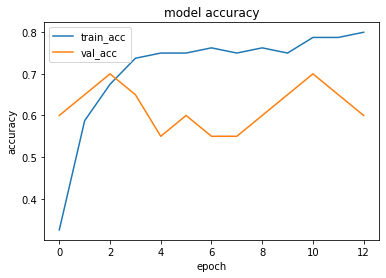

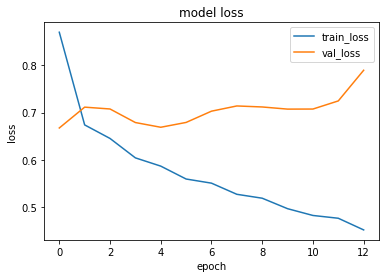

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.5152816]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.41971162]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.557833]]


1it [00:00, 16710.37it/s]


prediction for video control_1.mov is [[0.48218578]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.46042567]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.45484552]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7438 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.8584 - val_accuracy: 0.4000 - val_precision: 0.4167 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6218 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.7632 - val_accuracy: 0.4000 - val_precision: 0.4167 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 161ms/step - loss: 0.5995 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.7789 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 333ms/step - loss: 0.5687 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.7993 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

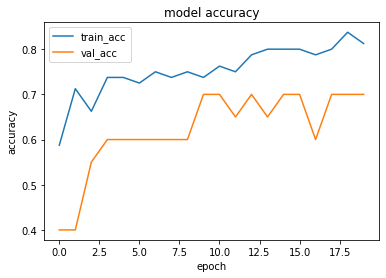

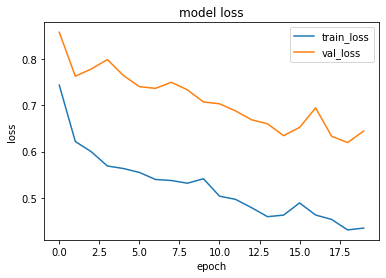

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.57412434]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.29297853]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.6654669]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.15727946]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.15637732]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.15608999]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7169 - accuracy: 0.4750 - precision: 0.4643 - recall: 0.3250 - val_loss: 0.5755 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6302 - accuracy: 0.5875 - precision: 0.5574 - recall: 0.8500 - val_loss: 0.5672 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6083 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5153 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5740 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5255 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

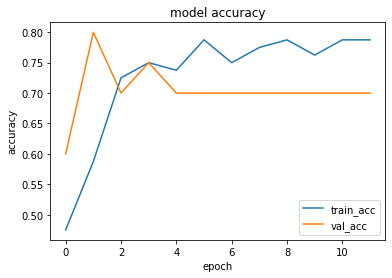

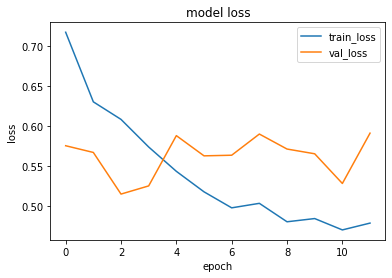

1it [00:00, 19239.93it/s]


prediction for video armflapping_1.mov is [[0.5595961]]


1it [00:00, 22795.13it/s]


prediction for video armflapping_3.mov is [[0.5655124]]


1it [00:00, 7767.23it/s]


prediction for video armflapping_2.mov is [[0.62317574]]


1it [00:00, 22192.08it/s]


prediction for video control_1.mov is [[0.5187434]]


1it [00:00, 11491.24it/s]


prediction for video control_2.mov is [[0.49127325]]


1it [00:00, 12671.61it/s]


prediction for video control_3.mov is [[0.48543063]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7384 - accuracy: 0.4125 - precision: 0.4314 - recall: 0.5500 - val_loss: 0.6947 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6393 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.6669 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6021 - accuracy: 0.7500 - precision: 0.6923 - recall: 0.9000 - val_loss: 0.6669 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5482 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.6553 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

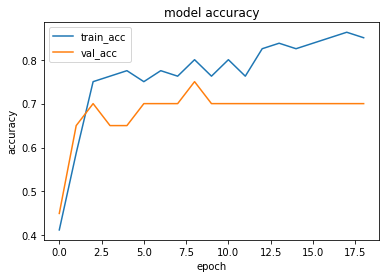

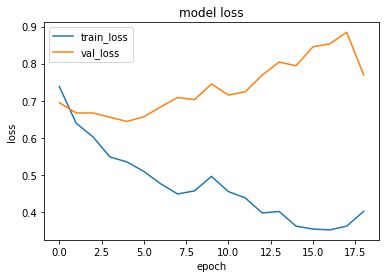

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.7770982]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.60861087]]


1it [00:00, 15768.06it/s]


prediction for video armflapping_2.mov is [[0.85569084]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.52461743]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.37860817]]


1it [00:00, 12945.38it/s]


prediction for video control_3.mov is [[0.23287883]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6904 - accuracy: 0.4500 - precision: 0.4231 - recall: 0.2750 - val_loss: 0.6772 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.7511 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.5828 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6185 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.6313 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6518 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.5683 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

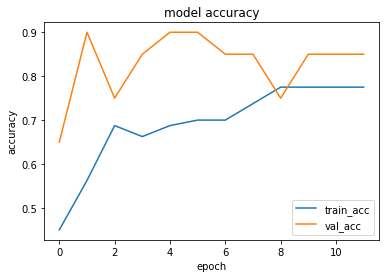

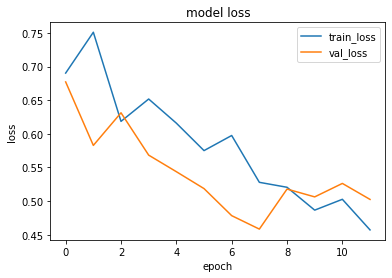

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5622551]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.45401323]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.5985177]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.5083963]]


1it [00:00, 13443.28it/s]


prediction for video control_2.mov is [[0.45501527]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.4662123]]


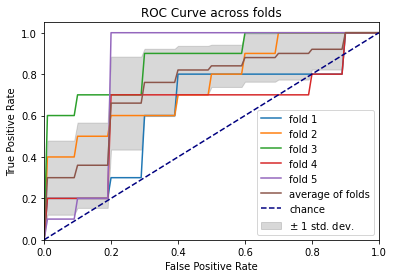

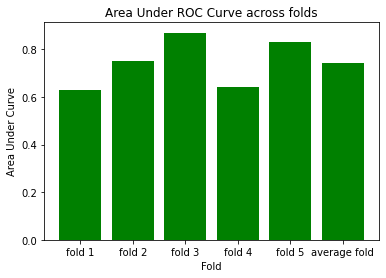

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.8121 - accuracy: 0.4250 - precision: 0.3636 - recall: 0.2000 - val_loss: 0.6750 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6088 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.7088 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 125ms/step - loss: 0.5673 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.7312 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 1s 134ms/step - loss: 0.5135 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.7649 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 126

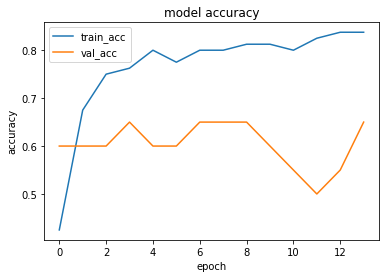

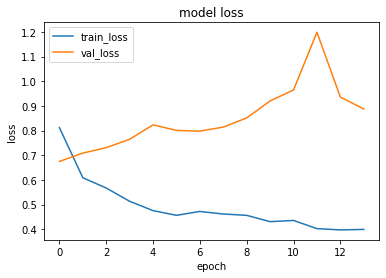

1it [00:00, 16710.37it/s]


prediction for video armflapping_1.mov is [[0.4570031]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.6148294]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.73444426]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.1870172]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.15508243]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.14879313]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7234 - accuracy: 0.5500 - precision: 0.5556 - recall: 0.5000 - val_loss: 0.7082 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6946 - accuracy: 0.5125 - precision: 0.5067 - recall: 0.9500 - val_loss: 0.5830 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6240 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.5602 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6327 - accuracy: 0.6625 - precision: 0.7097 - recall: 0.5500 - val_loss: 0.5373 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

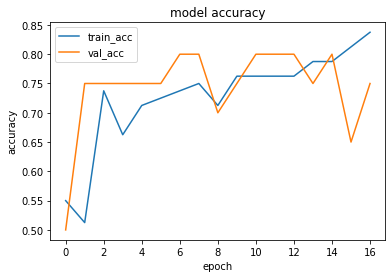

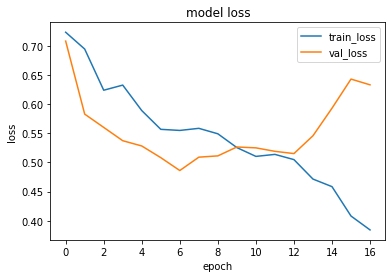

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.6112111]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.52669615]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_2.mov is [[0.75939685]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.36874858]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.2381168]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.21346104]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7551 - accuracy: 0.5250 - precision: 0.5294 - recall: 0.4500 - val_loss: 0.6860 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6501 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6702 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6161 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6537 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5498 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6886 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

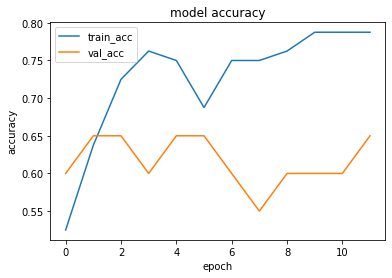

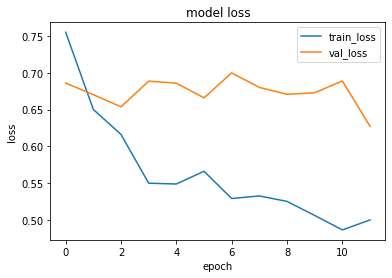

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.54755646]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.27036625]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.6740999]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.37680417]]


1it [00:00, 14217.98it/s]


prediction for video control_2.mov is [[0.21600008]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.2472958]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7288 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6481 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6461 - accuracy: 0.6250 - precision: 0.6786 - recall: 0.4750 - val_loss: 0.6525 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5971 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6155 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5877 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6117 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoc

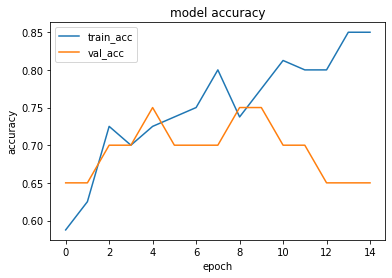

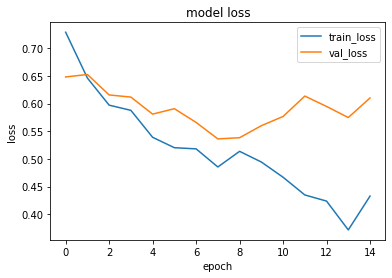

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.7378481]]


1it [00:00, 12945.38it/s]


prediction for video armflapping_3.mov is [[0.59025687]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.894626]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.6593108]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.20007315]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.24776822]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 134ms/step - loss: 0.7136 - accuracy: 0.4375 - precision: 0.4528 - recall: 0.6000 - val_loss: 0.7366 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.7342 - accuracy: 0.5750 - precision: 0.8750 - recall: 0.1750 - val_loss: 0.6011 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5995 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5489 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6196 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.5126 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.

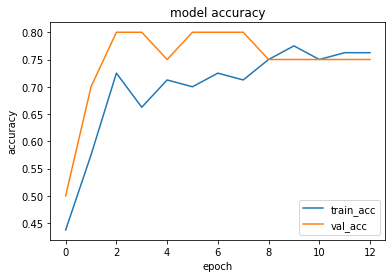

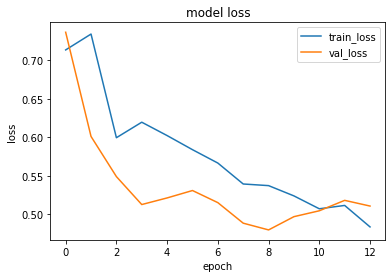

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.3868717]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.41660604]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.67383504]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.33294284]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.32710224]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.3275823]]


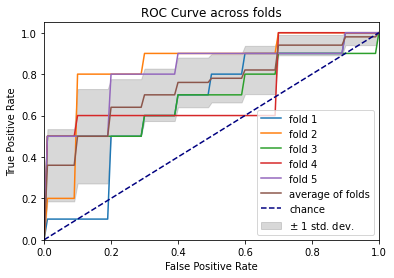

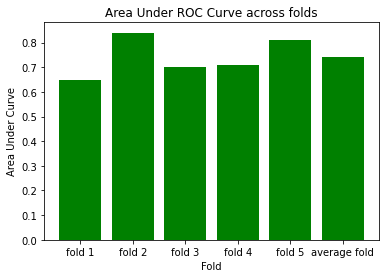

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6545 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.6406 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6231 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.6243 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5799 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.7282 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5773 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.7165 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 154

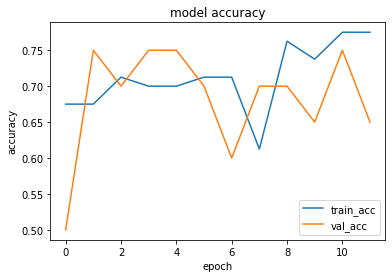

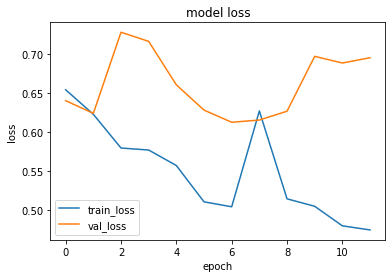

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.5150877]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.58124584]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.62772834]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.42418775]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.38686067]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.3781057]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 192ms/step - loss: 0.6599 - accuracy: 0.4750 - precision: 0.4808 - recall: 0.6250 - val_loss: 0.6019 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 179ms/step - loss: 0.7005 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6169 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 1s 171ms/step - loss: 0.6258 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6122 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 165ms/step - loss: 0.5607 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5509 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoc

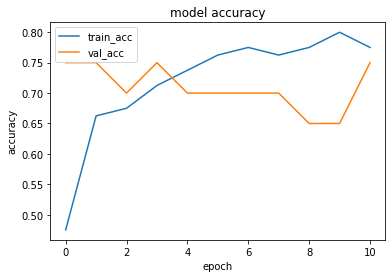

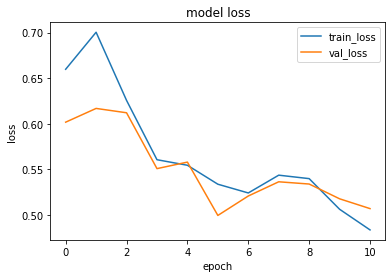

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.36965063]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.5387505]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.70249623]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.26140428]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.23642337]]


1it [00:00, 21183.35it/s]


prediction for video control_3.mov is [[0.23373556]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6777 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.6218 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6386 - accuracy: 0.6375 - precision: 0.6222 - recall: 0.7000 - val_loss: 0.5460 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5887 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5641 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5875 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5141 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

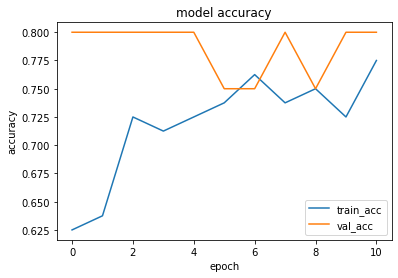

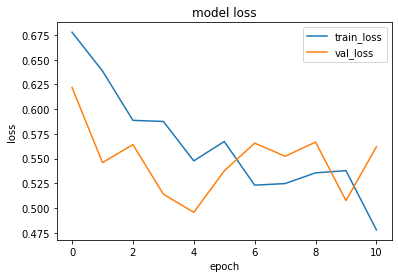

1it [00:00, 21732.15it/s]


prediction for video armflapping_1.mov is [[0.5230218]]


1it [00:00, 12826.62it/s]


prediction for video armflapping_3.mov is [[0.4667389]]


1it [00:00, 21620.12it/s]


prediction for video armflapping_2.mov is [[0.54408973]]


1it [00:00, 20460.02it/s]


prediction for video control_1.mov is [[0.4789357]]


1it [00:00, 20867.18it/s]


prediction for video control_2.mov is [[0.45849976]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.45123312]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7621 - accuracy: 0.4250 - precision: 0.4211 - recall: 0.4000 - val_loss: 0.6650 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6459 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.6408 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6073 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6326 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 195ms/step - loss: 0.5467 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6277 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

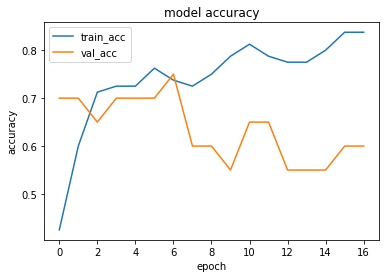

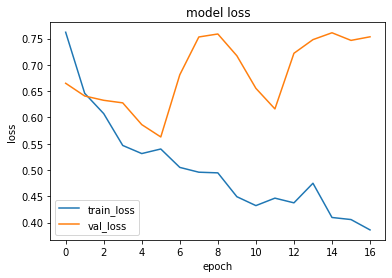

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.61696196]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.7435069]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.92878795]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.24804696]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.2860586]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.28613105]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6761 - accuracy: 0.5500 - precision: 0.5303 - recall: 0.8750 - val_loss: 0.7317 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6838 - accuracy: 0.6125 - precision: 0.9091 - recall: 0.2500 - val_loss: 0.6433 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5879 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.7040 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6388 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.7319 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.

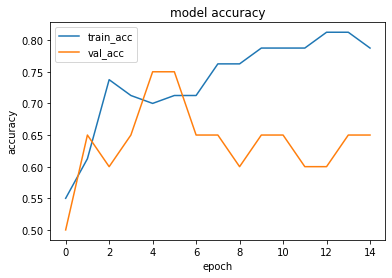

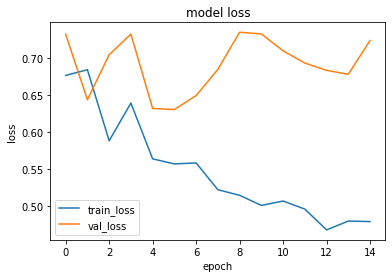

1it [00:00, 18477.11it/s]


prediction for video armflapping_1.mov is [[0.24929672]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.49894476]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_2.mov is [[0.8491007]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.1449078]]


1it [00:00, 18641.35it/s]


prediction for video control_2.mov is [[0.13858166]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.13855106]]


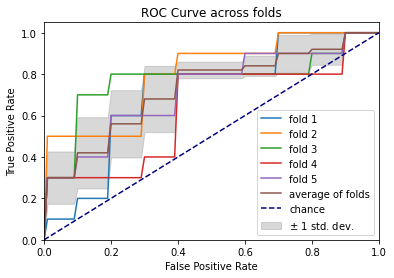

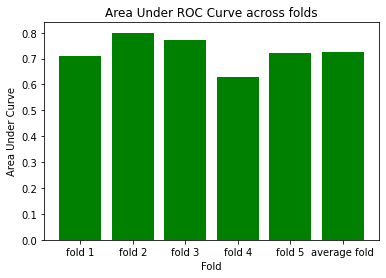

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6820 - accuracy: 0.5625 - precision: 0.5455 - recall: 0.7500 - val_loss: 0.7562 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6140 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.7224 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5867 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6115 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5607 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.5681 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 135

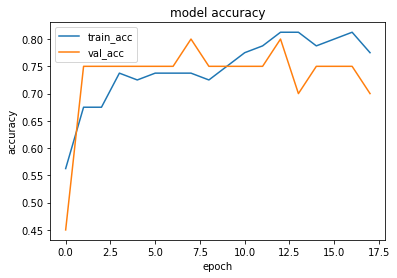

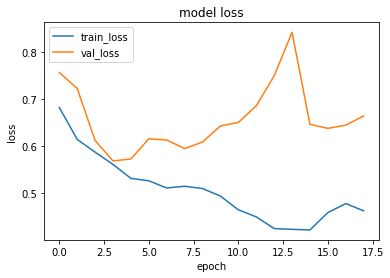

1it [00:00, 17848.10it/s]


prediction for video armflapping_1.mov is [[0.45373034]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.283836]]


1it [00:00, 21183.35it/s]


prediction for video armflapping_2.mov is [[0.60962015]]


1it [00:00, 17623.13it/s]


prediction for video control_1.mov is [[0.37605026]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.30598137]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.31085062]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6619 - accuracy: 0.5750 - precision: 0.5577 - recall: 0.7250 - val_loss: 0.6350 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5853 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5728 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6048 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6485 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5513 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.6049 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

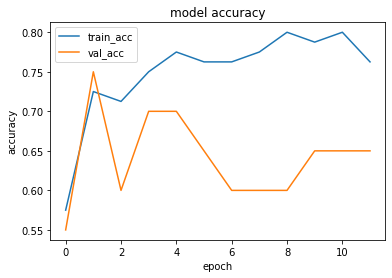

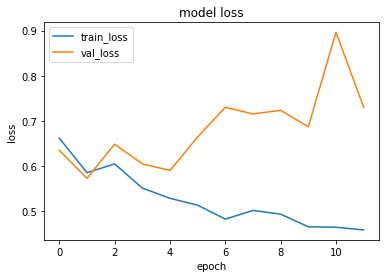

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.3290648]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.12480056]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.54720986]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.14247063]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.21908247]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.27606505]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7413 - accuracy: 0.5125 - precision: 0.5152 - recall: 0.4250 - val_loss: 0.7142 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6651 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.5979 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5889 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5415 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5861 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.5132 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epo

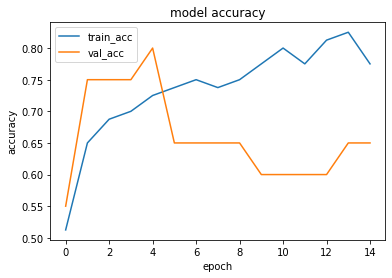

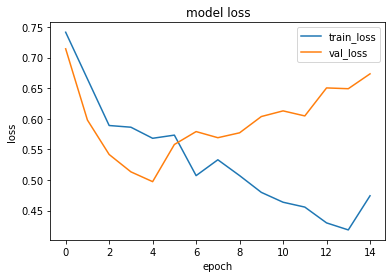

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.50653285]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.2852522]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_2.mov is [[0.7484825]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.27919242]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.32613808]]


1it [00:00, 16578.28it/s]


prediction for video control_3.mov is [[0.30651888]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6870 - accuracy: 0.5750 - precision: 0.5577 - recall: 0.7250 - val_loss: 0.6114 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6406 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.5950 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6007 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5998 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5590 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6102 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

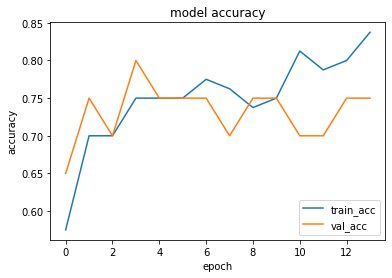

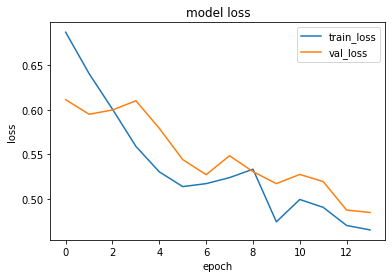

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.6316985]]


1it [00:00, 6853.44it/s]


prediction for video armflapping_3.mov is [[0.7721057]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.80440974]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.20375896]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.18063205]]


1it [00:00, 17623.13it/s]


prediction for video control_3.mov is [[0.17823988]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6866 - accuracy: 0.5250 - precision: 0.5208 - recall: 0.6250 - val_loss: 0.6074 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6515 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.5858 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5792 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6350 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5415 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.5904 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

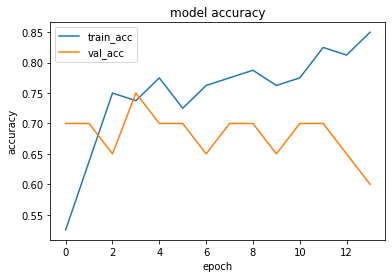

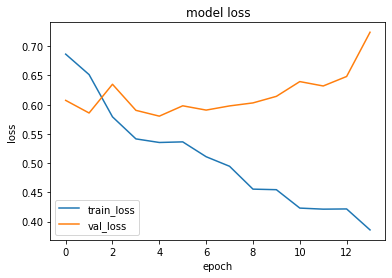

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.7219133]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.7888943]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.9206248]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.24503645]]


1it [00:00, 19599.55it/s]


prediction for video control_2.mov is [[0.17043275]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.16967255]]


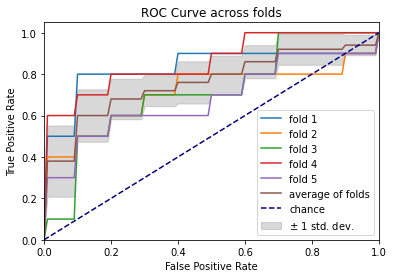

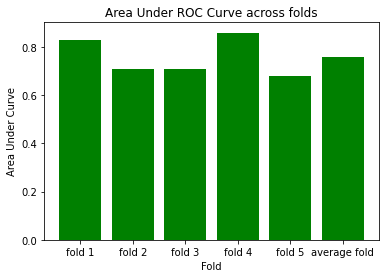

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.8284 - accuracy: 0.4000 - precision: 0.3182 - recall: 0.1750 - val_loss: 0.6231 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6630 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6093 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 1s 129ms/step - loss: 0.6484 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.5836 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6245 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.5588 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 132

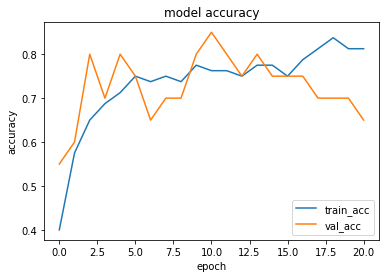

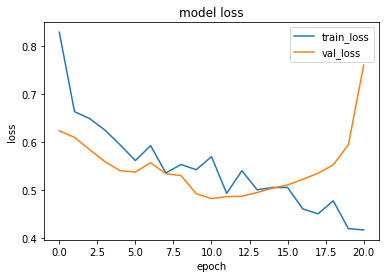

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.5389411]]


1it [00:00, 6668.21it/s]


prediction for video armflapping_3.mov is [[0.543547]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6278326]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.29146296]]


1it [00:00, 9362.29it/s]


prediction for video control_2.mov is [[0.28719544]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.2861805]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6917 - accuracy: 0.4250 - precision: 0.4444 - recall: 0.6000 - val_loss: 0.6939 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6136 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.7122 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5732 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.6845 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5320 - accuracy: 0.7875 - precision: 0.7805 - recall: 0.8000 - val_loss: 0.6961 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

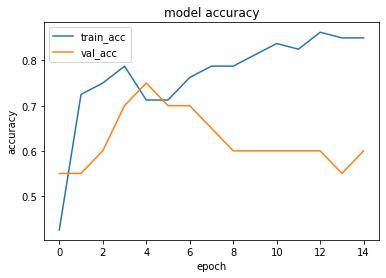

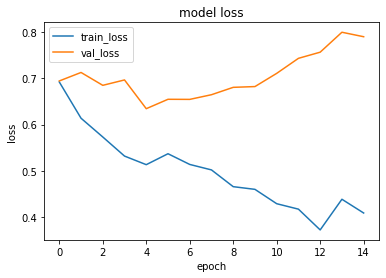

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.43634844]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_3.mov is [[0.40078163]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.78652203]]


1it [00:00, 3518.71it/s]


prediction for video control_1.mov is [[0.35535213]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.14215788]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.15518656]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6223 - accuracy: 0.6500 - precision: 0.6154 - recall: 0.8000 - val_loss: 1.1176 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5266 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.9551 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5714 - accuracy: 0.7125 - precision: 0.8400 - recall: 0.5250 - val_loss: 0.9214 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.4777 - accuracy: 0.7875 - precision: 0.8108 - recall: 0.7500 - val_loss: 1.0369 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epo

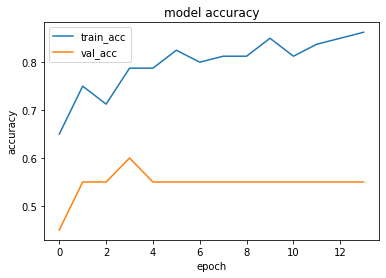

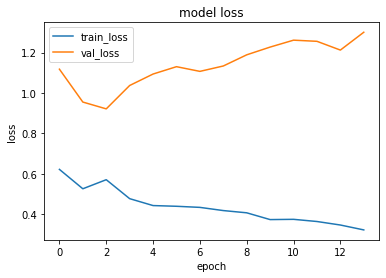

1it [00:00, 16320.25it/s]


prediction for video armflapping_1.mov is [[0.50814366]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.20639712]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.8712491]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.17475095]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.22098786]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.3178056]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7347 - accuracy: 0.4875 - precision: 0.4762 - recall: 0.2500 - val_loss: 0.6232 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6909 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.6027 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6177 - accuracy: 0.7625 - precision: 0.7838 - recall: 0.7250 - val_loss: 0.5832 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6123 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5399 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoc

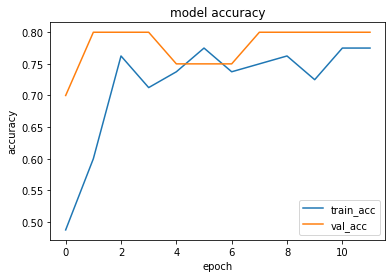

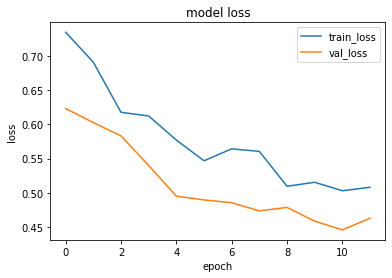

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5641629]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.4326417]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.8029343]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.32209224]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.30445343]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.26984653]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7142 - accuracy: 0.4625 - precision: 0.4694 - recall: 0.5750 - val_loss: 0.6170 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.7162 - accuracy: 0.5125 - precision: 0.5455 - recall: 0.1500 - val_loss: 0.6264 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6558 - accuracy: 0.6375 - precision: 0.6897 - recall: 0.5000 - val_loss: 0.5991 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6519 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.5864 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

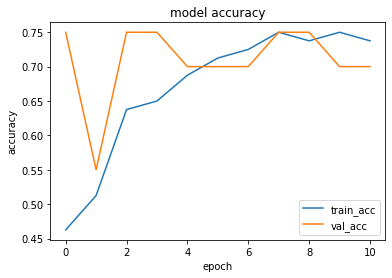

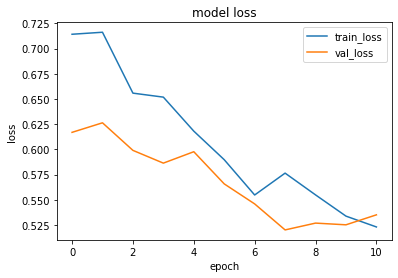

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.23848504]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.42141348]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.7103192]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.21695137]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.21365625]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.21340218]]


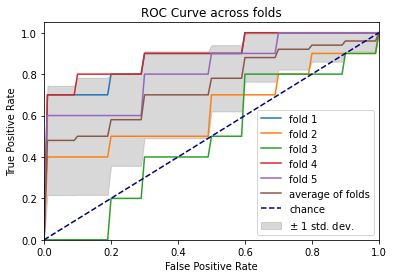

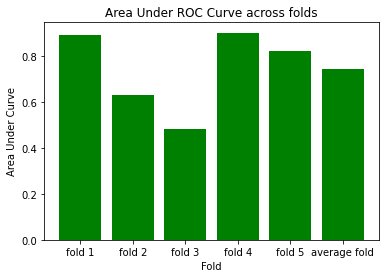

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7233 - accuracy: 0.4250 - precision: 0.4423 - recall: 0.5750 - val_loss: 0.6299 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6363 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6050 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6164 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.5625 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5740 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.5691 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 133

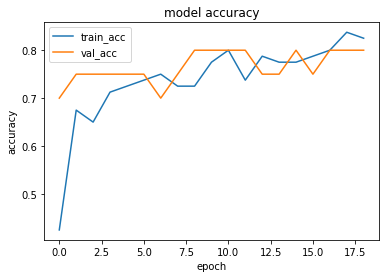

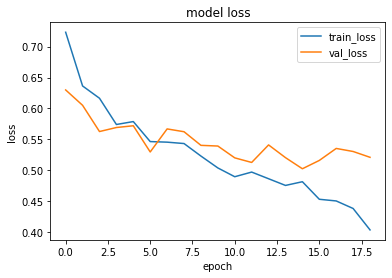

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.61004007]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.7636701]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.7230608]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.27702725]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.21589929]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.20945916]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7367 - accuracy: 0.4500 - precision: 0.4583 - recall: 0.5500 - val_loss: 0.6469 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6518 - accuracy: 0.7375 - precision: 0.8065 - recall: 0.6250 - val_loss: 0.5385 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6175 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.4736 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5596 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.4782 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epo

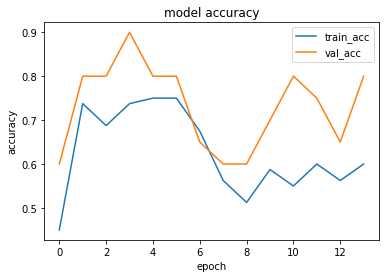

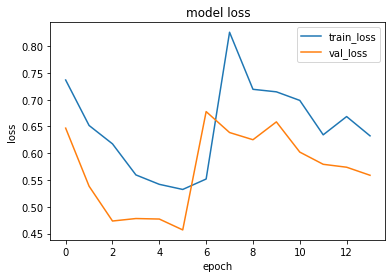

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.48745894]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.51396817]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.6282966]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.20468023]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.18314603]]


1it [00:00, 12336.19it/s]


prediction for video control_3.mov is [[0.180262]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 218ms/step - loss: 0.7848 - accuracy: 0.3625 - precision: 0.4068 - recall: 0.6000 - val_loss: 0.7191 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 277ms/step - loss: 0.6277 - accuracy: 0.7500 - precision: 0.7083 - recall: 0.8500 - val_loss: 0.6705 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 174ms/step - loss: 0.6088 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.6899 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5696 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.7358 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch

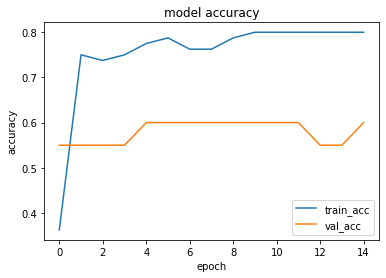

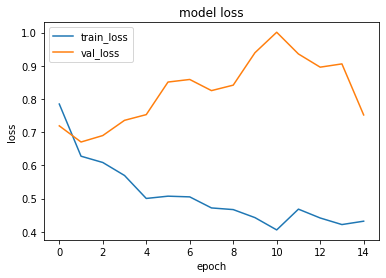

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.3299552]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5582201]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.73279876]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.31160003]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.30886358]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.3097697]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7190 - accuracy: 0.4500 - precision: 0.4545 - recall: 0.5000 - val_loss: 0.6898 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6838 - accuracy: 0.6500 - precision: 0.7308 - recall: 0.4750 - val_loss: 0.6437 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6078 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6256 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5864 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.5970 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

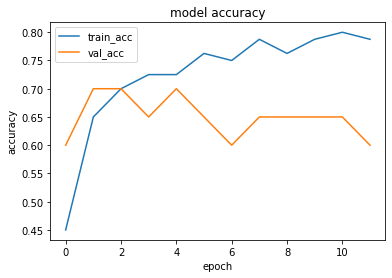

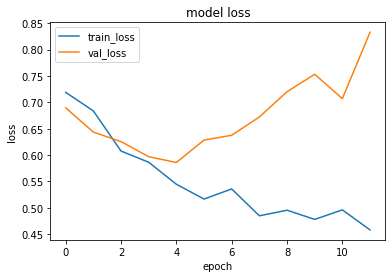

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.211079]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.85218877]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.747246]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.14797074]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.20826733]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.11918408]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6602 - accuracy: 0.4875 - precision: 0.4865 - recall: 0.4500 - val_loss: 0.5900 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 196ms/step - loss: 0.6285 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.6511 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6074 - accuracy: 0.7000 - precision: 0.8333 - recall: 0.5000 - val_loss: 0.6275 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.5540 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.5901 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

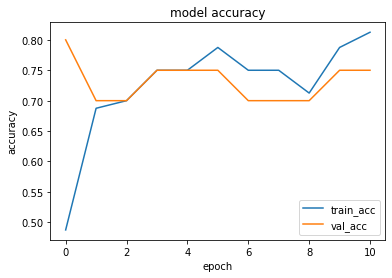

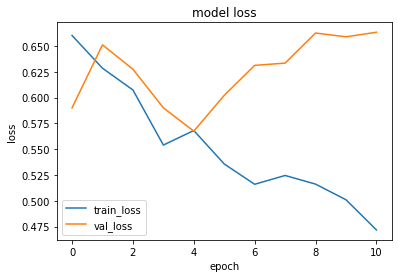

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.65647835]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5796067]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.7170953]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.5321028]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.4172322]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.27753937]]


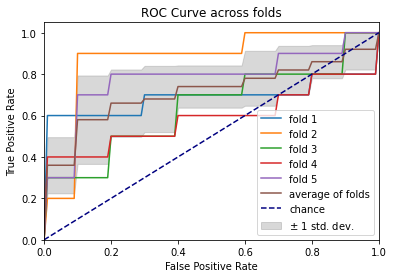

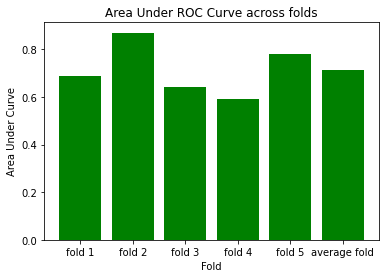

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7474 - accuracy: 0.4125 - precision: 0.4286 - recall: 0.5250 - val_loss: 0.7429 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6063 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.7107 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5951 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.6453 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5616 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6461 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 128

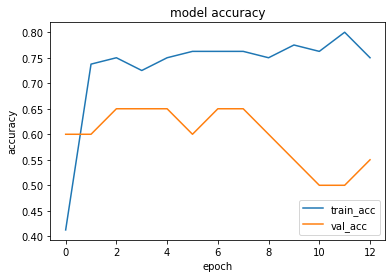

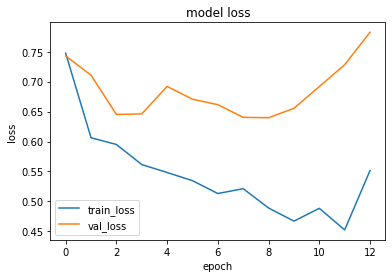

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5422546]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.48490867]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.65944004]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.44143838]]


1it [00:00, 17260.51it/s]


prediction for video control_2.mov is [[0.39076626]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.36133975]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6914 - accuracy: 0.5875 - precision: 0.5714 - recall: 0.7000 - val_loss: 0.6945 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6225 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6017 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5651 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6326 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6040 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6443 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

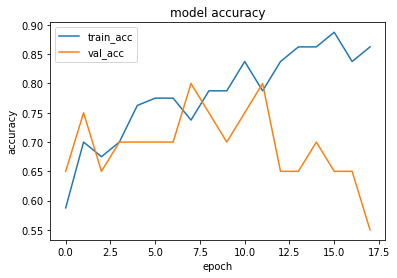

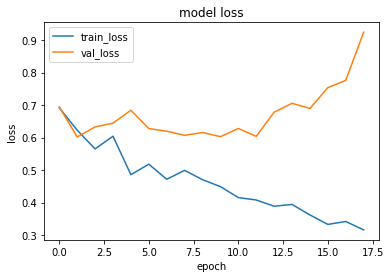

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5366479]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.38712704]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.66945523]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.28470123]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.17933398]]


1it [00:00, 16070.13it/s]


prediction for video control_3.mov is [[0.1612826]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 143ms/step - loss: 0.7110 - accuracy: 0.4625 - precision: 0.4706 - recall: 0.6000 - val_loss: 0.6416 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6478 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.5831 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5777 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.5418 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5917 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.4931 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoc

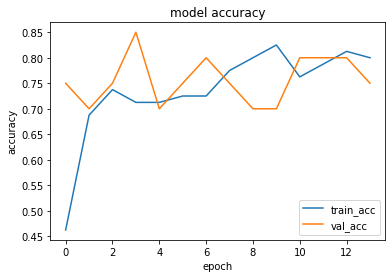

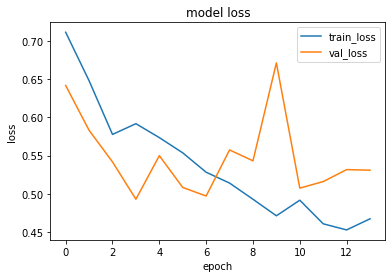

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4742923]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.5102575]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.64413726]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.33316806]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.27126196]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.2680901]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7296 - accuracy: 0.4375 - precision: 0.4528 - recall: 0.6000 - val_loss: 0.6981 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6629 - accuracy: 0.6375 - precision: 0.7200 - recall: 0.4500 - val_loss: 0.5953 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5841 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.5269 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5729 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.5134 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoc

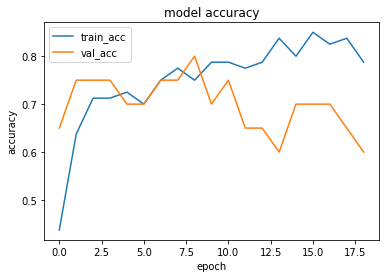

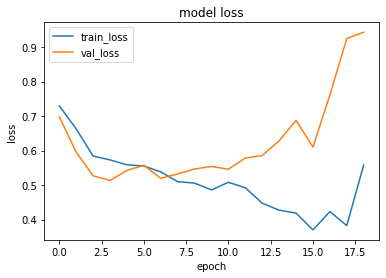

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.04897571]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.4742713]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.06917152]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.04110402]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.03822905]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.03728721]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6808 - accuracy: 0.5750 - precision: 0.5625 - recall: 0.6750 - val_loss: 0.6534 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6431 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.6105 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5671 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5978 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5580 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6034 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

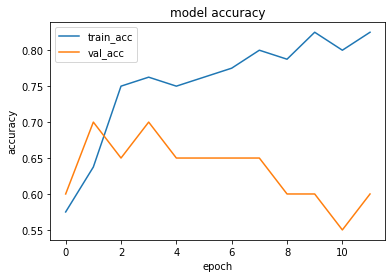

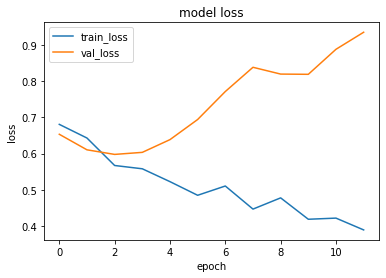

1it [00:00, 16448.25it/s]


prediction for video armflapping_1.mov is [[0.79192686]]


1it [00:00, 11366.68it/s]


prediction for video armflapping_3.mov is [[0.11671424]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.9083631]]


1it [00:00, 6326.25it/s]


prediction for video control_1.mov is [[0.6858139]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.07178679]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.582028]]


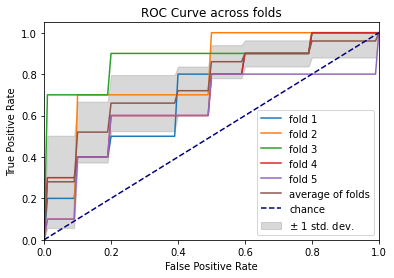

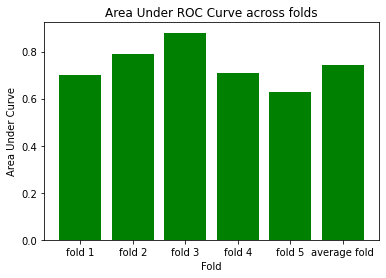

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6804 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.6916 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6226 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6341 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5898 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6111 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5398 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6440 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 135

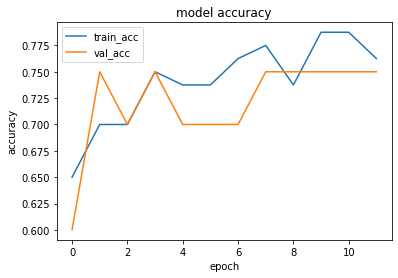

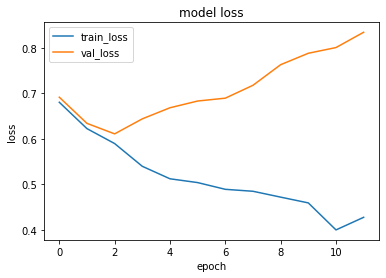

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.6026409]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.5394037]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.69428813]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.49630496]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.45301247]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.4083134]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 184ms/step - loss: 0.7211 - accuracy: 0.6250 - precision: 0.6136 - recall: 0.6750 - val_loss: 0.6556 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6711 - accuracy: 0.6375 - precision: 0.7619 - recall: 0.4000 - val_loss: 0.6256 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6073 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.6763 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5546 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6596 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoc

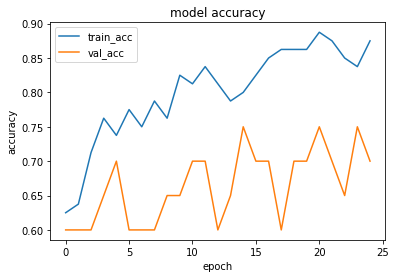

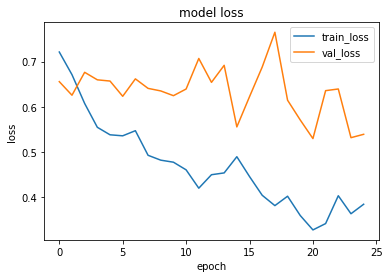

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.2740127]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.33674794]]


1it [00:00, 10538.45it/s]


prediction for video armflapping_2.mov is [[0.6277579]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.23090592]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.21665066]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.21938986]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6951 - accuracy: 0.5125 - precision: 0.5079 - recall: 0.8000 - val_loss: 0.6420 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6093 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6979 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5904 - accuracy: 0.7500 - precision: 0.7000 - recall: 0.8750 - val_loss: 0.7479 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5204 - accuracy: 0.7875 - precision: 0.7949 - recall: 0.7750 - val_loss: 0.7784 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epo

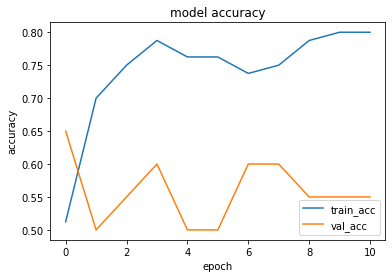

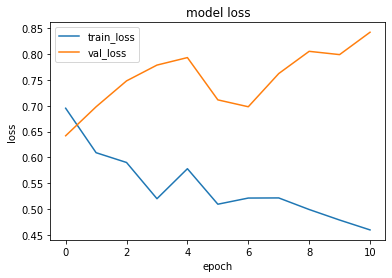

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.7279065]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.5686542]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.8207051]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.41662276]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.3008331]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.28750363]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7313 - accuracy: 0.4000 - precision: 0.4286 - recall: 0.6000 - val_loss: 0.6378 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6387 - accuracy: 0.6875 - precision: 0.8261 - recall: 0.4750 - val_loss: 0.5996 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6137 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.5562 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5821 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.5340 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

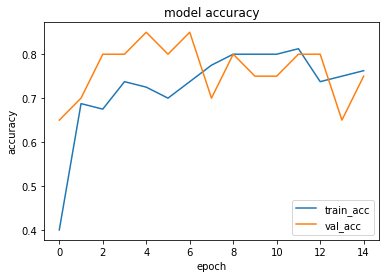

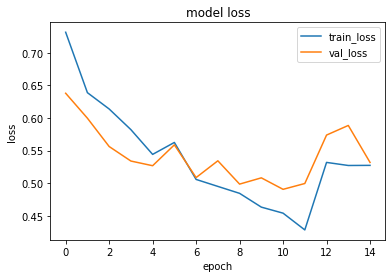

1it [00:00, 10538.45it/s]


prediction for video armflapping_1.mov is [[0.40538076]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.5352049]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.65202343]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.16507867]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.13034582]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.12098294]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7058 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5500 - val_loss: 0.6624 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6594 - accuracy: 0.6375 - precision: 0.7391 - recall: 0.4250 - val_loss: 0.5898 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6270 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5240 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 1s 208ms/step - loss: 0.5995 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.4118 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

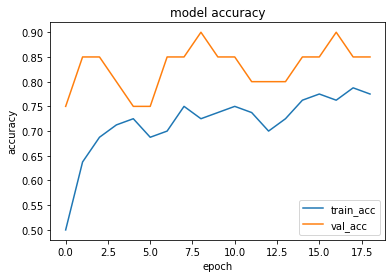

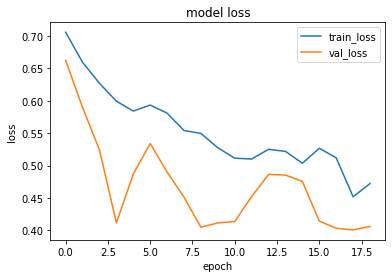

1it [00:00, 12483.05it/s]


prediction for video armflapping_1.mov is [[0.6061367]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.4290825]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.81566596]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.2937708]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.29224402]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.26928174]]


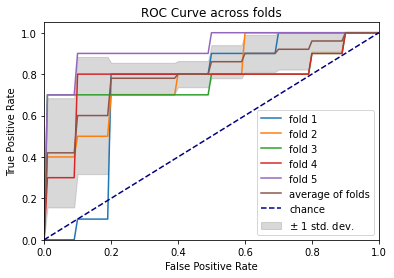

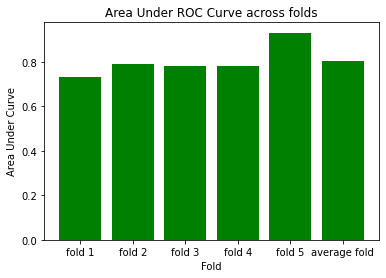

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7053 - accuracy: 0.5125 - precision: 0.5075 - recall: 0.8500 - val_loss: 0.6000 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6634 - accuracy: 0.6250 - precision: 0.7083 - recall: 0.4250 - val_loss: 0.5583 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6545 - accuracy: 0.6250 - precision: 0.6190 - recall: 0.6500 - val_loss: 0.4054 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 141ms/step - loss: 0.6297 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.3629 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 137

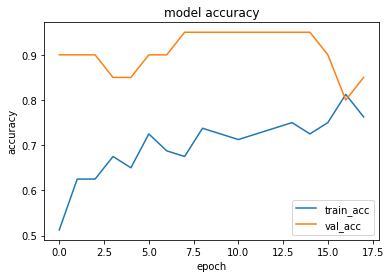

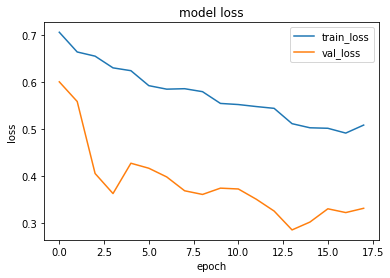

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.57274824]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.56889117]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.7100737]]


1it [00:00, 12826.62it/s]


prediction for video control_1.mov is [[0.29836652]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.26422137]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.26187688]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6634 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.7183 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6255 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6838 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5262 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6986 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5117 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.7526 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epo

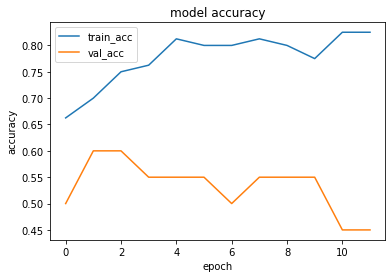

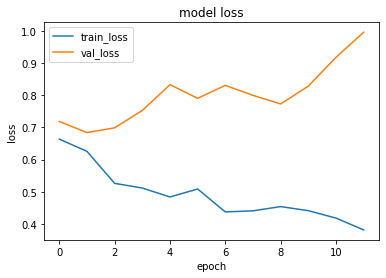

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.80161667]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.90370554]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.87281096]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.24201992]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.1973108]]


1it [00:00, 13486.51it/s]


prediction for video control_3.mov is [[0.20396337]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6474 - accuracy: 0.6000 - precision: 0.5769 - recall: 0.7500 - val_loss: 0.7390 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6390 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.6713 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5768 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.6437 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5509 - accuracy: 0.7625 - precision: 0.7838 - recall: 0.7250 - val_loss: 0.6163 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

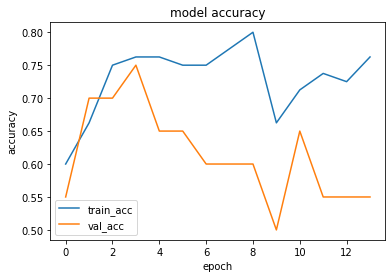

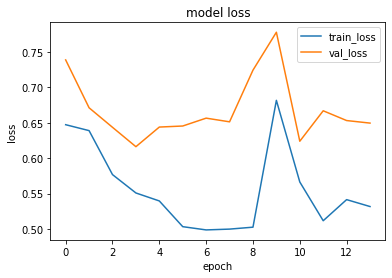

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.42498142]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_3.mov is [[0.70937836]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_2.mov is [[0.52064186]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.39768058]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.38246638]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.37929612]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7033 - accuracy: 0.6125 - precision: 0.6216 - recall: 0.5750 - val_loss: 0.6777 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6148 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6191 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5581 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7635 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5983 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.6536 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

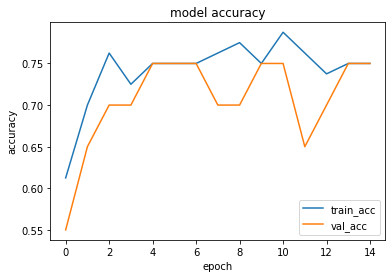

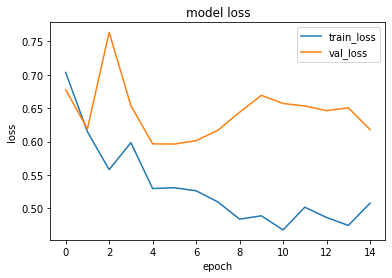

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.62354296]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_3.mov is [[0.634715]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7692504]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.36107427]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.2383577]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.22255191]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.8564 - accuracy: 0.4875 - precision: 0.4928 - recall: 0.8500 - val_loss: 0.6637 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6591 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.6403 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6525 - accuracy: 0.6125 - precision: 0.6452 - recall: 0.5000 - val_loss: 0.5742 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6199 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5460 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

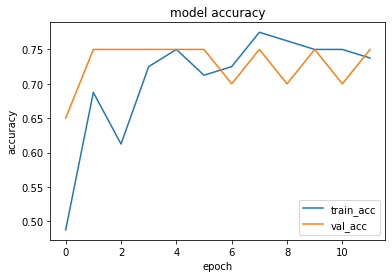

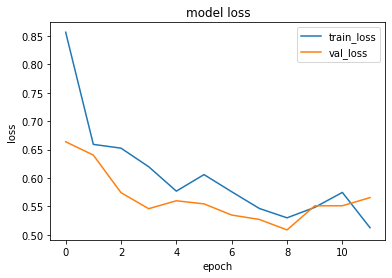

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.5850843]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.3618408]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.6850081]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.39059582]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.25610134]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.22615093]]


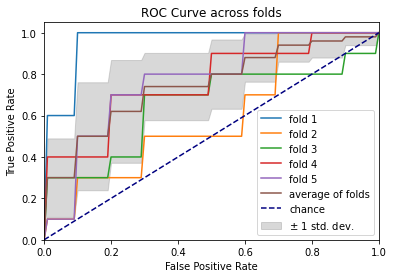

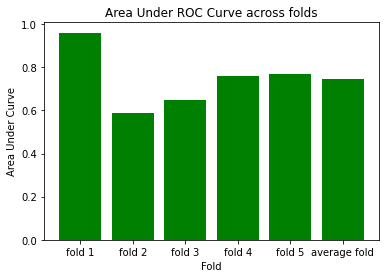

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7793 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.7111 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6585 - accuracy: 0.6000 - precision: 0.9000 - recall: 0.2250 - val_loss: 0.6474 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6345 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5629 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5986 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5280 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 131

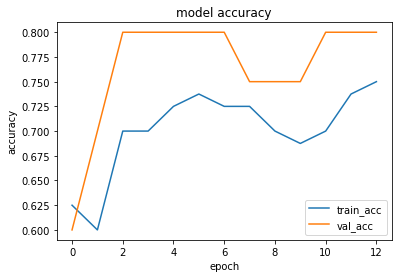

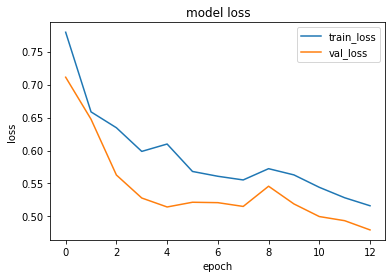

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5479143]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.49810103]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6519455]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.46083483]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.4073748]]


1it [00:00, 21183.35it/s]


prediction for video control_3.mov is [[0.38779682]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6555 - accuracy: 0.5500 - precision: 0.5333 - recall: 0.8000 - val_loss: 0.9143 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6463 - accuracy: 0.7125 - precision: 0.6393 - recall: 0.9750 - val_loss: 0.6917 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6259 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.6699 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5494 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.5963 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

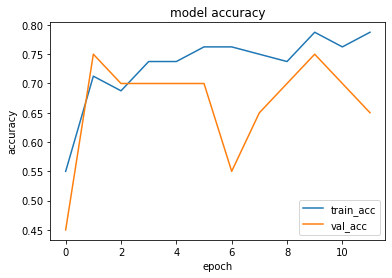

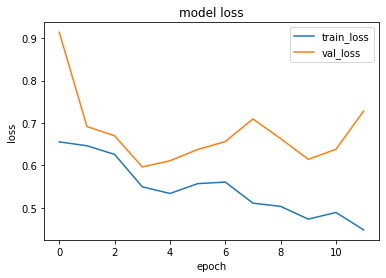

1it [00:00, 18808.54it/s]


prediction for video armflapping_1.mov is [[0.35850248]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.72048736]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.80306804]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.2783019]]


1it [00:00, 12787.51it/s]


prediction for video control_2.mov is [[0.2779212]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.2780987]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6505 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.8017 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5986 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.9634 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5483 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.9868 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5437 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.9216 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoc

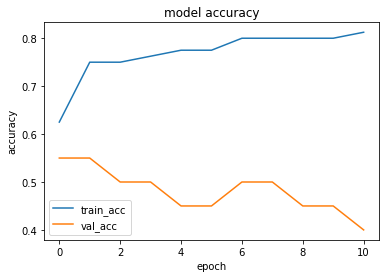

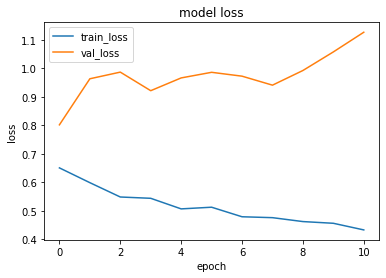

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.561043]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.7065524]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.6690872]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.13758028]]


1it [00:00, 13662.23it/s]


prediction for video control_2.mov is [[0.13016653]]


1it [00:00, 19152.07it/s]


prediction for video control_3.mov is [[0.13006452]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6805 - accuracy: 0.5625 - precision: 0.5397 - recall: 0.8500 - val_loss: 0.6052 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6018 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.6931 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 195ms/step - loss: 0.5320 - accuracy: 0.7875 - precision: 0.8108 - recall: 0.7500 - val_loss: 0.7027 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5617 - accuracy: 0.7625 - precision: 0.7143 - recall: 0.8750 - val_loss: 0.6968 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epo

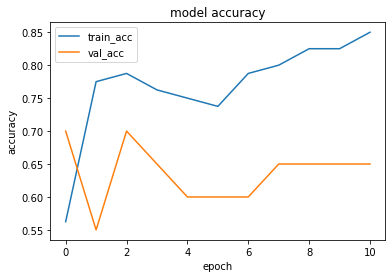

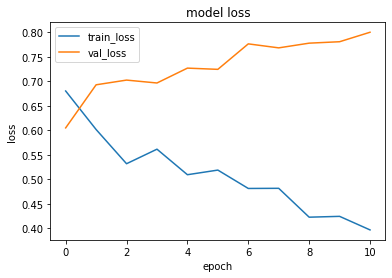

1it [00:00, 16194.22it/s]


prediction for video armflapping_1.mov is [[0.66520894]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.5572285]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.813568]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.18817589]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.16063544]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.15989393]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6746 - accuracy: 0.5750 - precision: 0.5577 - recall: 0.7250 - val_loss: 0.6557 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6137 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.6687 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5835 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.7539 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5287 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.7487 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

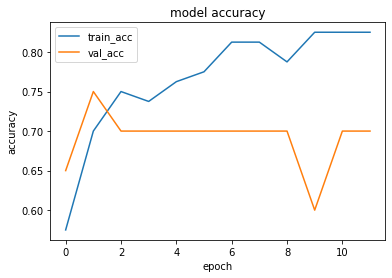

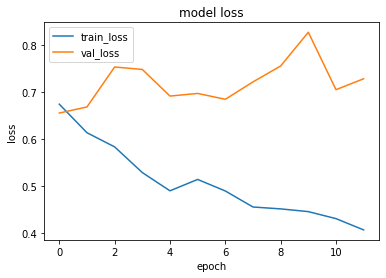

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.6235616]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.88559884]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.84755766]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.43283427]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.3755875]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.34471288]]


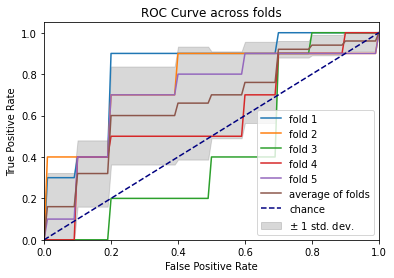

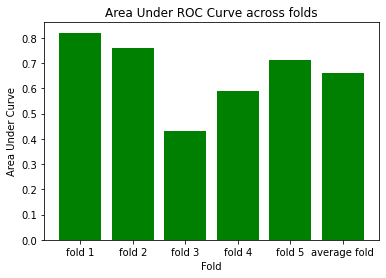

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6893 - accuracy: 0.5125 - precision: 0.5091 - recall: 0.7000 - val_loss: 0.7235 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.7046 - accuracy: 0.6125 - precision: 0.8462 - recall: 0.2750 - val_loss: 0.5917 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6310 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.5913 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5877 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.5322 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 137

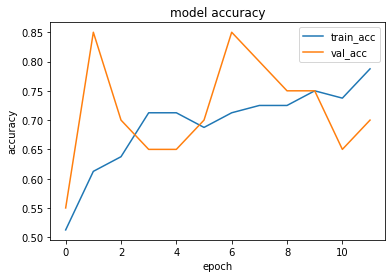

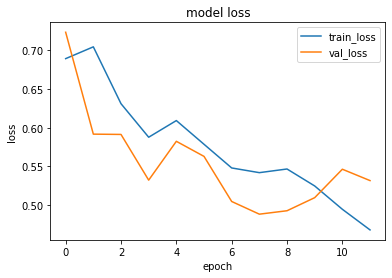

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.527716]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.48988682]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.5828402]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.48432103]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.46435767]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.45031402]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7783 - accuracy: 0.4875 - precision: 0.4918 - recall: 0.7500 - val_loss: 0.5600 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6833 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 0.5678 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6420 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.5094 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6047 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.5055 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epo

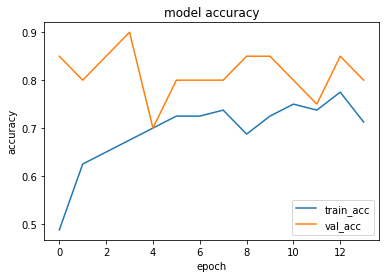

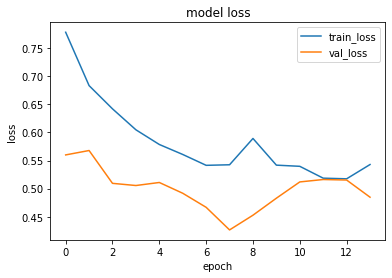

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.50930136]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.61194843]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.6214664]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.2891041]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.23305854]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.2443319]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.8398 - accuracy: 0.4750 - precision: 0.4167 - recall: 0.1250 - val_loss: 0.6081 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6524 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.5839 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6375 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.5831 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6091 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.5626 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoc

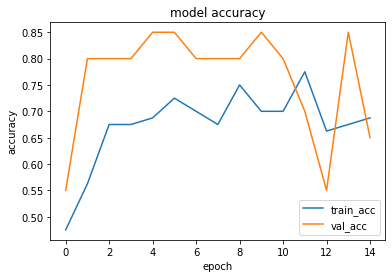

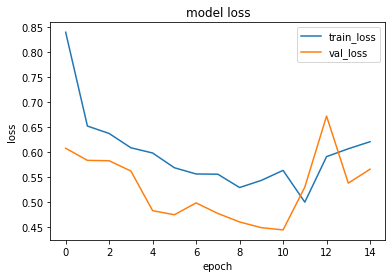

1it [00:00, 17476.27it/s]


prediction for video armflapping_1.mov is [[0.33182228]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.47977686]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.34553468]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.23557499]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.22813764]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.2272996]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 138ms/step - loss: 0.6663 - accuracy: 0.5625 - precision: 0.5641 - recall: 0.5500 - val_loss: 0.7308 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6290 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.7507 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5449 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.8231 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5165 - accuracy: 0.8125 - precision: 0.8205 - recall: 0.8000 - val_loss: 0.8426 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoc

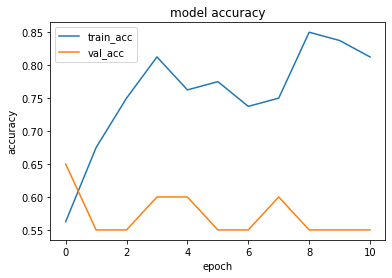

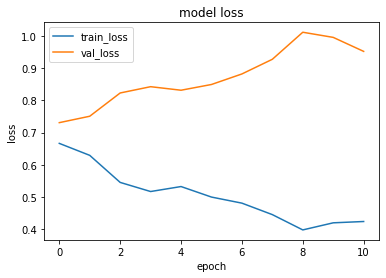

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.64361197]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.08199668]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_2.mov is [[0.83651775]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.21549448]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.19343644]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.19435501]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6570 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.7808 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5694 - accuracy: 0.7500 - precision: 0.7000 - recall: 0.8750 - val_loss: 0.7209 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.4979 - accuracy: 0.7875 - precision: 0.8710 - recall: 0.6750 - val_loss: 0.8268 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 126ms/step - loss: 0.4855 - accuracy: 0.7875 - precision: 0.7805 - recall: 0.8000 - val_loss: 0.9119 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epo

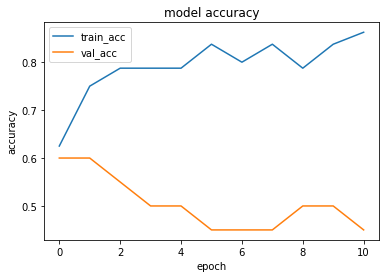

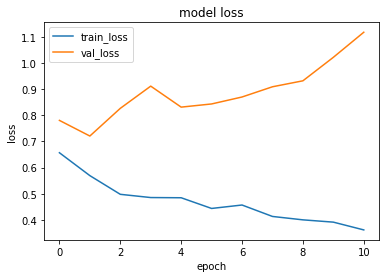

1it [00:00, 12192.74it/s]


prediction for video armflapping_1.mov is [[0.7159762]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.78180456]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.8967522]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.31084004]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.09608003]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.2427778]]


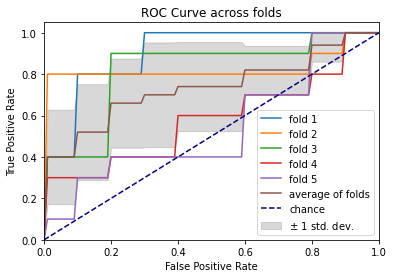

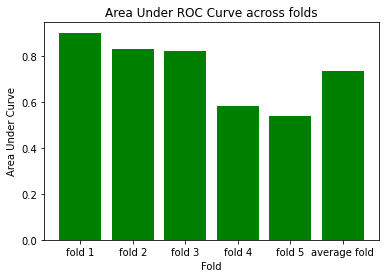

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7191 - accuracy: 0.5125 - precision: 0.5143 - recall: 0.4500 - val_loss: 0.5435 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7120 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.5543 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6334 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6385 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6394 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.5904 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 138

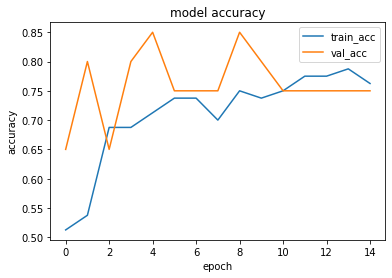

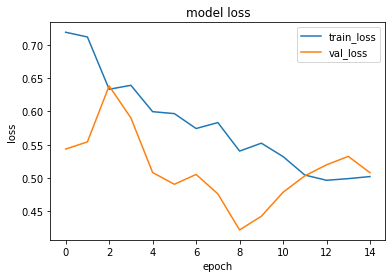

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.5027161]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.4320812]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.58386517]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.36079973]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.3065259]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.24420056]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6795 - accuracy: 0.5375 - precision: 0.5283 - recall: 0.7000 - val_loss: 0.6719 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 196ms/step - loss: 0.7176 - accuracy: 0.6500 - precision: 0.6154 - recall: 0.8000 - val_loss: 0.5718 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6181 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.5430 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5982 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.5003 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

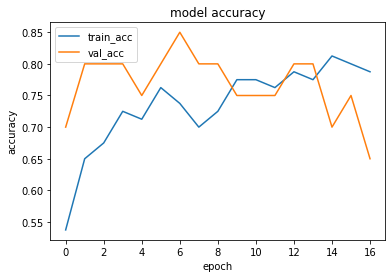

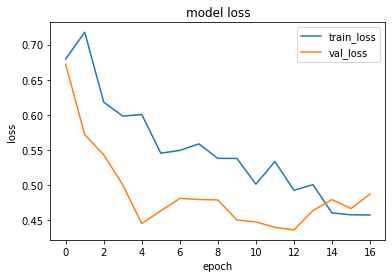

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.26599133]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.57925564]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.89727545]]


1it [00:00, 16320.25it/s]


prediction for video control_1.mov is [[0.26316917]]


1it [00:00, 13842.59it/s]


prediction for video control_2.mov is [[0.26219362]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.26222342]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6745 - accuracy: 0.4250 - precision: 0.4423 - recall: 0.5750 - val_loss: 0.6784 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6022 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6987 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5790 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6638 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.4973 - accuracy: 0.8125 - precision: 0.8049 - recall: 0.8250 - val_loss: 0.6938 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

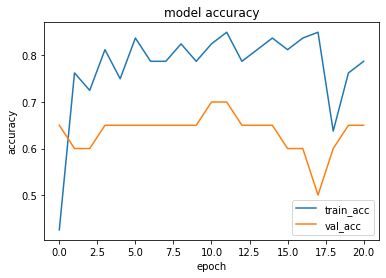

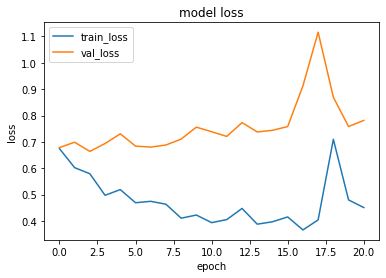

1it [00:00, 12520.31it/s]


prediction for video armflapping_1.mov is [[0.30075103]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.44681332]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.63138026]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.17492494]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.15962476]]


1it [00:00, 11491.24it/s]


prediction for video control_3.mov is [[0.16285938]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6363 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.7466 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6296 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.7179 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5488 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.7519 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5276 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7275 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.

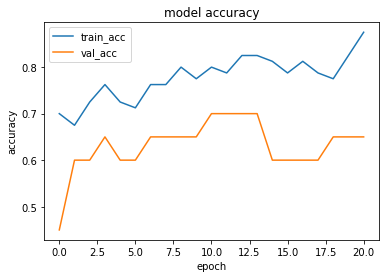

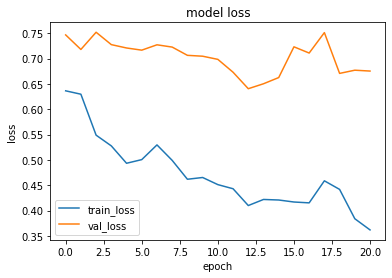

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.45216796]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.13509947]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8930057]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.1995104]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.25487888]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.2549098]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6803 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.6091 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6377 - accuracy: 0.7125 - precision: 0.8148 - recall: 0.5500 - val_loss: 0.6734 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5842 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6356 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6140 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5466 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoc

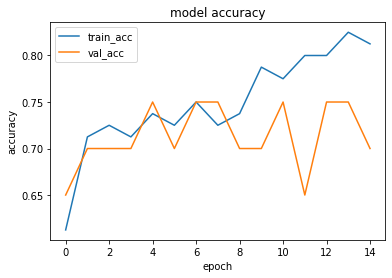

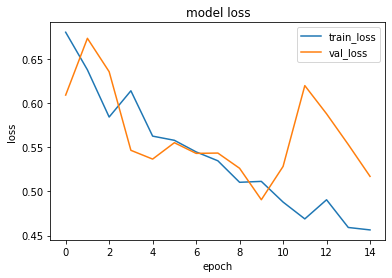

1it [00:00, 16194.22it/s]


prediction for video armflapping_1.mov is [[0.6137065]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.4306026]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.7273369]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.2799933]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2620036]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.22946844]]


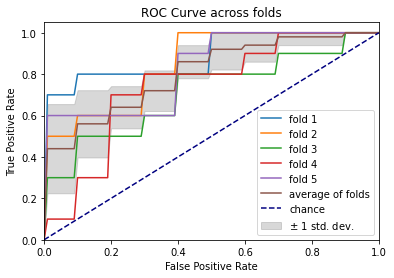

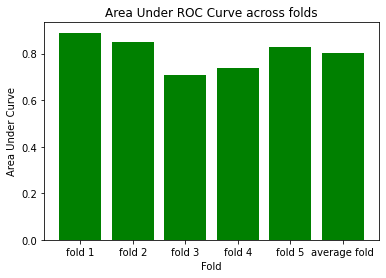

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6502 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 0.7262 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6794 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.5373 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6154 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.5783 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5846 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6192 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 129

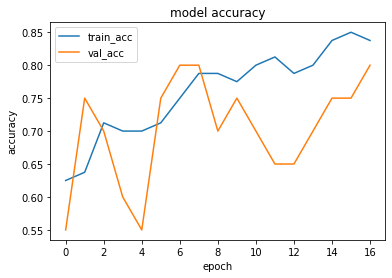

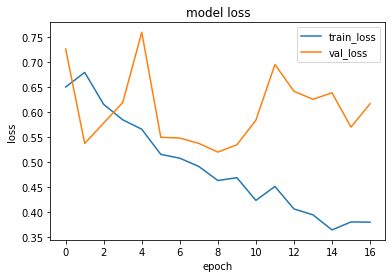

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.56744134]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.4399]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.6946099]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.4708114]]


1it [00:00, 16980.99it/s]


prediction for video control_2.mov is [[0.36518455]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.3573566]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.8463 - accuracy: 0.5125 - precision: 0.5072 - recall: 0.8750 - val_loss: 0.7045 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6661 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.6678 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6392 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.6556 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 1s 204ms/step - loss: 0.5790 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.7129 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

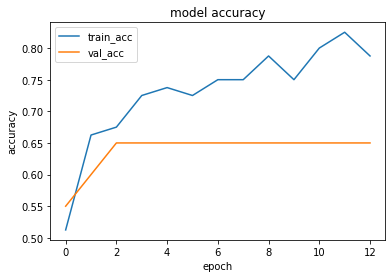

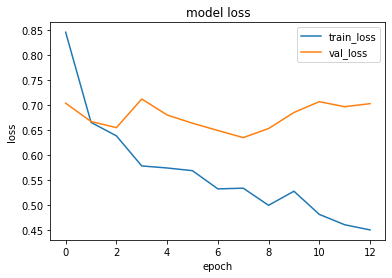

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.65976816]]


1it [00:00, 11748.75it/s]


prediction for video armflapping_3.mov is [[0.21424839]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.79704475]]


1it [00:00, 16384.00it/s]


prediction for video control_1.mov is [[0.27158058]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.17001164]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.16998401]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7287 - accuracy: 0.4875 - precision: 0.4925 - recall: 0.8250 - val_loss: 0.6039 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6281 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6007 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6404 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.5547 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5729 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5521 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

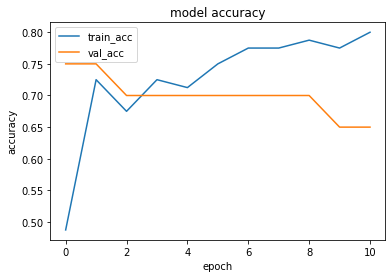

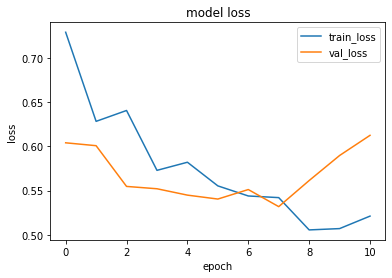

1it [00:00, 17260.51it/s]


prediction for video armflapping_1.mov is [[0.25147167]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.567982]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.80910254]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.18282002]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.15439814]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.15855807]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 222ms/step - loss: 0.7112 - accuracy: 0.5125 - precision: 0.5075 - recall: 0.8500 - val_loss: 0.6550 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6506 - accuracy: 0.6375 - precision: 0.7619 - recall: 0.4000 - val_loss: 0.6535 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6252 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.6405 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5796 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6660 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

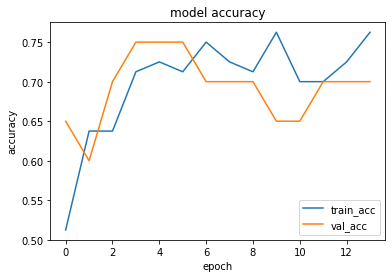

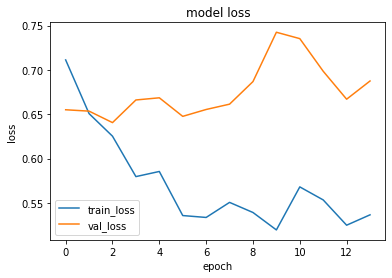

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.5457163]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.55656534]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.5955524]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.242984]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.2274273]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.22628519]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7526 - accuracy: 0.5750 - precision: 0.5600 - recall: 0.7000 - val_loss: 0.7190 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6346 - accuracy: 0.6250 - precision: 0.6562 - recall: 0.5250 - val_loss: 0.6849 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5723 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.6640 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5341 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6665 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

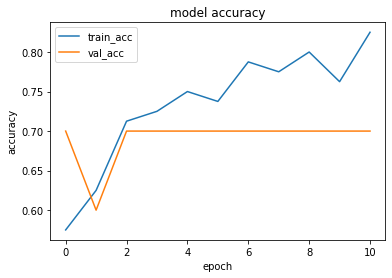

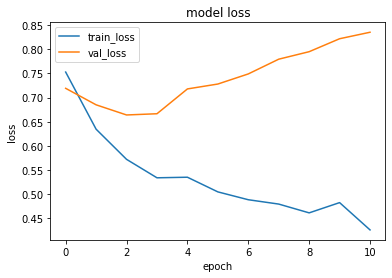

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5186122]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.4744756]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.8548174]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.25730395]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.2642082]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.252957]]


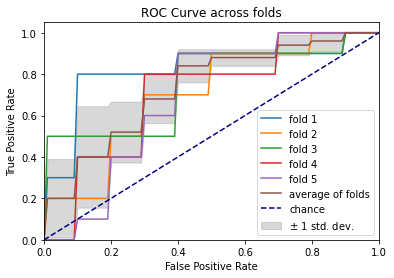

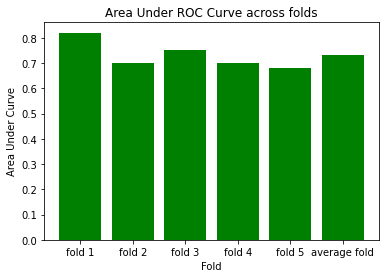

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6833 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6125 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5744 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.8051 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6089 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.7727 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5705 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6525 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 128

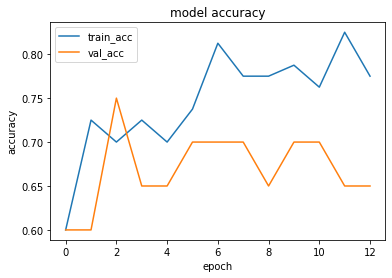

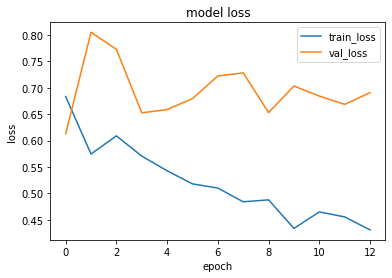

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.38168985]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_3.mov is [[0.5907531]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_2.mov is [[0.62760514]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.15066263]]


1it [00:00, 19152.07it/s]


prediction for video control_2.mov is [[0.1105926]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.10194802]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7020 - accuracy: 0.5250 - precision: 0.5200 - recall: 0.6500 - val_loss: 0.6711 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 125ms/step - loss: 0.5769 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6793 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6160 - accuracy: 0.6500 - precision: 0.7500 - recall: 0.4500 - val_loss: 0.6273 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5714 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6361 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

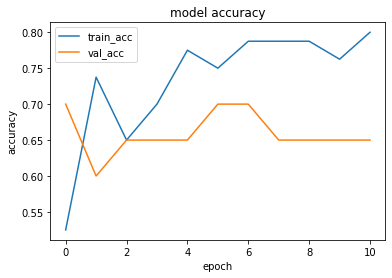

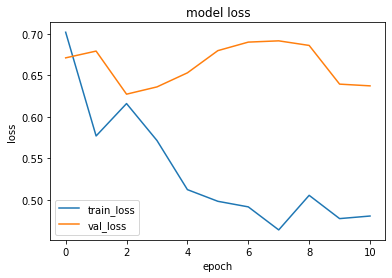

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.48810053]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.6124014]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.60536253]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.21013445]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.18654013]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.1913786]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.8607 - accuracy: 0.4875 - precision: 0.4925 - recall: 0.8250 - val_loss: 0.6521 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6533 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6672 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6214 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.6501 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5898 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6262 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoc

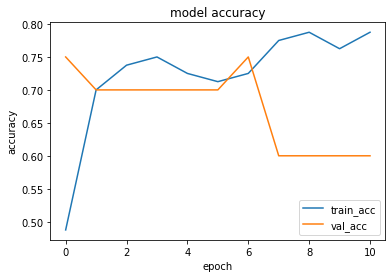

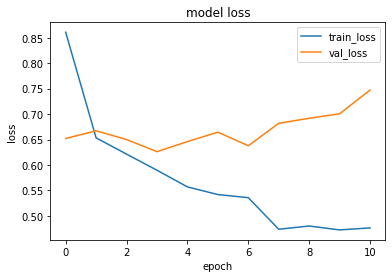

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.49590358]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.13437521]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.6845895]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.30306143]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.27352086]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.27815193]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6945 - accuracy: 0.4750 - precision: 0.4821 - recall: 0.6750 - val_loss: 0.6004 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6461 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.5325 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5891 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.4410 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5966 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.4673 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epo

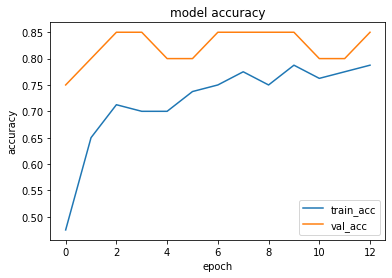

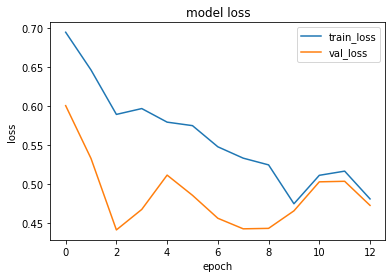

1it [00:00, 16194.22it/s]


prediction for video armflapping_1.mov is [[0.5648]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.5384669]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.7229062]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.29544777]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.21013325]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.18606022]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.8026 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9250 - val_loss: 0.6543 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6887 - accuracy: 0.6000 - precision: 0.7857 - recall: 0.2750 - val_loss: 0.6495 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6404 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.6017 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6093 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.5893 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

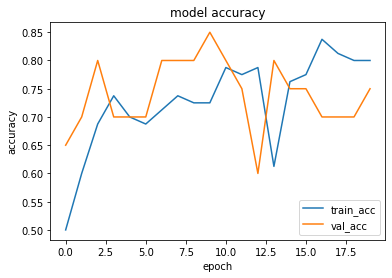

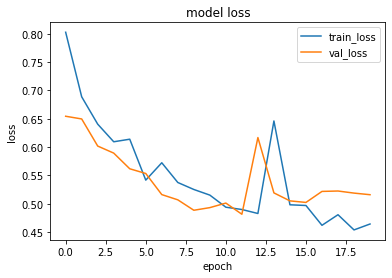

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.31070495]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.39754555]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.72869825]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.3036785]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.30175835]]


1it [00:00, 21845.33it/s]


prediction for video control_3.mov is [[0.30154622]]


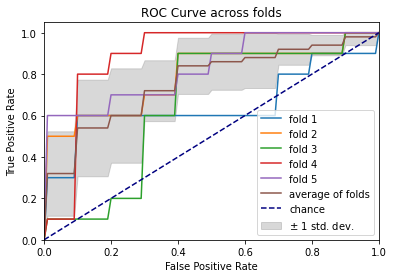

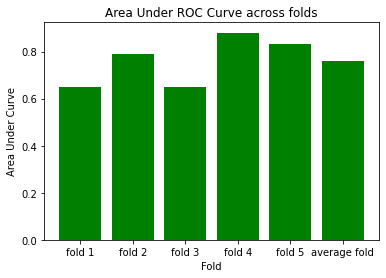

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6484 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.7892 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 166ms/step - loss: 0.5627 - accuracy: 0.7750 - precision: 0.7391 - recall: 0.8500 - val_loss: 0.7059 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5334 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.7791 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5096 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.8197 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 167

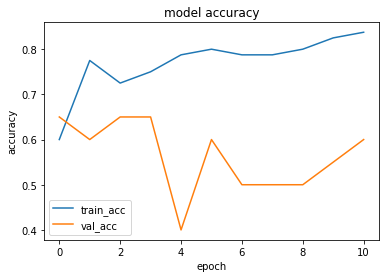

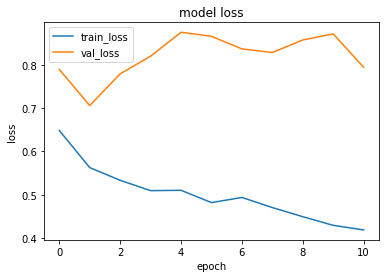

1it [00:00, 16384.00it/s]


prediction for video armflapping_1.mov is [[0.70475376]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.74189174]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_2.mov is [[0.7995196]]


1it [00:00, 16710.37it/s]


prediction for video control_1.mov is [[0.56634206]]


1it [00:00, 12157.40it/s]


prediction for video control_2.mov is [[0.5041344]]


1it [00:00, 17623.13it/s]


prediction for video control_3.mov is [[0.4711727]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7803 - accuracy: 0.4750 - precision: 0.4800 - recall: 0.6000 - val_loss: 0.6843 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 210ms/step - loss: 0.6263 - accuracy: 0.6875 - precision: 0.6316 - recall: 0.9000 - val_loss: 0.6793 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6067 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.6849 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5444 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7733 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoc

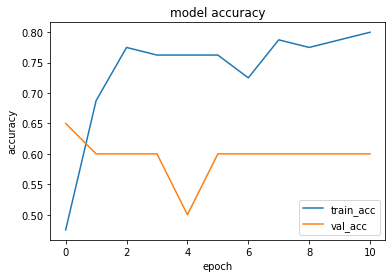

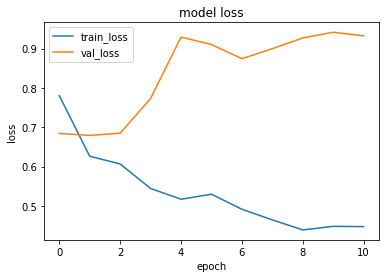

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.49867207]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.2576741]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.64655995]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.28269482]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.14000905]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.26350594]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7004 - accuracy: 0.4750 - precision: 0.4773 - recall: 0.5250 - val_loss: 0.6820 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6229 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.6723 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6028 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.6394 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5664 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6492 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

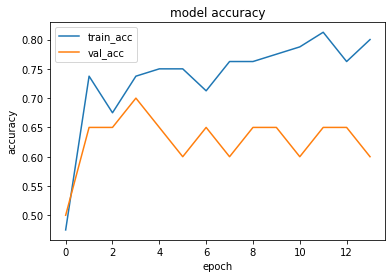

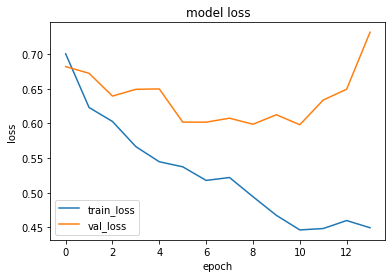

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.5377091]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.46979338]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.6365502]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.35324728]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.22726724]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.20101634]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7267 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6115 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6442 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6216 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6275 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.4899 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5724 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.4098 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

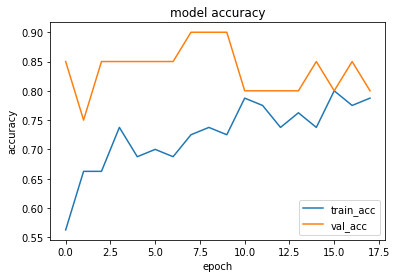

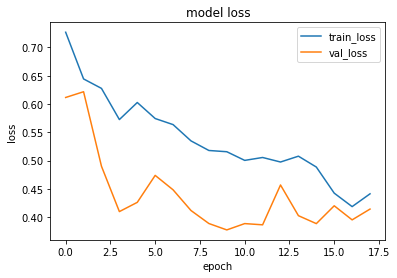

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5623763]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.49549443]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_2.mov is [[0.7527077]]


1it [00:00, 8867.45it/s]


prediction for video control_1.mov is [[0.36814213]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.319171]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.30228996]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 167ms/step - loss: 0.7026 - accuracy: 0.5625 - precision: 0.5714 - recall: 0.5000 - val_loss: 0.8172 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7380 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.5427 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 1s 202ms/step - loss: 0.6526 - accuracy: 0.6500 - precision: 0.6500 - recall: 0.6500 - val_loss: 0.4980 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 191ms/step - loss: 0.6079 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.4434 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

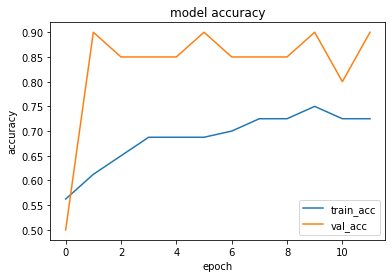

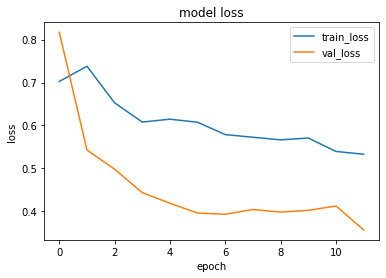

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.536238]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.39652568]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8019115]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.3059435]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.24730349]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.22556233]]


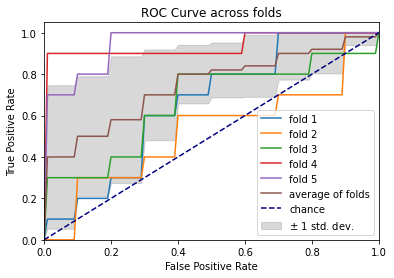

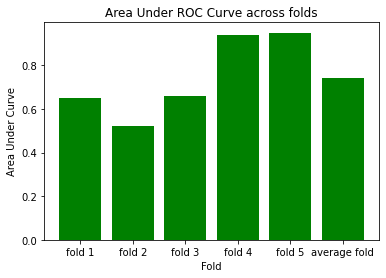

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6758 - accuracy: 0.6000 - precision: 0.5690 - recall: 0.8250 - val_loss: 0.6567 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5805 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6679 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5546 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6050 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5432 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6798 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 136

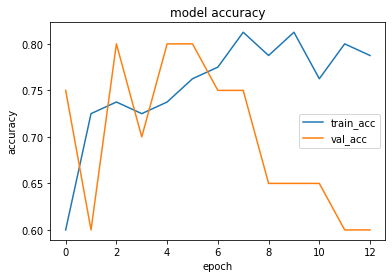

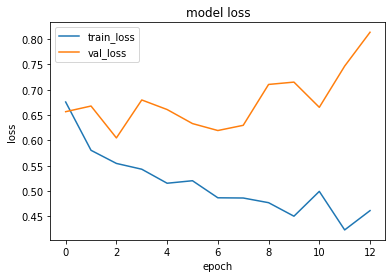

1it [00:00, 17260.51it/s]


prediction for video armflapping_1.mov is [[0.5316]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.46053985]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6506743]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.41590235]]


1it [00:00, 928.56it/s]


prediction for video control_2.mov is [[0.3175965]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.32029277]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6701 - accuracy: 0.4875 - precision: 0.4898 - recall: 0.6000 - val_loss: 0.6191 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6148 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6763 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6375 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6397 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6296 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.6468 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

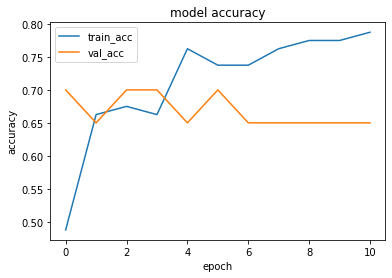

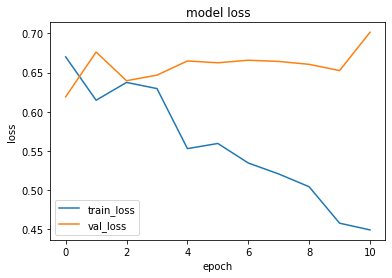

1it [00:00, 16320.25it/s]


prediction for video armflapping_1.mov is [[0.55488884]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.22597352]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.910625]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.18961924]]


1it [00:00, 19599.55it/s]


prediction for video control_2.mov is [[0.1817165]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.17676133]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6929 - accuracy: 0.5250 - precision: 0.5200 - recall: 0.6500 - val_loss: 0.5721 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5947 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.5453 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5560 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6331 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5169 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.5956 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epo

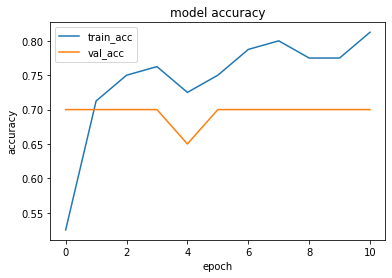

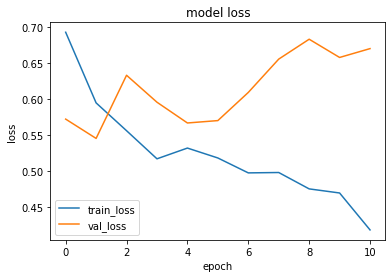

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.29209316]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_3.mov is [[0.35034668]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.7691801]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.1675292]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.15367836]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.14684114]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7298 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.6610 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6525 - accuracy: 0.6750 - precision: 0.8500 - recall: 0.4250 - val_loss: 0.6314 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5896 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6117 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5595 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6036 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

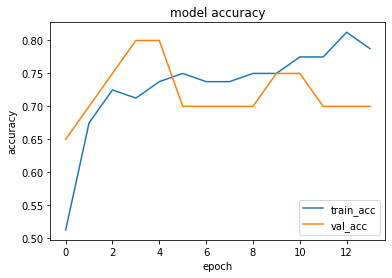

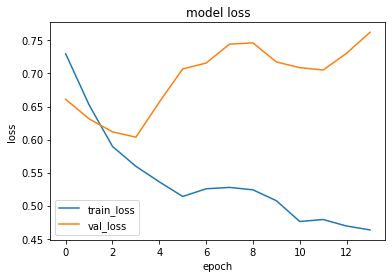

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.49508503]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.32657796]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.5594672]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.3671425]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.29238975]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.32761425]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6550 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.5218 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6129 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.4917 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6195 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.4996 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 1s 198ms/step - loss: 0.5582 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5511 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

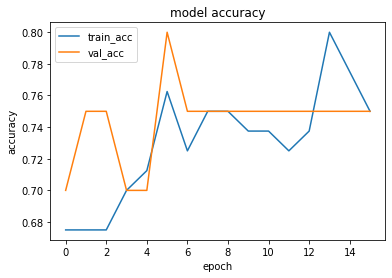

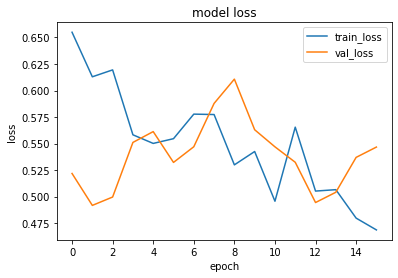

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.8118131]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.3344695]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.92121863]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.4683897]]


1it [00:00, 11491.24it/s]


prediction for video control_2.mov is [[0.22284788]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.23477948]]


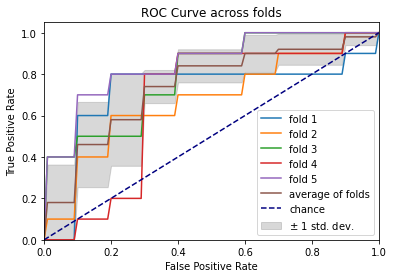

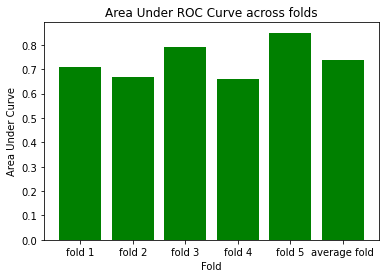

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7175 - accuracy: 0.4375 - precision: 0.4444 - recall: 0.5000 - val_loss: 0.7219 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6517 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.6290 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6027 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.5767 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5725 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5677 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 134

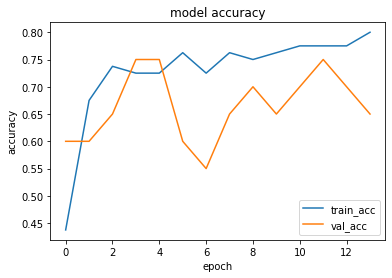

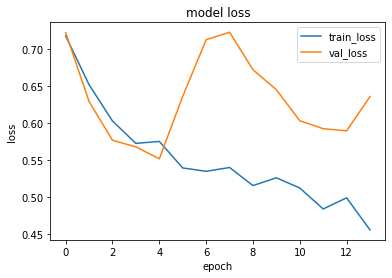

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.57751757]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.5268769]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.7470446]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.4882018]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.33119762]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.3886576]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 171ms/step - loss: 0.7872 - accuracy: 0.4125 - precision: 0.4286 - recall: 0.5250 - val_loss: 0.6465 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6450 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6474 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6534 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6147 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6002 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6349 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

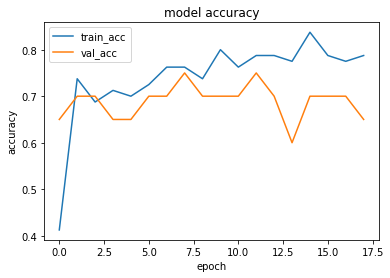

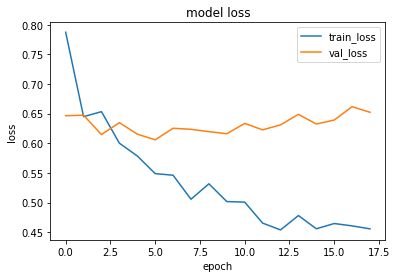

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.6656526]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.200438]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8409084]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.34076947]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.29354447]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.23429826]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.8123 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6250 - val_loss: 0.6855 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6660 - accuracy: 0.6125 - precision: 0.7647 - recall: 0.3250 - val_loss: 0.6804 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6209 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6438 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5889 - accuracy: 0.7500 - precision: 0.7083 - recall: 0.8500 - val_loss: 0.6547 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

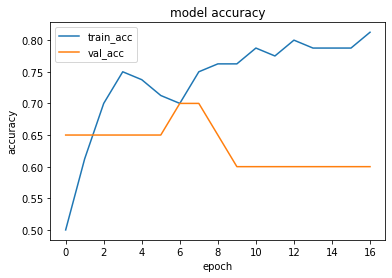

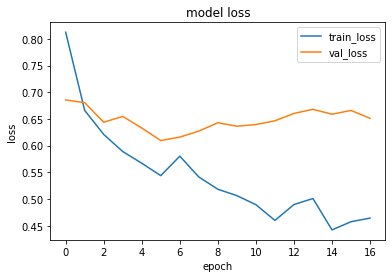

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.17600507]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.7439953]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.7776171]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.15375859]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.15144473]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.15104538]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6695 - accuracy: 0.5250 - precision: 0.5192 - recall: 0.6750 - val_loss: 0.7938 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.7434 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.6519 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 126ms/step - loss: 0.6126 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.6322 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5859 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6230 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

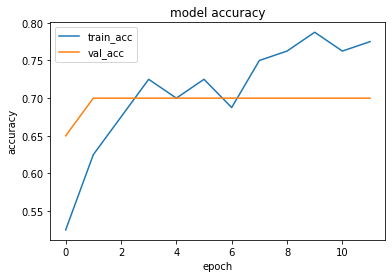

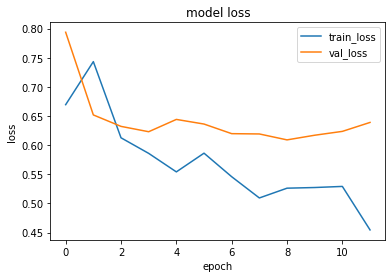

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.69374937]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.2839712]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.77142924]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.47001147]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.2621036]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.28275117]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7282 - accuracy: 0.5125 - precision: 0.5116 - recall: 0.5500 - val_loss: 0.7717 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6569 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.6291 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5939 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6091 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5627 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.5932 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

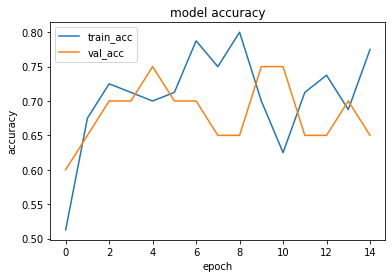

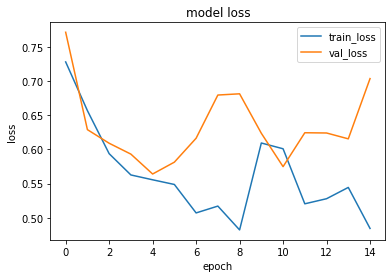

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.49351096]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_3.mov is [[0.6366873]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.63529587]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.11391112]]


1it [00:00, 17924.38it/s]


prediction for video control_2.mov is [[0.11107379]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.11137256]]


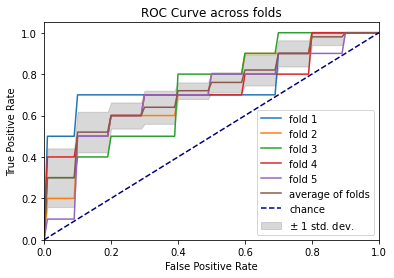

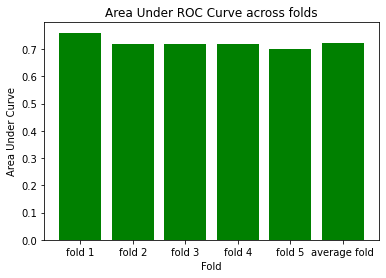

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7013 - accuracy: 0.5375 - precision: 0.5319 - recall: 0.6250 - val_loss: 0.6317 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6418 - accuracy: 0.6625 - precision: 0.7097 - recall: 0.5500 - val_loss: 0.6256 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6263 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.5606 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5990 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.5471 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 127

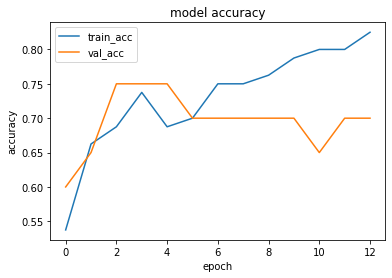

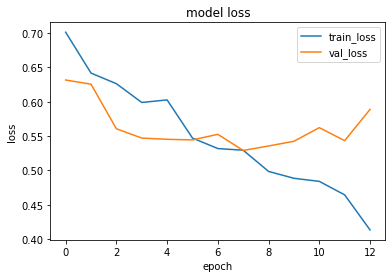

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.5357095]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.6092776]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.66611385]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.3803767]]


1it [00:00, 14563.56it/s]


prediction for video control_2.mov is [[0.29933232]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.22726509]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6814 - accuracy: 0.5250 - precision: 0.5179 - recall: 0.7250 - val_loss: 0.8228 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5401 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.8138 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5021 - accuracy: 0.8125 - precision: 0.8205 - recall: 0.8000 - val_loss: 0.8407 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.4970 - accuracy: 0.7875 - precision: 0.7949 - recall: 0.7750 - val_loss: 0.8838 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epo

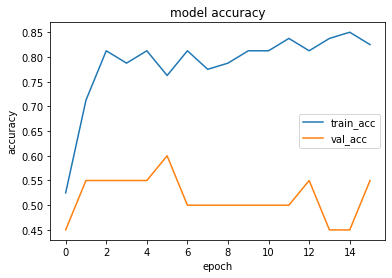

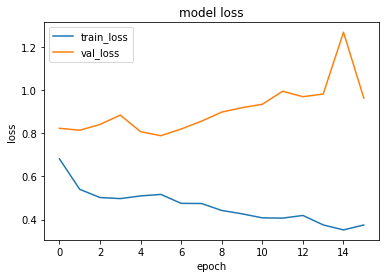

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.3488082]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.07305869]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.7415973]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.17767054]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.18006301]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.17595348]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.8398 - accuracy: 0.4625 - precision: 0.4286 - recall: 0.2250 - val_loss: 0.6642 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6641 - accuracy: 0.5125 - precision: 0.5067 - recall: 0.9500 - val_loss: 0.6853 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6441 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6224 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5932 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5904 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epo

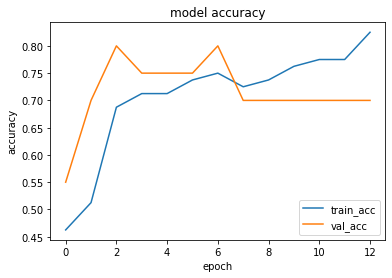

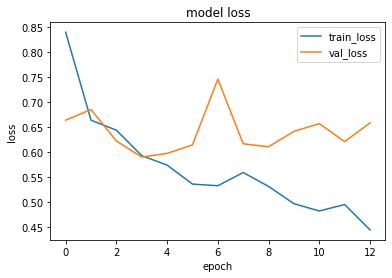

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.541631]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.51242733]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.60837996]]


1it [00:00, 6482.70it/s]


prediction for video control_1.mov is [[0.48078322]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.43944427]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.4522091]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 329ms/step - loss: 0.7161 - accuracy: 0.5375 - precision: 0.5263 - recall: 0.7500 - val_loss: 0.6282 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 1s 374ms/step - loss: 0.6205 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5706 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 1s 306ms/step - loss: 0.6327 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.5591 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 1s 300ms/step - loss: 0.6348 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5434 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoc

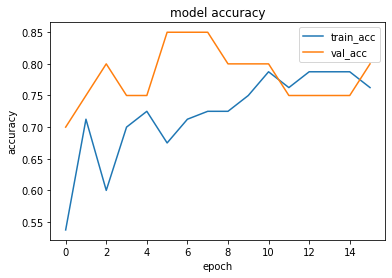

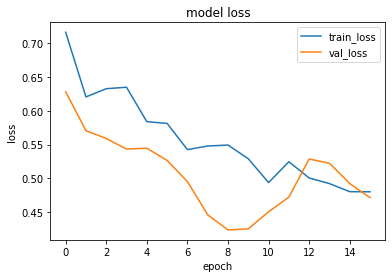

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.57511556]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_3.mov is [[0.59569687]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.6352464]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.44920817]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.3648824]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.32519728]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6967 - accuracy: 0.6000 - precision: 0.5800 - recall: 0.7250 - val_loss: 0.6366 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6579 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.5722 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6147 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.5413 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5950 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.5425 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

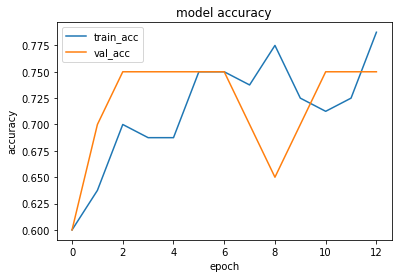

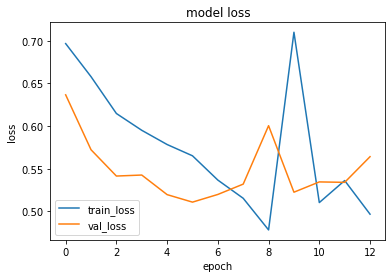

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.5277752]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.45930913]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.6599573]]


1it [00:00, 6678.83it/s]


prediction for video control_1.mov is [[0.27179825]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.21650478]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.22079623]]


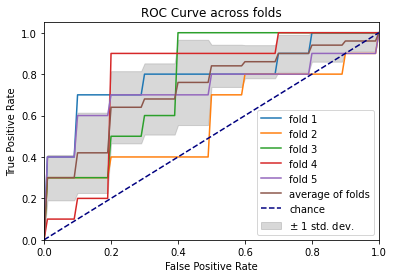

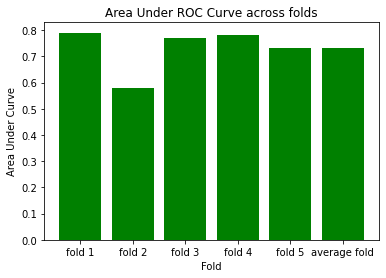

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.7307 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5750 - val_loss: 0.6478 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6235 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.6483 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5808 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6089 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5493 - accuracy: 0.7750 - precision: 0.7750 - recall: 0.7750 - val_loss: 0.6175 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 128

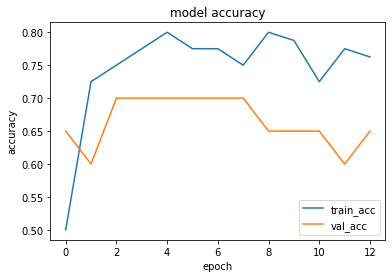

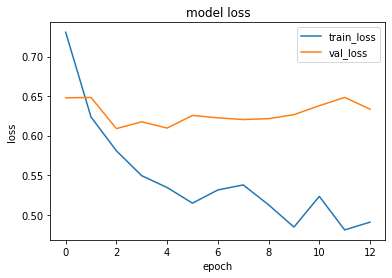

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.51821965]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.51721436]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.66904503]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.40741235]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.36591193]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.34237826]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6597 - accuracy: 0.5125 - precision: 0.5098 - recall: 0.6500 - val_loss: 0.5922 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6384 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.6892 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5618 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.7211 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5782 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6221 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

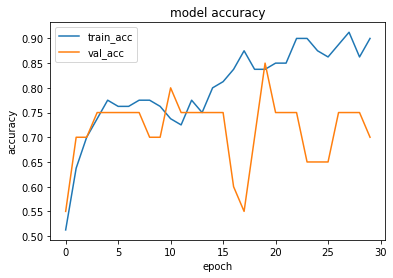

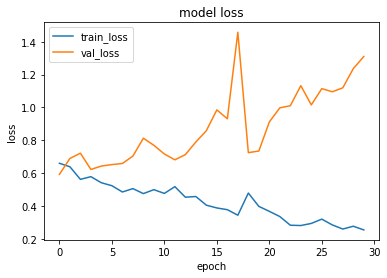

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.681692]]


1it [00:00, 2038.05it/s]


prediction for video armflapping_3.mov is [[0.32217258]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.49392673]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.11240655]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.5013138]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.5009102]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6963 - accuracy: 0.4625 - precision: 0.4667 - recall: 0.5250 - val_loss: 0.7341 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6278 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6671 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6048 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.8184 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5921 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.7302 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoc

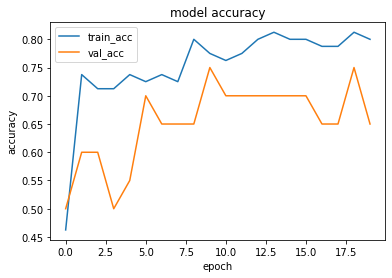

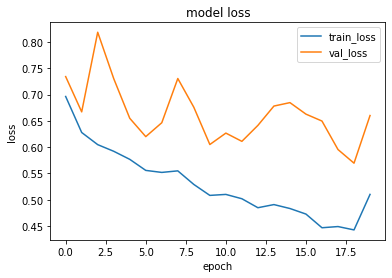

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.2142924]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5436029]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.3277074]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.20928785]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.20721766]]


1it [00:00, 13486.51it/s]


prediction for video control_3.mov is [[0.20695853]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7157 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5500 - val_loss: 0.6792 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7084 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.6363 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6024 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6306 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5688 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6473 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

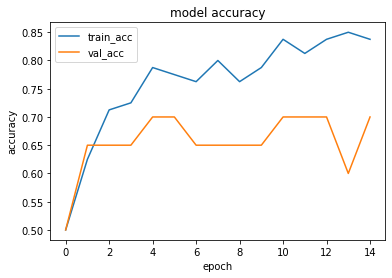

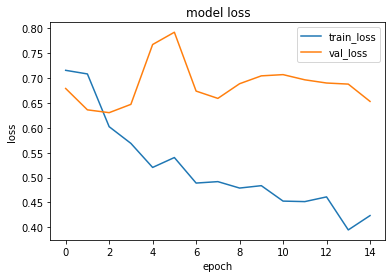

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.7384728]]


1it [00:00, 17623.13it/s]


prediction for video armflapping_3.mov is [[0.22097677]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.80568755]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.581368]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.21184963]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2952328]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7035 - accuracy: 0.4750 - precision: 0.4688 - recall: 0.3750 - val_loss: 0.6199 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6544 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6009 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6043 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.5942 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 1s 229ms/step - loss: 0.5813 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.5584 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoc

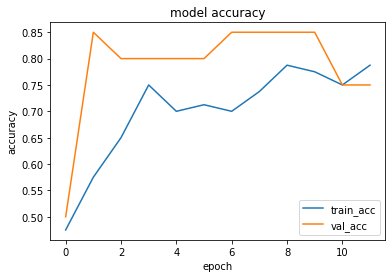

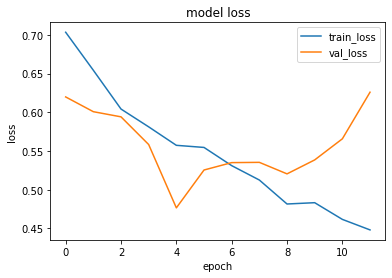

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.5199711]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.36369732]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.7661457]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.38016346]]


1it [00:00, 13934.56it/s]


prediction for video control_2.mov is [[0.3213733]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.33115155]]


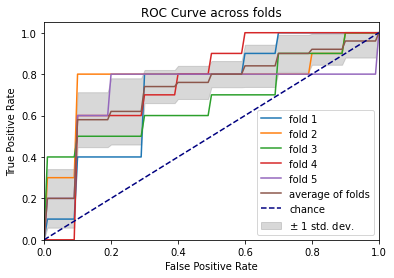

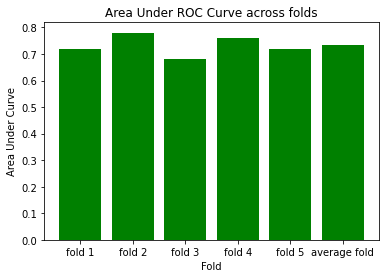

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6608 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.6270 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6861 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.5991 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6264 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.5547 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5746 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5640 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 130

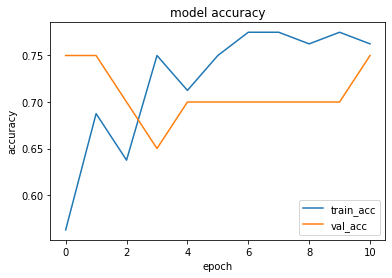

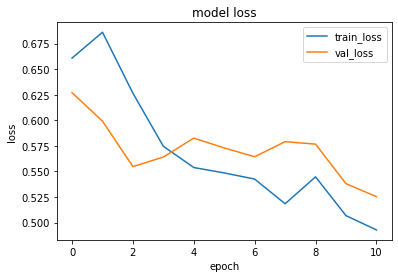

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.50366044]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.4786704]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_2.mov is [[0.5554972]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.48446125]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.4740563]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.48447594]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 140ms/step - loss: 0.6352 - accuracy: 0.6500 - precision: 0.6500 - recall: 0.6500 - val_loss: 0.8178 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6514 - accuracy: 0.7250 - precision: 0.6452 - recall: 1.0000 - val_loss: 0.6297 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5997 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.6847 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5888 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.6039 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

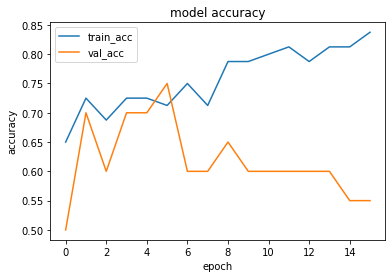

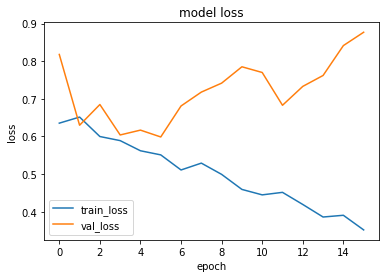

1it [00:00, 15477.14it/s]


prediction for video armflapping_1.mov is [[0.37926206]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.32177204]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.8147805]]


1it [00:00, 6326.25it/s]


prediction for video control_1.mov is [[0.30214533]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.23952669]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.24444908]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.7423 - accuracy: 0.5375 - precision: 0.5789 - recall: 0.2750 - val_loss: 0.6602 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6381 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6133 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6097 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5745 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6031 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.5829 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

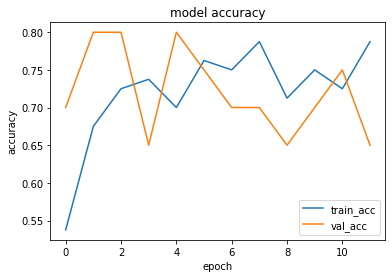

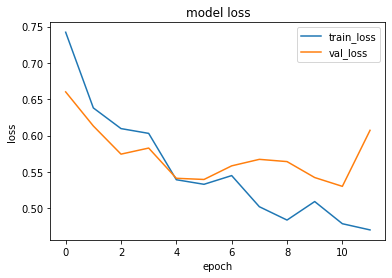

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5415509]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.52933884]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.62285775]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.4854336]]


1it [00:00, 16320.25it/s]


prediction for video control_2.mov is [[0.45033267]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.45832205]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.7748 - accuracy: 0.4875 - precision: 0.4898 - recall: 0.6000 - val_loss: 0.6933 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 238ms/step - loss: 0.6795 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6452 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6314 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6172 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6193 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5885 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

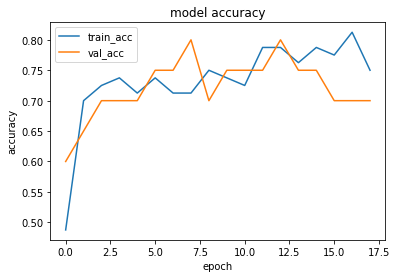

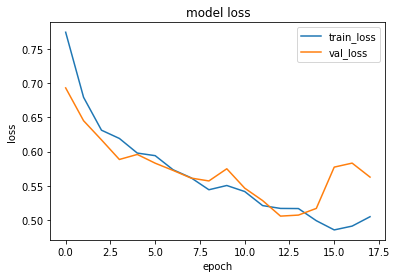

1it [00:00, 12300.01it/s]


prediction for video armflapping_1.mov is [[0.7018763]]


1it [00:00, 10010.27it/s]


prediction for video armflapping_3.mov is [[0.36791366]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.77116823]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.46954525]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.2269201]]


1it [00:00, 13486.51it/s]


prediction for video control_3.mov is [[0.22415277]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6661 - accuracy: 0.5875 - precision: 0.5946 - recall: 0.5500 - val_loss: 0.8409 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 198ms/step - loss: 0.7653 - accuracy: 0.5750 - precision: 0.5484 - recall: 0.8500 - val_loss: 0.6136 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6044 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6466 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6214 - accuracy: 0.7125 - precision: 0.8148 - recall: 0.5500 - val_loss: 0.5905 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

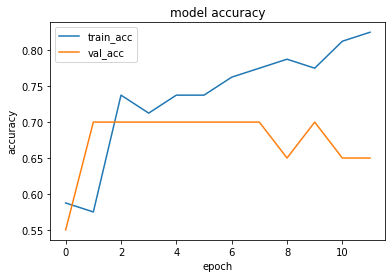

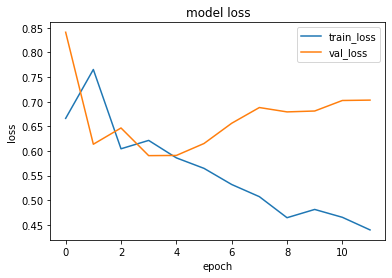

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.52018]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.18134406]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.83608705]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.2583322]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.2716734]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.31148618]]


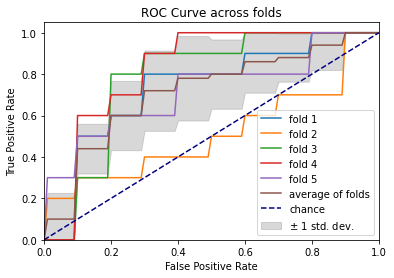

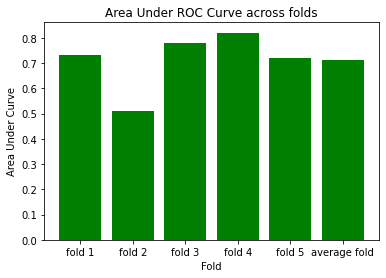

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7228 - accuracy: 0.5125 - precision: 0.5094 - recall: 0.6750 - val_loss: 0.6427 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6204 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.6187 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6039 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6268 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5421 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.6202 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 133

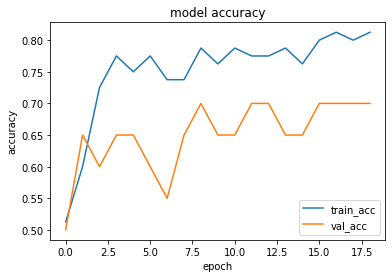

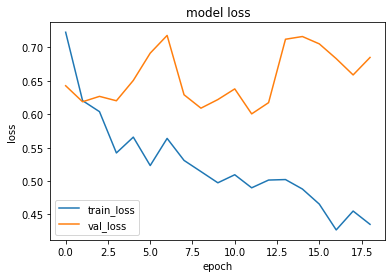

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.52149177]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.4594238]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_2.mov is [[0.64580107]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.42400786]]


1it [00:00, 7516.67it/s]


prediction for video control_2.mov is [[0.29887104]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.32755947]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7102 - accuracy: 0.5750 - precision: 0.5682 - recall: 0.6250 - val_loss: 0.6673 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5981 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.6679 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5611 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.6697 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5574 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6975 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

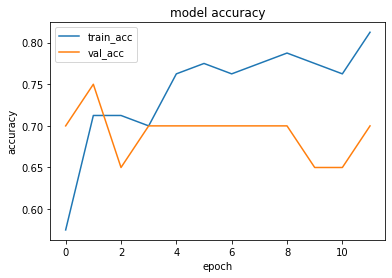

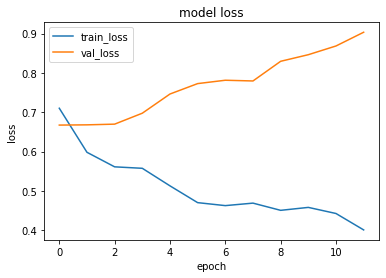

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.6160552]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.66117716]]


1it [00:00, 12633.45it/s]


prediction for video armflapping_2.mov is [[0.7574588]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.4715915]]


1it [00:00, 19599.55it/s]


prediction for video control_2.mov is [[0.41667384]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.37799394]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6958 - accuracy: 0.5375 - precision: 0.5429 - recall: 0.4750 - val_loss: 0.6012 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6460 - accuracy: 0.6000 - precision: 0.5690 - recall: 0.8250 - val_loss: 0.5521 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6074 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.4947 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5737 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.4213 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

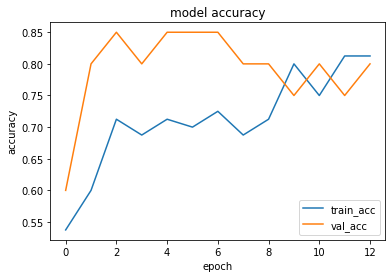

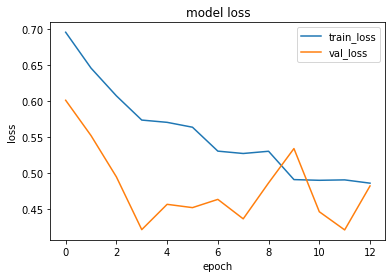

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.52621967]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.48493457]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.6110268]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.46818304]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.36869395]]


1it [00:00, 12826.62it/s]


prediction for video control_3.mov is [[0.4161017]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.8130 - accuracy: 0.4875 - precision: 0.4783 - recall: 0.2750 - val_loss: 0.6799 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6305 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.6857 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5999 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.6935 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5746 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.7068 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

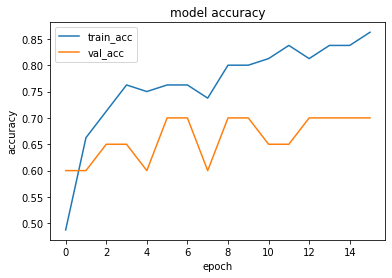

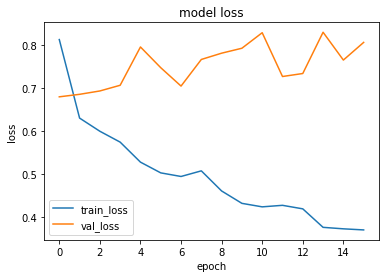

1it [00:00, 16320.25it/s]


prediction for video armflapping_1.mov is [[0.74956286]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.20485029]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.7676659]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.1152671]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.11100945]]


1it [00:00, 13662.23it/s]


prediction for video control_3.mov is [[0.11111313]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7178 - accuracy: 0.4625 - precision: 0.4681 - recall: 0.5500 - val_loss: 0.9027 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6822 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.7236 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5890 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6872 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6124 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.6855 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epo

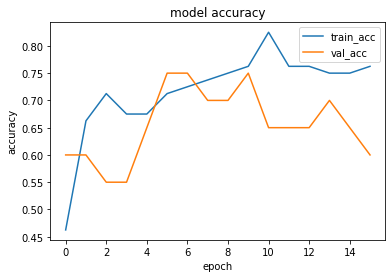

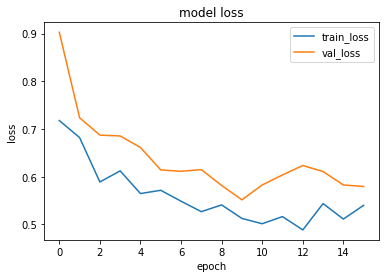

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.55752504]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.45153162]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.62456536]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.17650244]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.17161322]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.17507806]]


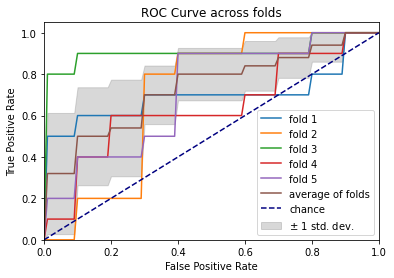

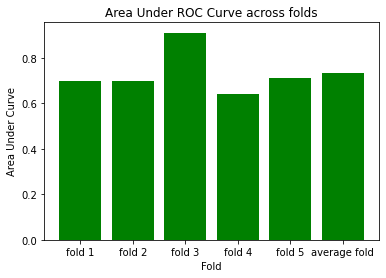

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7053 - accuracy: 0.5250 - precision: 0.5200 - recall: 0.6500 - val_loss: 0.6390 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6846 - accuracy: 0.6250 - precision: 0.8571 - recall: 0.3000 - val_loss: 0.5975 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6257 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.6335 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5941 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6743 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 146

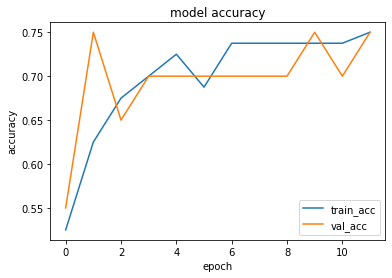

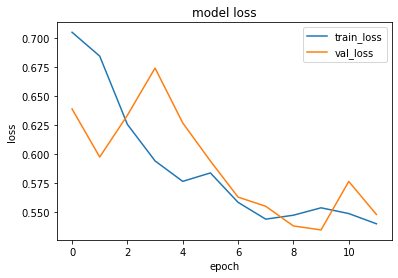

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.48814824]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.47146425]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.5472305]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.45971566]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.44685015]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.44041198]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.8224 - accuracy: 0.4125 - precision: 0.3600 - recall: 0.2250 - val_loss: 0.6910 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6468 - accuracy: 0.6125 - precision: 0.5789 - recall: 0.8250 - val_loss: 0.5980 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6368 - accuracy: 0.6625 - precision: 0.6140 - recall: 0.8750 - val_loss: 0.5908 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6029 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6013 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

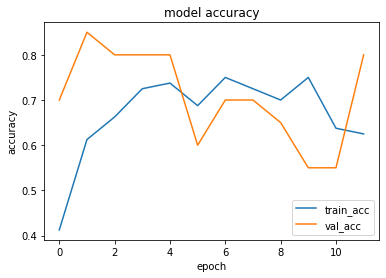

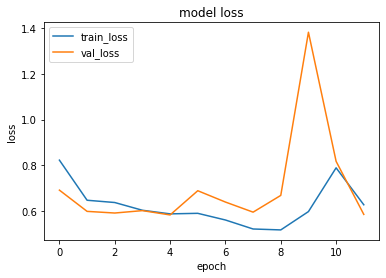

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5905623]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.56639695]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_2.mov is [[0.6807802]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.5345738]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.50267935]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.4948266]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 350ms/step - loss: 0.7229 - accuracy: 0.5625 - precision: 0.5532 - recall: 0.6500 - val_loss: 0.6910 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 1s 420ms/step - loss: 0.6289 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6849 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 185ms/step - loss: 0.5868 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6942 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5359 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7026 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

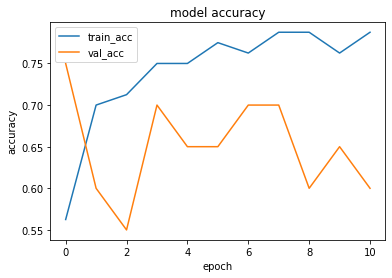

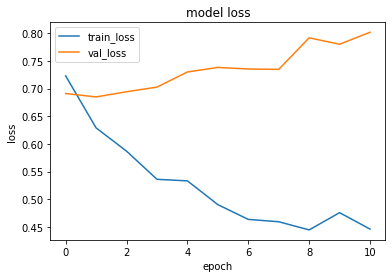

1it [00:00, 16710.37it/s]


prediction for video armflapping_1.mov is [[0.32950154]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5166672]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_2.mov is [[0.76055396]]


1it [00:00, 6452.78it/s]


prediction for video control_1.mov is [[0.21465719]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.1839602]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.18214357]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7840 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4750 - val_loss: 0.7064 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6476 - accuracy: 0.6500 - precision: 0.6000 - recall: 0.9000 - val_loss: 0.6737 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5778 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6816 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5815 - accuracy: 0.7750 - precision: 0.7895 - recall: 0.7500 - val_loss: 0.7090 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

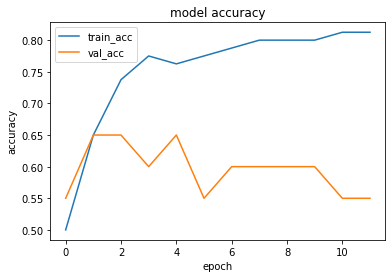

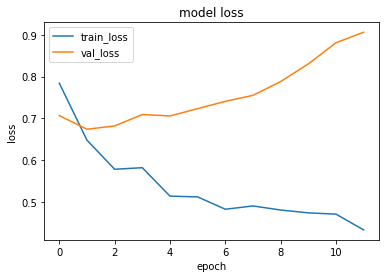

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.7531389]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.2261312]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_2.mov is [[0.9186376]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.2631826]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.21670693]]


1it [00:00, 13315.25it/s]


prediction for video control_3.mov is [[0.21541262]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7261 - accuracy: 0.5875 - precision: 0.5686 - recall: 0.7250 - val_loss: 0.6092 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6076 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6645 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6043 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6224 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5741 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5936 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epo

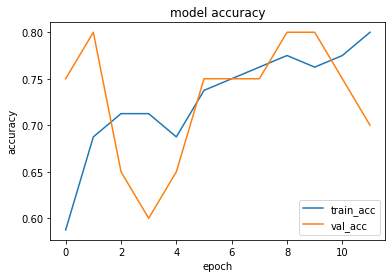

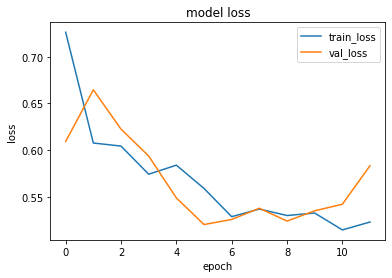

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.29641274]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.39868838]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_2.mov is [[0.6731645]]


1it [00:00, 12052.60it/s]


prediction for video control_1.mov is [[0.18659496]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.16906846]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.16683719]]


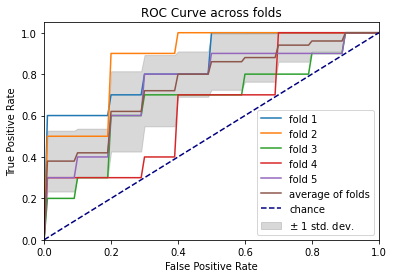

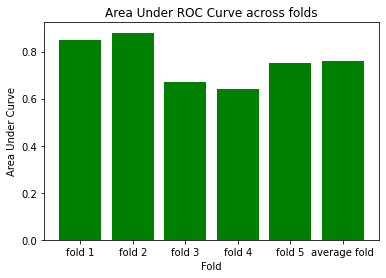

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7541 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7500 - val_loss: 0.5844 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6716 - accuracy: 0.6250 - precision: 0.7500 - recall: 0.3750 - val_loss: 0.5108 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6150 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.4486 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5965 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.4133 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 135

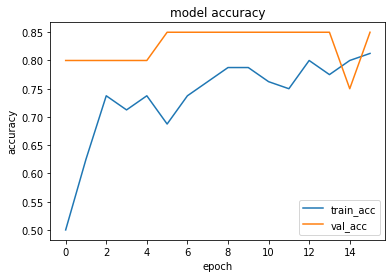

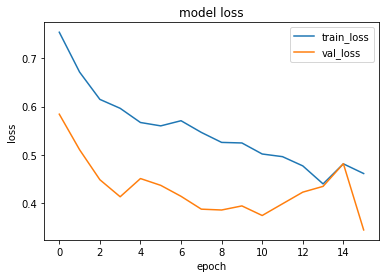

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.5941733]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.5906223]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.71767]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.4749809]]


1it [00:00, 19239.93it/s]


prediction for video control_2.mov is [[0.39638886]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.36215132]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6979 - accuracy: 0.5250 - precision: 0.5179 - recall: 0.7250 - val_loss: 0.5663 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6394 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.5949 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6395 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.5241 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 1s 195ms/step - loss: 0.5822 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.4885 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

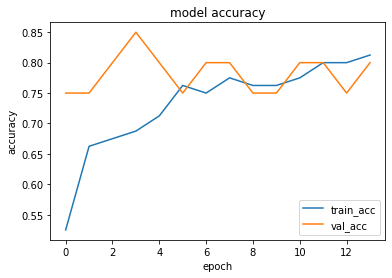

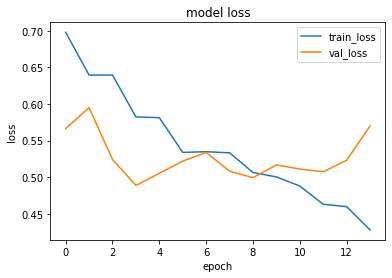

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.46758738]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.6030863]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.77076703]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.21767882]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.22700697]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.22633618]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6771 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.7004 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6110 - accuracy: 0.6375 - precision: 0.6341 - recall: 0.6500 - val_loss: 0.6573 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5909 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.7174 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5403 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7121 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

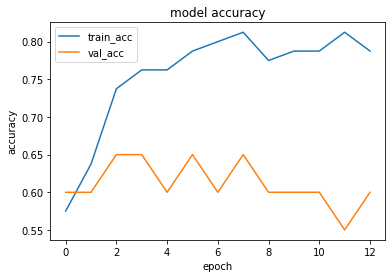

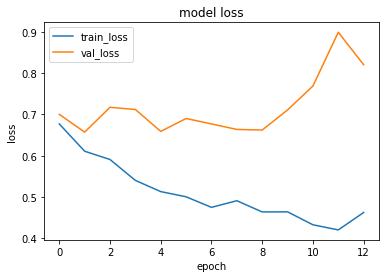

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.30189285]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.34712875]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.715681]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.18863976]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.17922878]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.1677607]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6775 - accuracy: 0.5625 - precision: 0.5472 - recall: 0.7250 - val_loss: 0.8740 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6404 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.8706 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5307 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.7818 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5169 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.7984 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoc

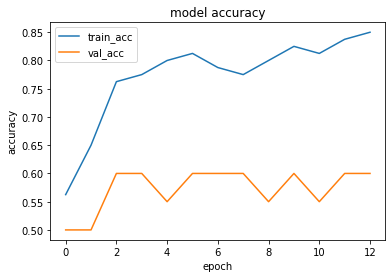

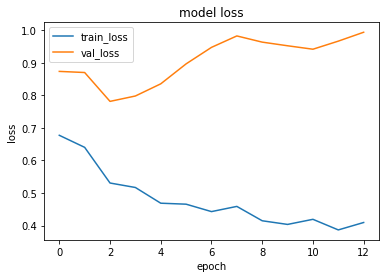

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.72978646]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.69639766]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.8930682]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.20477703]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.17826438]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.18134212]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 223ms/step - loss: 0.6515 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.7095 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5877 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.6366 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5808 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.6337 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5220 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.6270 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

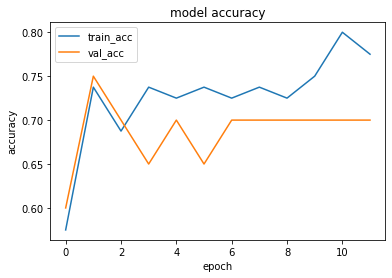

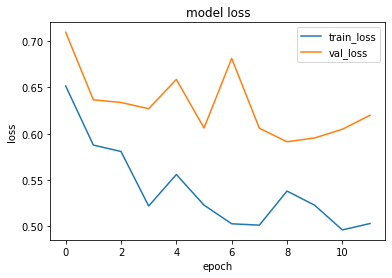

1it [00:00, 11748.75it/s]


prediction for video armflapping_1.mov is [[0.649843]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.39435762]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_2.mov is [[0.7449775]]


1it [00:00, 10180.35it/s]


prediction for video control_1.mov is [[0.40993017]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.21094403]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.21584883]]


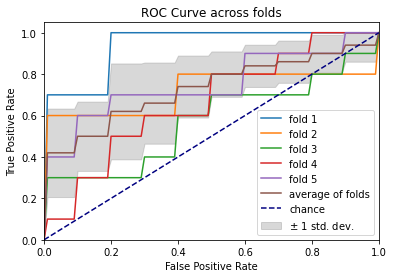

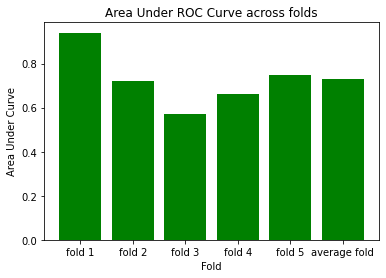

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.7358 - accuracy: 0.4625 - precision: 0.4571 - recall: 0.4000 - val_loss: 0.7279 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6337 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6332 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5754 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7253 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5574 - accuracy: 0.7250 - precision: 0.6731 - recall: 0.8750 - val_loss: 0.7400 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 127

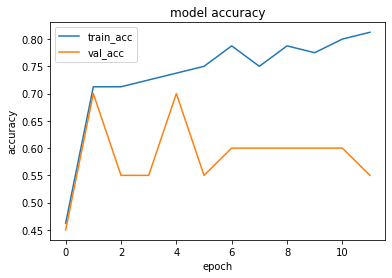

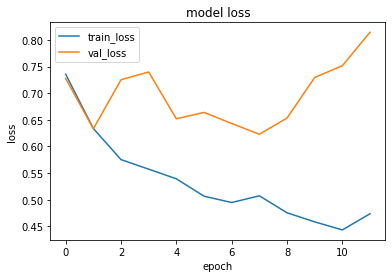

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.4915574]]


1it [00:00, 19152.07it/s]


prediction for video armflapping_3.mov is [[0.49142838]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.57388246]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.4505573]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.39537865]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.41969883]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7233 - accuracy: 0.5875 - precision: 0.5897 - recall: 0.5750 - val_loss: 0.5913 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6523 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.6242 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 213ms/step - loss: 0.6282 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.5772 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5898 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5035 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

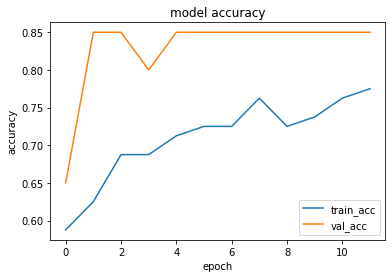

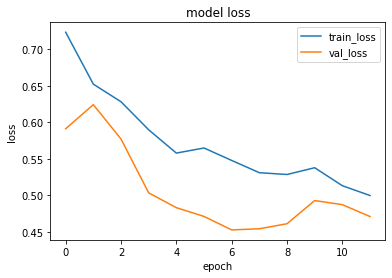

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.5105599]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.41300577]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.51224524]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.4842754]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.46588734]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.45688903]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6837 - accuracy: 0.5875 - precision: 0.5814 - recall: 0.6250 - val_loss: 0.6951 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6392 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6874 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5621 - accuracy: 0.7875 - precision: 0.7949 - recall: 0.7750 - val_loss: 0.7161 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5292 - accuracy: 0.8000 - precision: 0.7857 - recall: 0.8250 - val_loss: 0.8115 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

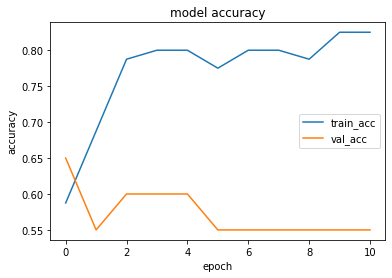

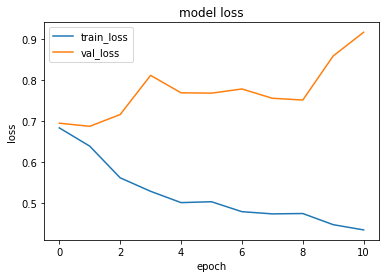

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5061392]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.44988188]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.87881494]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.08704925]]


1it [00:00, 12372.58it/s]


prediction for video control_2.mov is [[0.15481806]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.14129442]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 211ms/step - loss: 0.6834 - accuracy: 0.5500 - precision: 0.5476 - recall: 0.5750 - val_loss: 0.8206 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6422 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.7566 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5332 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.7580 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5007 - accuracy: 0.7875 - precision: 0.8286 - recall: 0.7250 - val_loss: 0.8748 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epo

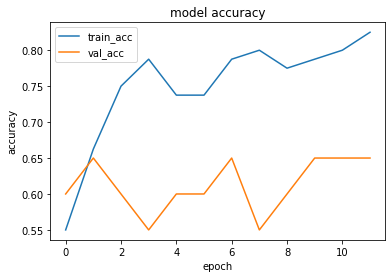

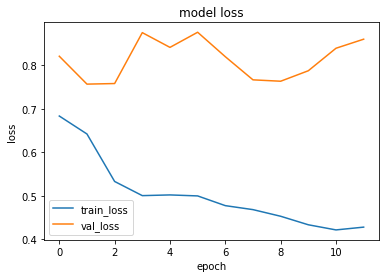

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5920091]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.40052193]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.756619]]


1it [00:00, 4401.16it/s]


prediction for video control_1.mov is [[0.15091285]]


1it [00:00, 12336.19it/s]


prediction for video control_2.mov is [[0.13168755]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.14100206]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6928 - accuracy: 0.5750 - precision: 0.5833 - recall: 0.5250 - val_loss: 0.6077 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6404 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.5112 - val_accuracy: 0.9500 - val_precision: 0.9091 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5869 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.4682 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5786 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.4548 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

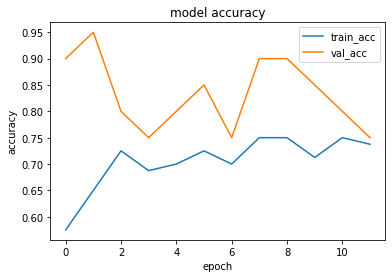

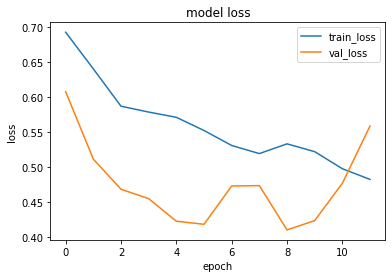

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.54962957]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.61004376]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_2.mov is [[0.6312347]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.48600727]]


1it [00:00, 10512.04it/s]


prediction for video control_2.mov is [[0.43886992]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.43458763]]


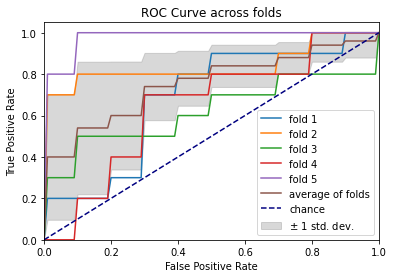

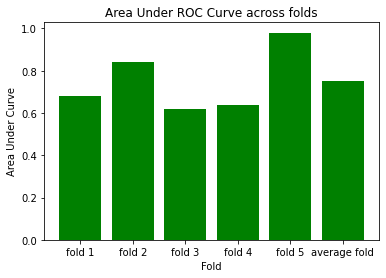

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7261 - accuracy: 0.4875 - precision: 0.4918 - recall: 0.7500 - val_loss: 0.7034 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6553 - accuracy: 0.6625 - precision: 0.7600 - recall: 0.4750 - val_loss: 0.6446 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6070 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6371 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5735 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6067 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 136

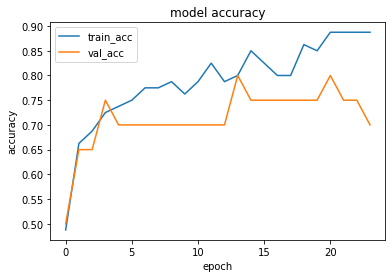

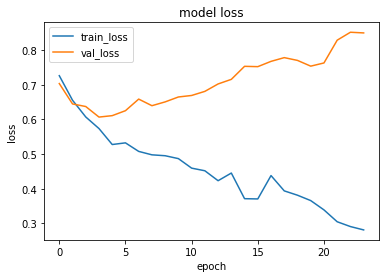

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.47790462]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.49360693]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.85944027]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.21556786]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.19382209]]


1it [00:00, 12633.45it/s]


prediction for video control_3.mov is [[0.18557867]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.8497 - accuracy: 0.4500 - precision: 0.4714 - recall: 0.8250 - val_loss: 0.7360 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6507 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6620 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6523 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.6438 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6100 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6470 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epo

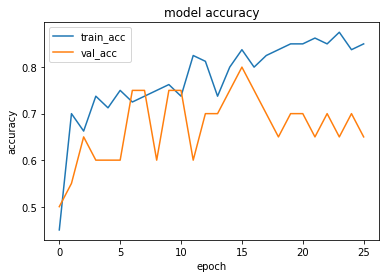

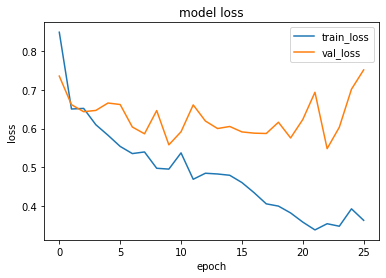

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.33315057]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.11212665]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.47988278]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.24035609]]


1it [00:00, 16194.22it/s]


prediction for video control_2.mov is [[0.22380021]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.22391817]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7286 - accuracy: 0.5375 - precision: 0.5294 - recall: 0.6750 - val_loss: 0.6245 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6380 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6139 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5939 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6195 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5744 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6181 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epo

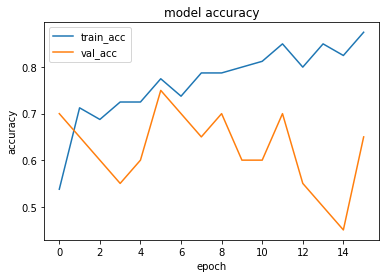

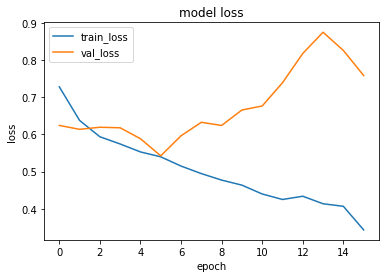

1it [00:00, 17549.39it/s]


prediction for video armflapping_1.mov is [[0.22686788]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.70761013]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.8080715]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.26499382]]


1it [00:00, 12520.31it/s]


prediction for video control_2.mov is [[0.2570703]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.24884897]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.8803 - accuracy: 0.4875 - precision: 0.4828 - recall: 0.3500 - val_loss: 0.6954 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6381 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6765 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5947 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6356 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5745 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6024 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

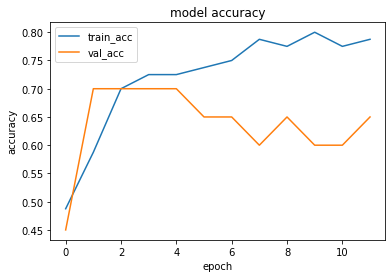

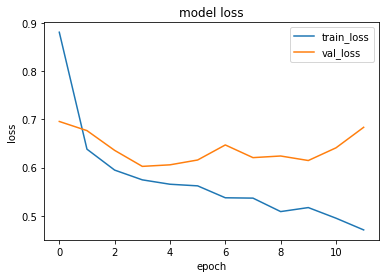

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.7999055]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.63427925]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.8929969]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.5324932]]


1it [00:00, 18236.10it/s]


prediction for video control_2.mov is [[0.2877146]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.276296]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6952 - accuracy: 0.6125 - precision: 0.5918 - recall: 0.7250 - val_loss: 0.6030 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.7263 - accuracy: 0.6125 - precision: 0.5789 - recall: 0.8250 - val_loss: 0.5801 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6391 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.5579 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6100 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5372 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch

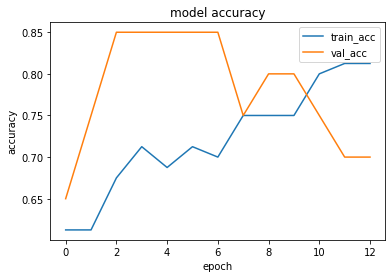

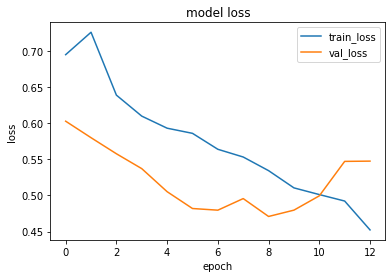

1it [00:00, 12945.38it/s]


prediction for video armflapping_1.mov is [[0.5083112]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.5116395]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5688228]]


1it [00:00, 14122.24it/s]


prediction for video control_1.mov is [[0.46345246]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.42978036]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.43899283]]


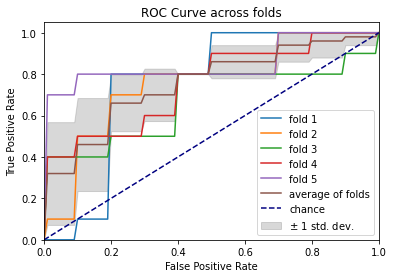

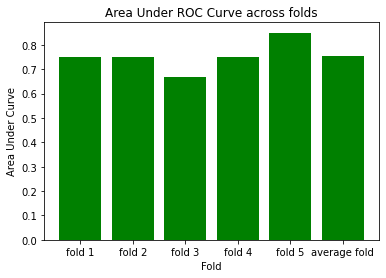

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7597 - accuracy: 0.5500 - precision: 0.5909 - recall: 0.3250 - val_loss: 0.6735 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6832 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.5825 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6328 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5436 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5955 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.4964 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 128

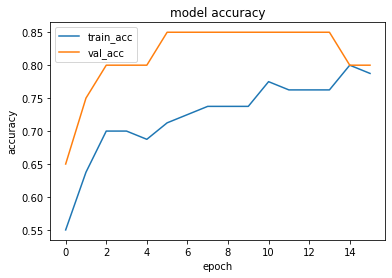

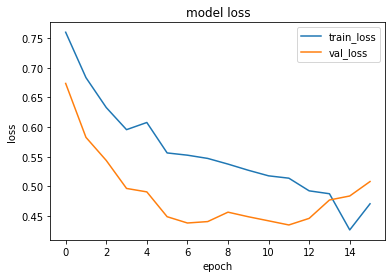

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.61192405]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_3.mov is [[0.6055449]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.74854594]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.3715973]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.269869]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.20964053]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7411 - accuracy: 0.4625 - precision: 0.4545 - recall: 0.3750 - val_loss: 0.7106 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6627 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.7701 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5955 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.7266 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5725 - accuracy: 0.7750 - precision: 0.8056 - recall: 0.7250 - val_loss: 0.7192 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epo

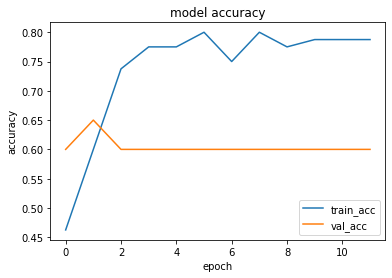

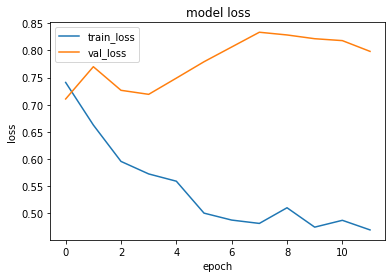

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4305271]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.40096754]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.72922975]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.28416488]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.24227527]]


1it [00:00, 11748.75it/s]


prediction for video control_3.mov is [[0.2677318]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7343 - accuracy: 0.5750 - precision: 0.5484 - recall: 0.8500 - val_loss: 0.6666 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6742 - accuracy: 0.6000 - precision: 0.7000 - recall: 0.3500 - val_loss: 0.6419 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5617 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.6237 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5939 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.7186 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoc

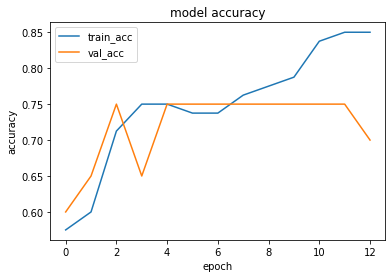

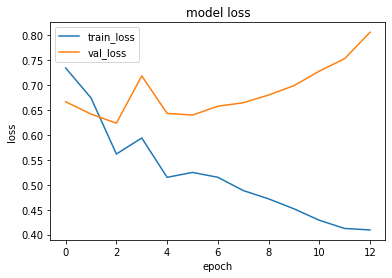

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.75102115]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.4648445]]


1it [00:00, 12336.19it/s]


prediction for video armflapping_2.mov is [[0.8938236]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.20361367]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.1784305]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.17749262]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 151ms/step - loss: 0.6675 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.6537 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5946 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6788 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5864 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.7102 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5214 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.6255 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

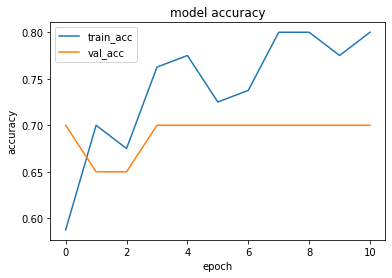

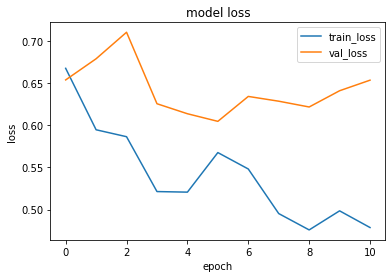

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.6570331]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.39661372]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_2.mov is [[0.83322287]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.33367229]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.23883113]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.21840331]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6617 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.5381 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6196 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5082 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6239 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5154 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5571 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.4764 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

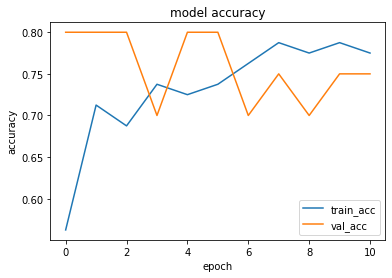

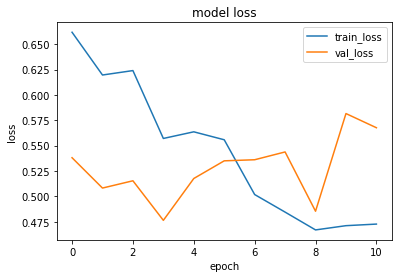

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.6231618]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.91504633]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.8952771]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.32178596]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.31181467]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.3269683]]


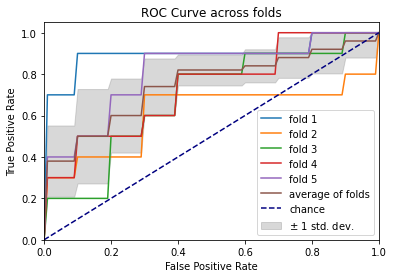

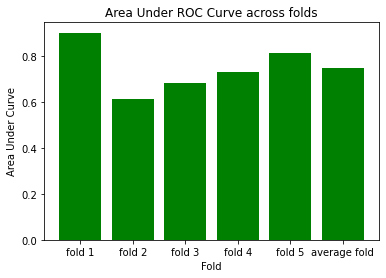

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.7323 - accuracy: 0.5625 - precision: 0.5556 - recall: 0.6250 - val_loss: 0.7374 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.7000 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.6019 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6149 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.5899 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6011 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5552 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 138

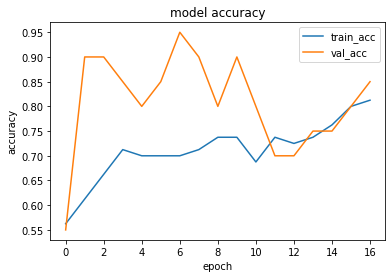

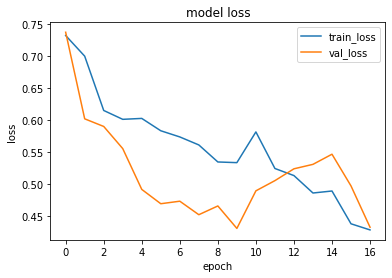

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.5054332]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_3.mov is [[0.57844937]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.6426567]]


1it [00:00, 16578.28it/s]


prediction for video control_1.mov is [[0.37314188]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.35542333]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.35453779]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 207ms/step - loss: 0.7484 - accuracy: 0.5250 - precision: 0.5143 - recall: 0.9000 - val_loss: 0.6227 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6974 - accuracy: 0.5625 - precision: 0.6190 - recall: 0.3250 - val_loss: 0.6689 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6591 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.5919 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6114 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.6049 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

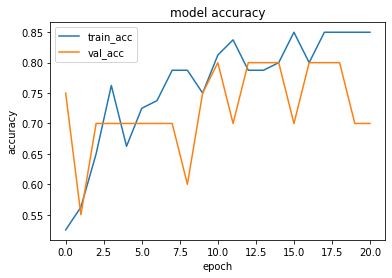

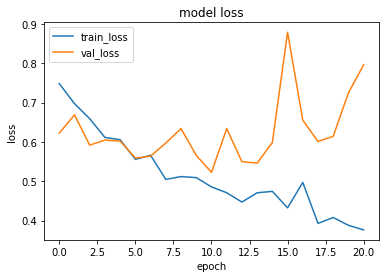

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.72189707]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.8956592]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.9605416]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.59641397]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.21372133]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.21344325]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6347 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6498 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5932 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.7279 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5889 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.7547 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5327 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6724 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

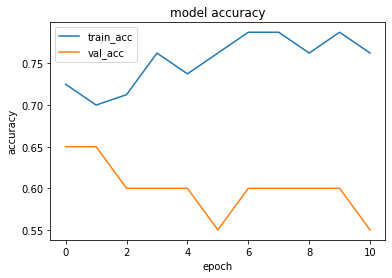

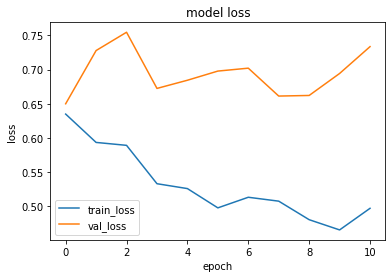

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.70606583]]


1it [00:00, 6543.38it/s]


prediction for video armflapping_3.mov is [[0.4419488]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.7855387]]


1it [00:00, 6898.53it/s]


prediction for video control_1.mov is [[0.33545732]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.31073076]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.20190713]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6736 - accuracy: 0.5625 - precision: 0.5556 - recall: 0.6250 - val_loss: 0.6502 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6219 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.5942 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5717 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.6091 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5669 - accuracy: 0.7250 - precision: 0.8462 - recall: 0.5500 - val_loss: 0.5959 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

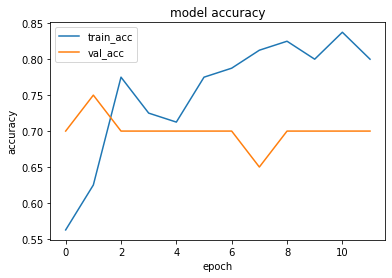

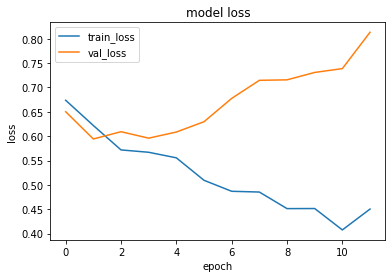

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.67631996]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.41326246]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.7374504]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.51299644]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.3176946]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.37839237]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6771 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.6714 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6672 - accuracy: 0.6500 - precision: 0.8750 - recall: 0.3500 - val_loss: 0.6603 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5775 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6780 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5618 - accuracy: 0.7875 - precision: 0.7447 - recall: 0.8750 - val_loss: 0.6813 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

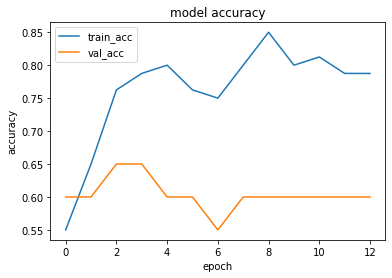

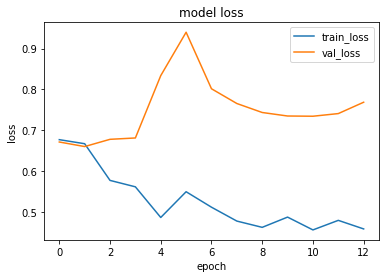

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.19789493]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.24330372]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.71693456]]


1it [00:00, 18808.54it/s]


prediction for video control_1.mov is [[0.18196198]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.17945054]]


1it [00:00, 10645.44it/s]


prediction for video control_3.mov is [[0.17890435]]


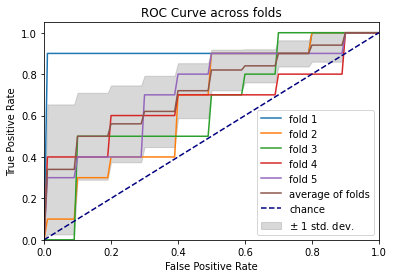

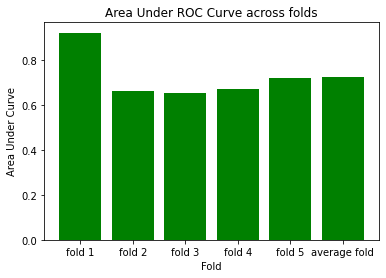

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 224ms/step - loss: 0.6663 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.6903 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6389 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.7251 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5693 - accuracy: 0.7875 - precision: 0.8966 - recall: 0.6500 - val_loss: 0.7276 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5249 - accuracy: 0.8000 - precision: 0.8000 - recall: 0.8000 - val_loss: 0.7424 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 131

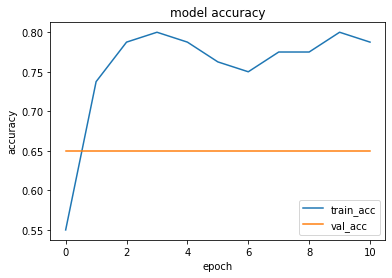

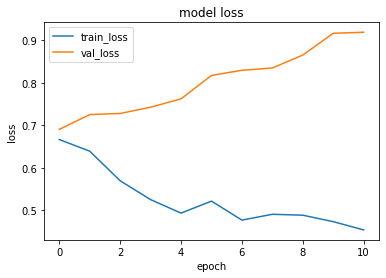

1it [00:00, 15477.14it/s]


prediction for video armflapping_1.mov is [[0.5963029]]


1it [00:00, 19152.07it/s]


prediction for video armflapping_3.mov is [[0.5585825]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6705735]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.5374448]]


1it [00:00, 12483.05it/s]


prediction for video control_2.mov is [[0.4959177]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.4964969]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6877 - accuracy: 0.5750 - precision: 0.5484 - recall: 0.8500 - val_loss: 0.6857 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6071 - accuracy: 0.6750 - precision: 0.6667 - recall: 0.7000 - val_loss: 0.6532 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5684 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6899 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5540 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7096 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoc

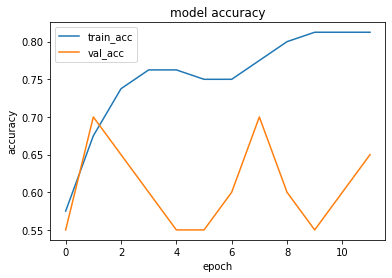

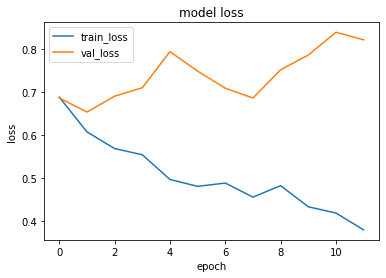

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.560832]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.6097699]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6555536]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.4704374]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.42225587]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.40233025]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6754 - accuracy: 0.6500 - precision: 0.6154 - recall: 0.8000 - val_loss: 0.6503 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6237 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6211 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7402 - accuracy: 0.5250 - precision: 0.5139 - recall: 0.9250 - val_loss: 0.5969 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6074 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6095 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epo

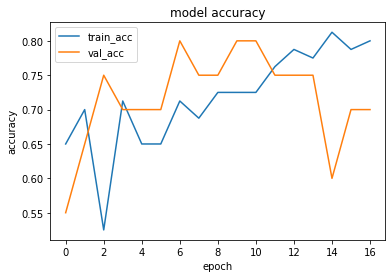

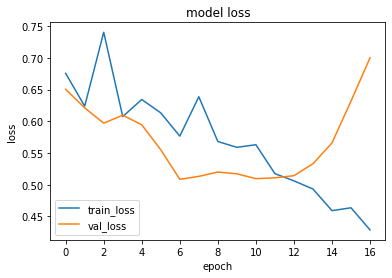

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4634972]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.49922517]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.5882295]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.33787298]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.263267]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.20242229]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7843 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.5904 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6485 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.5933 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6148 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.5743 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6007 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.5798 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

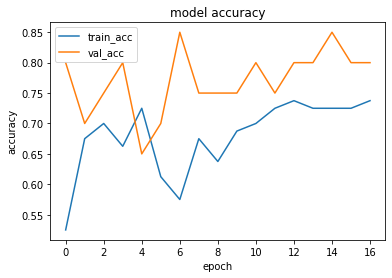

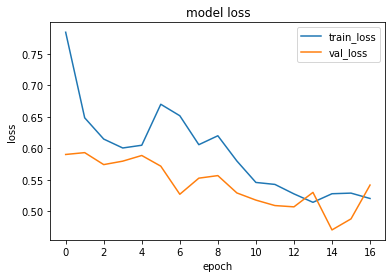

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.51446116]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.66954315]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.52828777]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.50206995]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.49855503]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.50050753]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6838 - accuracy: 0.4375 - precision: 0.4528 - recall: 0.6000 - val_loss: 0.6245 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6223 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.5973 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5830 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5913 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5460 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.5880 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

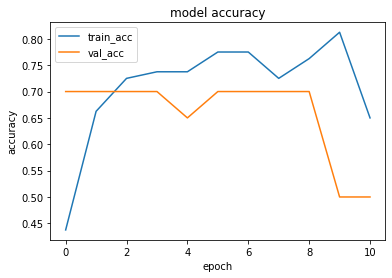

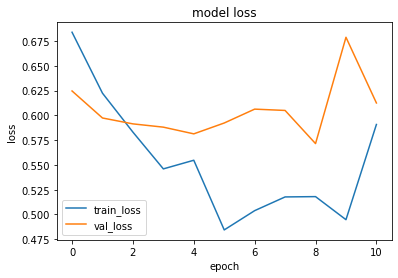

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5886431]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.67229235]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_2.mov is [[0.6078954]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.5564784]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.5484587]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.5488023]]


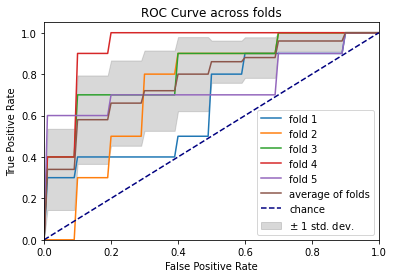

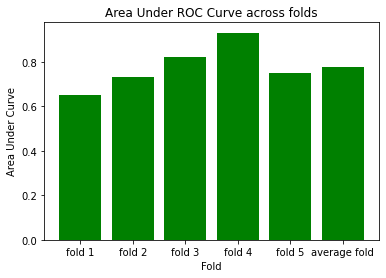

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7130 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5000 - val_loss: 0.6768 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 222ms/step - loss: 0.6062 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.7106 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5719 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6791 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5254 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.7418 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 133

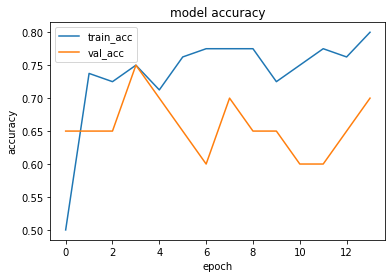

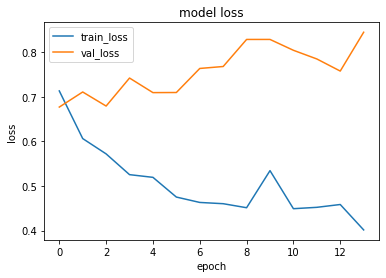

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.67674744]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.7300591]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_2.mov is [[0.7772147]]


1it [00:00, 6096.37it/s]


prediction for video control_1.mov is [[0.09781405]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.07909372]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.09017825]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6989 - accuracy: 0.5750 - precision: 0.5625 - recall: 0.6750 - val_loss: 0.5632 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6195 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.5715 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5994 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.4127 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6178 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.4578 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epo

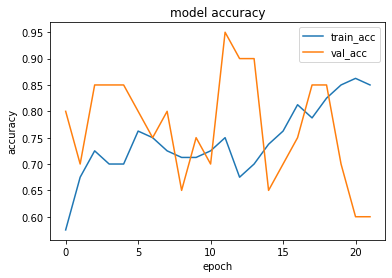

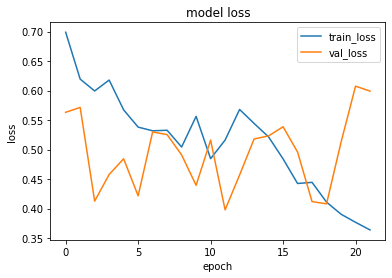

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.6032366]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.8220154]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.7093854]]


1it [00:00, 5777.28it/s]


prediction for video control_1.mov is [[0.2878163]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.23297831]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.3122366]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.8332 - accuracy: 0.4875 - precision: 0.4889 - recall: 0.5500 - val_loss: 0.6541 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6583 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6421 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6598 - accuracy: 0.6250 - precision: 0.7083 - recall: 0.4250 - val_loss: 0.5939 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6234 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.5521 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoc

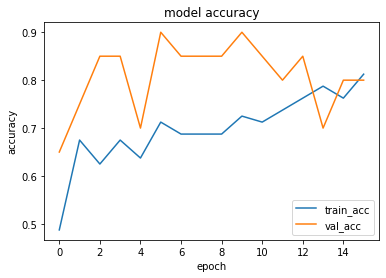

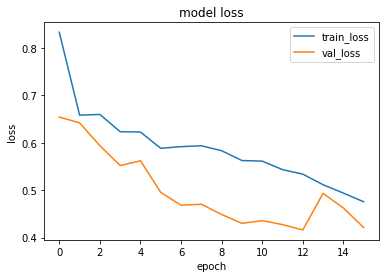

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.675215]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.7239375]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.82292056]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.3158028]]


1it [00:00, 19239.93it/s]


prediction for video control_2.mov is [[0.30844715]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.30916396]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7071 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.5924 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6422 - accuracy: 0.6375 - precision: 0.6667 - recall: 0.5500 - val_loss: 0.5746 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6284 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.5474 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6001 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.5369 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

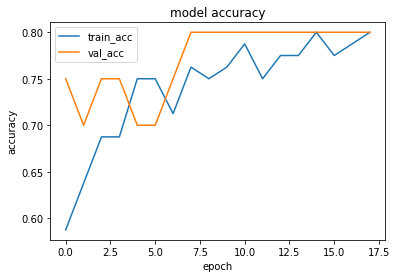

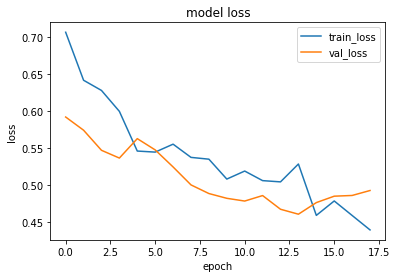

1it [00:00, 11748.75it/s]


prediction for video armflapping_1.mov is [[0.64610106]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.43370825]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.75779015]]


1it [00:00, 16384.00it/s]


prediction for video control_1.mov is [[0.353065]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.22373989]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.22147214]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7104 - accuracy: 0.4500 - precision: 0.4643 - recall: 0.6500 - val_loss: 0.7278 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 1s 200ms/step - loss: 0.6101 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.7778 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5111 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.9676 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5239 - accuracy: 0.8000 - precision: 0.8000 - recall: 0.8000 - val_loss: 0.9846 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epo

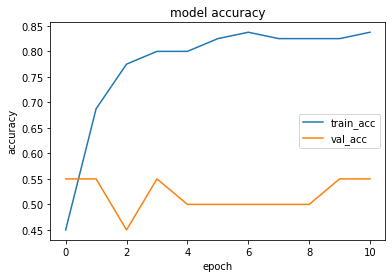

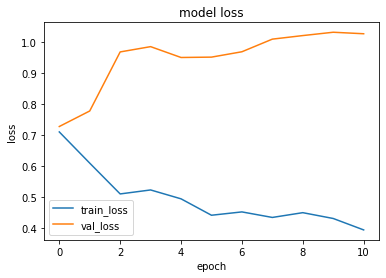

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.59355927]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.12199527]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.73687255]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.19656259]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.18087345]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.17887428]]


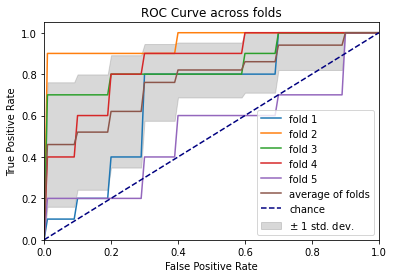

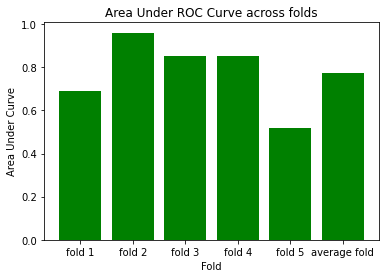

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7968 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8750 - val_loss: 0.6909 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6568 - accuracy: 0.6625 - precision: 0.8421 - recall: 0.4000 - val_loss: 0.6884 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5943 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.6980 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5624 - accuracy: 0.8000 - precision: 0.7727 - recall: 0.8500 - val_loss: 0.6756 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 131

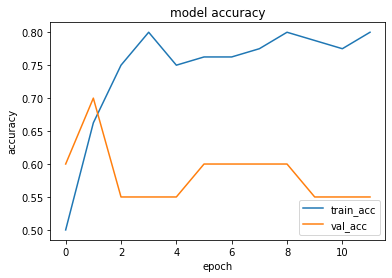

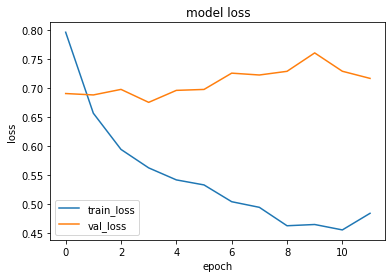

1it [00:00, 16384.00it/s]


prediction for video armflapping_1.mov is [[0.4859772]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.4305731]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.5352078]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.4756261]]


1it [00:00, 12945.38it/s]


prediction for video control_2.mov is [[0.47533634]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.4746097]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.8151 - accuracy: 0.4250 - precision: 0.4464 - recall: 0.6250 - val_loss: 0.6543 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6412 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.6224 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6255 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6159 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5691 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.5645 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoc

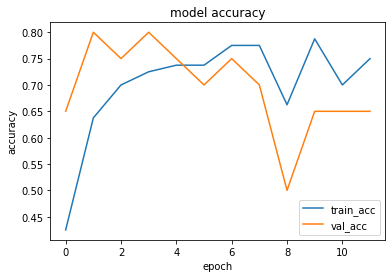

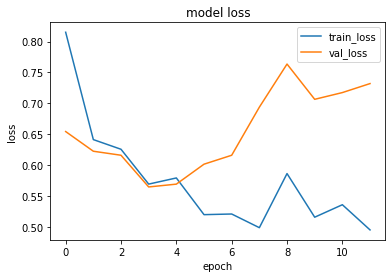

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.52466637]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_3.mov is [[0.51052016]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.58593094]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.48113075]]


1it [00:00, 17924.38it/s]


prediction for video control_2.mov is [[0.46214765]]


1it [00:00, 12483.05it/s]


prediction for video control_3.mov is [[0.4585735]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7249 - accuracy: 0.5375 - precision: 0.5294 - recall: 0.6750 - val_loss: 0.6072 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 190ms/step - loss: 0.6741 - accuracy: 0.5750 - precision: 0.6071 - recall: 0.4250 - val_loss: 0.5661 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 1s 330ms/step - loss: 0.6331 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.4825 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 1s 227ms/step - loss: 0.6220 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.4760 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoc

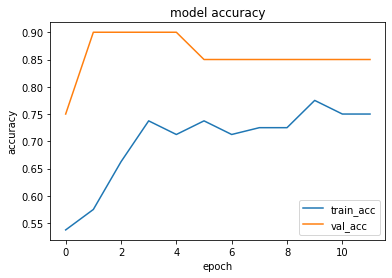

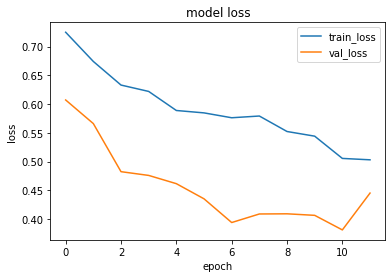

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.48126337]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.5439649]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_2.mov is [[0.5245627]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.46026558]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.45666867]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.4409032]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6409 - accuracy: 0.6125 - precision: 0.5849 - recall: 0.7750 - val_loss: 0.8088 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7080 - accuracy: 0.5750 - precision: 0.7500 - recall: 0.2250 - val_loss: 0.7556 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5767 - accuracy: 0.7250 - precision: 0.6800 - recall: 0.8500 - val_loss: 0.6778 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5460 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6687 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6

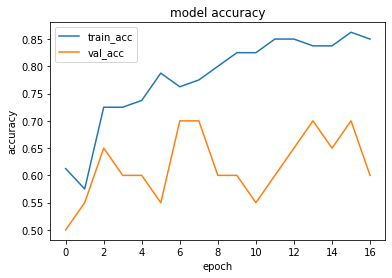

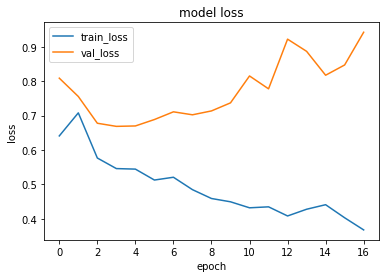

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.77865416]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.17912486]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.9569508]]


1it [00:00, 22192.08it/s]


prediction for video control_1.mov is [[0.13931099]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.33849418]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.35204872]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7179 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6250 - val_loss: 0.7085 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.7440 - accuracy: 0.5375 - precision: 0.7143 - recall: 0.1250 - val_loss: 0.6450 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6622 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.5996 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6211 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.5839 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.

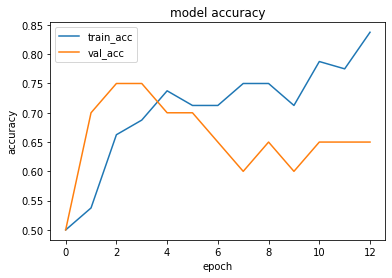

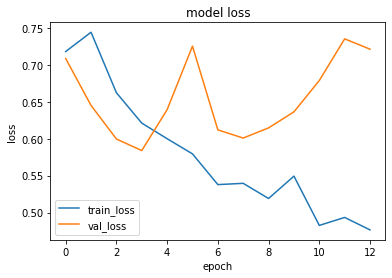

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.14461285]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.43554443]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.1736998]]


1it [00:00, 13530.01it/s]


prediction for video control_1.mov is [[0.13857657]]


1it [00:00, 19239.93it/s]


prediction for video control_2.mov is [[0.13674039]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.13660079]]


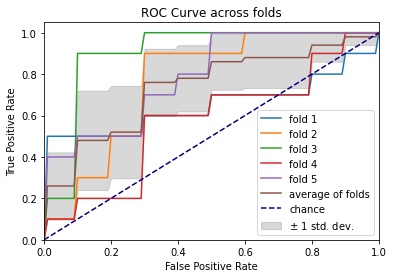

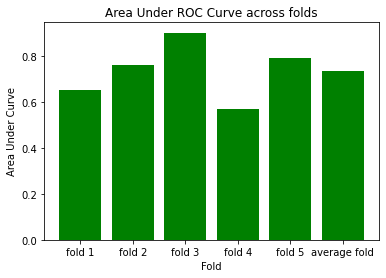

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6648 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.7972 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6757 - accuracy: 0.5750 - precision: 0.6875 - recall: 0.2750 - val_loss: 0.6777 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6113 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.6717 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5818 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6345 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] 

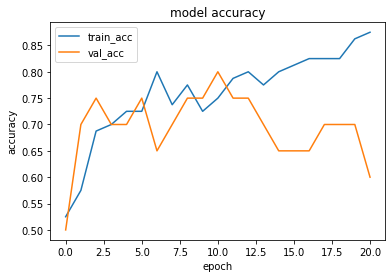

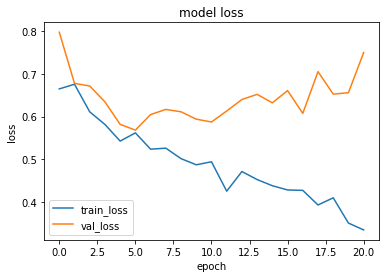

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.3747527]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_3.mov is [[0.41155347]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.76162183]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.28994635]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.26832563]]


1it [00:00, 3521.67it/s]


prediction for video control_3.mov is [[0.26624548]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 181ms/step - loss: 0.7212 - accuracy: 0.4250 - precision: 0.4286 - recall: 0.4500 - val_loss: 0.6184 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6926 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6084 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6384 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5717 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6071 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.4953 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

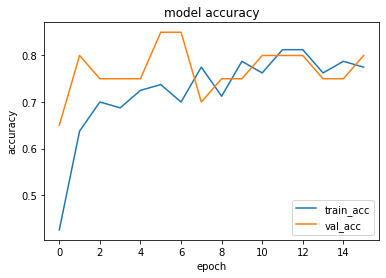

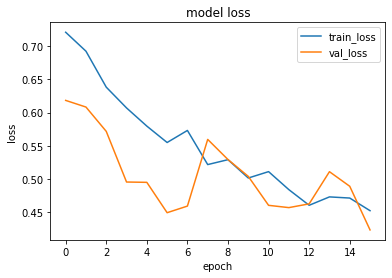

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.36300245]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5783601]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_2.mov is [[0.7395338]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.24421418]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.2212322]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.22521392]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7255 - accuracy: 0.4375 - precision: 0.4444 - recall: 0.5000 - val_loss: 0.6683 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6704 - accuracy: 0.6000 - precision: 0.7222 - recall: 0.3250 - val_loss: 0.5580 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6228 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.5085 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6312 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5201 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

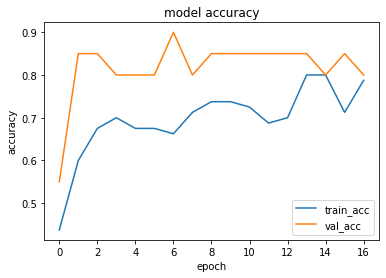

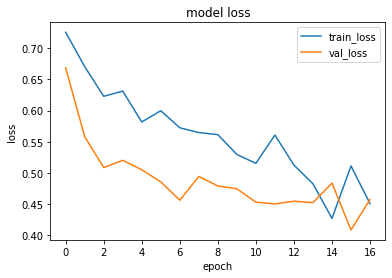

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.48704448]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.43022388]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.61486083]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.35370147]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.31318125]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2894189]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6673 - accuracy: 0.5625 - precision: 0.5758 - recall: 0.4750 - val_loss: 0.7650 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6650 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6192 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 154ms/step - loss: 0.5894 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6047 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5602 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6510 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoc

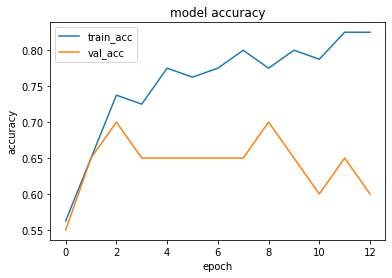

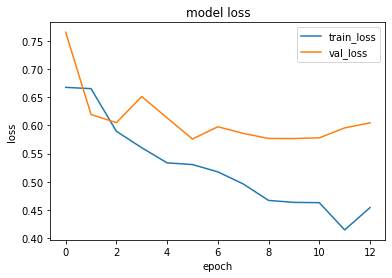

1it [00:00, 12787.51it/s]


prediction for video armflapping_1.mov is [[0.8269828]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.8260065]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.89732075]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.6140729]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.31295648]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.29054058]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7587 - accuracy: 0.5625 - precision: 0.5806 - recall: 0.4500 - val_loss: 0.7400 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5884 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.7863 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5608 - accuracy: 0.7875 - precision: 0.7674 - recall: 0.8250 - val_loss: 0.8187 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5067 - accuracy: 0.8000 - precision: 0.7857 - recall: 0.8250 - val_loss: 0.8330 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epo

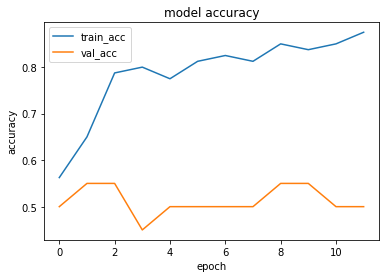

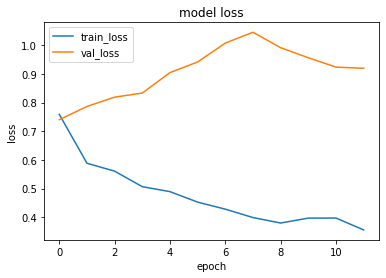

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.5468483]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.54240775]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.9129939]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.20656085]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.2528634]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.21671405]]


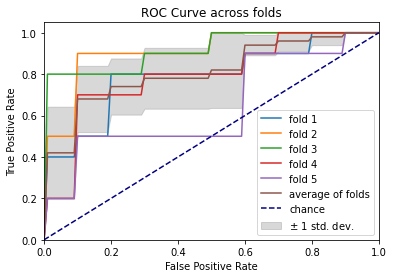

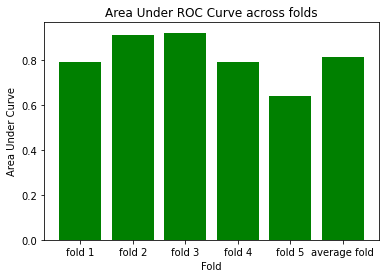

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6425 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.8524 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6060 - accuracy: 0.7250 - precision: 0.6800 - recall: 0.8500 - val_loss: 0.7217 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5510 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.7248 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5685 - accuracy: 0.7625 - precision: 0.8000 - recall: 0.7000 - val_loss: 0.7571 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 132

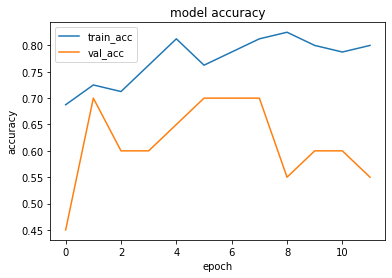

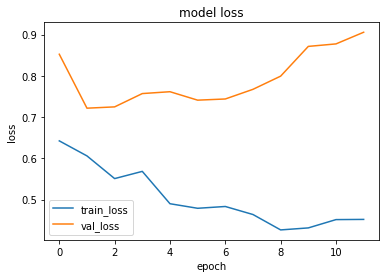

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.5249347]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.38790494]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.59726155]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.45490673]]


1it [00:00, 19508.39it/s]


prediction for video control_2.mov is [[0.40429848]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.3989578]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7216 - accuracy: 0.6000 - precision: 0.6053 - recall: 0.5750 - val_loss: 0.6073 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 1s 208ms/step - loss: 0.6569 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5806 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6125 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5698 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5725 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.5810 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoc

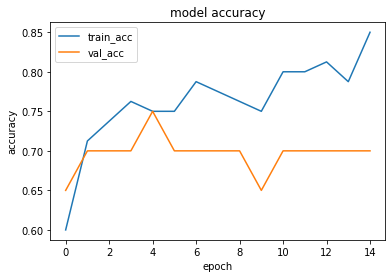

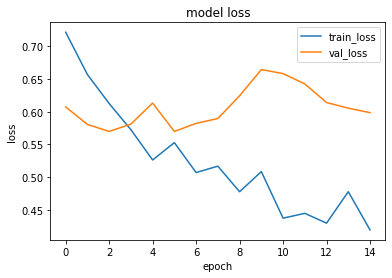

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.52619195]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.6366137]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.74352664]]


1it [00:00, 15477.14it/s]


prediction for video control_1.mov is [[0.20278305]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.1433137]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.13259417]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7196 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4500 - val_loss: 0.6127 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6580 - accuracy: 0.6125 - precision: 0.5918 - recall: 0.7250 - val_loss: 0.5858 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6298 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5477 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6085 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.4844 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

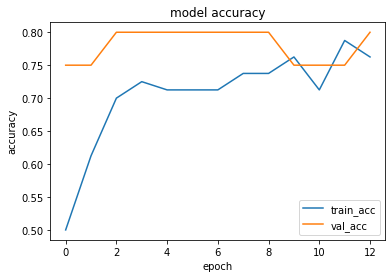

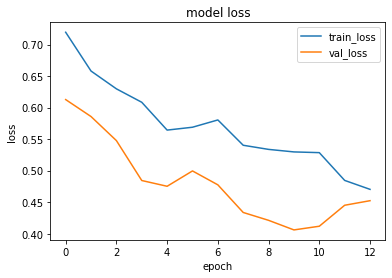

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.54792964]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.46383834]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6569851]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.46655276]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.4232064]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.41967]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7362 - accuracy: 0.5500 - precision: 0.6250 - recall: 0.2500 - val_loss: 0.7739 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6587 - accuracy: 0.5875 - precision: 0.5556 - recall: 0.8750 - val_loss: 0.6590 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6118 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6052 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5796 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6259 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 

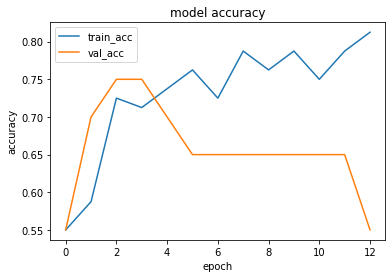

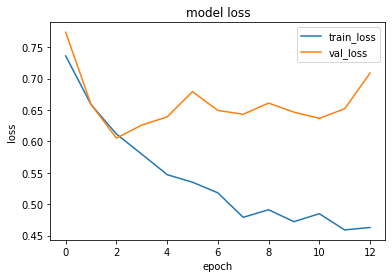

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.6458818]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.86264694]]


1it [00:00, 1082.40it/s]


prediction for video armflapping_2.mov is [[0.6773982]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.23075125]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.24853852]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.25308666]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7347 - accuracy: 0.5500 - precision: 0.5357 - recall: 0.7500 - val_loss: 0.6678 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6608 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.5806 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5537 - accuracy: 0.7875 - precision: 0.7674 - recall: 0.8250 - val_loss: 0.5572 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5483 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.5963 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

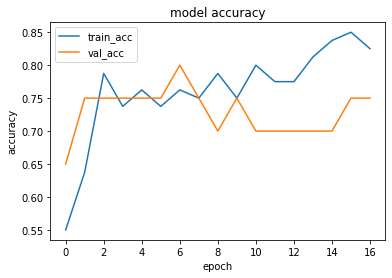

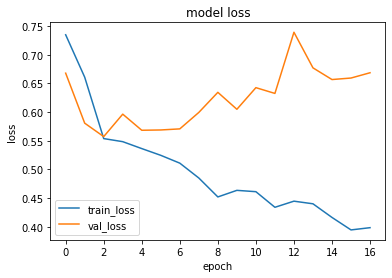

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.36026603]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.17858437]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.7490879]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.24679637]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.10708481]]


1it [00:00, 18157.16it/s]

prediction for video control_3.mov is [[0.18066204]]


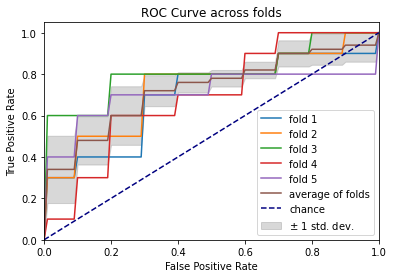

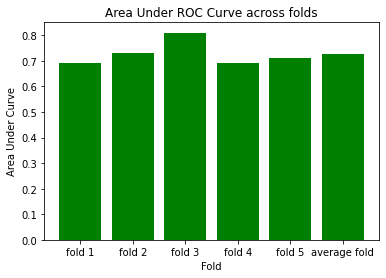

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6818 - accuracy: 0.5375 - precision: 0.5385 - recall: 0.5250 - val_loss: 0.6765 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6107 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.6775 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6216 - accuracy: 0.6625 - precision: 0.8421 - recall: 0.4000 - val_loss: 0.6226 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5901 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.6413 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 136

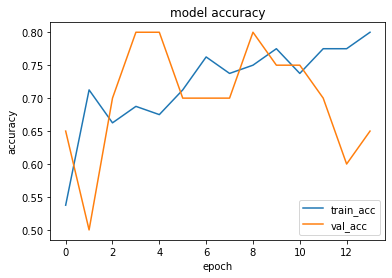

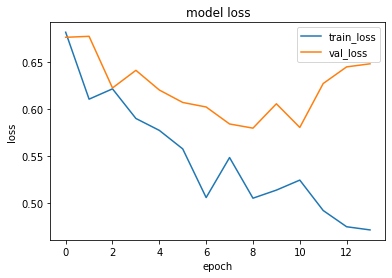

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4990695]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.6828549]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.66137177]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.3213116]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.24755967]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.21198213]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6710 - accuracy: 0.5250 - precision: 0.5200 - recall: 0.6500 - val_loss: 0.6177 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6686 - accuracy: 0.6375 - precision: 0.7200 - recall: 0.4500 - val_loss: 0.5885 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5901 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6582 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6383 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.5715 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epo

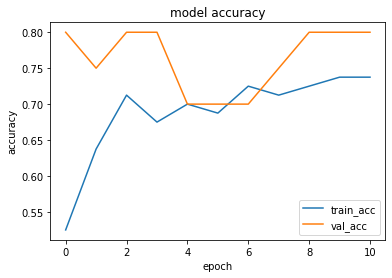

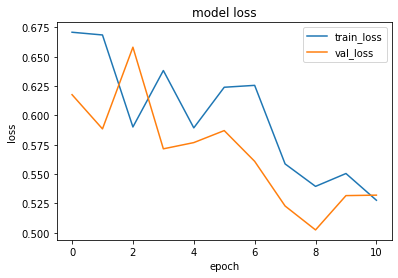

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.62954175]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.485215]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.8076086]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.43821025]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.2989449]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.3101936]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6793 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.5856 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6338 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.5693 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5946 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.5295 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5915 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.5338 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoc

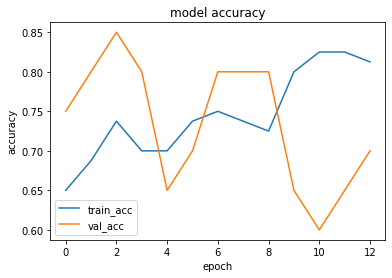

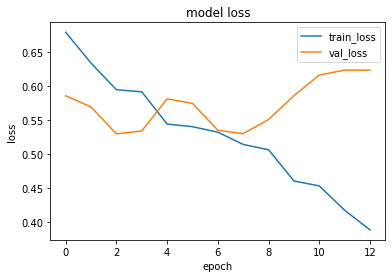

1it [00:00, 12945.38it/s]


prediction for video armflapping_1.mov is [[0.5353351]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.66446674]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6573168]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.3598404]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.3092038]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.2502046]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6568 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.6994 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6451 - accuracy: 0.6250 - precision: 0.6136 - recall: 0.6750 - val_loss: 0.7421 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5586 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7784 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.4975 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.8544 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoc

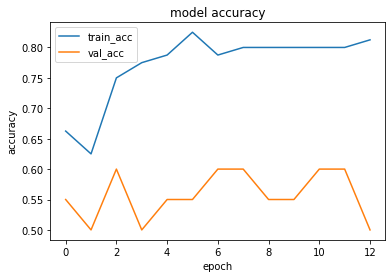

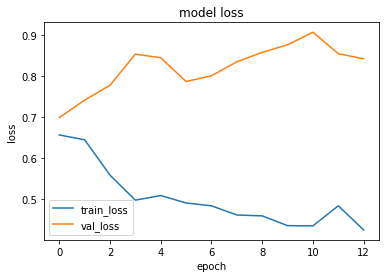

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.5632486]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_3.mov is [[0.36879227]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.5862296]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.22132435]]


1it [00:00, 14217.98it/s]


prediction for video control_2.mov is [[0.2010208]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.2018806]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 235ms/step - loss: 0.8352 - accuracy: 0.5125 - precision: 0.5102 - recall: 0.6250 - val_loss: 0.6436 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 1s 228ms/step - loss: 0.6379 - accuracy: 0.7375 - precision: 0.8276 - recall: 0.6000 - val_loss: 0.5895 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 384ms/step - loss: 0.6336 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 0.5549 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 1s 252ms/step - loss: 0.5935 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.5337 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoc

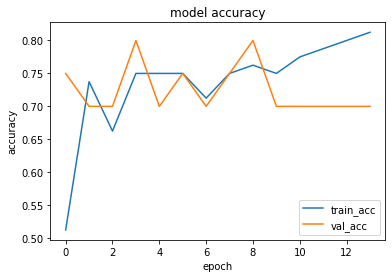

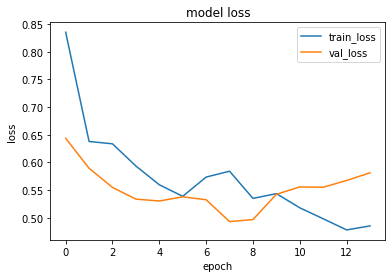

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.6862645]]


1it [00:00, 17331.83it/s]


prediction for video armflapping_3.mov is [[0.4083076]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.7144048]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.39256677]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.20142016]]


1it [00:00, 16578.28it/s]


prediction for video control_3.mov is [[0.18024445]]


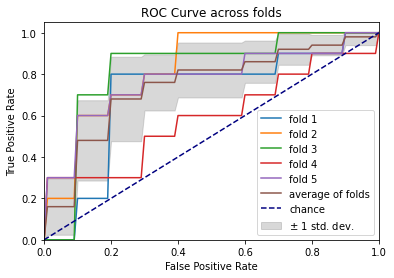

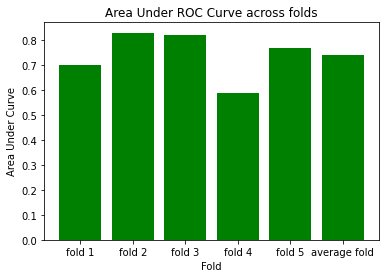

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6793 - accuracy: 0.5375 - precision: 0.5283 - recall: 0.7000 - val_loss: 0.5914 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6188 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.6278 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5773 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6235 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5637 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6330 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 133

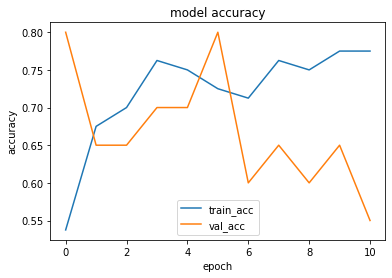

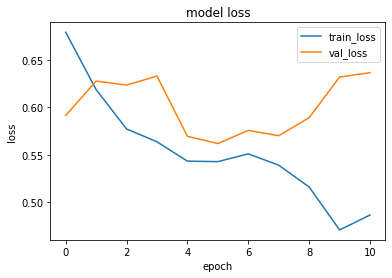

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5297598]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.5126026]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.587537]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.48268008]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.46217462]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.45710793]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7735 - accuracy: 0.4500 - precision: 0.4667 - recall: 0.7000 - val_loss: 0.6773 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6597 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.6638 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5942 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6818 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5452 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.6918 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

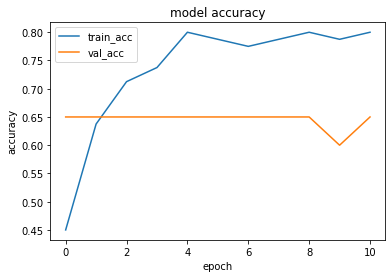

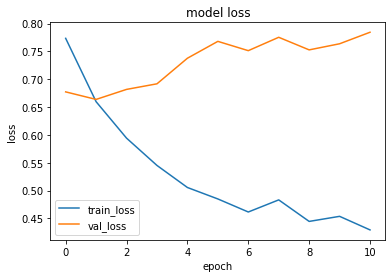

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.57045126]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.5611686]]


1it [00:00, 18641.35it/s]


prediction for video armflapping_2.mov is [[0.72220576]]


1it [00:00, 6364.65it/s]


prediction for video control_1.mov is [[0.232891]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.17295447]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.170598]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6919 - accuracy: 0.4750 - precision: 0.4783 - recall: 0.5500 - val_loss: 0.6930 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5847 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.7074 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5508 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.7273 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5238 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7456 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch

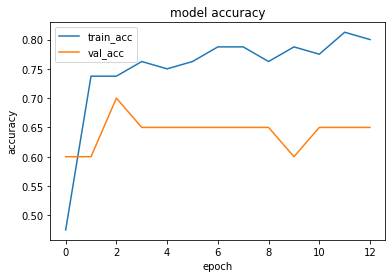

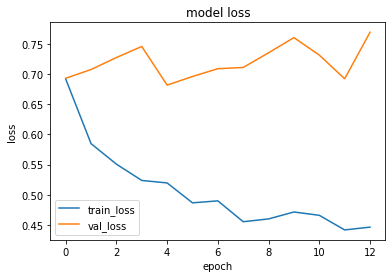

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.60753703]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.62505925]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.81269735]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.38075733]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.2284939]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.1753461]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6540 - accuracy: 0.5750 - precision: 0.5484 - recall: 0.8500 - val_loss: 0.6308 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5995 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5900 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5959 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.5570 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5833 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5487 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoc

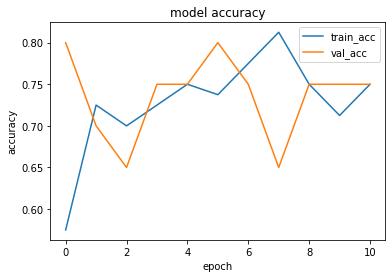

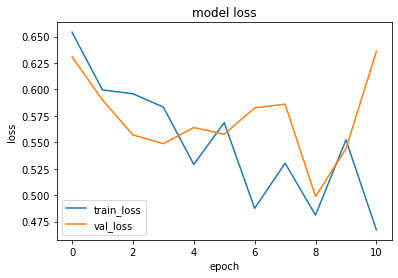

1it [00:00, 19239.93it/s]


prediction for video armflapping_1.mov is [[0.31962317]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.41177192]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6007958]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.28146106]]


1it [00:00, 5683.34it/s]


prediction for video control_2.mov is [[0.27477378]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.27587122]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6970 - accuracy: 0.6000 - precision: 0.5833 - recall: 0.7000 - val_loss: 0.6052 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6503 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.5494 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5896 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.4995 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5495 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.5076 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

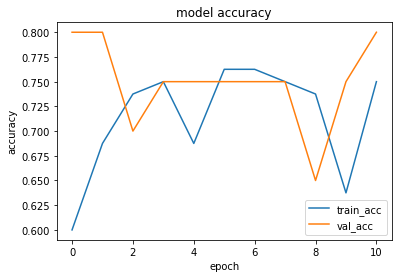

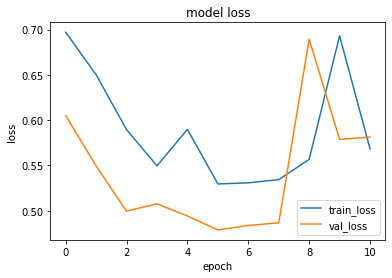

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.25116718]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.34419417]]


1it [00:00, 11781.75it/s]


prediction for video armflapping_2.mov is [[0.5688144]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.24458754]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.24761051]]


1it [00:00, 16070.13it/s]


prediction for video control_3.mov is [[0.24853611]]


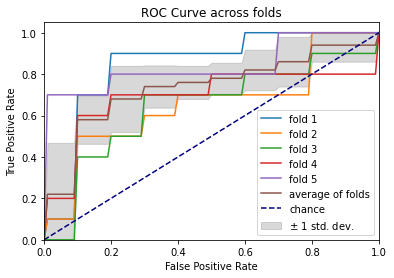

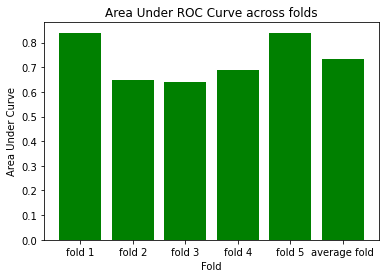

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7394 - accuracy: 0.3750 - precision: 0.3684 - recall: 0.3500 - val_loss: 0.7466 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6720 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.6212 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6319 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.5754 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5993 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6013 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 132

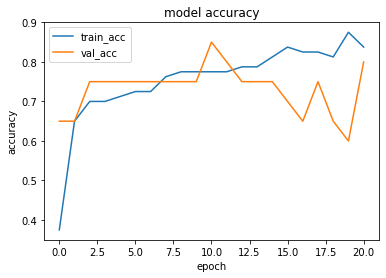

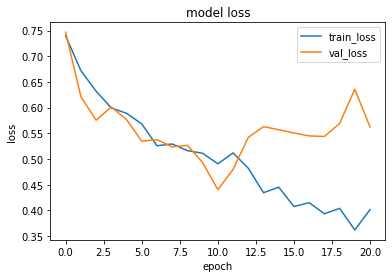

1it [00:00, 18477.11it/s]


prediction for video armflapping_1.mov is [[0.7881689]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.9070647]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.8075736]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.23410636]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.20567456]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.20347619]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7637 - accuracy: 0.4875 - precision: 0.4857 - recall: 0.4250 - val_loss: 0.6855 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6549 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.6400 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6301 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.5997 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5985 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.5794 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epo

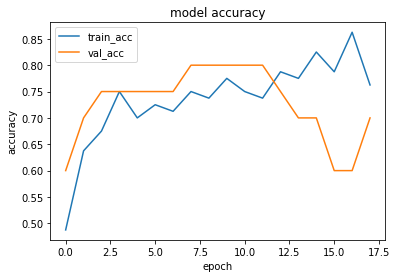

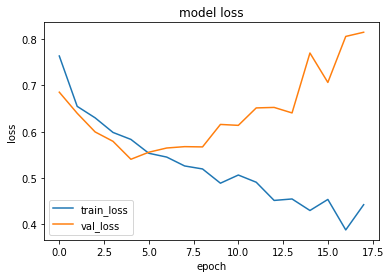

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.7730992]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.83110553]]


1it [00:00, 18315.74it/s]


prediction for video armflapping_2.mov is [[0.8421726]]


1it [00:00, 13486.51it/s]


prediction for video control_1.mov is [[0.5925332]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.3481179]]


1it [00:00, 18236.10it/s]


prediction for video control_3.mov is [[0.2133269]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.9308 - accuracy: 0.4250 - precision: 0.3846 - recall: 0.2500 - val_loss: 0.6811 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6477 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6235 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6588 - accuracy: 0.5375 - precision: 0.5205 - recall: 0.9500 - val_loss: 0.6159 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6291 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6004 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoc

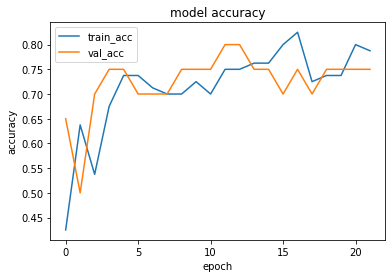

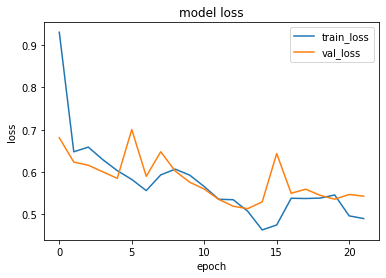

1it [00:00, 17189.77it/s]


prediction for video armflapping_1.mov is [[0.5433846]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.28298962]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.70236945]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.30937785]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.22230637]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.23842138]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6813 - accuracy: 0.4750 - precision: 0.4828 - recall: 0.7000 - val_loss: 0.8163 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6144 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.8738 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5474 - accuracy: 0.7875 - precision: 0.7447 - recall: 0.8750 - val_loss: 0.9552 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.4637 - accuracy: 0.8125 - precision: 0.7778 - recall: 0.8750 - val_loss: 1.1160 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epo

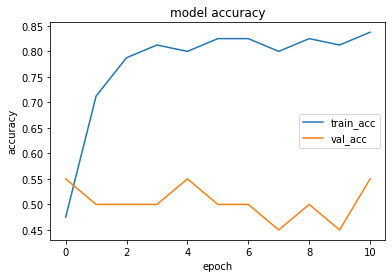

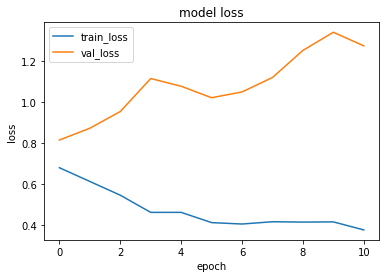

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.66510004]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.80836356]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.734131]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.31092104]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.238446]]


1it [00:00, 13662.23it/s]


prediction for video control_3.mov is [[0.1291405]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7350 - accuracy: 0.4875 - precision: 0.4815 - recall: 0.3250 - val_loss: 0.6454 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6655 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6161 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6378 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6014 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6166 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.5410 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoc

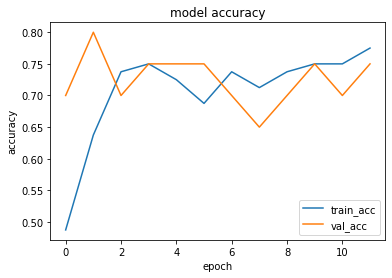

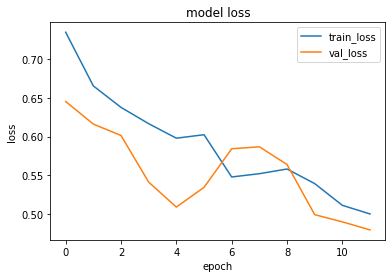

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.59078586]]


1it [00:00, 13025.79it/s]


prediction for video armflapping_3.mov is [[0.2766104]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.8081094]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.2603532]]


1it [00:00, 13486.51it/s]


prediction for video control_2.mov is [[0.39322707]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.25780126]]


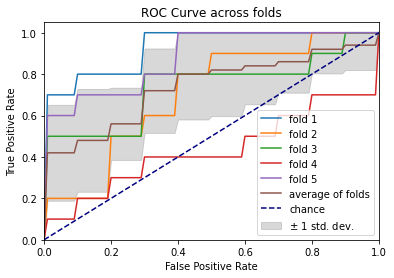

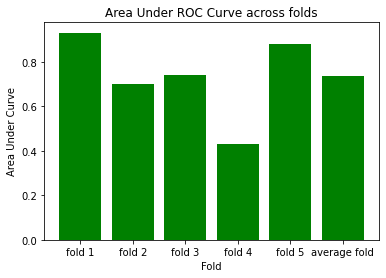

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7093 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5750 - val_loss: 0.6700 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6838 - accuracy: 0.5500 - precision: 0.6667 - recall: 0.2000 - val_loss: 0.6316 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5924 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5974 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5611 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5798 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 134

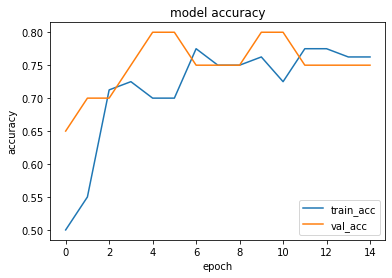

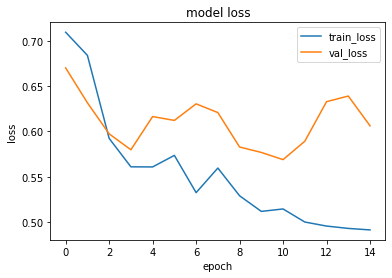

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.48353693]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_3.mov is [[0.21845391]]


1it [00:00, 12336.19it/s]


prediction for video armflapping_2.mov is [[0.54282963]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.37321985]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.21550944]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.282982]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7067 - accuracy: 0.5375 - precision: 0.5319 - recall: 0.6250 - val_loss: 0.7497 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 1s 209ms/step - loss: 0.6760 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 0.6533 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6341 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.6422 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5719 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.7068 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch

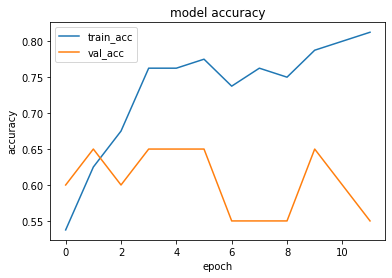

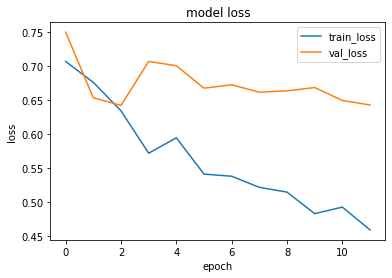

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.67754865]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.59402347]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.7597103]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.15416065]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.15191442]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.15171292]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6940 - accuracy: 0.5250 - precision: 0.5238 - recall: 0.5500 - val_loss: 0.7023 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5830 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.6842 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5668 - accuracy: 0.7625 - precision: 0.8000 - recall: 0.7000 - val_loss: 0.7016 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5435 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7233 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

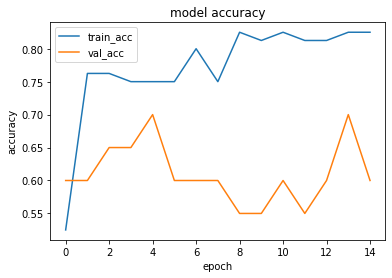

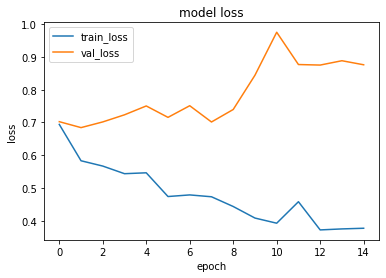

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.4193627]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.51014435]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.89251685]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.17002064]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.22951382]]


1it [00:00, 18808.54it/s]


prediction for video control_3.mov is [[0.21436387]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6945 - accuracy: 0.4625 - precision: 0.4746 - recall: 0.7000 - val_loss: 0.5744 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6440 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.5742 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6184 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.4921 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5835 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.4564 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

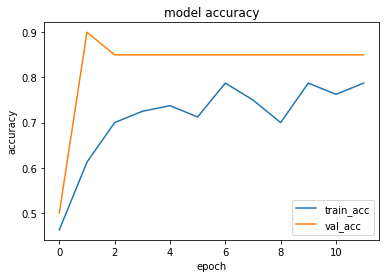

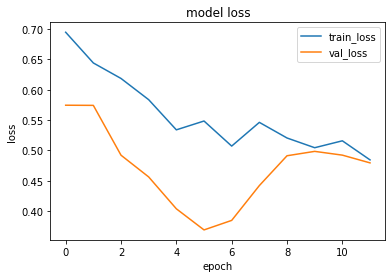

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.510698]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.4589958]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.5779722]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.4694452]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.44701296]]


1it [00:00, 12826.62it/s]


prediction for video control_3.mov is [[0.45704654]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7220 - accuracy: 0.5375 - precision: 0.5211 - recall: 0.9250 - val_loss: 0.6432 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7323 - accuracy: 0.5625 - precision: 0.6316 - recall: 0.3000 - val_loss: 0.6252 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5822 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.5996 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5712 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.6241 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

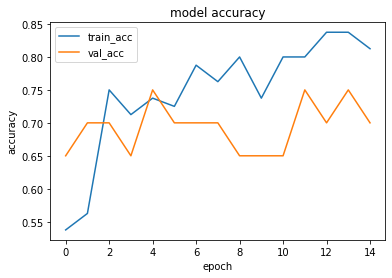

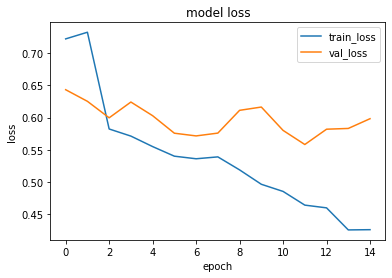

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.61041796]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.25531942]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.8274087]]


1it [00:00, 16194.22it/s]


prediction for video control_1.mov is [[0.2414234]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.2318944]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.23208535]]


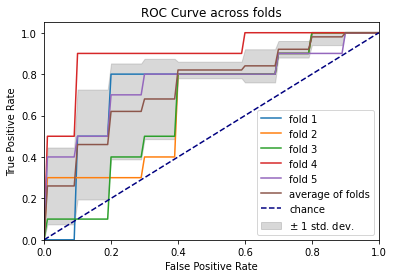

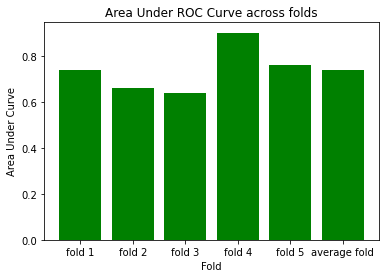

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7911 - accuracy: 0.4875 - precision: 0.4737 - recall: 0.2250 - val_loss: 0.6159 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6881 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.5812 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6431 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.5507 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6131 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.5165 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 137

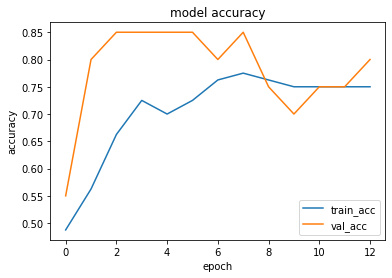

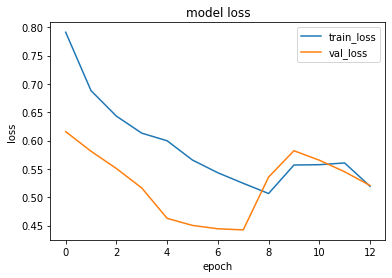

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5484173]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5410335]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.6339503]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.49225247]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.44624546]]


1it [00:00, 12372.58it/s]


prediction for video control_3.mov is [[0.45424423]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 274ms/step - loss: 0.6986 - accuracy: 0.6000 - precision: 0.5714 - recall: 0.8000 - val_loss: 0.6819 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 252ms/step - loss: 0.6287 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.6240 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 1s 358ms/step - loss: 0.5967 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.6148 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 1s 182ms/step - loss: 0.5862 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.5995 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

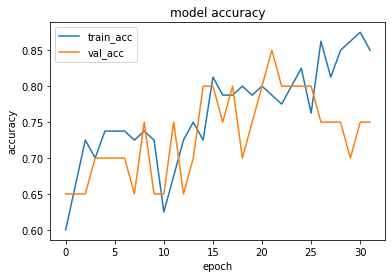

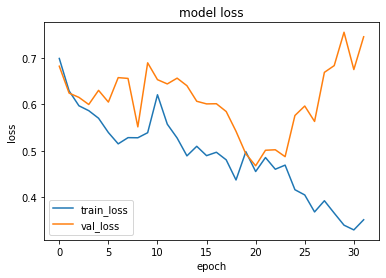

1it [00:00, 10645.44it/s]


prediction for video armflapping_1.mov is [[0.90534854]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.1464043]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.922204]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.80344844]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.15735021]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.295223]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7539 - accuracy: 0.4500 - precision: 0.4545 - recall: 0.5000 - val_loss: 0.6395 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6389 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6168 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6348 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.6024 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5801 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.5632 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch

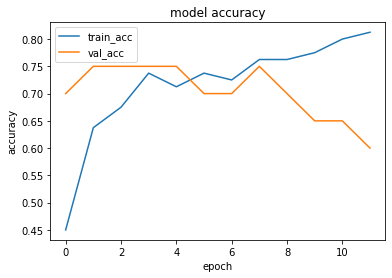

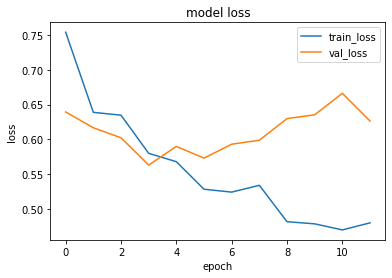

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.20620549]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.2859038]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5870148]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.1884492]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.18527019]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.18586677]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7167 - accuracy: 0.4750 - precision: 0.4848 - recall: 0.8000 - val_loss: 0.7863 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.7349 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.0500 - val_loss: 0.6600 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6544 - accuracy: 0.6250 - precision: 0.6190 - recall: 0.6500 - val_loss: 0.5969 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5976 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6082 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.

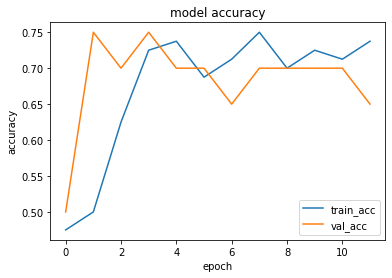

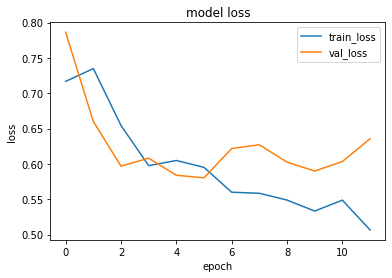

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.32976723]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.24772647]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6970289]]


1it [00:00, 6626.07it/s]


prediction for video control_1.mov is [[0.24367571]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.22553629]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.22703665]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7646 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.6611 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6581 - accuracy: 0.6250 - precision: 0.6923 - recall: 0.4500 - val_loss: 0.6635 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6129 - accuracy: 0.7375 - precision: 0.6863 - recall: 0.8750 - val_loss: 0.7125 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5810 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6581 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

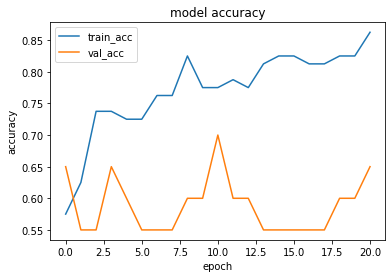

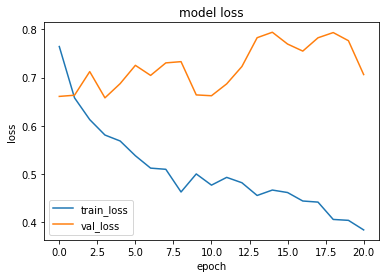

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.7616173]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.4205361]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.85931873]]


1it [00:00, 12300.01it/s]


prediction for video control_1.mov is [[0.28858626]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.19120008]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.18967417]]


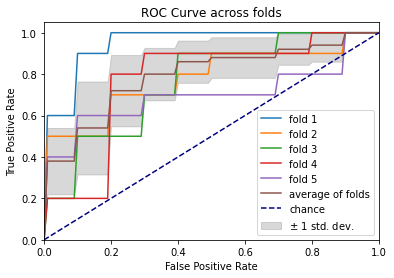

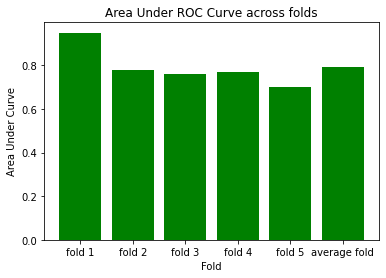

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.7191 - accuracy: 0.5125 - precision: 0.5075 - recall: 0.8500 - val_loss: 0.6838 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5944 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6986 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5504 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7142 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5249 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.7142 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 147

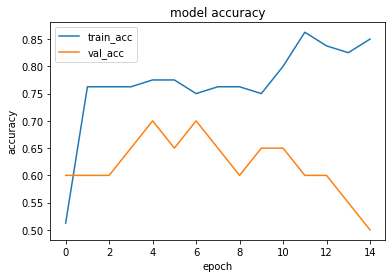

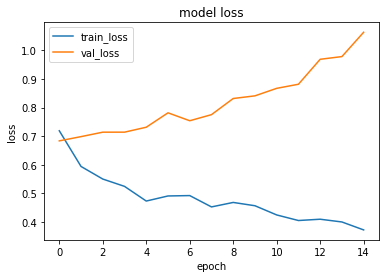

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.49651462]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.47878283]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.7164705]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.35935414]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.28591353]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.2847843]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6819 - accuracy: 0.6000 - precision: 0.5714 - recall: 0.8000 - val_loss: 0.5492 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6232 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.4822 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5833 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.4801 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5600 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.4850 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoc

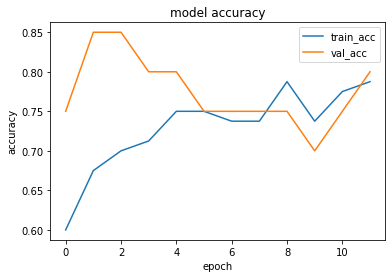

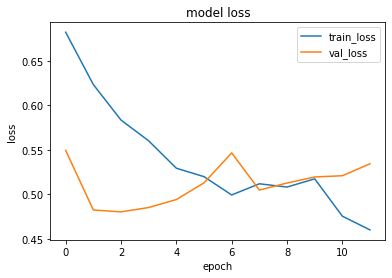

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.53359634]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.5032539]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.6373192]]


1it [00:00, 4718.00it/s]


prediction for video control_1.mov is [[0.4356154]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.38145247]]


1it [00:00, 16194.22it/s]


prediction for video control_3.mov is [[0.37645727]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7276 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7750 - val_loss: 0.6474 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6287 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.5804 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6099 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.5514 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5767 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5262 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

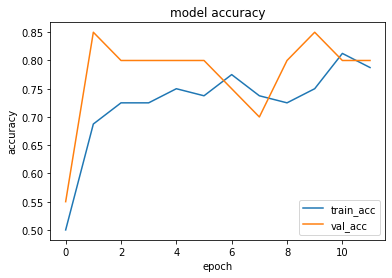

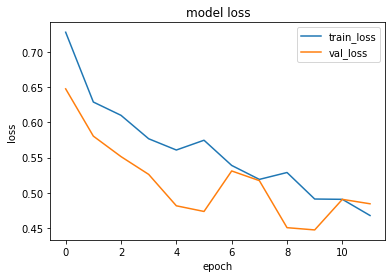

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.46770886]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.28224254]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6696928]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.33517414]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.29166555]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.22348851]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7122 - accuracy: 0.4750 - precision: 0.4762 - recall: 0.5000 - val_loss: 0.7045 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5923 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.7149 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5559 - accuracy: 0.7750 - precision: 0.7391 - recall: 0.8500 - val_loss: 0.7498 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.4963 - accuracy: 0.7625 - precision: 0.7143 - recall: 0.8750 - val_loss: 0.8526 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epo

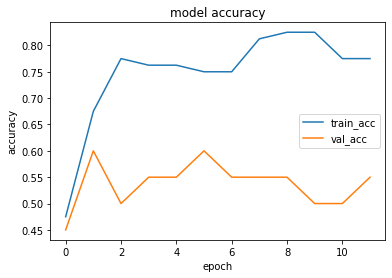

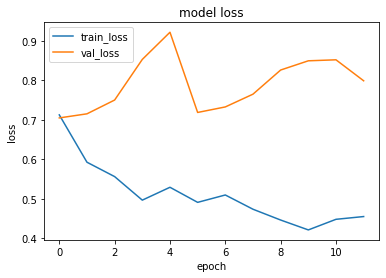

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.24090648]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.09208846]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_2.mov is [[0.512003]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.21729788]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.21093234]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.21937996]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6825 - accuracy: 0.5250 - precision: 0.5357 - recall: 0.3750 - val_loss: 0.5660 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6247 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.6406 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6467 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.6550 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6342 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.5838 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

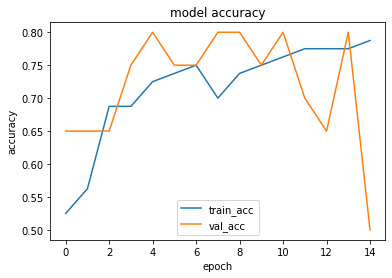

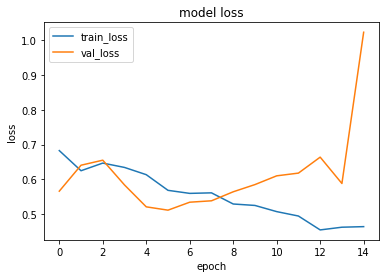

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.43807724]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.3251329]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.7927886]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.18380359]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.1854319]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.1666547]]


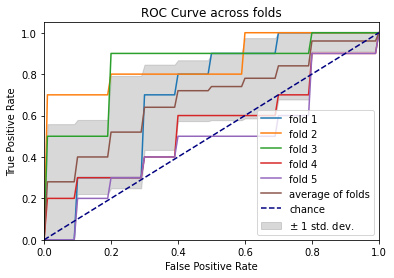

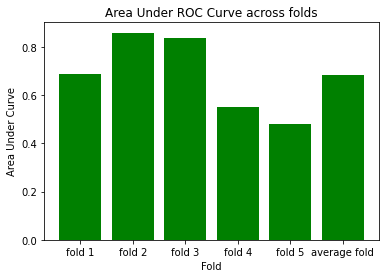

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7742 - accuracy: 0.5250 - precision: 0.5294 - recall: 0.4500 - val_loss: 0.5999 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6495 - accuracy: 0.6500 - precision: 0.6304 - recall: 0.7250 - val_loss: 0.5930 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6011 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.6377 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5559 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6120 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 133

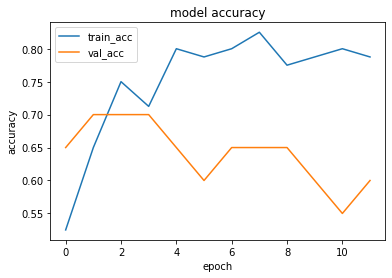

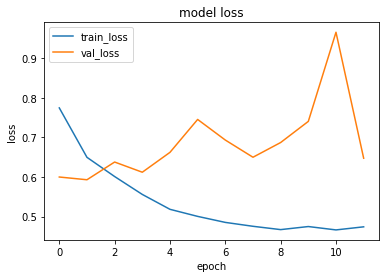

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.5379285]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.5308781]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.632298]]


1it [00:00, 2044.01it/s]


prediction for video control_1.mov is [[0.48273033]]


1it [00:00, 19152.07it/s]


prediction for video control_2.mov is [[0.4463557]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.4358989]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6661 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.6792 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6434 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5291 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5878 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5100 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5615 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.5397 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoc

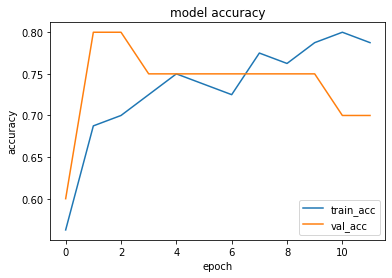

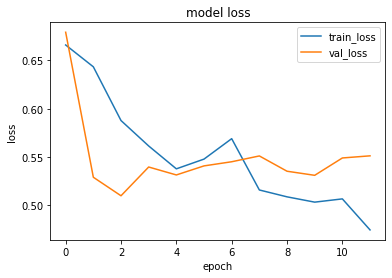

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5686639]]


1it [00:00, 18315.74it/s]


prediction for video armflapping_3.mov is [[0.5138887]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.66808426]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.43670255]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.37123573]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.3368452]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7071 - accuracy: 0.4625 - precision: 0.4754 - recall: 0.7250 - val_loss: 0.7426 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6239 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.6888 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5859 - accuracy: 0.7375 - precision: 0.6792 - recall: 0.9000 - val_loss: 0.6800 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 169ms/step - loss: 0.5396 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.7308 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

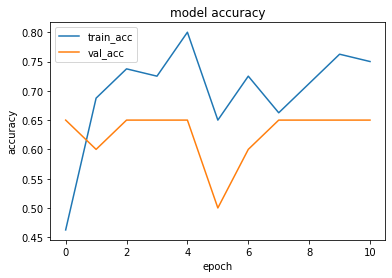

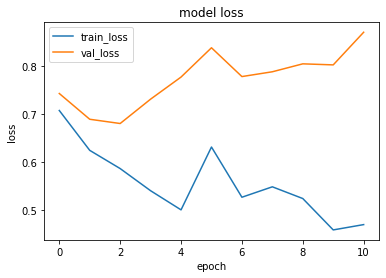

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.5567046]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_3.mov is [[0.4288422]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.66690207]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.46888232]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.18863386]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.21298605]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7666 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5500 - val_loss: 0.6720 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6390 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6608 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5894 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6613 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5998 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6687 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

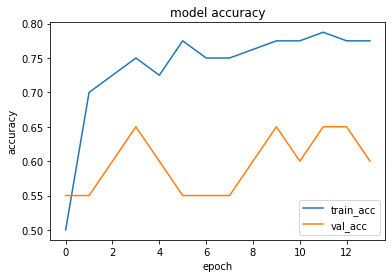

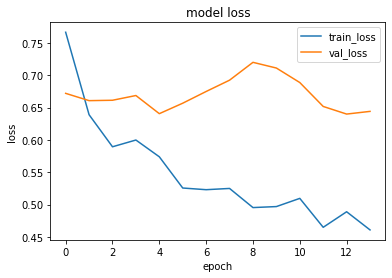

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.7461827]]


1it [00:00, 22192.08it/s]


prediction for video armflapping_3.mov is [[0.5960478]]


1it [00:00, 22192.08it/s]


prediction for video armflapping_2.mov is [[0.828053]]


1it [00:00, 23831.27it/s]


prediction for video control_1.mov is [[0.26245147]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.24005672]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.23758975]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7662 - accuracy: 0.4000 - precision: 0.3571 - recall: 0.2500 - val_loss: 0.6568 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6764 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.5978 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6472 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.5663 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6087 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5420 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

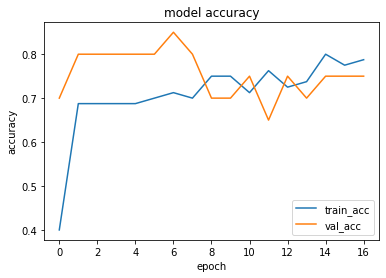

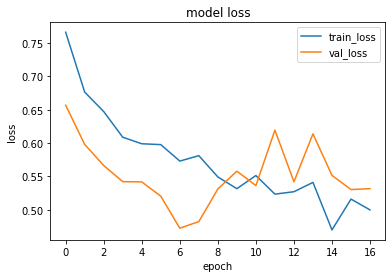

1it [00:00, 14027.77it/s]


prediction for video armflapping_1.mov is [[0.41356438]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.5319064]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.6198782]]


1it [00:00, 6105.25it/s]


prediction for video control_1.mov is [[0.28958327]]


1it [00:00, 19152.07it/s]


prediction for video control_2.mov is [[0.2625386]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.26633638]]


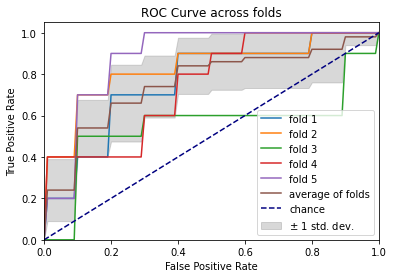

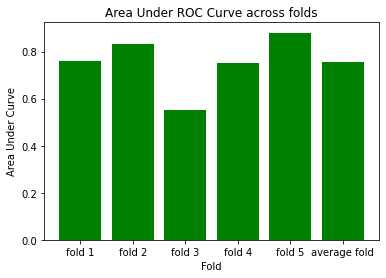

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6434 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5948 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6311 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.5843 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6443 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.5439 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5918 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5479 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 129

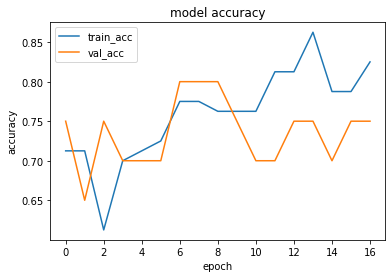

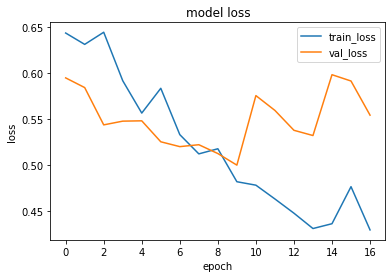

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.615395]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.5989769]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.7529955]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.41053623]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.30247116]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.26222113]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7854 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3750 - val_loss: 0.6468 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6197 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6327 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.5917 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6056 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5495 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6408 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epo

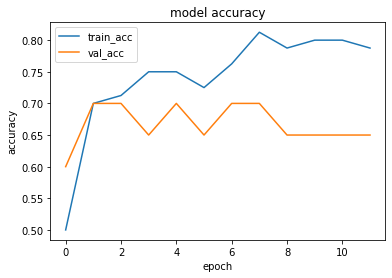

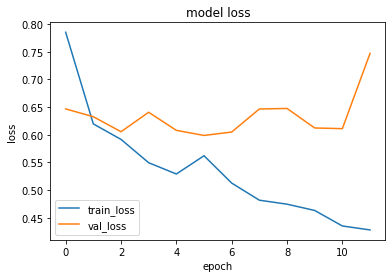

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.7663355]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.6272983]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.87971896]]


1it [00:00, 4519.72it/s]


prediction for video control_1.mov is [[0.3535495]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.27767968]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.22474399]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.7114 - accuracy: 0.4500 - precision: 0.4630 - recall: 0.6250 - val_loss: 0.6010 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6775 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.6077 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 194ms/step - loss: 0.6527 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.5969 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5934 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.5625 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

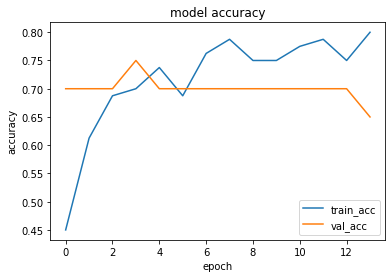

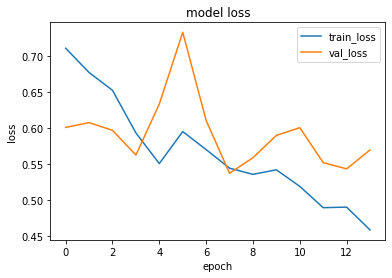

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.59874666]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.75105083]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.70927083]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.18337512]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.1808179]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.18068793]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6493 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.8999 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7057 - accuracy: 0.6125 - precision: 0.5738 - recall: 0.8750 - val_loss: 0.6438 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6589 - accuracy: 0.6375 - precision: 0.7200 - recall: 0.4500 - val_loss: 0.6217 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5906 - accuracy: 0.7250 - precision: 0.8214 - recall: 0.5750 - val_loss: 0.6201 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

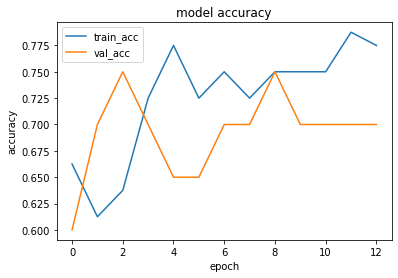

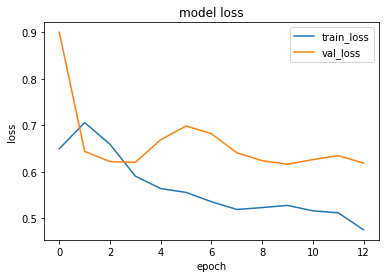

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.6098241]]


1it [00:00, 16578.28it/s]


prediction for video armflapping_3.mov is [[0.4003759]]


1it [00:00, 6853.44it/s]


prediction for video armflapping_2.mov is [[0.8240731]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.40722388]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2763977]]


1it [00:00, 17331.83it/s]


prediction for video control_3.mov is [[0.26675728]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6866 - accuracy: 0.5625 - precision: 0.5806 - recall: 0.4500 - val_loss: 0.6867 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6281 - accuracy: 0.6250 - precision: 0.5926 - recall: 0.8000 - val_loss: 0.6719 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5844 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6789 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5690 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.6150 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

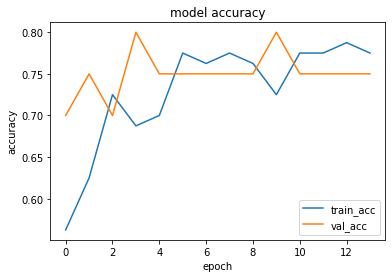

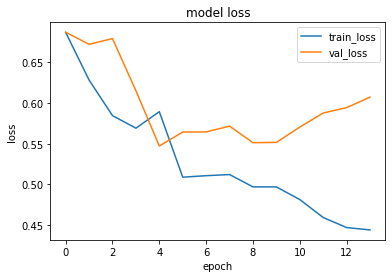

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.5488977]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_3.mov is [[0.4604841]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.74103653]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.34888875]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.27612078]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2533853]]


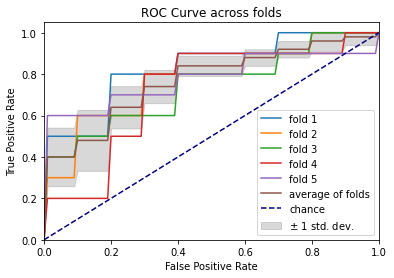

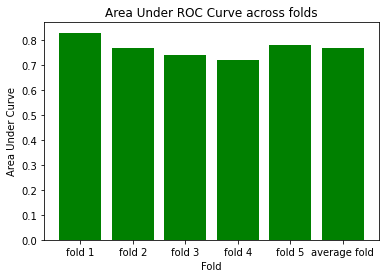

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7074 - accuracy: 0.5250 - precision: 0.5417 - recall: 0.3250 - val_loss: 0.6393 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 207ms/step - loss: 0.7501 - accuracy: 0.5250 - precision: 0.5143 - recall: 0.9000 - val_loss: 0.6036 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6433 - accuracy: 0.6500 - precision: 0.6304 - recall: 0.7250 - val_loss: 0.6030 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6234 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5681 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 150

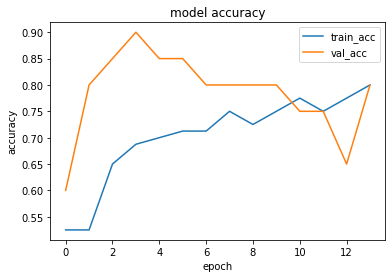

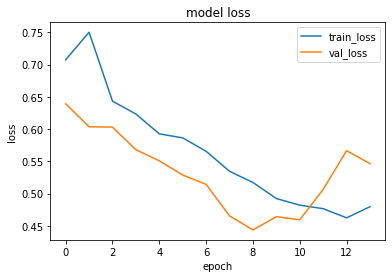

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.55342126]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.44688332]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.63873386]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.4812681]]


1it [00:00, 18236.10it/s]


prediction for video control_2.mov is [[0.44064385]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.4463421]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7085 - accuracy: 0.4500 - precision: 0.4565 - recall: 0.5250 - val_loss: 0.6264 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6054 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.6219 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6106 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6166 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5828 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6335 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

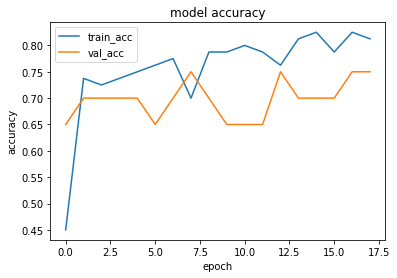

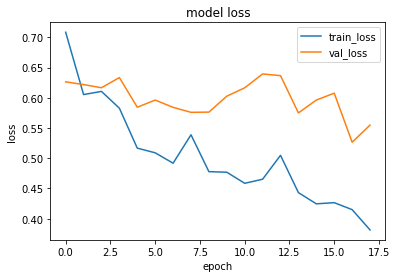

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.7340156]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.88780975]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.8620367]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.07037386]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.05559045]]


1it [00:00, 16578.28it/s]


prediction for video control_3.mov is [[0.05399111]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7483 - accuracy: 0.5125 - precision: 0.5128 - recall: 0.5000 - val_loss: 0.6509 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6695 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.5757 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6480 - accuracy: 0.6125 - precision: 0.6286 - recall: 0.5500 - val_loss: 0.5035 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5806 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.4608 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

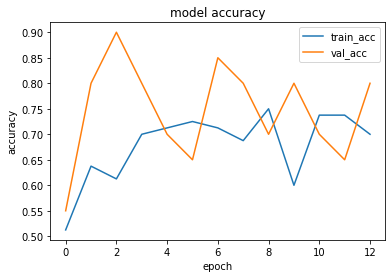

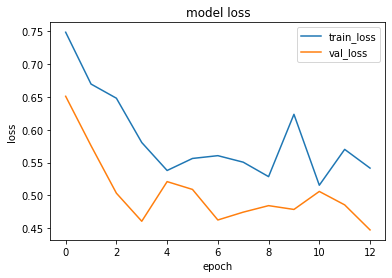

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.03470623]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.7391697]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5613094]]


1it [00:00, 12787.51it/s]


prediction for video control_1.mov is [[0.46910316]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.44849738]]


1it [00:00, 18236.10it/s]


prediction for video control_3.mov is [[0.0318678]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 210ms/step - loss: 0.8564 - accuracy: 0.3625 - precision: 0.4068 - recall: 0.6000 - val_loss: 0.6785 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6232 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.6848 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5857 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.7099 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5271 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.7773 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoc

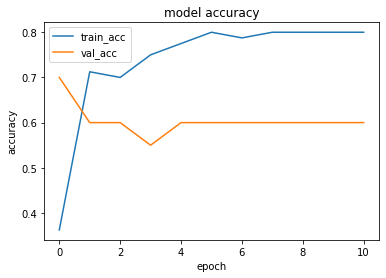

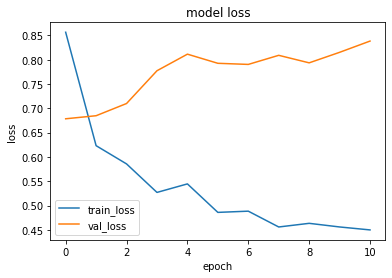

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4791681]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.30260456]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_2.mov is [[0.8114364]]


1it [00:00, 17260.51it/s]


prediction for video control_1.mov is [[0.30470347]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.25990927]]


1it [00:00, 20460.02it/s]


prediction for video control_3.mov is [[0.25596777]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6654 - accuracy: 0.6625 - precision: 0.6383 - recall: 0.7500 - val_loss: 0.6234 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6375 - accuracy: 0.6500 - precision: 0.6200 - recall: 0.7750 - val_loss: 0.6453 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5935 - accuracy: 0.7750 - precision: 0.9231 - recall: 0.6000 - val_loss: 0.5963 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5725 - accuracy: 0.7625 - precision: 0.7234 - recall: 0.8500 - val_loss: 0.6106 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

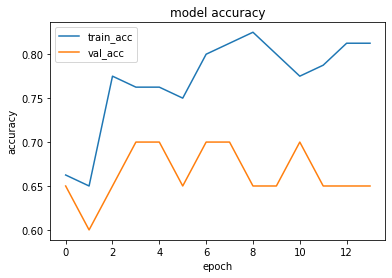

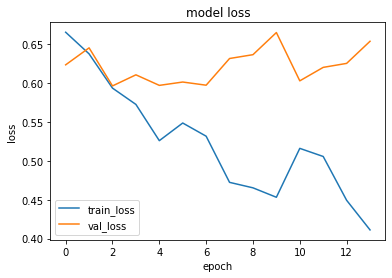

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.7147581]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_3.mov is [[0.3170535]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_2.mov is [[0.86980456]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.40723675]]


1it [00:00, 20360.70it/s]


prediction for video control_2.mov is [[0.24335489]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.19463682]]


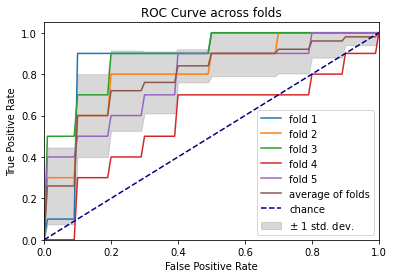

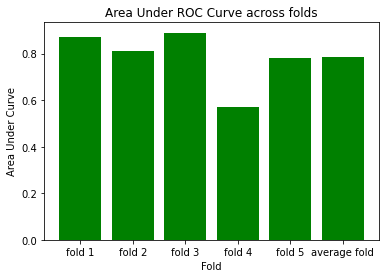

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7516 - accuracy: 0.4500 - precision: 0.4583 - recall: 0.5500 - val_loss: 0.7079 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6140 - accuracy: 0.7625 - precision: 0.8000 - recall: 0.7000 - val_loss: 0.7101 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5713 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.7869 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5607 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.7939 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 126

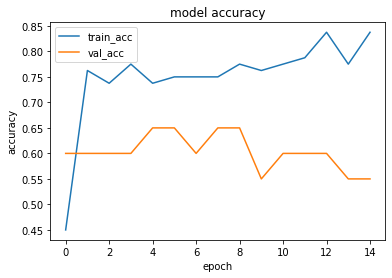

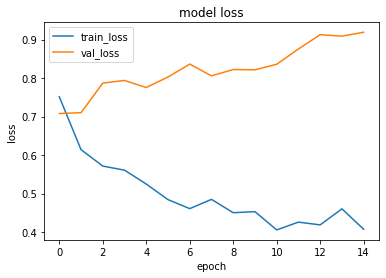

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.5621545]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.6727939]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.6835954]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.39349884]]


1it [00:00, 6700.17it/s]


prediction for video control_2.mov is [[0.31730014]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.2584725]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7631 - accuracy: 0.3875 - precision: 0.4082 - recall: 0.5000 - val_loss: 0.6441 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6623 - accuracy: 0.5250 - precision: 0.5147 - recall: 0.8750 - val_loss: 0.6254 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 1s 209ms/step - loss: 0.6234 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.6118 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6016 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5815 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoc

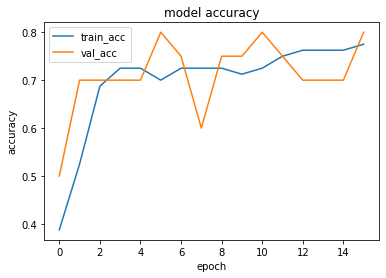

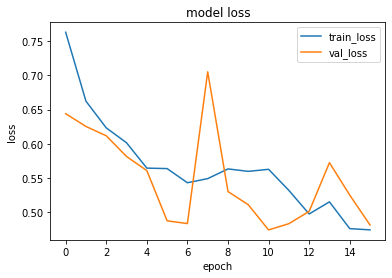

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.45489705]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.3665375]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.6648016]]


1it [00:00, 11244.78it/s]


prediction for video control_1.mov is [[0.26914448]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.19811833]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.21367183]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6830 - accuracy: 0.5625 - precision: 0.5676 - recall: 0.5250 - val_loss: 0.5865 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7371 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.5660 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6071 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6196 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6402 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.5742 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

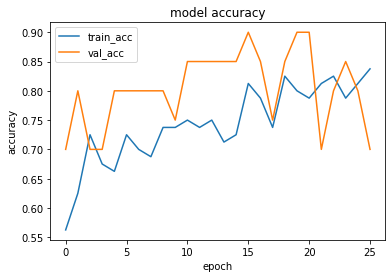

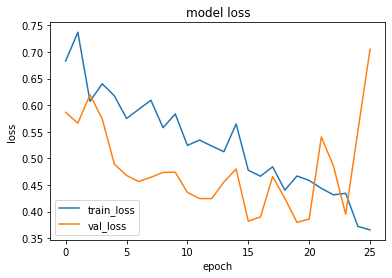

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.66220176]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_3.mov is [[0.40498605]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.79910934]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.32518184]]


1it [00:00, 19152.07it/s]


prediction for video control_2.mov is [[0.31017095]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.30392194]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7283 - accuracy: 0.4500 - precision: 0.4583 - recall: 0.5500 - val_loss: 0.6253 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6435 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.5932 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5902 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5563 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5725 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5345 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

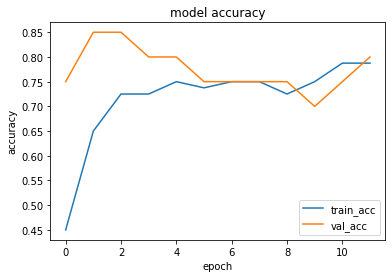

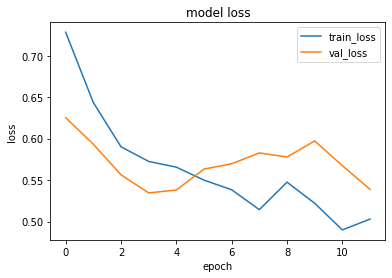

1it [00:00, 13189.64it/s]


prediction for video armflapping_1.mov is [[0.47947228]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.3947047]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.7558454]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.40904668]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.26122445]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.33057526]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7191 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4750 - val_loss: 0.6971 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5981 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6848 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5603 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6936 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5332 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.7153 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

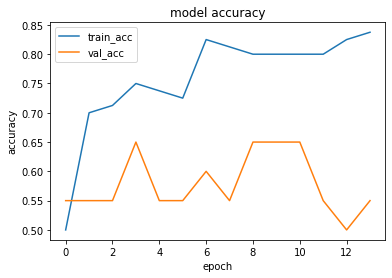

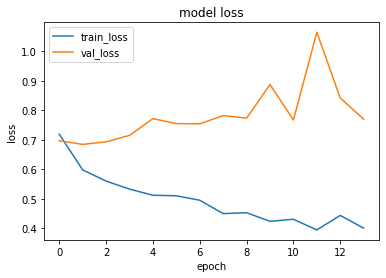

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.29848117]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.20584098]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.6553911]]


1it [00:00, 16448.25it/s]


prediction for video control_1.mov is [[0.1750792]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.14996159]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.15535247]]


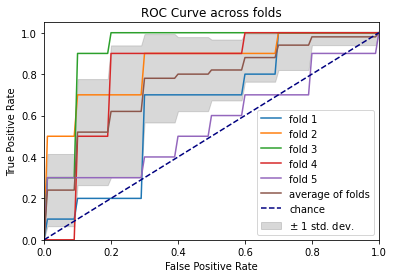

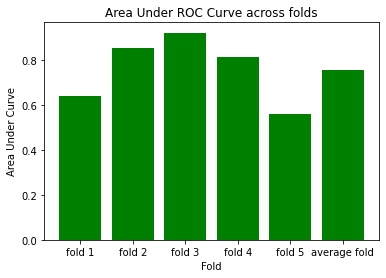

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 220ms/step - loss: 0.7411 - accuracy: 0.6000 - precision: 0.5870 - recall: 0.6750 - val_loss: 0.6254 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6202 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.6859 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6363 - accuracy: 0.6875 - precision: 0.8261 - recall: 0.4750 - val_loss: 0.6186 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5796 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6160 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 131

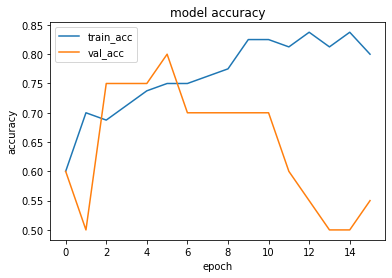

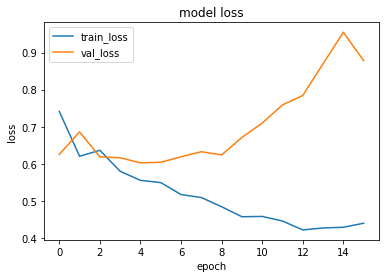

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.56631804]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.60127515]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.7476213]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.28494483]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.20265582]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.19048697]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7102 - accuracy: 0.5750 - precision: 0.5625 - recall: 0.6750 - val_loss: 0.6778 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6798 - accuracy: 0.6000 - precision: 0.9000 - recall: 0.2250 - val_loss: 0.6408 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6154 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6539 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6018 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.6979 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.

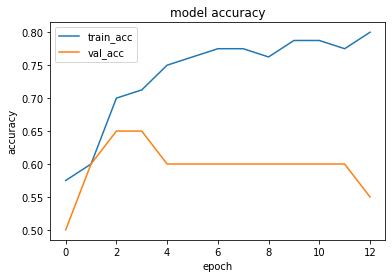

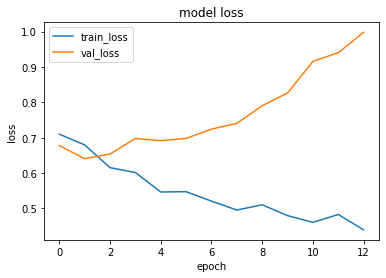

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.24983501]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.09858954]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.87129974]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.09952545]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.1648911]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.18720329]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6768 - accuracy: 0.5500 - precision: 0.5370 - recall: 0.7250 - val_loss: 0.6021 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6707 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.5786 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6262 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5706 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5774 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.6031 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

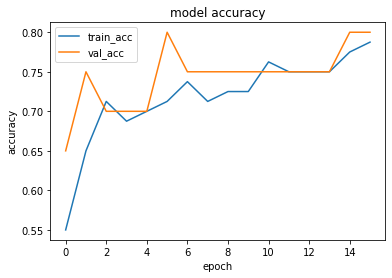

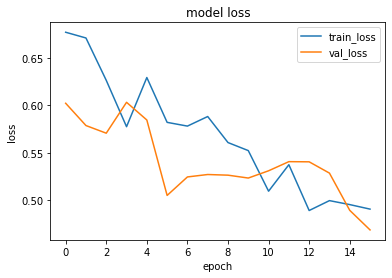

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.4873602]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.30070382]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.7306061]]


1it [00:00, 16384.00it/s]


prediction for video control_1.mov is [[0.27295452]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.26433474]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.26268524]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 139ms/step - loss: 0.7016 - accuracy: 0.6375 - precision: 0.6341 - recall: 0.6500 - val_loss: 0.7168 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6097 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.7041 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5842 - accuracy: 0.6875 - precision: 0.6316 - recall: 0.9000 - val_loss: 0.6703 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5875 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6997 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

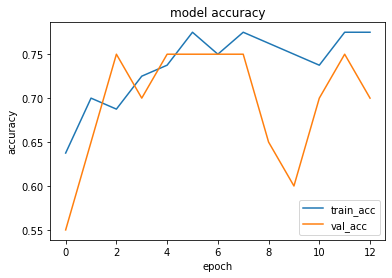

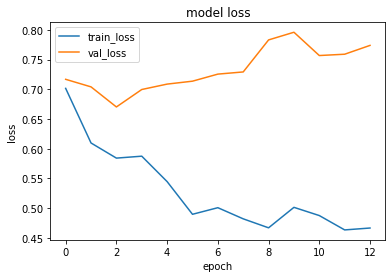

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.6045149]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.55321676]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_2.mov is [[0.7731252]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.30721307]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.24208337]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.21544698]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7412 - accuracy: 0.5250 - precision: 0.5238 - recall: 0.5500 - val_loss: 0.6798 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6442 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6775 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6079 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.6304 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5771 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.5813 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

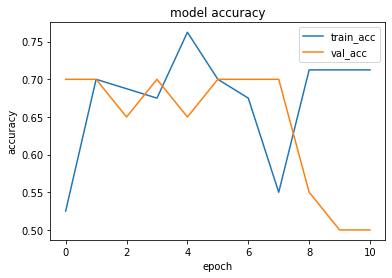

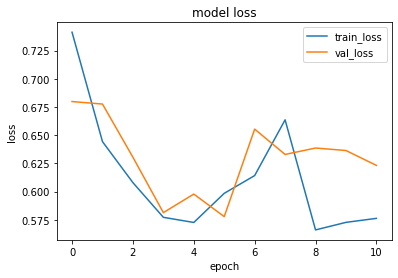

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.3676285]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.41723695]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.45605543]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.3442207]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.30612367]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.30819237]]


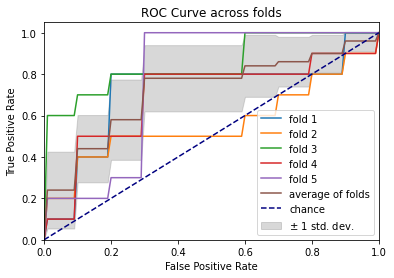

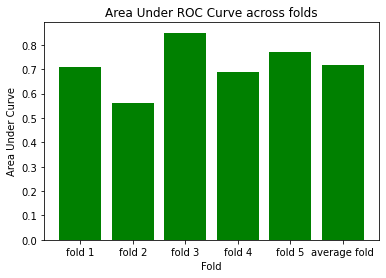

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.7185 - accuracy: 0.4500 - precision: 0.3889 - recall: 0.1750 - val_loss: 0.6096 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6979 - accuracy: 0.6000 - precision: 0.5606 - recall: 0.9250 - val_loss: 0.6067 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6498 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.5710 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5908 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.5474 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 132

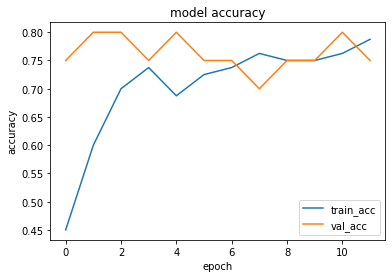

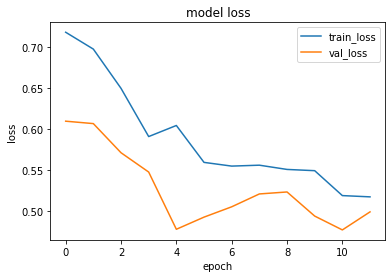

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.5531697]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_3.mov is [[0.6082923]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6234733]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.5064735]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.47700104]]


1it [00:00, 13662.23it/s]


prediction for video control_3.mov is [[0.47998652]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.9904 - accuracy: 0.4125 - precision: 0.3333 - recall: 0.1750 - val_loss: 0.6811 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6269 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6925 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6404 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.7129 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6121 - accuracy: 0.7625 - precision: 0.7234 - recall: 0.8500 - val_loss: 0.6942 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

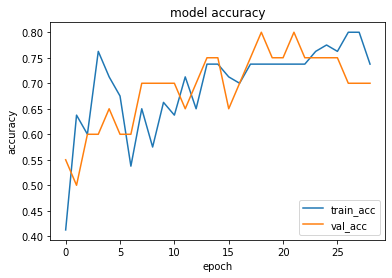

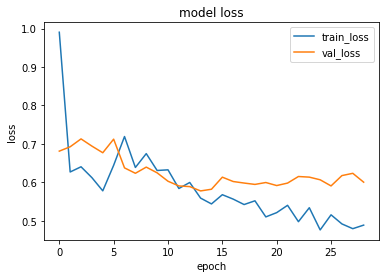

1it [00:00, 16448.25it/s]


prediction for video armflapping_1.mov is [[0.27006721]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.73463273]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.71414703]]


1it [00:00, 6808.94it/s]


prediction for video control_1.mov is [[0.22109798]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.21690157]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.21646708]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6843 - accuracy: 0.5125 - precision: 0.5238 - recall: 0.2750 - val_loss: 0.7234 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6784 - accuracy: 0.5875 - precision: 0.5479 - recall: 1.0000 - val_loss: 0.6405 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6477 - accuracy: 0.6375 - precision: 0.6222 - recall: 0.7000 - val_loss: 0.6158 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 189ms/step - loss: 0.6051 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.6069 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

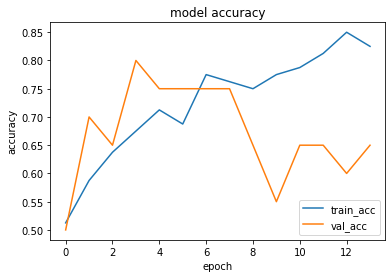

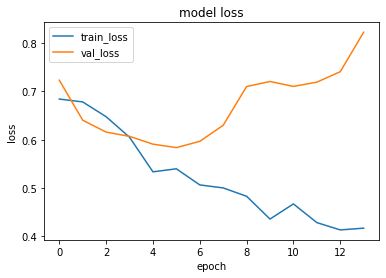

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.66497743]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.8561976]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.91337216]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.28266862]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.21854278]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.22432241]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7618 - accuracy: 0.4625 - precision: 0.4667 - recall: 0.5250 - val_loss: 0.6325 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6264 - accuracy: 0.5750 - precision: 0.5441 - recall: 0.9250 - val_loss: 0.6200 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6080 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.5885 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5578 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.5821 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

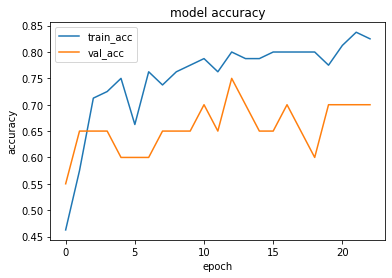

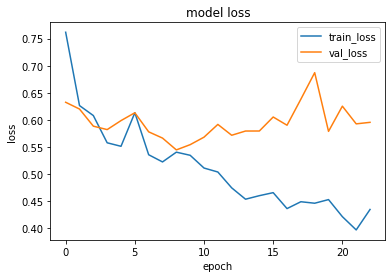

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.9209906]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.54923236]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.8951477]]


1it [00:00, 6374.32it/s]


prediction for video control_1.mov is [[0.57574797]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.33162236]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.16371045]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6800 - accuracy: 0.5625 - precision: 0.5455 - recall: 0.7500 - val_loss: 0.6157 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6133 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6465 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6140 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.5912 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5944 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.5523 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

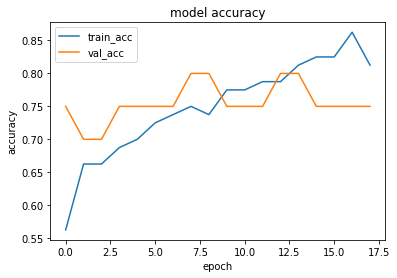

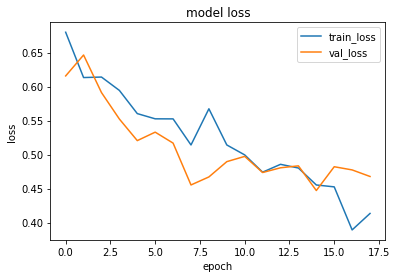

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.3434647]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.57073736]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.78842556]]


1it [00:00, 12336.19it/s]


prediction for video control_1.mov is [[0.2066541]]


1it [00:00, 6017.65it/s]


prediction for video control_2.mov is [[0.2097531]]


1it [00:00, 17623.13it/s]


prediction for video control_3.mov is [[0.19558659]]


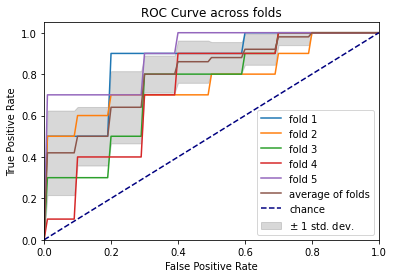

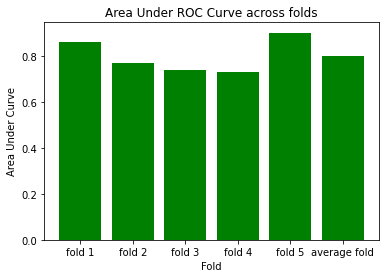

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6884 - accuracy: 0.5125 - precision: 0.5106 - recall: 0.6000 - val_loss: 0.6674 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6477 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5757 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6209 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.5281 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5959 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.4842 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 130

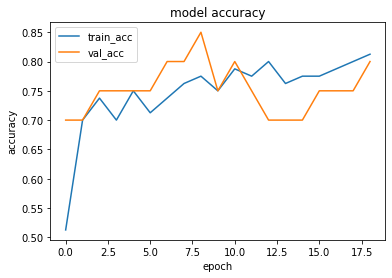

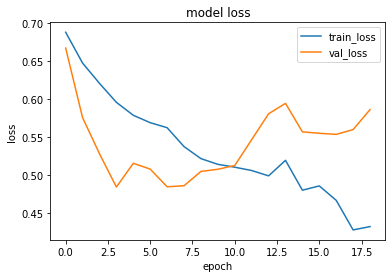

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.6394925]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.4539715]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.7505729]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.36623883]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.27522296]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.24676013]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6864 - accuracy: 0.5625 - precision: 0.6000 - recall: 0.3750 - val_loss: 0.6847 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6375 - accuracy: 0.6375 - precision: 0.5902 - recall: 0.9000 - val_loss: 0.6531 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6390 - accuracy: 0.6875 - precision: 0.7586 - recall: 0.5500 - val_loss: 0.6562 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5941 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.6348 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

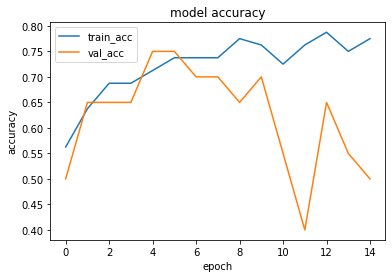

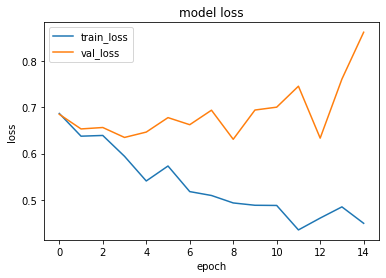

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.6965809]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.7529175]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7138653]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.50583184]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.15649757]]


1it [00:00, 12192.74it/s]


prediction for video control_3.mov is [[0.7113222]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7047 - accuracy: 0.4500 - precision: 0.4565 - recall: 0.5250 - val_loss: 0.6606 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6192 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.6302 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6290 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6223 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5772 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6251 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoc

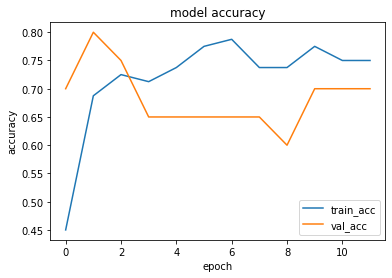

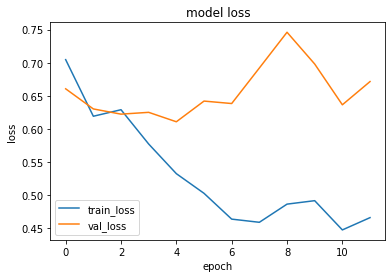

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.19871017]]


1it [00:00, 17331.83it/s]


prediction for video armflapping_3.mov is [[0.6530585]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.7566999]]


1it [00:00, 15477.14it/s]


prediction for video control_1.mov is [[0.16726303]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.16928753]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.16930768]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.8682 - accuracy: 0.4875 - precision: 0.4923 - recall: 0.8000 - val_loss: 0.7388 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.7216 - accuracy: 0.5375 - precision: 0.5714 - recall: 0.3000 - val_loss: 0.6427 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6672 - accuracy: 0.6250 - precision: 0.7500 - recall: 0.3750 - val_loss: 0.6040 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6281 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.5912 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

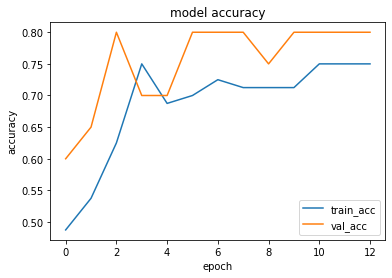

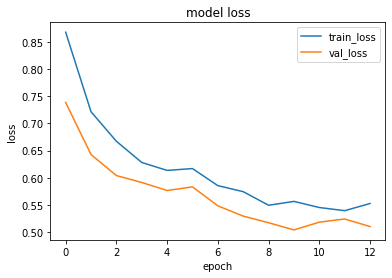

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.4674783]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.36364308]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6383977]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.23365134]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.19787285]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.18883643]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6252 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 1.2757 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6405 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.9205 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.4890 - accuracy: 0.7875 - precision: 0.8108 - recall: 0.7500 - val_loss: 0.8055 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.4973 - accuracy: 0.7750 - precision: 0.7750 - recall: 0.7750 - val_loss: 0.7937 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

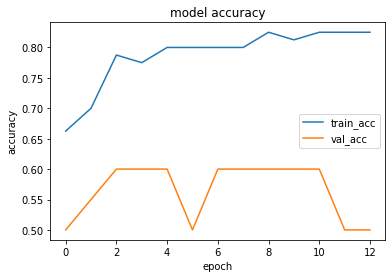

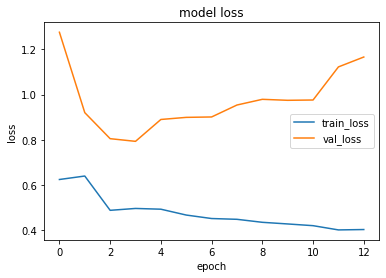

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.3826769]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.55273056]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.88315195]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.25721538]]


1it [00:00, 18236.10it/s]


prediction for video control_2.mov is [[0.20718503]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.21078494]]


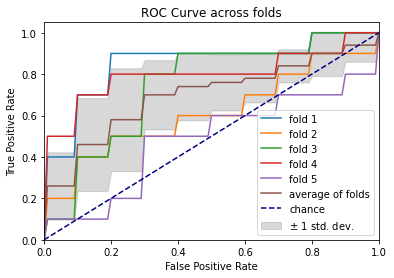

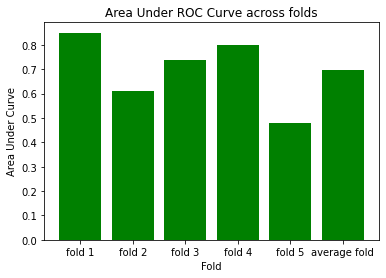

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7141 - accuracy: 0.5625 - precision: 0.5490 - recall: 0.7000 - val_loss: 0.7054 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6176 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6880 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5632 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.8143 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5619 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.7094 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 135

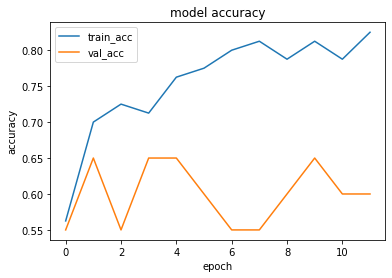

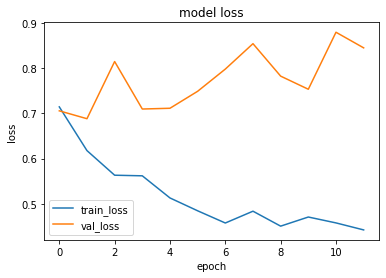

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.51130754]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_3.mov is [[0.381932]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.5462459]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.44675955]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.37992835]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.38063225]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7041 - accuracy: 0.5375 - precision: 0.5366 - recall: 0.5500 - val_loss: 0.5962 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6534 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.6517 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6114 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5636 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5857 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5600 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

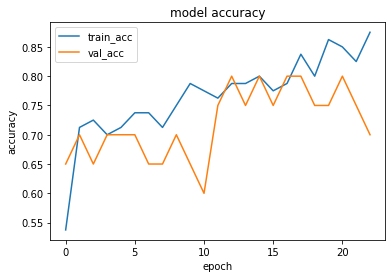

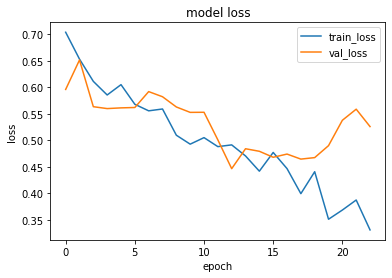

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.27922192]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.53073853]]


1it [00:00, 12192.74it/s]


prediction for video armflapping_2.mov is [[0.86223984]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.22483426]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.21770549]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.21742794]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7252 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.6437 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6221 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.6109 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6160 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.5811 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5754 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.5486 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

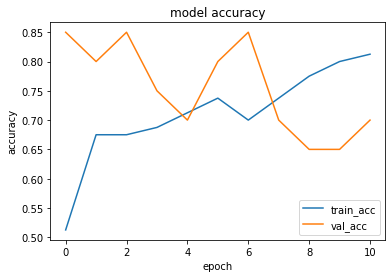

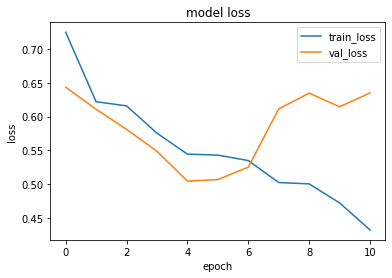

1it [00:00, 12671.61it/s]


prediction for video armflapping_1.mov is [[0.5191539]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_3.mov is [[0.5079526]]


1it [00:00, 2702.52it/s]


prediction for video armflapping_2.mov is [[0.5733151]]


1it [00:00, 4877.10it/s]


prediction for video control_1.mov is [[0.5027879]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.49817023]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.49675265]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7921 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7250 - val_loss: 0.6794 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6520 - accuracy: 0.6250 - precision: 0.6923 - recall: 0.4500 - val_loss: 0.6596 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6207 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5988 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5945 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.5832 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

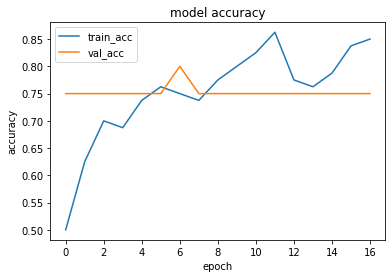

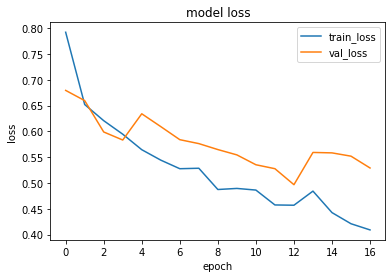

1it [00:00, 13315.25it/s]


prediction for video armflapping_1.mov is [[0.58296436]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.7455406]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.83621323]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.25580344]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.20622745]]


1it [00:00, 13486.51it/s]


prediction for video control_3.mov is [[0.21025032]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.8276 - accuracy: 0.4750 - precision: 0.4808 - recall: 0.6250 - val_loss: 0.6516 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6494 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 0.6376 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6407 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.6244 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6155 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6124 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

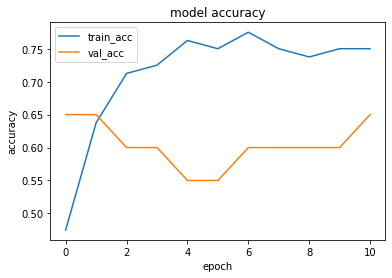

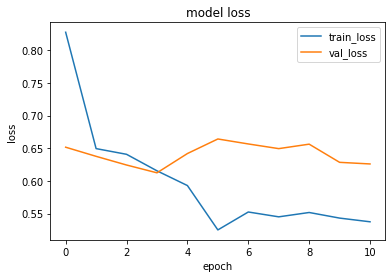

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.33089793]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.3285898]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6507572]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.21494746]]


1it [00:00, 18236.10it/s]


prediction for video control_2.mov is [[0.19285119]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.1937809]]


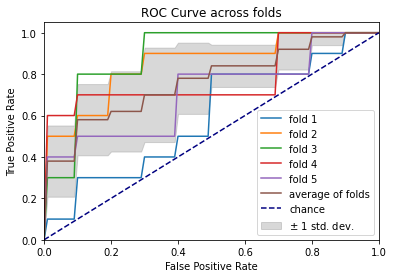

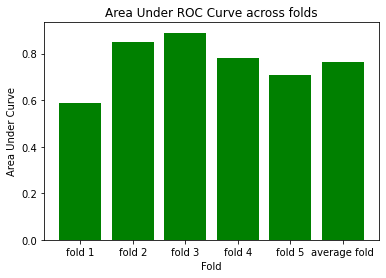

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 220ms/step - loss: 0.6539 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.7739 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6315 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6400 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5824 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.5353 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6161 - accuracy: 0.6500 - precision: 0.6667 - recall: 0.6000 - val_loss: 0.4679 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 131

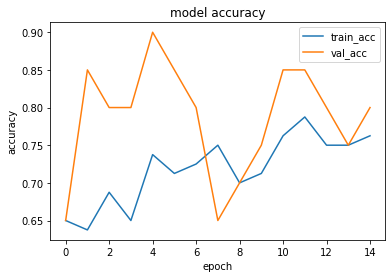

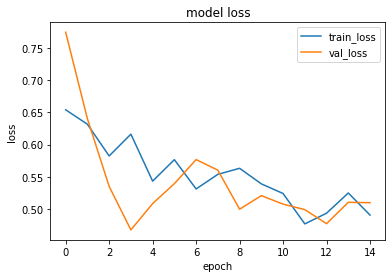

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.49889597]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.405487]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.58571005]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.3699339]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2920541]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.23410118]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6851 - accuracy: 0.6000 - precision: 0.5833 - recall: 0.7000 - val_loss: 0.6556 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6513 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.6715 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6216 - accuracy: 0.6500 - precision: 0.7143 - recall: 0.5000 - val_loss: 0.6182 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5887 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.5779 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

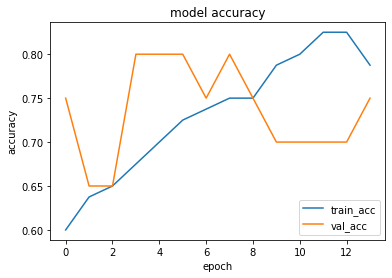

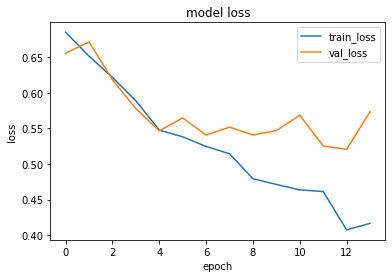

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.34225678]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.34600514]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.5801659]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.25849128]]


1it [00:00, 12945.38it/s]


prediction for video control_2.mov is [[0.25464785]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.25821865]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7184 - accuracy: 0.4500 - precision: 0.4655 - recall: 0.6750 - val_loss: 0.7067 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6105 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.7075 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5584 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.7410 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5491 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.7425 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

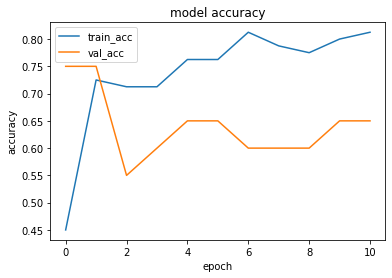

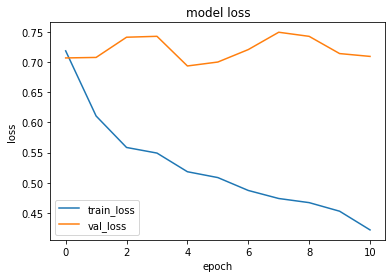

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.39672387]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.35169995]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.7804221]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.24414414]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.19644445]]


1it [00:00, 16578.28it/s]


prediction for video control_3.mov is [[0.2069819]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6435 - accuracy: 0.5125 - precision: 0.5102 - recall: 0.6250 - val_loss: 0.8566 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6607 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6140 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5821 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.5853 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5585 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6489 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoc

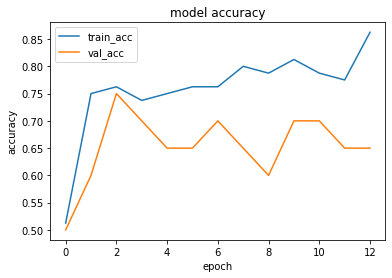

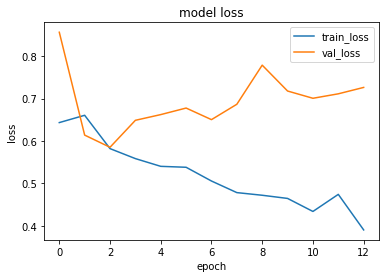

1it [00:00, 17189.77it/s]


prediction for video armflapping_1.mov is [[0.7423655]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.65229845]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_2.mov is [[0.9147947]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.3803017]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.27810958]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.1949811]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7016 - accuracy: 0.5750 - precision: 0.5600 - recall: 0.7000 - val_loss: 0.6548 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6275 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6158 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6338 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.5016 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5661 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.4939 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoc

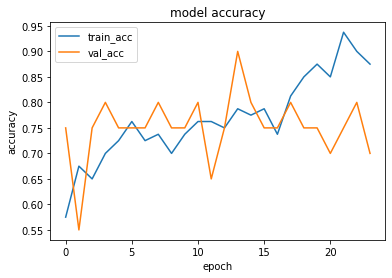

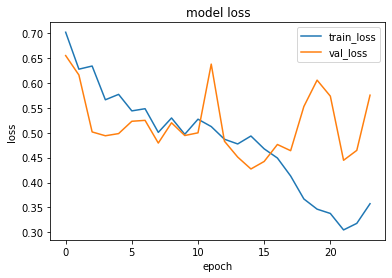

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5614703]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_3.mov is [[0.41338247]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.7624143]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.4170577]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.20228645]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.24336267]]


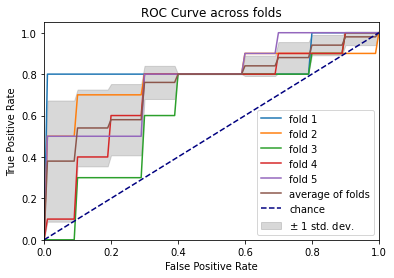

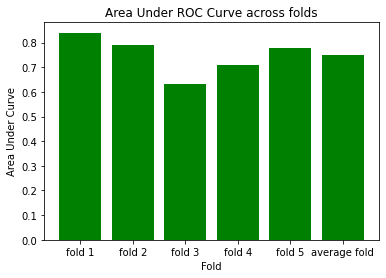

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.8727 - accuracy: 0.3875 - precision: 0.4286 - recall: 0.6750 - val_loss: 0.6698 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6456 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6210 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6213 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6163 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6038 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6240 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 132

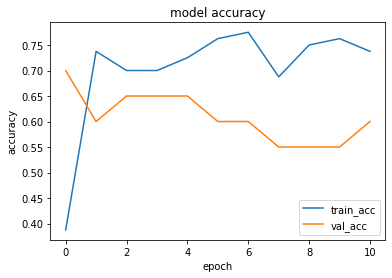

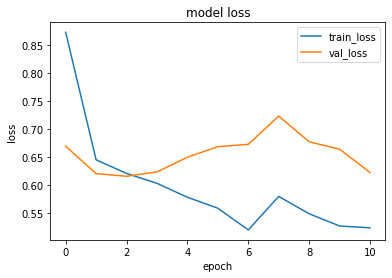

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.52048314]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.5834269]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.5743024]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.4990683]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.49422526]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.49501896]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6814 - accuracy: 0.5125 - precision: 0.5091 - recall: 0.7000 - val_loss: 0.7204 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6204 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.6163 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5826 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.5493 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5492 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.5664 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

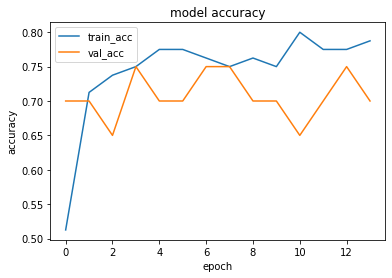

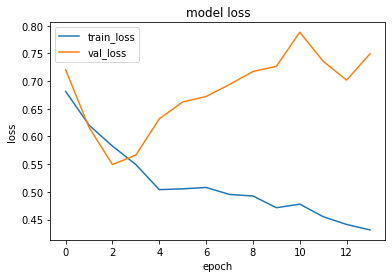

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4578673]]


1it [00:00, 13400.33it/s]


prediction for video armflapping_3.mov is [[0.4495016]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.65236557]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.25224867]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.18490815]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.15122443]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.8210 - accuracy: 0.4625 - precision: 0.4286 - recall: 0.2250 - val_loss: 0.6290 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6594 - accuracy: 0.6125 - precision: 0.5789 - recall: 0.8250 - val_loss: 0.6227 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6616 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.5771 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5943 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5560 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epo

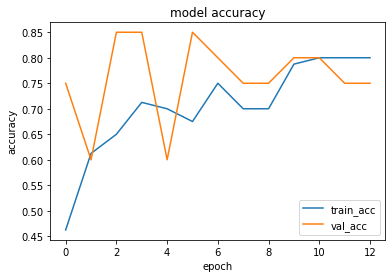

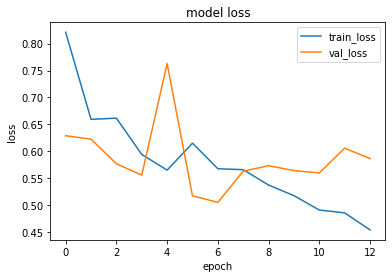

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.5779529]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.5883033]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.66456664]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.5109421]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.46045285]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.45429787]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6365 - accuracy: 0.6375 - precision: 0.6486 - recall: 0.6000 - val_loss: 1.0394 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6350 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.7867 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5916 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.7844 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5333 - accuracy: 0.7750 - precision: 0.8235 - recall: 0.7000 - val_loss: 0.8129 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epo

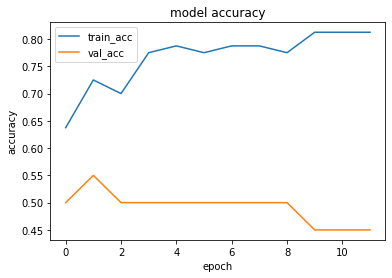

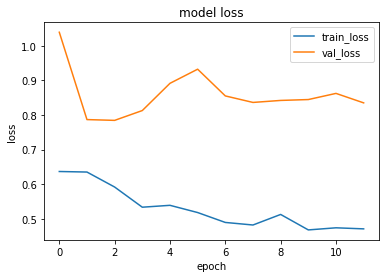

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.6634476]]


1it [00:00, 19599.55it/s]


prediction for video armflapping_3.mov is [[0.29114568]]


1it [00:00, 12372.58it/s]


prediction for video armflapping_2.mov is [[0.73288584]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.5305359]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.16605437]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.414684]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7364 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6749 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6670 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 0.6088 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6195 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.5730 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6125 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.5465 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch

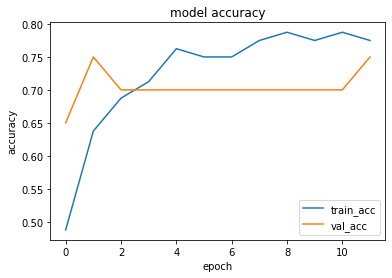

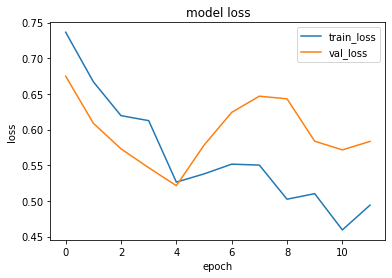

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.5146191]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.43799984]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.8103212]]


1it [00:00, 6944.21it/s]


prediction for video control_1.mov is [[0.25135845]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.19440779]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.18534595]]


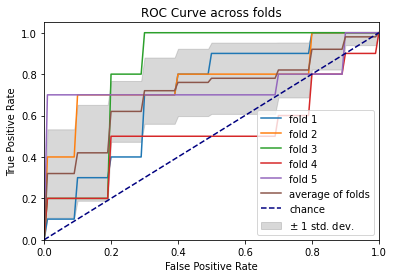

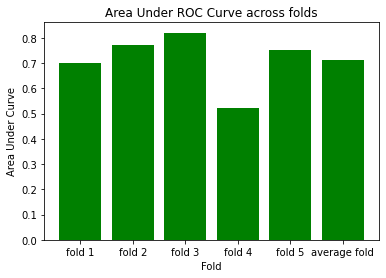

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 185ms/step - loss: 0.6759 - accuracy: 0.5625 - precision: 0.5926 - recall: 0.4000 - val_loss: 0.6281 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.7648 - accuracy: 0.5250 - precision: 0.5139 - recall: 0.9250 - val_loss: 0.5746 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6214 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6109 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6656 - accuracy: 0.5750 - precision: 0.6667 - recall: 0.3000 - val_loss: 0.5615 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 141

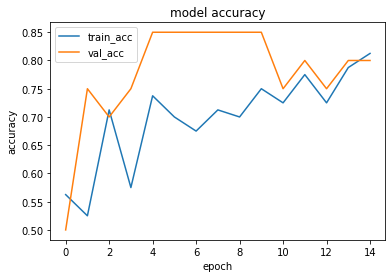

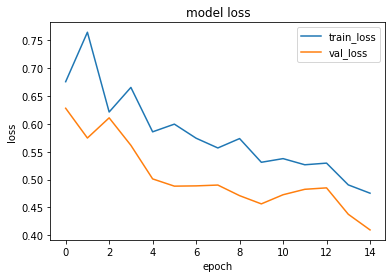

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.530679]]


1it [00:00, 4696.87it/s]


prediction for video armflapping_3.mov is [[0.46086994]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.658538]]


1it [00:00, 17331.83it/s]


prediction for video control_1.mov is [[0.43965313]]


1it [00:00, 13934.56it/s]


prediction for video control_2.mov is [[0.28626305]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.32205427]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6860 - accuracy: 0.5500 - precision: 0.5455 - recall: 0.6000 - val_loss: 0.7480 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6384 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6224 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5784 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.5864 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5711 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.6208 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

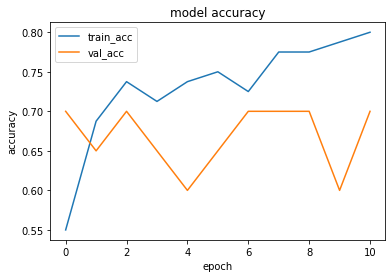

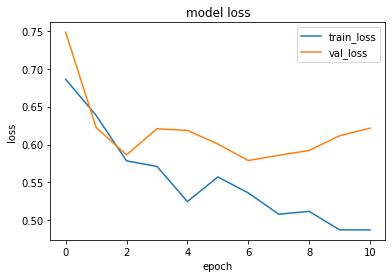

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.39612457]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.38496196]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.83335453]]


1it [00:00, 15087.42it/s]


prediction for video control_1.mov is [[0.25723964]]


1it [00:00, 5882.61it/s]


prediction for video control_2.mov is [[0.23236862]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.2311418]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7256 - accuracy: 0.5750 - precision: 0.5938 - recall: 0.4750 - val_loss: 0.6927 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6806 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.6331 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6049 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6129 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5634 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.5610 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoc

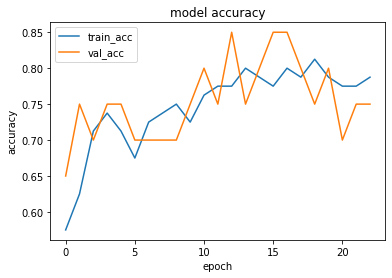

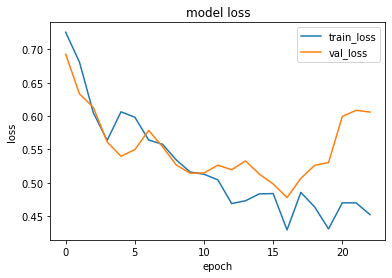

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.600856]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.2301648]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_2.mov is [[0.79575795]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.2729823]]


1it [00:00, 10205.12it/s]


prediction for video control_2.mov is [[0.20170802]]


1it [00:00, 12520.31it/s]


prediction for video control_3.mov is [[0.26218796]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6802 - accuracy: 0.6000 - precision: 0.5769 - recall: 0.7500 - val_loss: 0.7692 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5988 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.5680 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6041 - accuracy: 0.7000 - precision: 0.9000 - recall: 0.4500 - val_loss: 0.5897 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5872 - accuracy: 0.7375 - precision: 0.6863 - recall: 0.8750 - val_loss: 0.6661 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epo

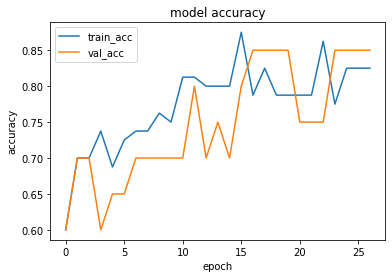

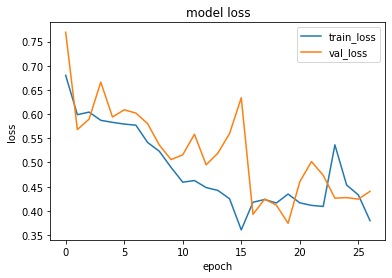

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.43246102]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_3.mov is [[0.49517837]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.6620342]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.2779752]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.20829311]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.18463433]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7307 - accuracy: 0.5750 - precision: 0.5600 - recall: 0.7000 - val_loss: 0.7252 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5651 - accuracy: 0.8000 - precision: 0.8000 - recall: 0.8000 - val_loss: 0.7627 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5303 - accuracy: 0.7625 - precision: 0.7234 - recall: 0.8500 - val_loss: 0.7866 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5488 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.8044 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

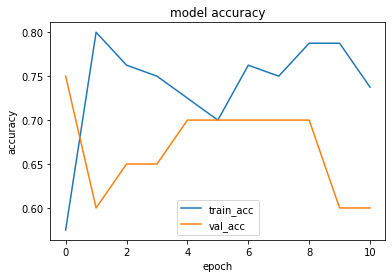

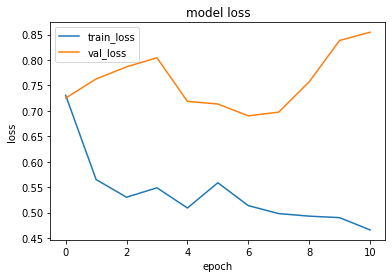

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.7034642]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.6453605]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.73185945]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.58279735]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.357997]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.2489529]]


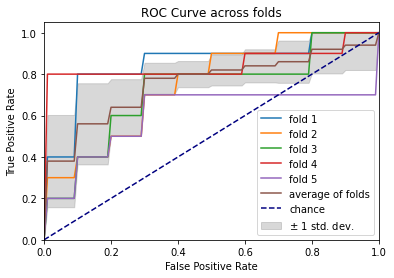

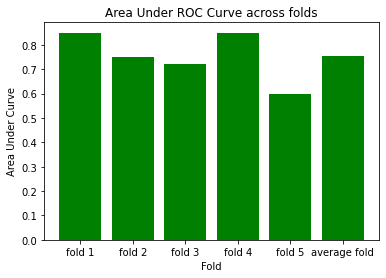

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6682 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.7106 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6889 - accuracy: 0.5875 - precision: 0.5538 - recall: 0.9000 - val_loss: 0.7923 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6085 - accuracy: 0.7500 - precision: 0.8846 - recall: 0.5750 - val_loss: 0.6238 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6014 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.5387 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 134

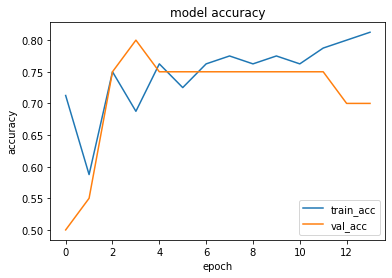

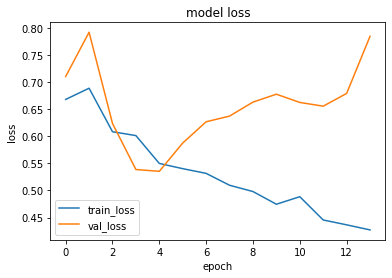

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.64190316]]


1it [00:00, 3187.16it/s]


prediction for video armflapping_3.mov is [[0.4952186]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.7402319]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.49090517]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.39269546]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.35497648]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 201ms/step - loss: 0.7170 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5500 - val_loss: 0.6297 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 1s 248ms/step - loss: 0.6269 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.5978 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 253ms/step - loss: 0.6151 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.5644 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 1s 248ms/step - loss: 0.5931 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.5348 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

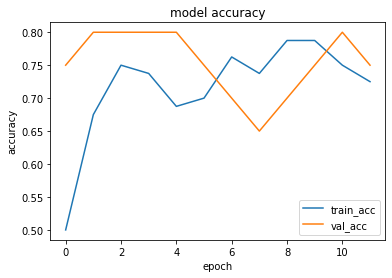

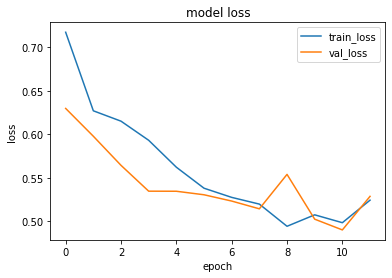

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.6472087]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.7228092]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.7936826]]


1it [00:00, 6594.82it/s]


prediction for video control_1.mov is [[0.24184409]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.22692779]]


1it [00:00, 12826.62it/s]


prediction for video control_3.mov is [[0.22211179]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7400 - accuracy: 0.4500 - precision: 0.4545 - recall: 0.5000 - val_loss: 0.6441 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6412 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6028 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6117 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.5825 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6031 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.5803 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

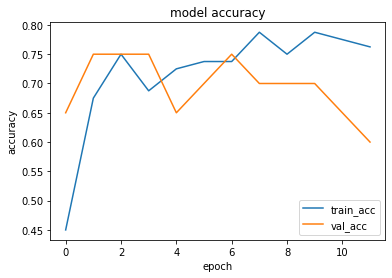

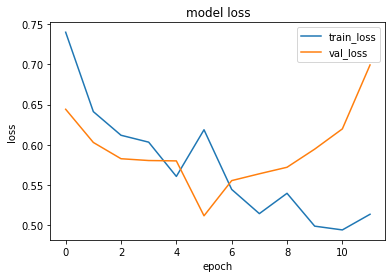

1it [00:00, 17623.13it/s]


prediction for video armflapping_1.mov is [[0.47997996]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.3840365]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_2.mov is [[0.66984165]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.24100304]]


1it [00:00, 12787.51it/s]


prediction for video control_2.mov is [[0.21492073]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.20447987]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 140ms/step - loss: 0.6743 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.6271 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6101 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.6884 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5963 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.7253 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5488 - accuracy: 0.7750 - precision: 0.7391 - recall: 0.8500 - val_loss: 0.6224 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

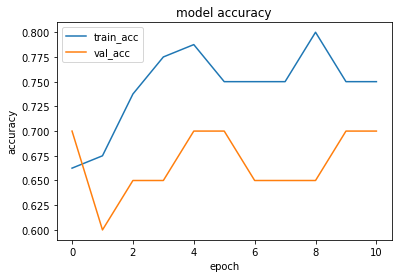

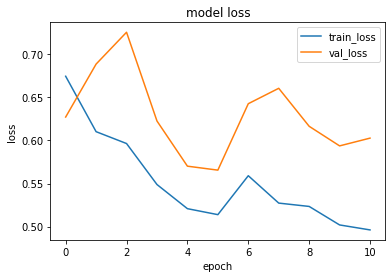

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.629052]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.76548785]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.73913205]]


1it [00:00, 6213.78it/s]


prediction for video control_1.mov is [[0.19572496]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.17267525]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.16645]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7326 - accuracy: 0.5500 - precision: 0.5476 - recall: 0.5750 - val_loss: 0.6569 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6265 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6431 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5699 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6637 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5719 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6932 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 

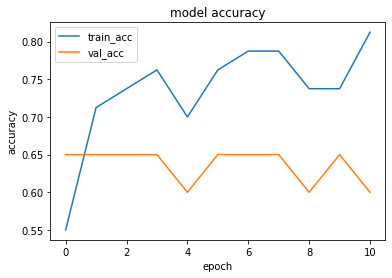

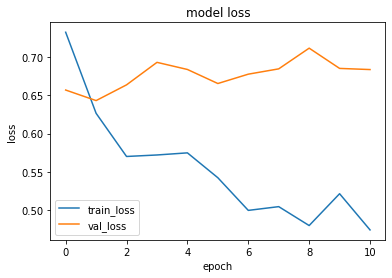

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5522797]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.27821612]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_2.mov is [[0.6467354]]


1it [00:00, 95.34it/s]


prediction for video control_1.mov is [[0.21626985]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.19166711]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.18981168]]


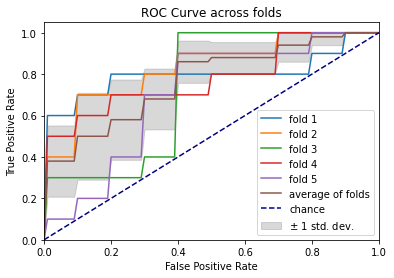

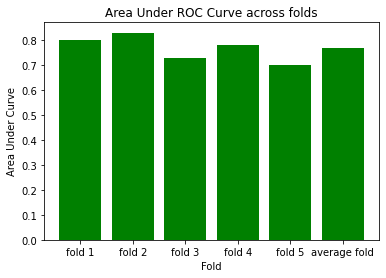

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 174ms/step - loss: 0.7376 - accuracy: 0.5875 - precision: 0.5686 - recall: 0.7250 - val_loss: 0.5837 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6328 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5724 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5795 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5359 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5959 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.5400 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 134

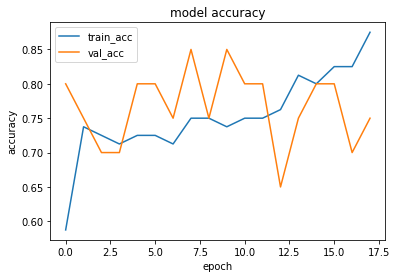

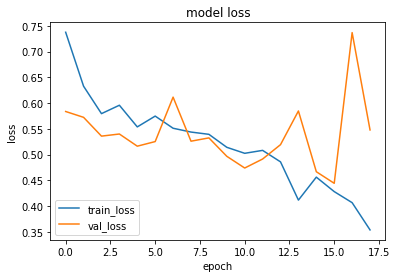

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.55250293]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.6863703]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_2.mov is [[0.81387615]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.29681924]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.22856665]]


1it [00:00, 11214.72it/s]


prediction for video control_3.mov is [[0.21896783]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 140ms/step - loss: 0.6951 - accuracy: 0.4750 - precision: 0.4773 - recall: 0.5250 - val_loss: 0.7694 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6429 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.6419 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6063 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.6215 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5333 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.5922 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

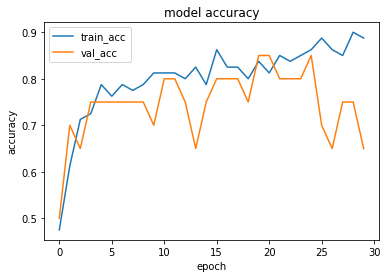

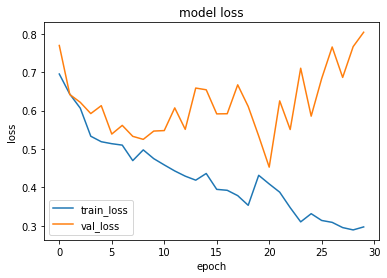

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.2525763]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.34173378]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.89825904]]


1it [00:00, 16384.00it/s]


prediction for video control_1.mov is [[0.0653322]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.2991046]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.28294483]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6588 - accuracy: 0.4875 - precision: 0.4906 - recall: 0.6500 - val_loss: 0.7697 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.7010 - accuracy: 0.5625 - precision: 0.6667 - recall: 0.2500 - val_loss: 0.6792 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5882 - accuracy: 0.7375 - precision: 0.6863 - recall: 0.8750 - val_loss: 0.6978 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5615 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6769 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

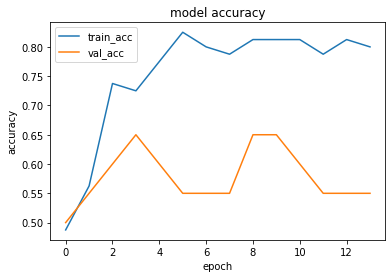

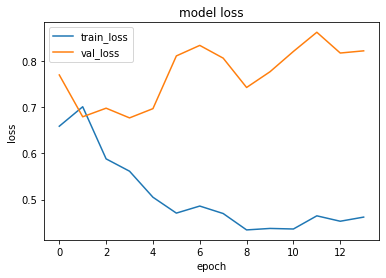

1it [00:00, 20867.18it/s]


prediction for video armflapping_1.mov is [[0.6014898]]


1it [00:00, 20763.88it/s]


prediction for video armflapping_3.mov is [[0.2978739]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.7768383]]


1it [00:00, 14074.85it/s]


prediction for video control_1.mov is [[0.38647276]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.21347308]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.25821868]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6431 - accuracy: 0.6500 - precision: 0.6000 - recall: 0.9000 - val_loss: 1.1110 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.8934 - accuracy: 0.5000 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.6745 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6479 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.5788 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6098 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.5273 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_re

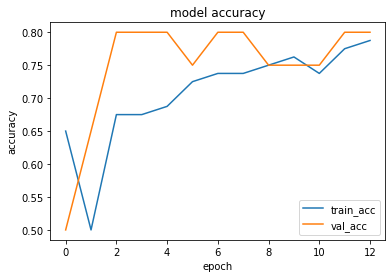

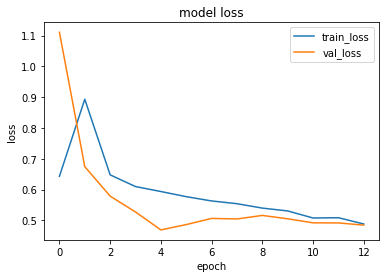

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.29497945]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.26768488]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.74408066]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.28590077]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.3025064]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.3042726]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7610 - accuracy: 0.4875 - precision: 0.4912 - recall: 0.7000 - val_loss: 0.6683 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6700 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.6487 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6267 - accuracy: 0.7375 - precision: 0.8065 - recall: 0.6250 - val_loss: 0.6631 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6089 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6600 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoc

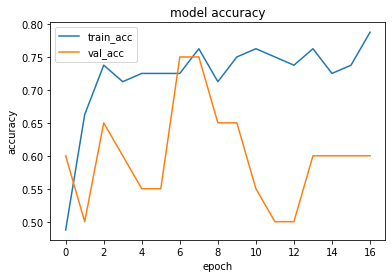

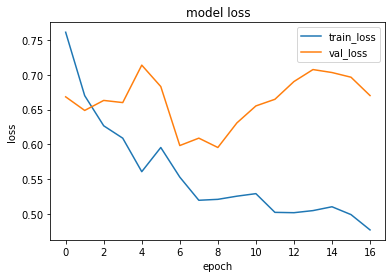

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.36875805]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.47294113]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.61596113]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.24789232]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.21573421]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.20765796]]


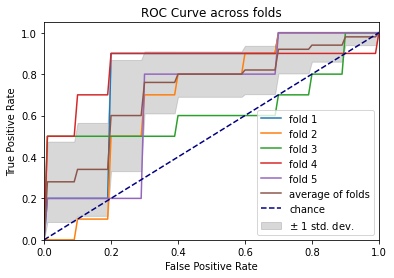

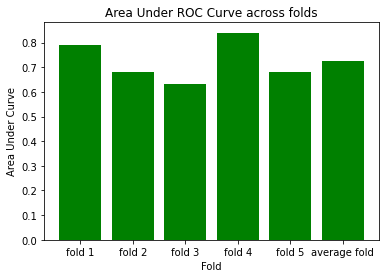

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6546 - accuracy: 0.5625 - precision: 0.5556 - recall: 0.6250 - val_loss: 0.7617 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7244 - accuracy: 0.5875 - precision: 0.6400 - recall: 0.4000 - val_loss: 0.5831 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6198 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.5745 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5363 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6218 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] 

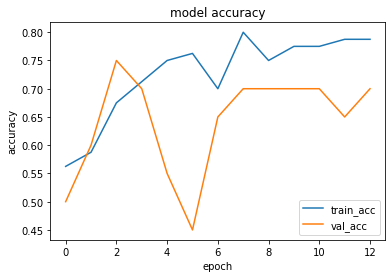

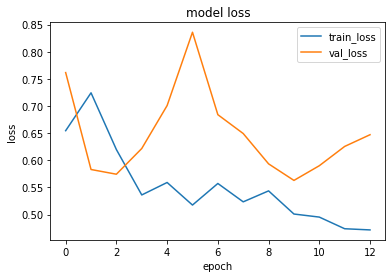

1it [00:00, 8338.58it/s]


prediction for video armflapping_1.mov is [[0.57557535]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.54558486]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_2.mov is [[0.66388476]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.48693028]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.37984288]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.39708924]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.8508 - accuracy: 0.4750 - precision: 0.4500 - recall: 0.2250 - val_loss: 0.6043 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6729 - accuracy: 0.6125 - precision: 0.5692 - recall: 0.9250 - val_loss: 0.5793 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6664 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.5572 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6306 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.5290 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

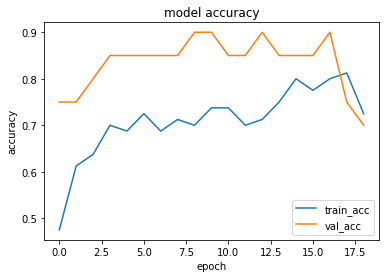

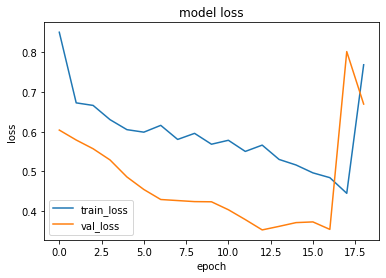

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4916559]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.38476658]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.6527312]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.36216968]]


1it [00:00, 14563.56it/s]


prediction for video control_2.mov is [[0.3094226]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.31395465]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6973 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.7644 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5917 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.7197 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5421 - accuracy: 0.7875 - precision: 0.7949 - recall: 0.7750 - val_loss: 0.7952 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5340 - accuracy: 0.7375 - precision: 0.8065 - recall: 0.6250 - val_loss: 0.8418 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epo

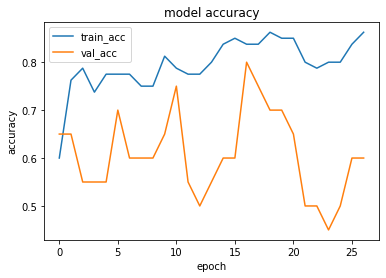

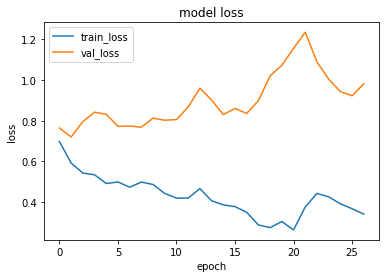

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.3895901]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.63309747]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_2.mov is [[0.8747053]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.08033457]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.19634992]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.1227006]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6982 - accuracy: 0.5500 - precision: 0.5500 - recall: 0.5500 - val_loss: 0.5942 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5822 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6235 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6360 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.5808 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5712 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5425 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoc

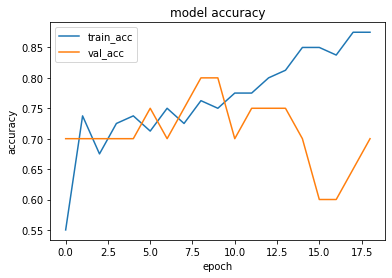

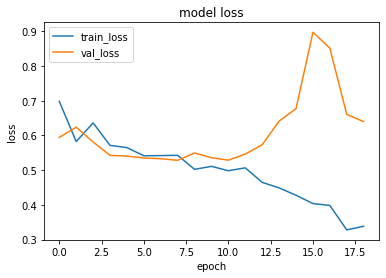

1it [00:00, 11781.75it/s]


prediction for video armflapping_1.mov is [[0.35577357]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.2997612]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_2.mov is [[0.6503341]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.23647383]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.34942442]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.32985303]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6484 - accuracy: 0.4875 - precision: 0.4898 - recall: 0.6000 - val_loss: 1.0039 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6887 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.7171 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6070 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.7242 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6108 - accuracy: 0.7375 - precision: 0.8519 - recall: 0.5750 - val_loss: 0.7284 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

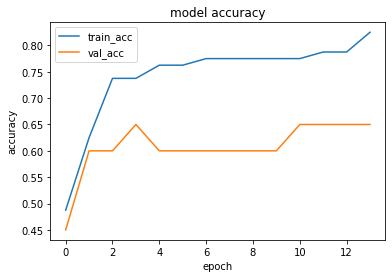

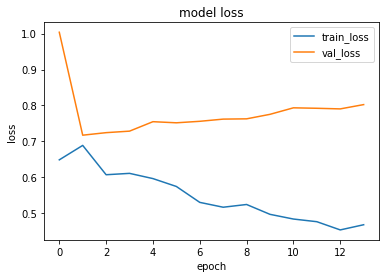

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.6647714]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.19102731]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.8582537]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.18353558]]


1it [00:00, 19972.88it/s]


prediction for video control_2.mov is [[0.18228394]]


1it [00:00, 12671.61it/s]


prediction for video control_3.mov is [[0.17896515]]


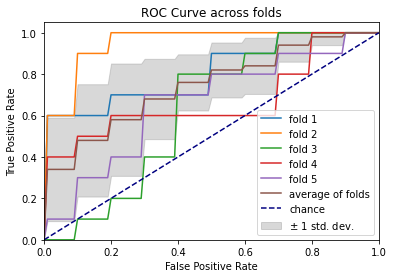

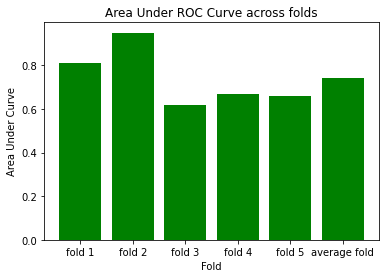

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7196 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.4750 - val_loss: 0.6806 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6104 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.7106 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5510 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.7781 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.4999 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7476 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 135

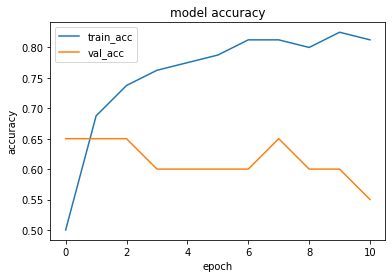

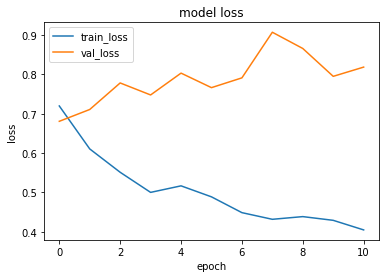

1it [00:00, 14074.85it/s]


prediction for video armflapping_1.mov is [[0.55237544]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.5221899]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.5865228]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.51835185]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.49953505]]


1it [00:00, 19152.07it/s]


prediction for video control_3.mov is [[0.49492565]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6965 - accuracy: 0.5875 - precision: 0.5946 - recall: 0.5500 - val_loss: 0.6250 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6619 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.6056 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6062 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5911 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5446 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.5588 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

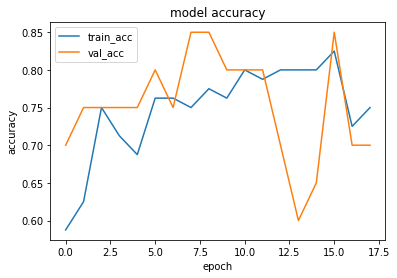

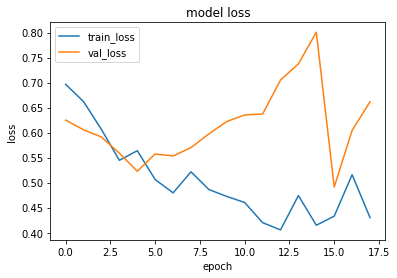

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.6783325]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.3254718]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.8393205]]


1it [00:00, 19239.93it/s]


prediction for video control_1.mov is [[0.400473]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.31062186]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.3199751]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6363 - accuracy: 0.6250 - precision: 0.6250 - recall: 0.6250 - val_loss: 1.1123 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7756 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.8148 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5939 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.7143 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5750 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.8262 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoc

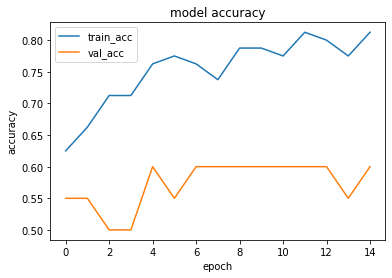

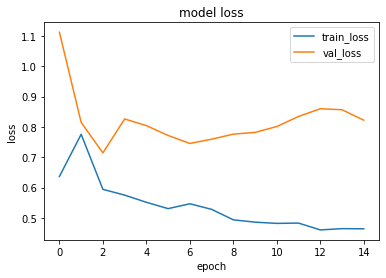

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.72329754]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.4017682]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.7950386]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.5384016]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.11580214]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.1154376]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7405 - accuracy: 0.4875 - precision: 0.4915 - recall: 0.7250 - val_loss: 0.6404 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6167 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.6119 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6041 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.5663 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5641 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.5600 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

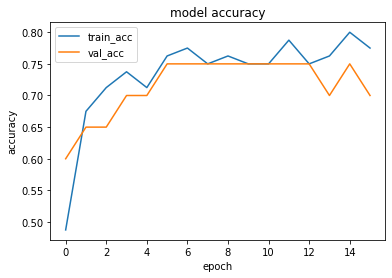

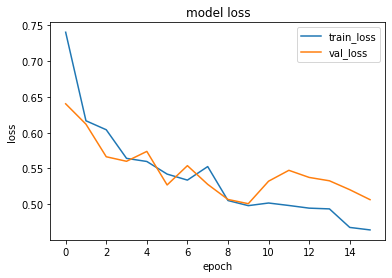

1it [00:00, 12520.31it/s]


prediction for video armflapping_1.mov is [[0.71226144]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.78466606]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.7615233]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.24887455]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.2286632]]


1it [00:00, 18808.54it/s]


prediction for video control_3.mov is [[0.22852802]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7057 - accuracy: 0.5375 - precision: 0.5429 - recall: 0.4750 - val_loss: 0.5789 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 1s 197ms/step - loss: 0.6867 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.5617 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6658 - accuracy: 0.6125 - precision: 0.6452 - recall: 0.5000 - val_loss: 0.5675 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6484 - accuracy: 0.6500 - precision: 0.7000 - recall: 0.5250 - val_loss: 0.4669 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

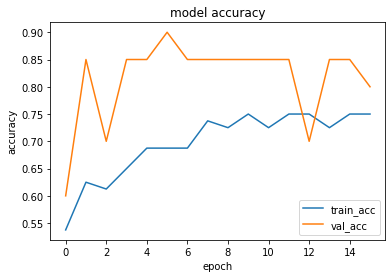

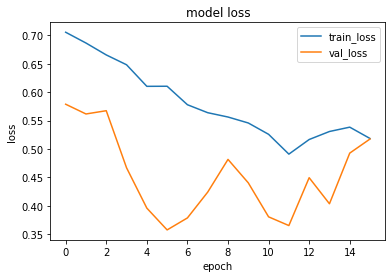

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.46619195]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.44924223]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.66315246]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.2996515]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.222799]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.21640661]]


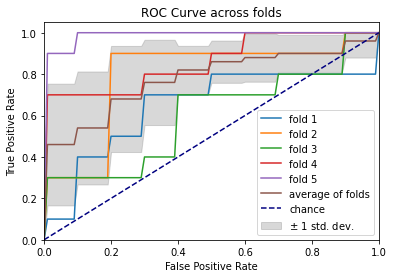

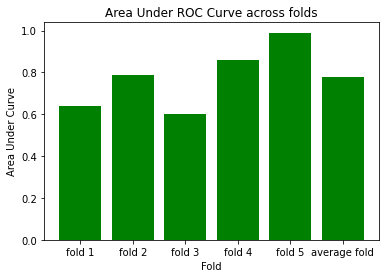

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6983 - accuracy: 0.4625 - precision: 0.4727 - recall: 0.6500 - val_loss: 0.7483 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6536 - accuracy: 0.6375 - precision: 0.8235 - recall: 0.3500 - val_loss: 0.6729 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5992 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6669 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5366 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7007 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] 

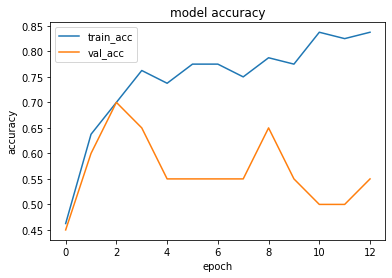

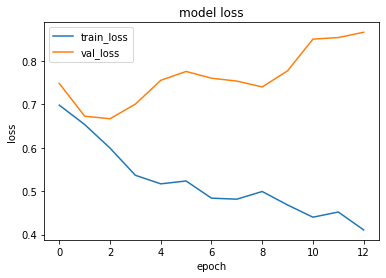

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.60001194]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_3.mov is [[0.5420037]]


1it [00:00, 11008.67it/s]


prediction for video armflapping_2.mov is [[0.69380367]]


1it [00:00, 19152.07it/s]


prediction for video control_1.mov is [[0.48149982]]


1it [00:00, 19328.59it/s]


prediction for video control_2.mov is [[0.42792144]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.39295927]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7004 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.6987 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6065 - accuracy: 0.7375 - precision: 0.6863 - recall: 0.8750 - val_loss: 0.6376 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5472 - accuracy: 0.7750 - precision: 0.7750 - recall: 0.7750 - val_loss: 0.7002 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5308 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6793 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

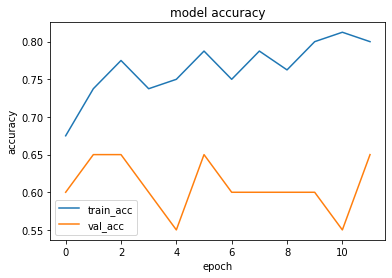

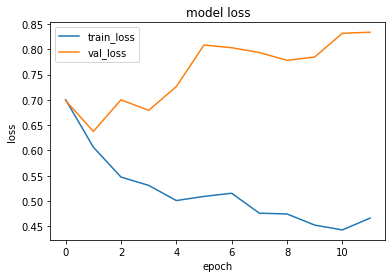

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.6054539]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.586229]]


1it [00:00, 11650.84it/s]


prediction for video armflapping_2.mov is [[0.8325273]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.145513]]


1it [00:00, 17924.38it/s]


prediction for video control_2.mov is [[0.1458621]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.14653963]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 143ms/step - loss: 0.8596 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5750 - val_loss: 0.6689 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6931 - accuracy: 0.5625 - precision: 0.6667 - recall: 0.2500 - val_loss: 0.6758 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6294 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6498 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5922 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6380 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

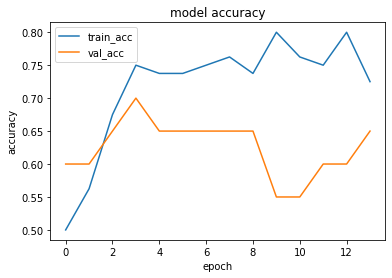

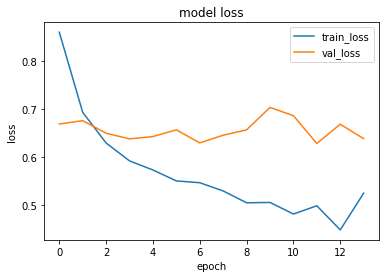

1it [00:00, 16194.22it/s]


prediction for video armflapping_1.mov is [[0.5428606]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.33709595]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_2.mov is [[0.69500285]]


1it [00:00, 12985.46it/s]


prediction for video control_1.mov is [[0.25673467]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.234633]]


1it [00:00, 13842.59it/s]


prediction for video control_3.mov is [[0.23237148]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7611 - accuracy: 0.4875 - precision: 0.4884 - recall: 0.5250 - val_loss: 0.6218 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6574 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.5579 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6193 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.4989 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5630 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5000 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

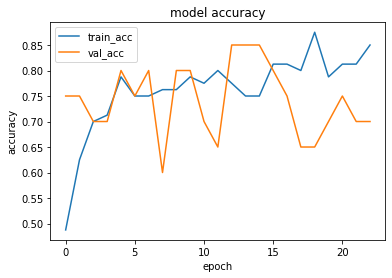

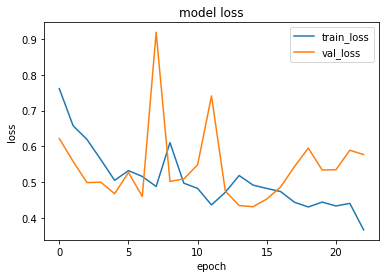

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.4027097]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.22689661]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5704899]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.23341858]]


1it [00:00, 16578.28it/s]


prediction for video control_2.mov is [[0.19105163]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.19430944]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7484 - accuracy: 0.4375 - precision: 0.4390 - recall: 0.4500 - val_loss: 0.6326 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6305 - accuracy: 0.6375 - precision: 0.5873 - recall: 0.9250 - val_loss: 0.5925 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6205 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.5474 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5734 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.4810 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

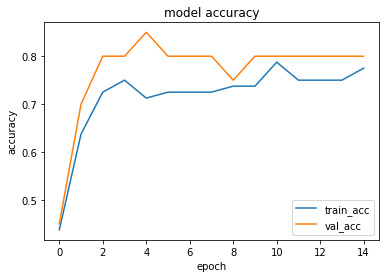

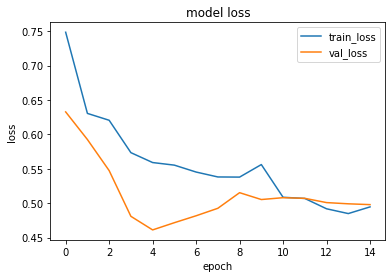

1it [00:00, 13148.29it/s]


prediction for video armflapping_1.mov is [[0.74422187]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.6761723]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.81830895]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.49329528]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.2507348]]


1it [00:00, 16070.13it/s]


prediction for video control_3.mov is [[0.18167776]]


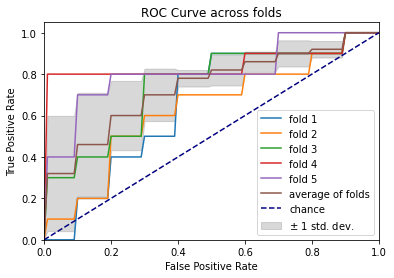

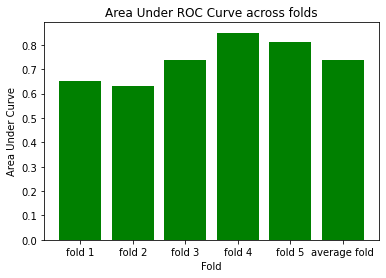

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6958 - accuracy: 0.5875 - precision: 0.5897 - recall: 0.5750 - val_loss: 0.6892 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6747 - accuracy: 0.6000 - precision: 0.7000 - recall: 0.3500 - val_loss: 0.6189 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5834 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5857 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5947 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5959 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 137

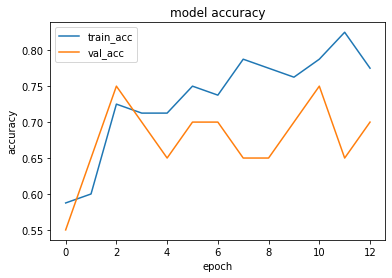

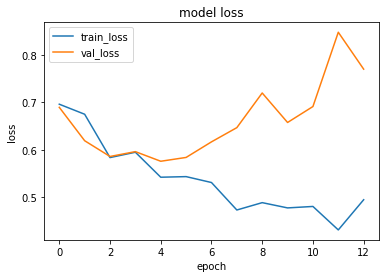

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.44257367]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.5485109]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.63392454]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.34931383]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.31997144]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.30631733]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6974 - accuracy: 0.6250 - precision: 0.6923 - recall: 0.4500 - val_loss: 0.7829 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6658 - accuracy: 0.6375 - precision: 0.5846 - recall: 0.9500 - val_loss: 0.7252 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 1s 215ms/step - loss: 0.5774 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.7620 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5422 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.8034 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epo

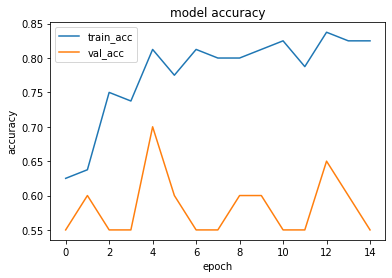

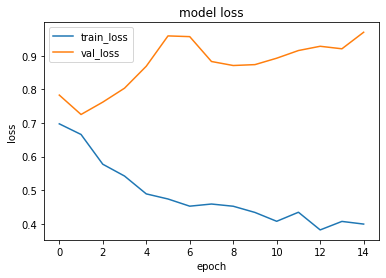

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.36343312]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.09225184]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.88126117]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.07940704]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.14092398]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.13698241]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6968 - accuracy: 0.6125 - precision: 0.6000 - recall: 0.6750 - val_loss: 0.7108 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5931 - accuracy: 0.7875 - precision: 0.7556 - recall: 0.8500 - val_loss: 0.6720 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5291 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.8342 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5380 - accuracy: 0.8125 - precision: 0.8571 - recall: 0.7500 - val_loss: 0.7929 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epo

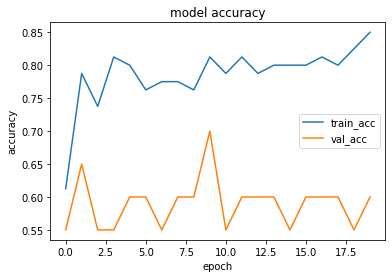

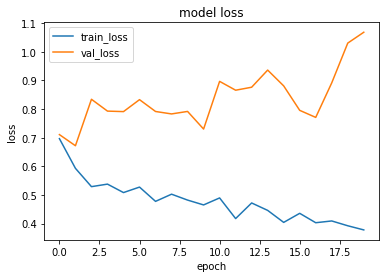

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.3077247]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.5785819]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.75904906]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.15085989]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.11609694]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.1258105]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7019 - accuracy: 0.5375 - precision: 0.5306 - recall: 0.6500 - val_loss: 0.5600 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6535 - accuracy: 0.6375 - precision: 0.6170 - recall: 0.7250 - val_loss: 0.5068 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6475 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.4593 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6029 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.4103 - val_accuracy: 0.9500 - val_precision: 0.9091 - val_recall: 1.0000
Epoc

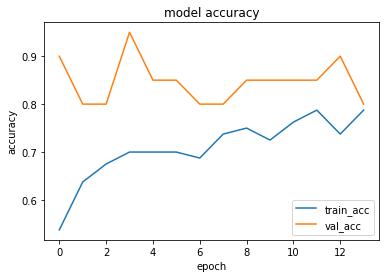

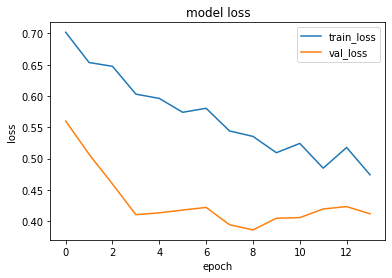

1it [00:00, 17549.39it/s]


prediction for video armflapping_1.mov is [[0.47437894]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.48938718]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_2.mov is [[0.62760764]]


1it [00:00, 15827.56it/s]


prediction for video control_1.mov is [[0.35838765]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.29232195]]


1it [00:00, 19508.39it/s]


prediction for video control_3.mov is [[0.28323805]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 141ms/step - loss: 0.7156 - accuracy: 0.5250 - precision: 0.5217 - recall: 0.6000 - val_loss: 0.6384 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6397 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.5671 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6220 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.5259 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6012 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.5014 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epo

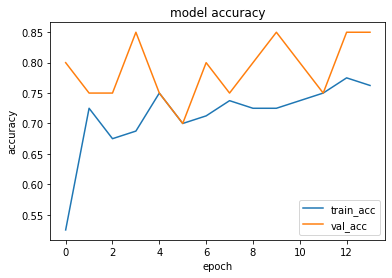

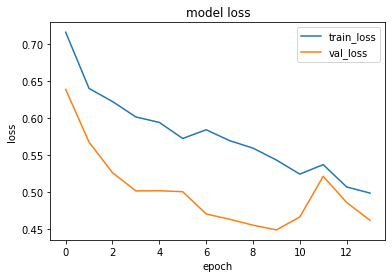

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.45727634]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.6622994]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6648242]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.33043325]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.29087618]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.2905]]


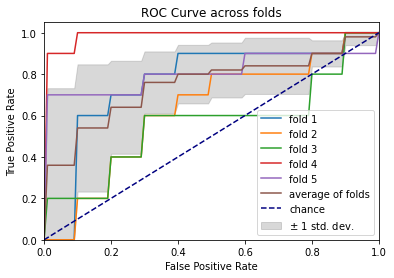

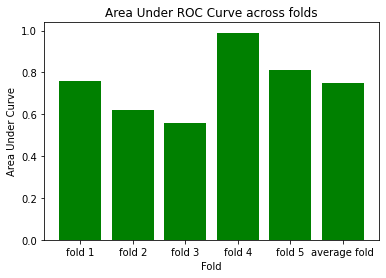

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.7236 - accuracy: 0.5500 - precision: 0.5357 - recall: 0.7500 - val_loss: 0.6767 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6440 - accuracy: 0.6250 - precision: 0.6923 - recall: 0.4500 - val_loss: 0.7481 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5396 - accuracy: 0.8125 - precision: 0.7660 - recall: 0.9000 - val_loss: 0.8008 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 127ms/step - loss: 0.5433 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.8054 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 138

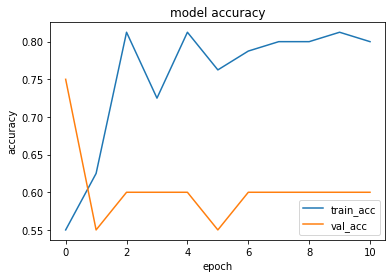

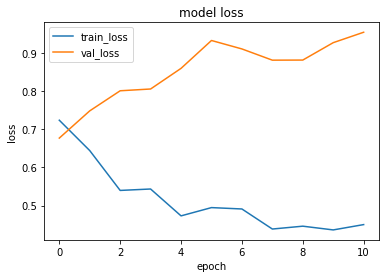

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.4921851]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.4896076]]


1it [00:00, 4760.84it/s]


prediction for video armflapping_2.mov is [[0.52027094]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.4759005]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.46168607]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.46604115]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6714 - accuracy: 0.5625 - precision: 0.5455 - recall: 0.7500 - val_loss: 0.6432 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6323 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6063 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6197 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.6426 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5870 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6468 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epo

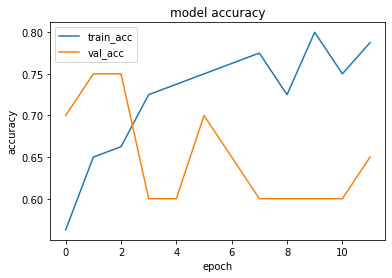

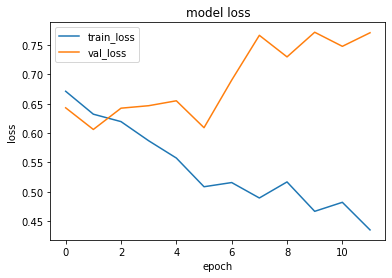

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.4667948]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_3.mov is [[0.35523322]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_2.mov is [[0.58491725]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.33896202]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.33072233]]


1it [00:00, 17331.83it/s]


prediction for video control_3.mov is [[0.31019223]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6610 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6750 - val_loss: 0.6167 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6487 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.5632 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5757 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.5558 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5804 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.4948 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

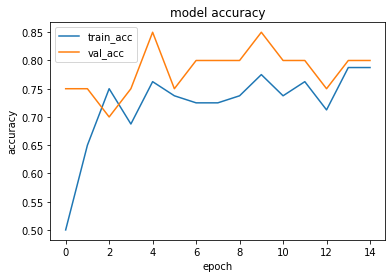

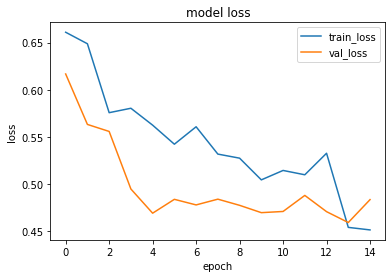

1it [00:00, 16070.13it/s]


prediction for video armflapping_1.mov is [[0.6102378]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.6330784]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.7034298]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.36657286]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.25013366]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.18965405]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7392 - accuracy: 0.4250 - precision: 0.4318 - recall: 0.4750 - val_loss: 0.8031 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6747 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.6440 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6281 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6322 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6203 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6274 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

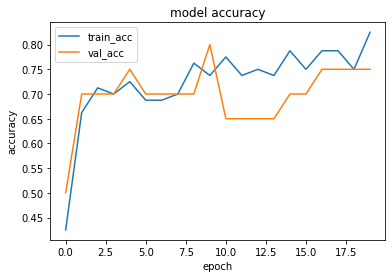

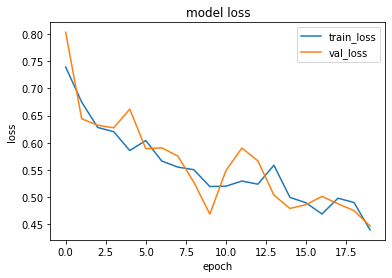

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.67334163]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.4519009]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.8218239]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.26333755]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.214317]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.21181774]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.8711 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.3000 - val_loss: 0.6697 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6636 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.6446 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6092 - accuracy: 0.6875 - precision: 0.6271 - recall: 0.9250 - val_loss: 0.6534 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5796 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6362 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

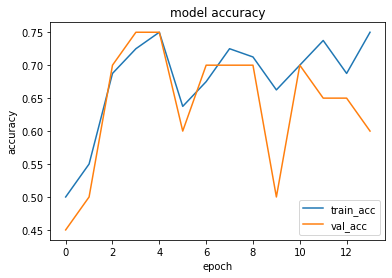

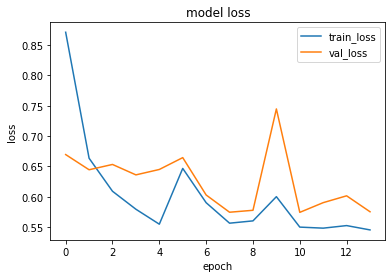

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.36660767]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.56787586]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5387435]]


1it [00:00, 6132.02it/s]


prediction for video control_1.mov is [[0.2993227]]


1it [00:00, 14122.24it/s]


prediction for video control_2.mov is [[0.28265357]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.2811212]]


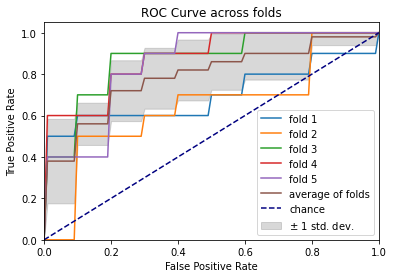

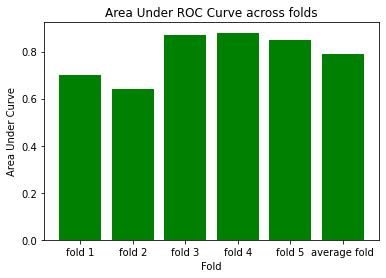

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7387 - accuracy: 0.5125 - precision: 0.5128 - recall: 0.5000 - val_loss: 0.6788 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6331 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6006 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6076 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.5779 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5488 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5702 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 135

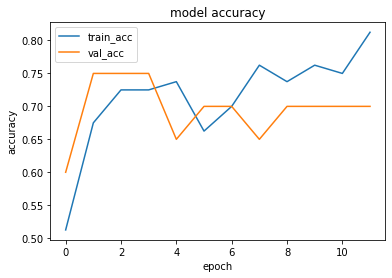

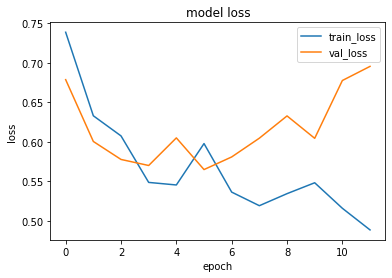

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5459434]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.57009727]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.6220852]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.4636124]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.40758198]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.40491655]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6702 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.6119 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6015 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6240 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5934 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.6246 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5625 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6046 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

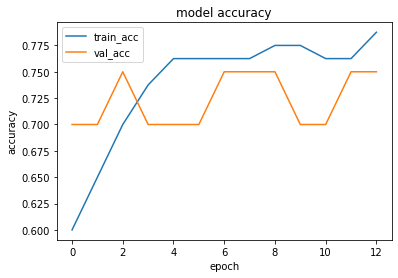

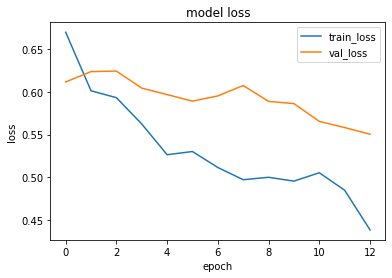

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5838669]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_3.mov is [[0.6646403]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.76311266]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.242749]]


1it [00:00, 6765.01it/s]


prediction for video control_2.mov is [[0.24653548]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.2381593]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6967 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.6351 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 127ms/step - loss: 0.6735 - accuracy: 0.5625 - precision: 0.5342 - recall: 0.9750 - val_loss: 0.6479 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6082 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6794 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5728 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.6262 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoc

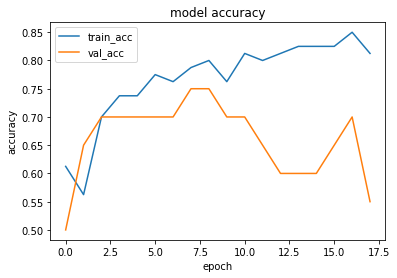

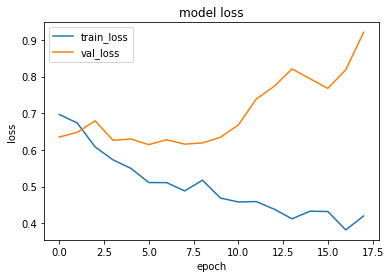

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.38477808]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.8329246]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.9465145]]


1it [00:00, 19152.07it/s]


prediction for video control_1.mov is [[0.20239535]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.16500673]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.19158033]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6980 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.6840 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5960 - accuracy: 0.7375 - precision: 0.8276 - recall: 0.6000 - val_loss: 0.6419 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5309 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.7472 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5780 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.8281 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

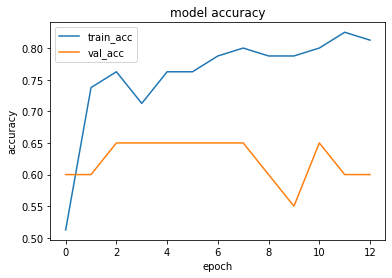

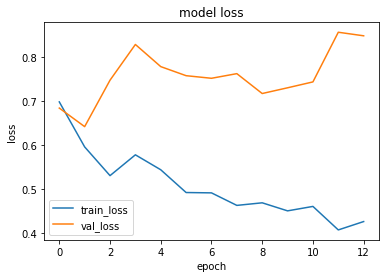

1it [00:00, 16320.25it/s]


prediction for video armflapping_1.mov is [[0.81988]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.61623424]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.9031331]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.3985534]]


1it [00:00, 16320.25it/s]


prediction for video control_2.mov is [[0.27650523]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.22118968]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7407 - accuracy: 0.4750 - precision: 0.4762 - recall: 0.5000 - val_loss: 0.6121 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6462 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 0.5165 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6003 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.4673 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5529 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.4180 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

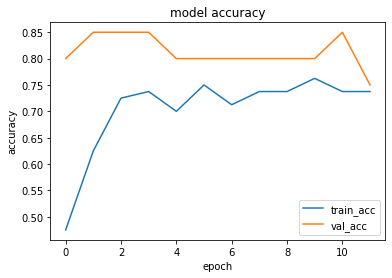

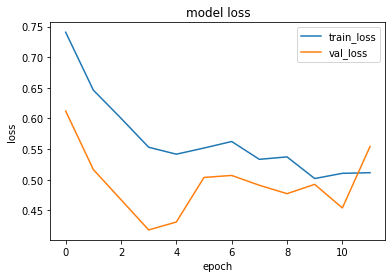

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5703442]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.62459934]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.6940582]]


1it [00:00, 17623.13it/s]


prediction for video control_1.mov is [[0.48007506]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.42662048]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.40933397]]


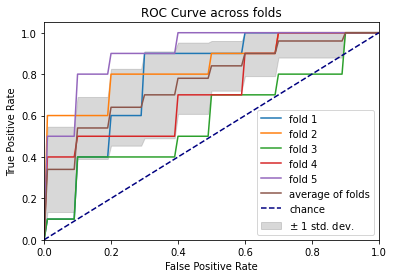

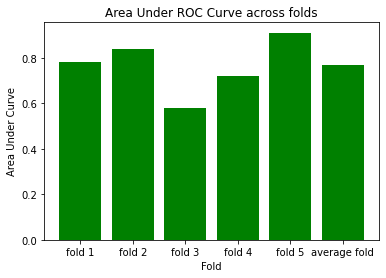

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 166ms/step - loss: 0.6841 - accuracy: 0.5125 - precision: 0.5098 - recall: 0.6500 - val_loss: 0.6211 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6555 - accuracy: 0.5875 - precision: 0.5614 - recall: 0.8000 - val_loss: 0.6229 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6028 - accuracy: 0.7625 - precision: 0.7143 - recall: 0.8750 - val_loss: 0.6199 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5827 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6667 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 132

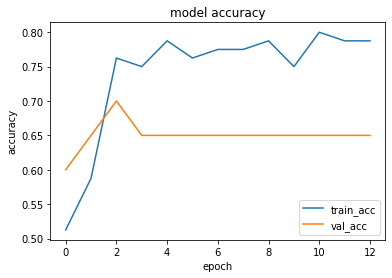

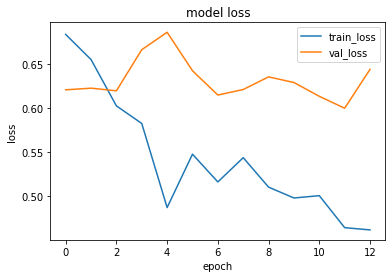

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5899673]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.577146]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.7678039]]


1it [00:00, 16644.06it/s]


prediction for video control_1.mov is [[0.4456681]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.331648]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.32958257]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 138ms/step - loss: 0.7531 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.7258 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6160 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.6815 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5757 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6972 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5418 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6512 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

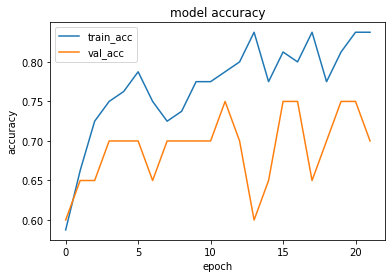

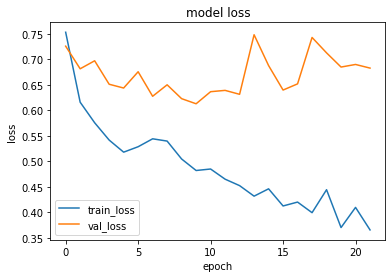

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.52618337]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.6343628]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.73924]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.35047036]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.28976297]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.28201747]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6631 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.5447 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6718 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.5577 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6383 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.6235 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 1s 201ms/step - loss: 0.6023 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.6073 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epo

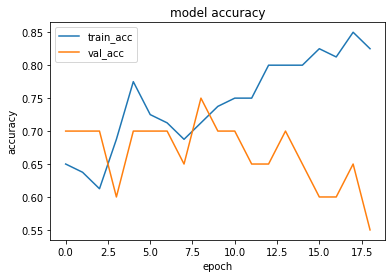

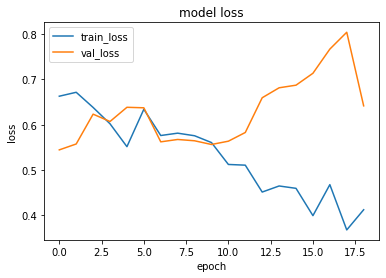

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.77210474]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.88544774]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.7440686]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.22425124]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.21888044]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.22024378]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6466 - accuracy: 0.6250 - precision: 0.5893 - recall: 0.8250 - val_loss: 0.6426 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.5531 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.7865 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5364 - accuracy: 0.7375 - precision: 0.8276 - recall: 0.6000 - val_loss: 0.8091 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.4957 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7510 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

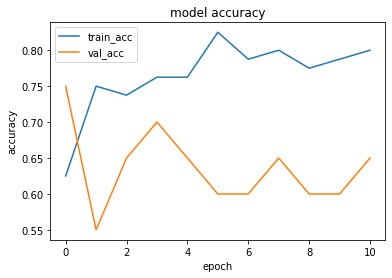

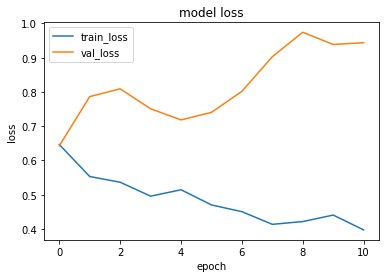

1it [00:00, 18893.26it/s]


prediction for video armflapping_1.mov is [[0.88835454]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.9603354]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.9618536]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.24200931]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.22243556]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.21846277]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.8022 - accuracy: 0.4625 - precision: 0.4694 - recall: 0.5750 - val_loss: 0.6337 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6731 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.6306 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6706 - accuracy: 0.6250 - precision: 0.6923 - recall: 0.4500 - val_loss: 0.5815 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6324 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.5066 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epo

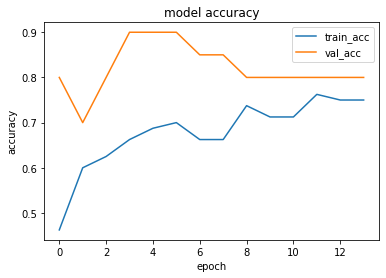

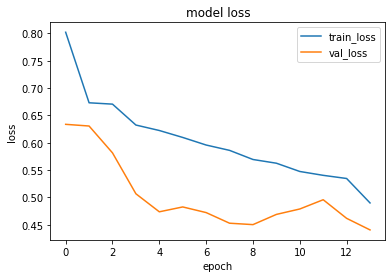

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.5418987]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.49307013]]


1it [00:00, 13189.64it/s]


prediction for video armflapping_2.mov is [[0.60725325]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.39144608]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.32248467]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.28038457]]


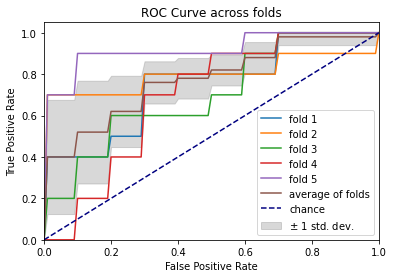

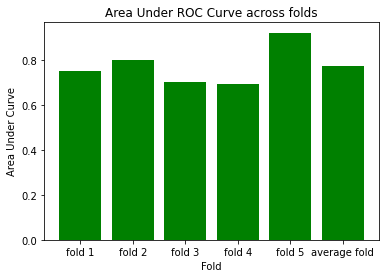

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 232ms/step - loss: 0.6518 - accuracy: 0.5625 - precision: 0.5676 - recall: 0.5250 - val_loss: 0.9429 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5984 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.7442 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 143ms/step - loss: 0.5467 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.7523 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5258 - accuracy: 0.7875 - precision: 0.7805 - recall: 0.8000 - val_loss: 0.8234 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 138

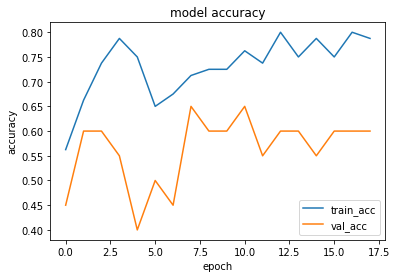

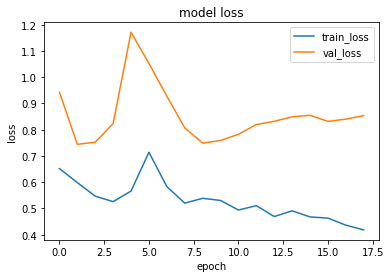

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.47420296]]


1it [00:00, 19508.39it/s]


prediction for video armflapping_3.mov is [[0.36661392]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_2.mov is [[0.578244]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.42590606]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.37730503]]


1it [00:00, 18641.35it/s]


prediction for video control_3.mov is [[0.41310287]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7089 - accuracy: 0.4500 - precision: 0.4630 - recall: 0.6250 - val_loss: 0.6659 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6424 - accuracy: 0.5500 - precision: 0.5357 - recall: 0.7500 - val_loss: 0.5464 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6844 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.5022 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6040 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.4832 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

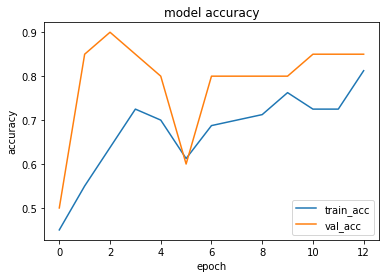

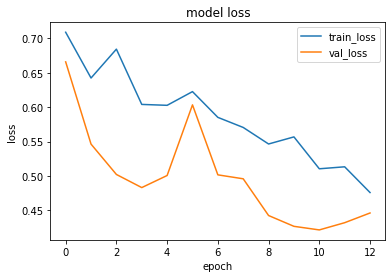

1it [00:00, 17623.13it/s]


prediction for video armflapping_1.mov is [[0.56775755]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.5486836]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_2.mov is [[0.6883077]]


1it [00:00, 16070.13it/s]


prediction for video control_1.mov is [[0.48572418]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.4060839]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.41646576]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6912 - accuracy: 0.5750 - precision: 0.5577 - recall: 0.7250 - val_loss: 0.6002 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6293 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5790 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5901 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6322 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5508 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.6376 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

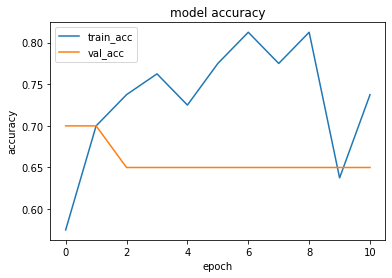

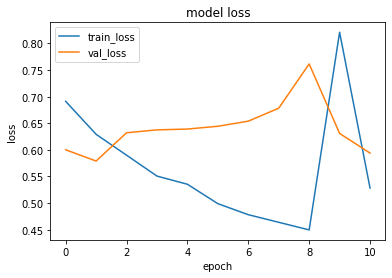

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.55771065]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.56238014]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.6415065]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.45302668]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.33396953]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.3710366]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7164 - accuracy: 0.4375 - precision: 0.4390 - recall: 0.4500 - val_loss: 0.6255 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6694 - accuracy: 0.5750 - precision: 0.5469 - recall: 0.8750 - val_loss: 0.5888 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6330 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5826 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 1s 202ms/step - loss: 0.5946 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.5352 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoc

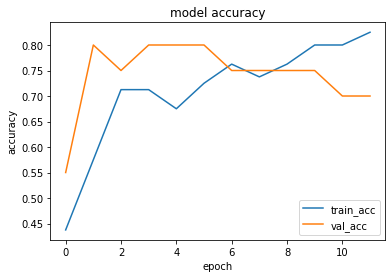

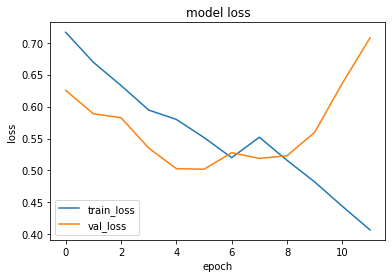

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.3778103]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.84482265]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.9033741]]


1it [00:00, 5023.12it/s]


prediction for video control_1.mov is [[0.24725214]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.29699832]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.28593218]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6846 - accuracy: 0.6000 - precision: 0.6111 - recall: 0.5500 - val_loss: 0.9937 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6565 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.8153 - val_accuracy: 0.4000 - val_precision: 0.3333 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5965 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.7538 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5858 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.7163 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

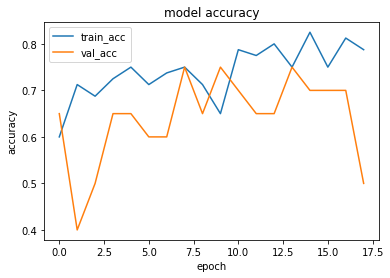

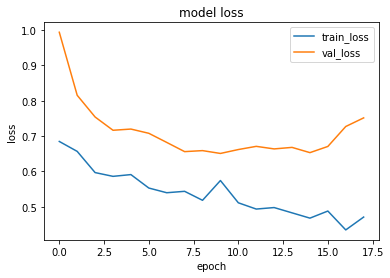

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.5392023]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.5642827]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.6382409]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.31291533]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.31202066]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.31185383]]


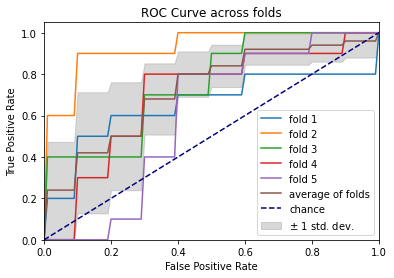

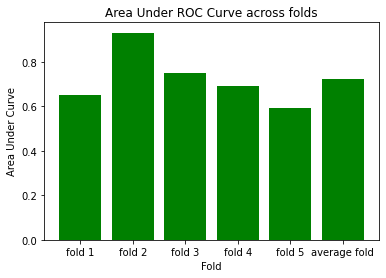

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6894 - accuracy: 0.5750 - precision: 0.5882 - recall: 0.5000 - val_loss: 0.5521 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6641 - accuracy: 0.6375 - precision: 0.6170 - recall: 0.7250 - val_loss: 0.5470 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6185 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.4648 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6015 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.4643 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 132

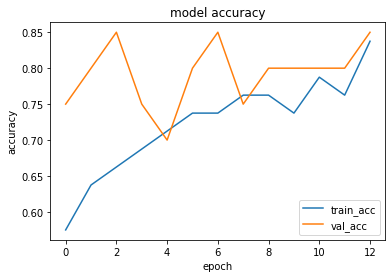

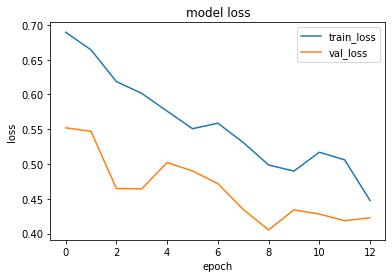

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.45610556]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.46087608]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.6646937]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.3421641]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.27246153]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.29307765]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.6809 - accuracy: 0.4875 - precision: 0.4878 - recall: 0.5000 - val_loss: 0.7679 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 1s 202ms/step - loss: 0.6471 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.8119 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.5488 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.7755 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.5198 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.8781 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epo

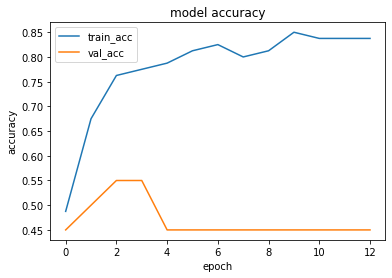

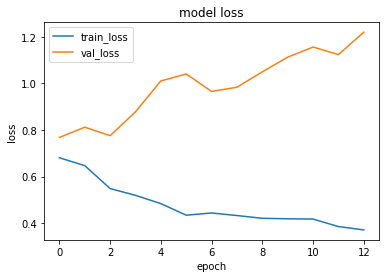

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.49026328]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.08180469]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.9054128]]


1it [00:00, 13148.29it/s]


prediction for video control_1.mov is [[0.1901168]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.17162186]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.17093942]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7043 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.5424 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6966 - accuracy: 0.5500 - precision: 0.5769 - recall: 0.3750 - val_loss: 0.5701 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6335 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.5097 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6254 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.4586 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

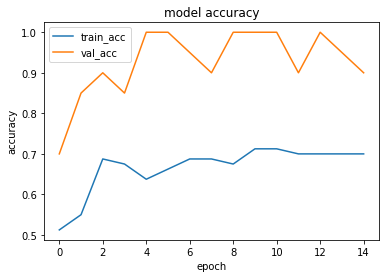

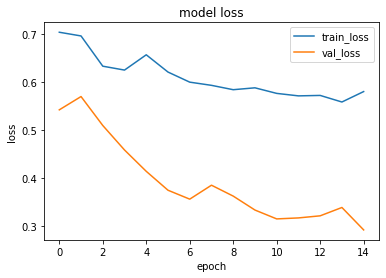

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.522776]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.65143406]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.67302704]]


1it [00:00, 18808.54it/s]


prediction for video control_1.mov is [[0.4430904]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.39216852]]


1it [00:00, 13357.66it/s]


prediction for video control_3.mov is [[0.39071637]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.7347 - accuracy: 0.4000 - precision: 0.4231 - recall: 0.5500 - val_loss: 0.6632 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6449 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6615 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6193 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6583 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5723 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.7006 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

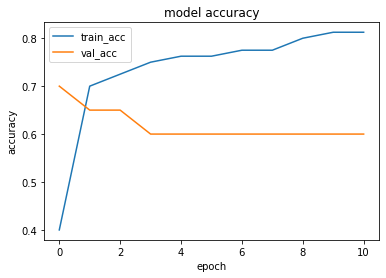

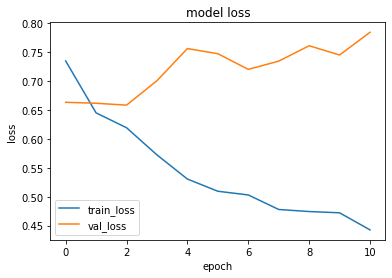

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.68301964]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.7958234]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.7461506]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.1736517]]


1it [00:00, 14979.66it/s]


prediction for video control_2.mov is [[0.15769553]]


1it [00:00, 18236.10it/s]


prediction for video control_3.mov is [[0.15590289]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.6987 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.5750 - val_loss: 0.6700 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5888 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6795 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5403 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.7211 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5045 - accuracy: 0.7625 - precision: 0.8387 - recall: 0.6500 - val_loss: 0.7487 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

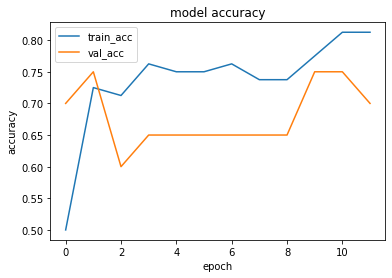

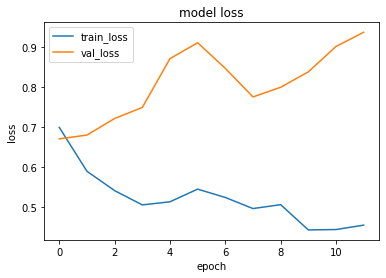

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.61225885]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.57023835]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.8779109]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.3749097]]


1it [00:00, 17623.13it/s]


prediction for video control_2.mov is [[0.2690637]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.32428834]]


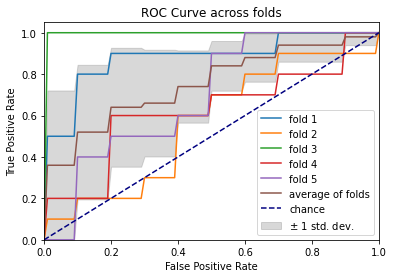

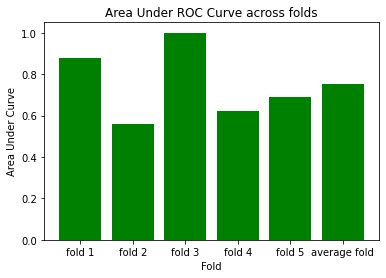

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.7018 - accuracy: 0.4750 - precision: 0.4706 - recall: 0.4000 - val_loss: 0.5878 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.7384 - accuracy: 0.5250 - precision: 0.5128 - recall: 1.0000 - val_loss: 0.5965 - val_accuracy: 0.9500 - val_precision: 0.9091 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6643 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.6200 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6381 - accuracy: 0.6500 - precision: 0.6765 - recall: 0.5750 - val_loss: 0.4994 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 135

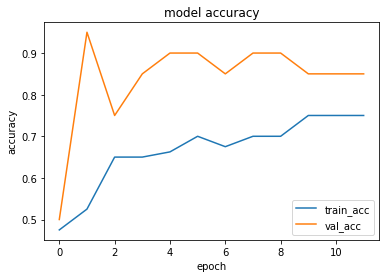

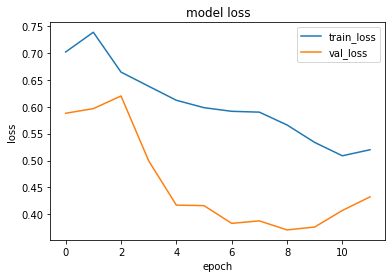

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.513495]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.4861746]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5324697]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.4894273]]


1it [00:00, 17772.47it/s]


prediction for video control_2.mov is [[0.47267562]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.48274523]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 144ms/step - loss: 0.7522 - accuracy: 0.5750 - precision: 0.5789 - recall: 0.5500 - val_loss: 0.6795 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6199 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.6612 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5979 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6178 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5297 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.6155 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

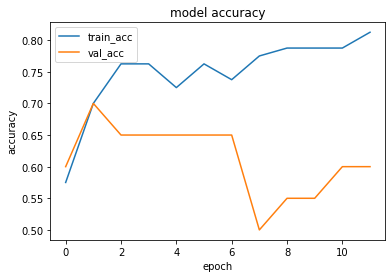

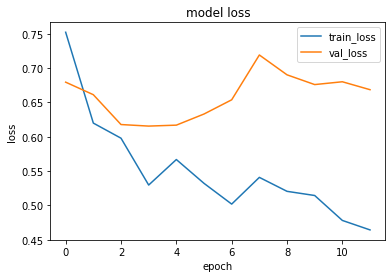

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.64199895]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.52079546]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_2.mov is [[0.8367629]]


1it [00:00, 13315.25it/s]


prediction for video control_1.mov is [[0.21035749]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.2044093]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.20406109]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7205 - accuracy: 0.5500 - precision: 0.5435 - recall: 0.6250 - val_loss: 0.6600 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6164 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.5983 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6418 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.6530 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5797 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6416 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

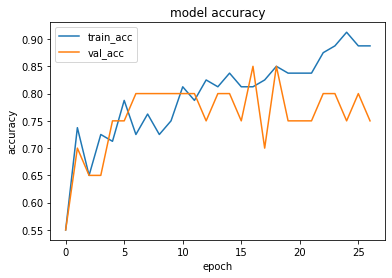

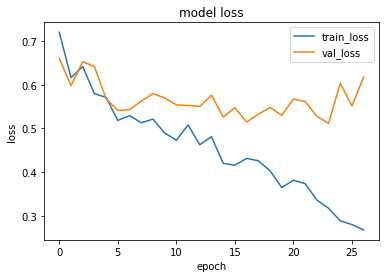

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.65882415]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.26898885]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.8943075]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.3338411]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.22860119]]


1it [00:00, 14665.40it/s]


prediction for video control_3.mov is [[0.193151]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6760 - accuracy: 0.4875 - precision: 0.4894 - recall: 0.5750 - val_loss: 0.7071 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6689 - accuracy: 0.6750 - precision: 0.7059 - recall: 0.6000 - val_loss: 0.6473 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5837 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6432 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5172 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.8027 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch

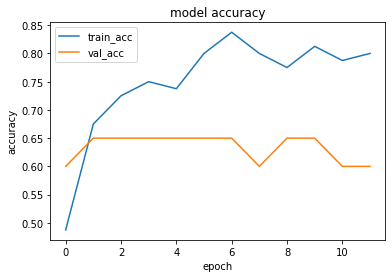

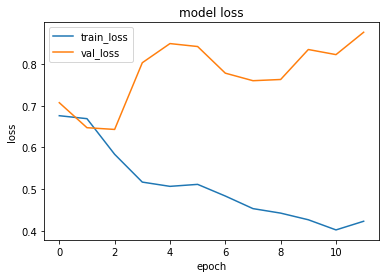

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.7057353]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.54961383]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.80318356]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.16495827]]


1it [00:00, 17260.51it/s]


prediction for video control_2.mov is [[0.10465264]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.10276014]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6884 - accuracy: 0.4875 - precision: 0.4909 - recall: 0.6750 - val_loss: 0.7494 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6964 - accuracy: 0.5500 - precision: 0.7000 - recall: 0.1750 - val_loss: 0.6936 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5832 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6609 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5556 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6758 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

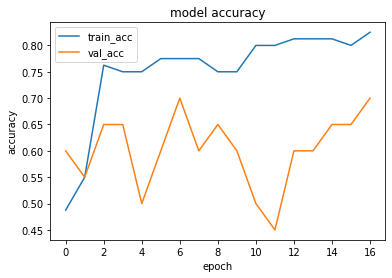

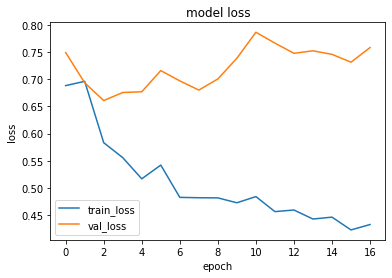

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.602468]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.15591735]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.7140544]]


1it [00:00, 6754.11it/s]


prediction for video control_1.mov is [[0.20393327]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.20170614]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.20286506]]


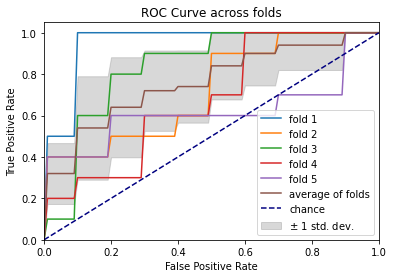

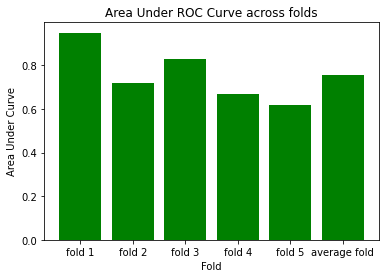

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6881 - accuracy: 0.6125 - precision: 0.5918 - recall: 0.7250 - val_loss: 0.8003 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6287 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.7049 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5822 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.7329 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5281 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.7970 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 135

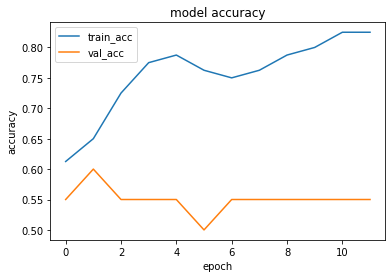

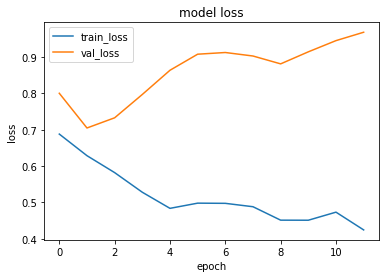

1it [00:00, 16384.00it/s]


prediction for video armflapping_1.mov is [[0.554257]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.4480043]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_2.mov is [[0.640862]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.46737462]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.42228717]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.4063786]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6880 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6000 - val_loss: 0.5611 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6223 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.5631 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5765 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.4997 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5517 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5057 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoc

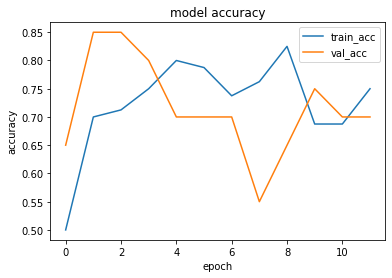

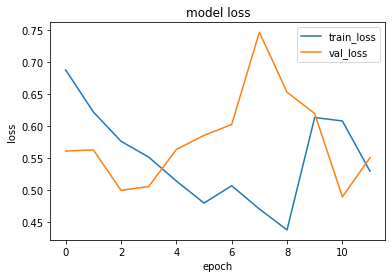

1it [00:00, 12052.60it/s]


prediction for video armflapping_1.mov is [[0.5106094]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.56925017]]


1it [00:00, 18808.54it/s]


prediction for video armflapping_2.mov is [[0.59085953]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.45676056]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.42705643]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.42511606]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6894 - accuracy: 0.4875 - precision: 0.4915 - recall: 0.7250 - val_loss: 0.7082 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6608 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.6822 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5826 - accuracy: 0.7625 - precision: 0.7143 - recall: 0.8750 - val_loss: 0.7147 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5319 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7551 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

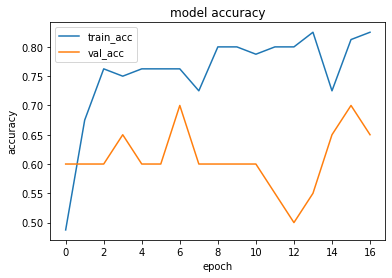

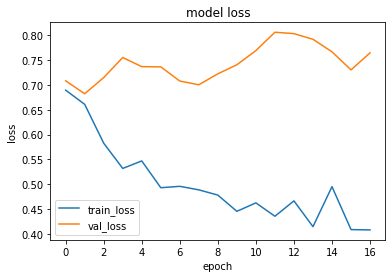

1it [00:00, 16384.00it/s]


prediction for video armflapping_1.mov is [[0.39767972]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.23189512]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_2.mov is [[0.6759435]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.22993156]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.21258771]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2087152]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.7684 - accuracy: 0.5125 - precision: 0.5238 - recall: 0.2750 - val_loss: 0.7303 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.7198 - accuracy: 0.5750 - precision: 0.5429 - recall: 0.9500 - val_loss: 0.6444 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6309 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6102 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6165 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.5793 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoc

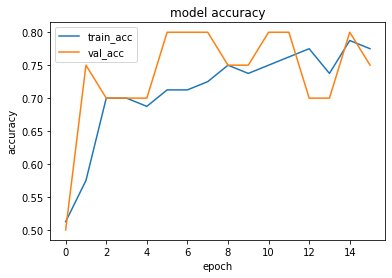

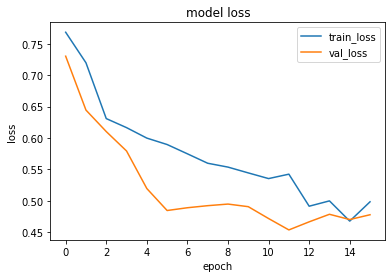

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.50672764]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.58784825]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.73136455]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.30322748]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.29087627]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.28819954]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7594 - accuracy: 0.5500 - precision: 0.5769 - recall: 0.3750 - val_loss: 0.6621 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6678 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6002 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6380 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.5644 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5985 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.5442 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

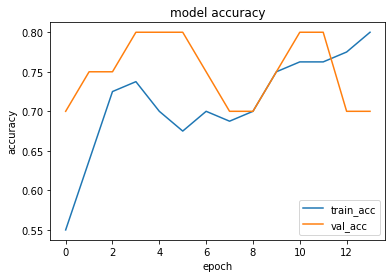

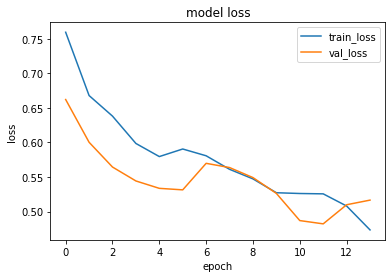

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5478567]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_3.mov is [[0.33296138]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.65182453]]


1it [00:00, 16710.37it/s]


prediction for video control_1.mov is [[0.23951185]]


1it [00:00, 19508.39it/s]


prediction for video control_2.mov is [[0.21233019]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.21267042]]


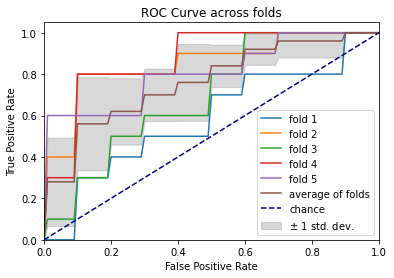

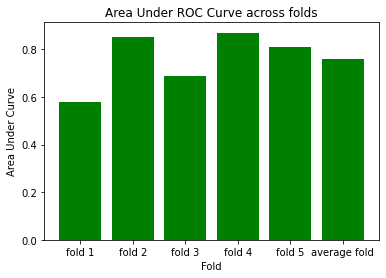

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6827 - accuracy: 0.6500 - precision: 0.6111 - recall: 0.8250 - val_loss: 0.6828 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6780 - accuracy: 0.5875 - precision: 0.8182 - recall: 0.2250 - val_loss: 0.6445 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6306 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6261 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5872 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.6081 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 142

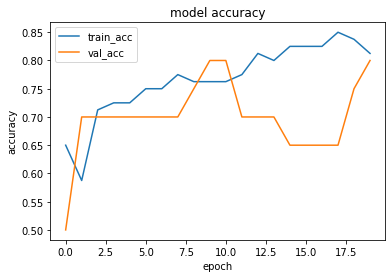

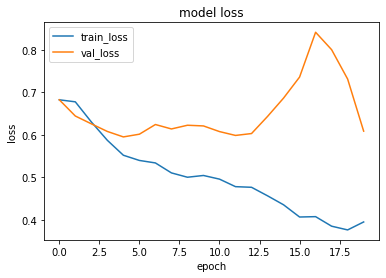

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.5800829]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.5163876]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.6698011]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.45240018]]


1it [00:00, 11459.85it/s]


prediction for video control_2.mov is [[0.10305148]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.4016059]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6868 - accuracy: 0.5375 - precision: 0.5263 - recall: 0.7500 - val_loss: 0.5824 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6512 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5659 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6038 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.5644 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5844 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5317 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoc

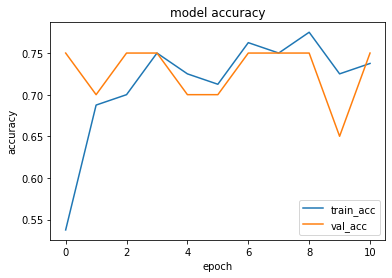

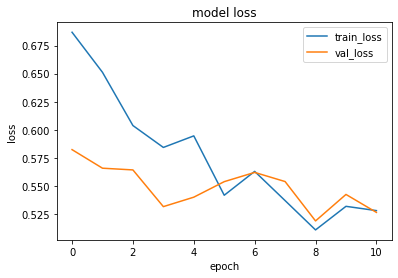

1it [00:00, 16710.37it/s]


prediction for video armflapping_1.mov is [[0.52883685]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.3386222]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.7344955]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.33902937]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.27626622]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.28639784]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7522 - accuracy: 0.5250 - precision: 0.5312 - recall: 0.4250 - val_loss: 0.6643 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 194ms/step - loss: 0.6793 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6736 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6057 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.6718 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5632 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.6738 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

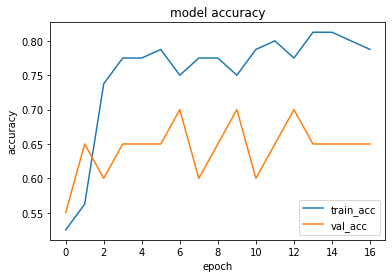

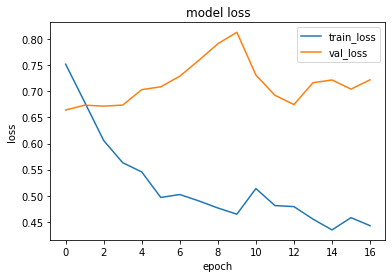

1it [00:00, 13486.51it/s]


prediction for video armflapping_1.mov is [[0.6953507]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.19286093]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.66834015]]


1it [00:00, 14217.98it/s]


prediction for video control_1.mov is [[0.47478384]]


1it [00:00, 12710.01it/s]


prediction for video control_2.mov is [[0.3008131]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.24878904]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.7407 - accuracy: 0.5250 - precision: 0.5192 - recall: 0.6750 - val_loss: 0.6367 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6853 - accuracy: 0.5750 - precision: 0.7500 - recall: 0.2250 - val_loss: 0.6206 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6491 - accuracy: 0.6500 - precision: 0.7500 - recall: 0.4500 - val_loss: 0.5904 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5957 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5616 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epo

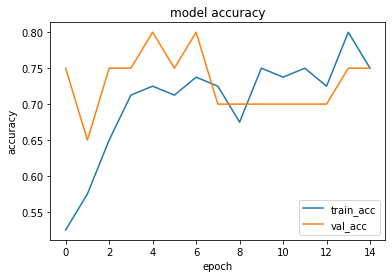

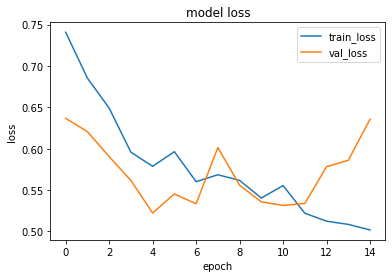

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.63681436]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.42224818]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8131044]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.39068967]]


1it [00:00, 15477.14it/s]


prediction for video control_2.mov is [[0.38827476]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.34055763]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7803 - accuracy: 0.4375 - precision: 0.4324 - recall: 0.4000 - val_loss: 0.6451 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6917 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.6076 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6521 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.6079 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6274 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.5992 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

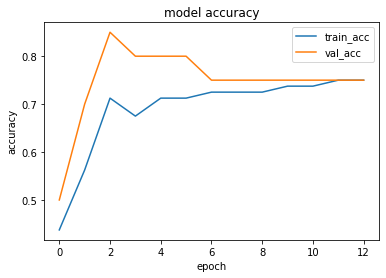

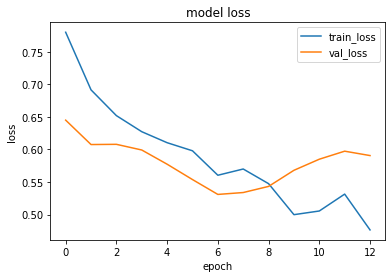

1it [00:00, 17549.39it/s]


prediction for video armflapping_1.mov is [[0.49857265]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.49620655]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.55082077]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.46287906]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.4654787]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.4692015]]


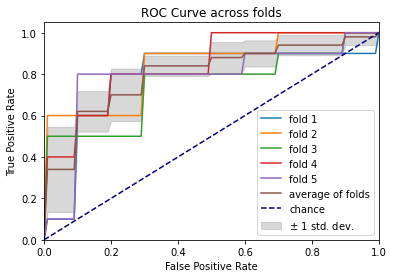

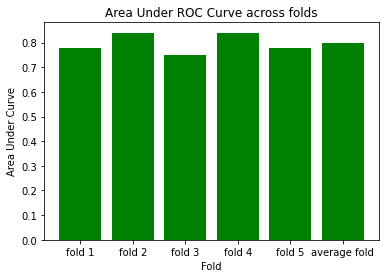

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 219ms/step - loss: 0.7050 - accuracy: 0.5500 - precision: 0.5714 - recall: 0.4000 - val_loss: 0.6755 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6973 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.5757 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6274 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.5567 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6059 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.5467 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 132

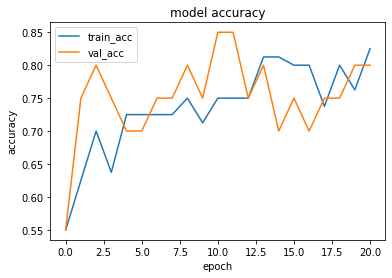

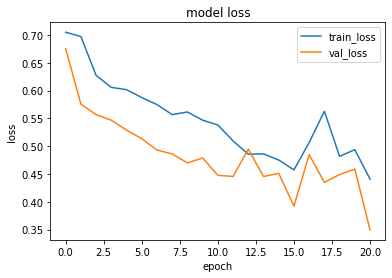

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.56546026]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.46491596]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.74108356]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.30668598]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.28556883]]


1it [00:00, 16578.28it/s]


prediction for video control_3.mov is [[0.2855906]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6692 - accuracy: 0.5375 - precision: 0.5333 - recall: 0.6000 - val_loss: 0.6180 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5978 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.6461 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5903 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.5619 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5815 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.5701 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoc

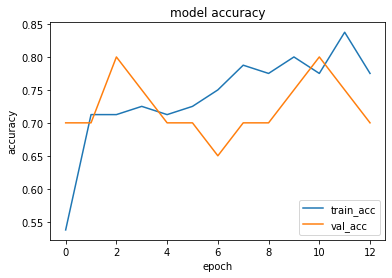

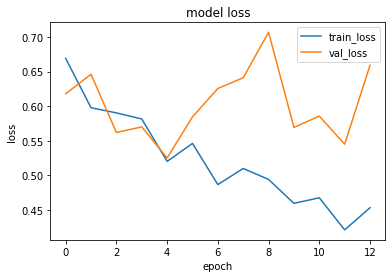

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5170654]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.48777273]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8609321]]


1it [00:00, 16448.25it/s]


prediction for video control_1.mov is [[0.27400923]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.2683662]]


1it [00:00, 13189.64it/s]


prediction for video control_3.mov is [[0.26701313]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6592 - accuracy: 0.5375 - precision: 0.5319 - recall: 0.6250 - val_loss: 0.6795 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5524 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7396 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5726 - accuracy: 0.7125 - precision: 0.8696 - recall: 0.5000 - val_loss: 0.6466 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5489 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6729 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

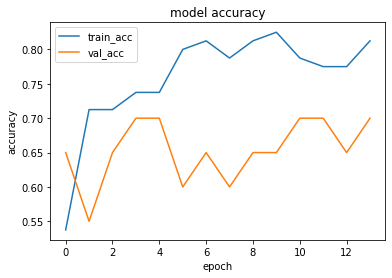

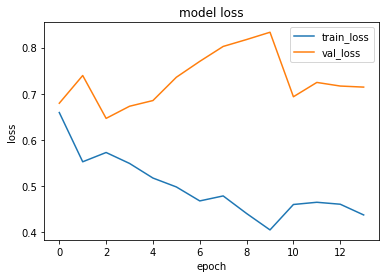

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5077623]]


1it [00:00, 19328.59it/s]


prediction for video armflapping_3.mov is [[0.4080672]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6632893]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.35094595]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.3160283]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.3428658]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6970 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6750 - val_loss: 0.6095 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5948 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6750 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6177 - accuracy: 0.7250 - precision: 0.6800 - recall: 0.8500 - val_loss: 0.5974 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5727 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6120 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoc

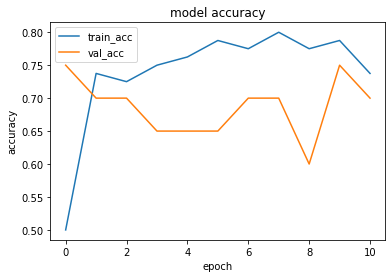

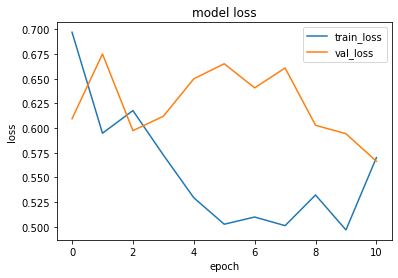

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.5573457]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.1941711]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.77446854]]


1it [00:00, 6326.25it/s]


prediction for video control_1.mov is [[0.39298]]


1it [00:00, 22192.08it/s]


prediction for video control_2.mov is [[0.27294388]]


1it [00:00, 13617.87it/s]


prediction for video control_3.mov is [[0.29421198]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.7929 - accuracy: 0.4500 - precision: 0.4714 - recall: 0.8250 - val_loss: 0.6637 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6585 - accuracy: 0.6625 - precision: 0.7826 - recall: 0.4500 - val_loss: 0.6678 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6221 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.6624 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6097 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.6712 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epo

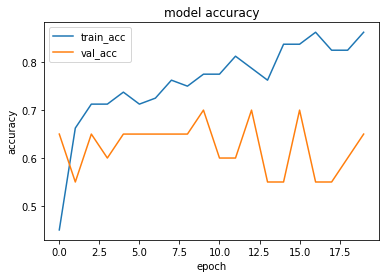

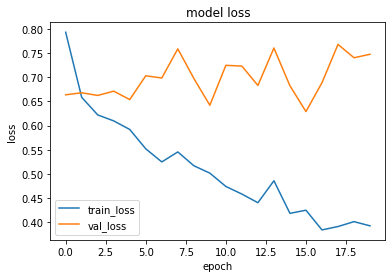

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.17999539]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.38956752]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.76355094]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.16784325]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.16850501]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.1690237]]


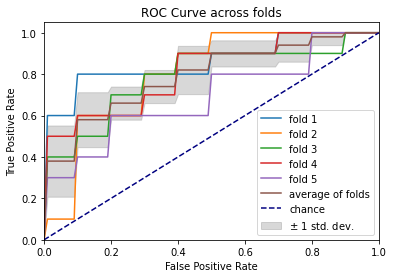

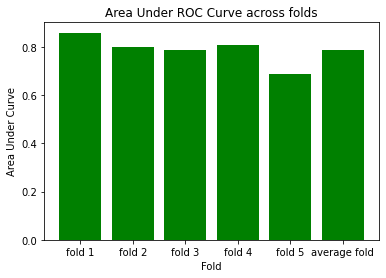

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7010 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.5774 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6684 - accuracy: 0.6250 - precision: 0.8125 - recall: 0.3250 - val_loss: 0.4934 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6166 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.4509 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6210 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.3931 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 130

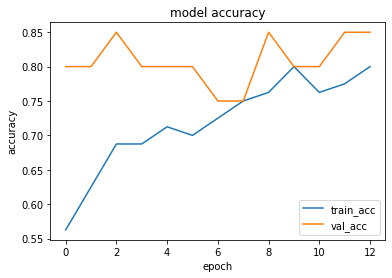

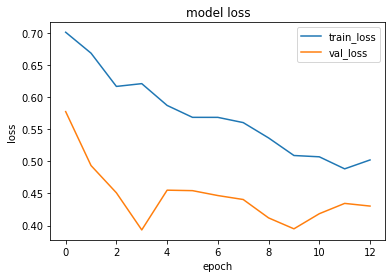

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5880469]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.67057264]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.70849895]]


1it [00:00, 6034.97it/s]


prediction for video control_1.mov is [[0.42387372]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.35389102]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.29807895]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6845 - accuracy: 0.6000 - precision: 0.6176 - recall: 0.5250 - val_loss: 0.7854 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6804 - accuracy: 0.7000 - precision: 0.6250 - recall: 1.0000 - val_loss: 0.7083 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5762 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.7191 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5516 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6935 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epo

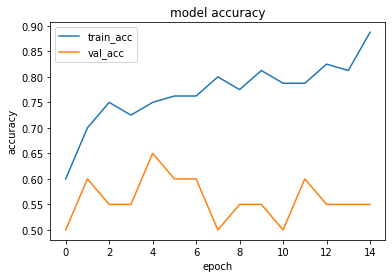

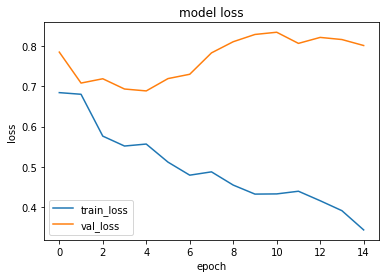

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.5282933]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.23380569]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.71509963]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.4279636]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.24267873]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.28425944]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7591 - accuracy: 0.5375 - precision: 0.5882 - recall: 0.2500 - val_loss: 0.6410 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6927 - accuracy: 0.5000 - precision: 0.5000 - recall: 1.0000 - val_loss: 0.6037 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 1s 204ms/step - loss: 0.6508 - accuracy: 0.6625 - precision: 0.6226 - recall: 0.8250 - val_loss: 0.5967 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6107 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5897 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

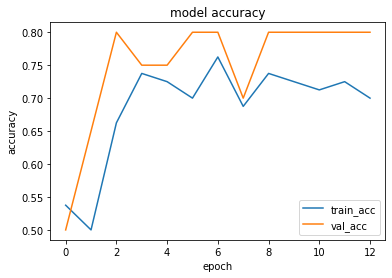

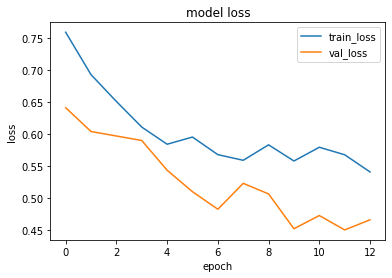

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.4942915]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.44815302]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.7702253]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.28328353]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.25806856]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.25524357]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7060 - accuracy: 0.5375 - precision: 0.5273 - recall: 0.7250 - val_loss: 0.6764 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6133 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.6991 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5947 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.7357 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5418 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7259 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

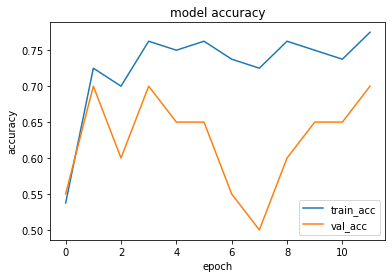

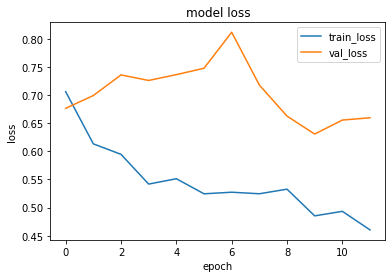

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.37098342]]


1it [00:00, 19972.88it/s]


prediction for video armflapping_3.mov is [[0.632028]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.77121806]]


1it [00:00, 16710.37it/s]


prediction for video control_1.mov is [[0.23788622]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.19857106]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.19783491]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 159ms/step - loss: 0.6697 - accuracy: 0.5375 - precision: 0.5306 - recall: 0.6500 - val_loss: 0.8381 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6686 - accuracy: 0.6250 - precision: 0.7083 - recall: 0.4250 - val_loss: 0.6694 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6097 - accuracy: 0.7125 - precision: 0.6545 - recall: 0.9000 - val_loss: 0.6938 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5395 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.7620 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epo

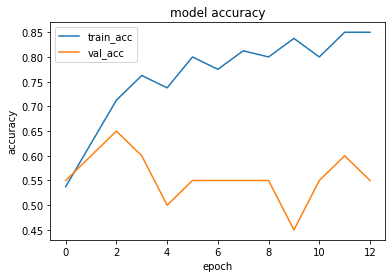

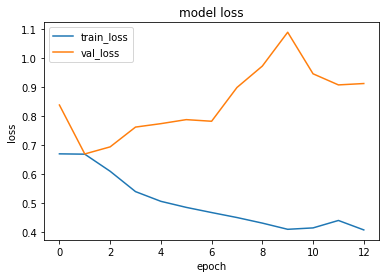

1it [00:00, 12300.01it/s]


prediction for video armflapping_1.mov is [[0.79733706]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.8281404]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.871661]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.13575006]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.12046632]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.11924791]]


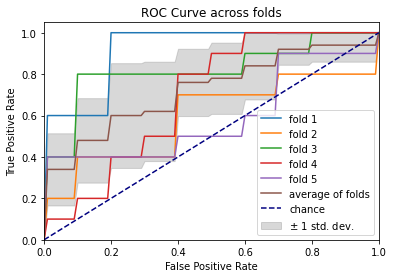

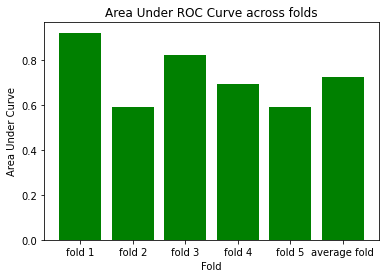

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.8158 - accuracy: 0.4125 - precision: 0.4314 - recall: 0.5500 - val_loss: 0.7462 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6944 - accuracy: 0.6125 - precision: 0.6154 - recall: 0.6000 - val_loss: 0.6751 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6524 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.6421 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 1s 138ms/step - loss: 0.6446 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.6064 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 133

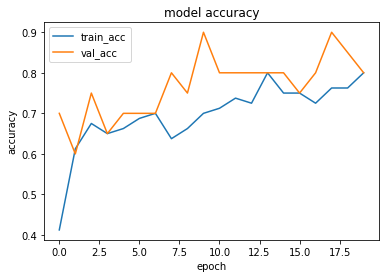

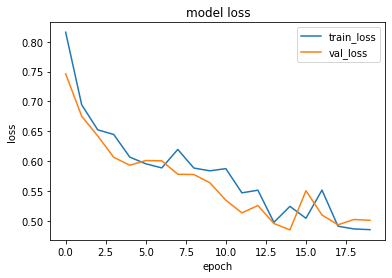

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.47844827]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_3.mov is [[0.54085237]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.5990704]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.360511]]


1it [00:00, 19878.22it/s]


prediction for video control_2.mov is [[0.27824637]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.2777636]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7092 - accuracy: 0.4375 - precision: 0.4510 - recall: 0.5750 - val_loss: 0.6941 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6253 - accuracy: 0.6125 - precision: 0.5818 - recall: 0.8000 - val_loss: 0.6196 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6116 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6122 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5556 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.5540 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoc

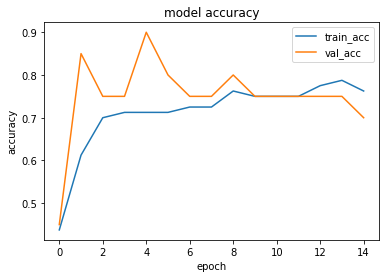

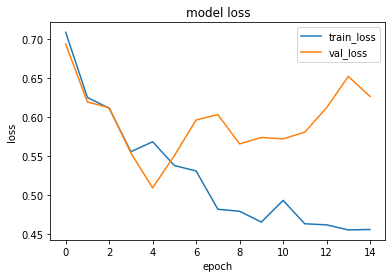

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.3812225]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.8074994]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.4216949]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.340235]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.32227015]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.31907234]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7013 - accuracy: 0.6250 - precision: 0.6190 - recall: 0.6500 - val_loss: 0.7323 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6432 - accuracy: 0.6750 - precision: 0.6207 - recall: 0.9000 - val_loss: 0.6405 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5836 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7063 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5311 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7465 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epo

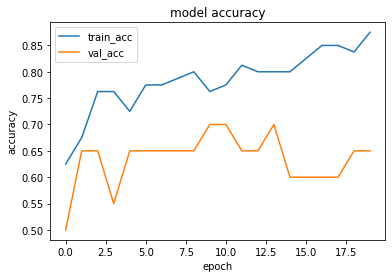

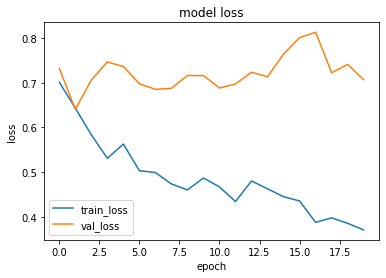

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.68758243]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.11634731]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.7006358]]


1it [00:00, 13934.56it/s]


prediction for video control_1.mov is [[0.25970513]]


1it [00:00, 13842.59it/s]


prediction for video control_2.mov is [[0.20899612]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.21462089]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6885 - accuracy: 0.5250 - precision: 0.5217 - recall: 0.6000 - val_loss: 0.6711 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6014 - accuracy: 0.7875 - precision: 0.7674 - recall: 0.8250 - val_loss: 0.7262 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5725 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6898 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5182 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6861 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epo

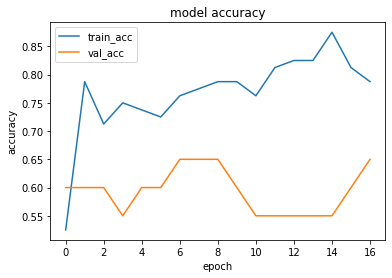

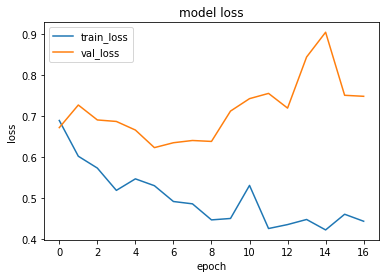

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.6474535]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.8356338]]


1it [00:00, 13842.59it/s]


prediction for video armflapping_2.mov is [[0.7262702]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.4748002]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.20576158]]


1it [00:00, 17189.77it/s]


prediction for video control_3.mov is [[0.26801583]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.7355 - accuracy: 0.5875 - precision: 0.6296 - recall: 0.4250 - val_loss: 0.6208 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 226ms/step - loss: 0.6770 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.6031 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6151 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6244 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6218 - accuracy: 0.7125 - precision: 0.7931 - recall: 0.5750 - val_loss: 0.6006 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

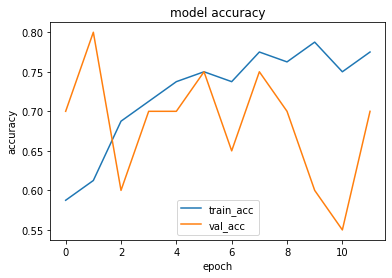

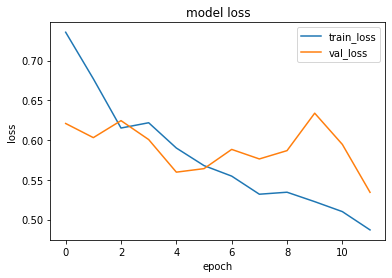

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.6904781]]


1it [00:00, 17772.47it/s]


prediction for video armflapping_3.mov is [[0.5827047]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.73591405]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.27460438]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.26930207]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.2693345]]


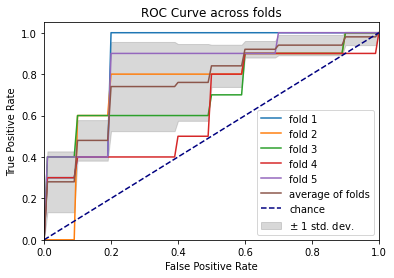

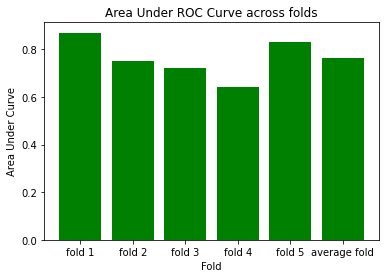

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6948 - accuracy: 0.5375 - precision: 0.5405 - recall: 0.5000 - val_loss: 0.6706 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6315 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.7099 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5418 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.7648 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5011 - accuracy: 0.8000 - precision: 0.8000 - recall: 0.8000 - val_loss: 0.8079 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 131

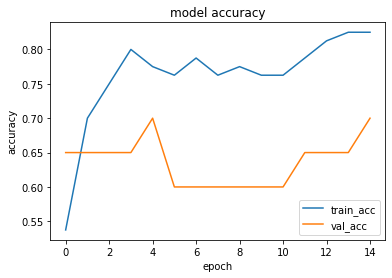

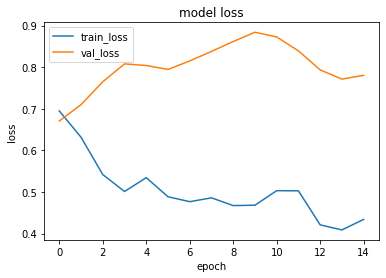

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.64843875]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.8490137]]


1it [00:00, 13443.28it/s]


prediction for video armflapping_2.mov is [[0.8113934]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.11675239]]


1it [00:00, 13148.29it/s]


prediction for video control_2.mov is [[0.09697533]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.10054651]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6819 - accuracy: 0.5375 - precision: 0.5385 - recall: 0.5250 - val_loss: 0.6671 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6006 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6340 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5865 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6365 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5770 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.6204 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epo

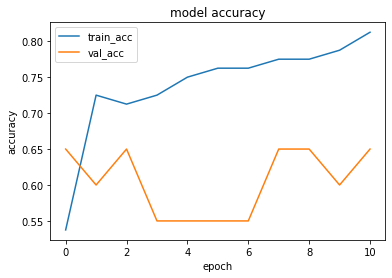

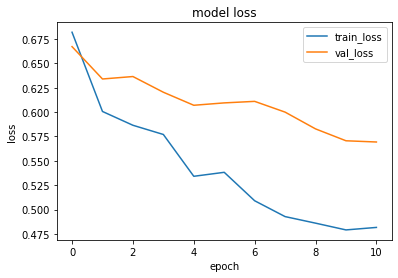

1it [00:00, 17848.10it/s]


prediction for video armflapping_1.mov is [[0.6077702]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.741552]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_2.mov is [[0.75907946]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.1984497]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.17339697]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.17255017]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7361 - accuracy: 0.5125 - precision: 0.5088 - recall: 0.7250 - val_loss: 0.6657 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6266 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.5447 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6202 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 0.5346 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5719 - accuracy: 0.7500 - precision: 0.7632 - recall: 0.7250 - val_loss: 0.5461 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

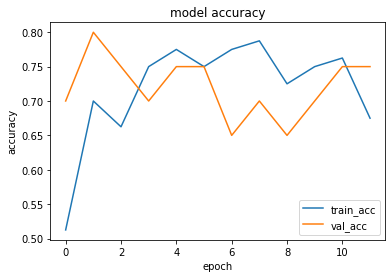

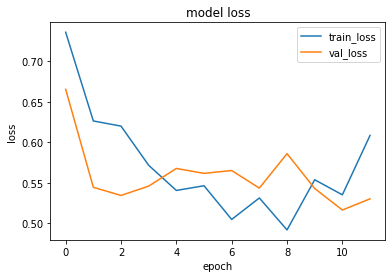

1it [00:00, 17476.27it/s]


prediction for video armflapping_1.mov is [[0.5662183]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.57596207]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.6575964]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.5087512]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.4763023]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.46417177]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.6900 - accuracy: 0.5375 - precision: 0.5333 - recall: 0.6000 - val_loss: 0.6263 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6335 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.5469 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5500 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.4747 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.5825 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5195 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

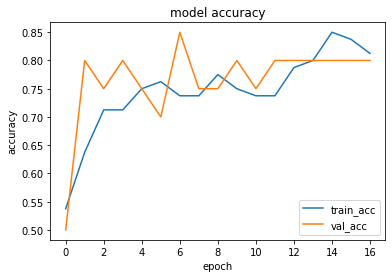

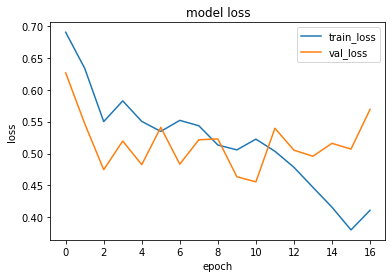

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.58971536]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.6934885]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.713861]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.46392143]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.40071023]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.36210394]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 161ms/step - loss: 0.6917 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7750 - val_loss: 0.6512 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6344 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.6203 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6120 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6530 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5327 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.7528 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

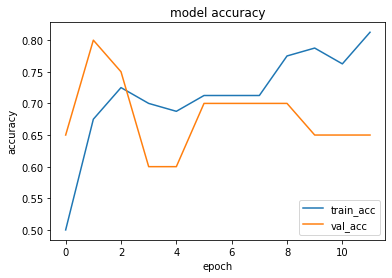

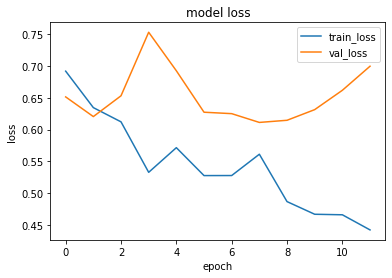

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.79341733]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.85191077]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.86202085]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.19313738]]


1it [00:00, 17549.39it/s]


prediction for video control_2.mov is [[0.18006906]]


1it [00:00, 13934.56it/s]


prediction for video control_3.mov is [[0.1746791]]


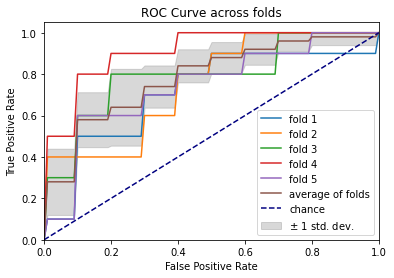

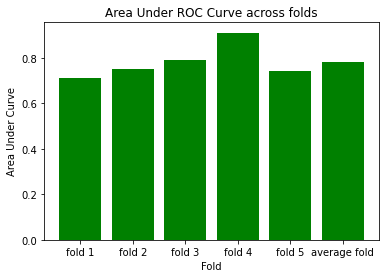

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6959 - accuracy: 0.4375 - precision: 0.4590 - recall: 0.7000 - val_loss: 0.6439 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 1s 213ms/step - loss: 0.7033 - accuracy: 0.5375 - precision: 0.5789 - recall: 0.2750 - val_loss: 0.6438 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6008 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.6454 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5482 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7088 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 134

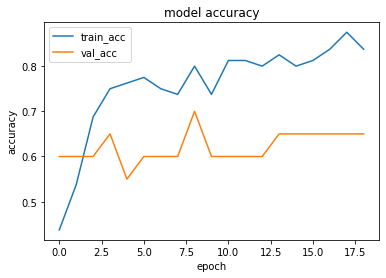

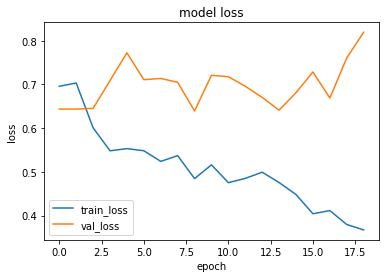

1it [00:00, 13357.66it/s]


prediction for video armflapping_1.mov is [[0.20732194]]


1it [00:00, 18724.57it/s]


prediction for video armflapping_3.mov is [[0.33261055]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_2.mov is [[0.7148]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.36881793]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.17493129]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.5065208]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7104 - accuracy: 0.5625 - precision: 0.5510 - recall: 0.6750 - val_loss: 0.6145 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6537 - accuracy: 0.6000 - precision: 0.5625 - recall: 0.9000 - val_loss: 0.6383 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6260 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.6149 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5899 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.5502 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoc

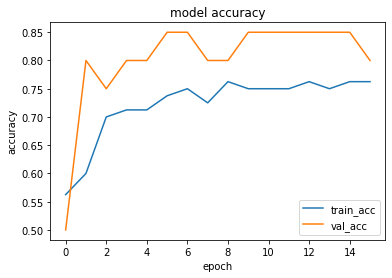

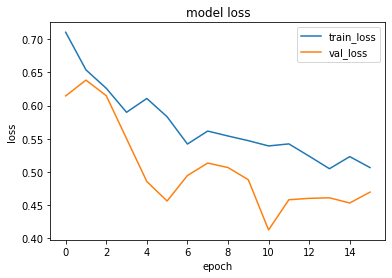

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5599786]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.26460254]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.6574118]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.46243763]]


1it [00:00, 19599.55it/s]


prediction for video control_2.mov is [[0.24968562]]


1it [00:00, 11125.47it/s]


prediction for video control_3.mov is [[0.33128256]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7202 - accuracy: 0.5125 - precision: 0.5091 - recall: 0.7000 - val_loss: 0.6244 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6709 - accuracy: 0.6125 - precision: 0.7647 - recall: 0.3250 - val_loss: 0.5791 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6219 - accuracy: 0.6875 - precision: 0.6364 - recall: 0.8750 - val_loss: 0.5616 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6007 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.5772 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

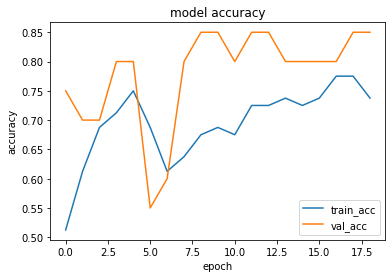

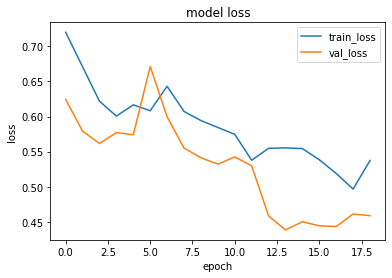

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.55106556]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.5547403]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.7121902]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.40640375]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.39642626]]


1it [00:00, 18808.54it/s]


prediction for video control_3.mov is [[0.3937791]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7206 - accuracy: 0.6000 - precision: 0.5741 - recall: 0.7750 - val_loss: 0.6511 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5765 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.6239 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5725 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6167 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5357 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6219 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoc

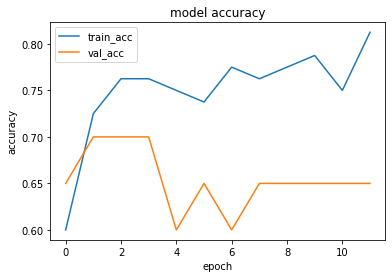

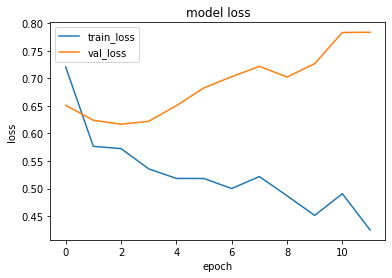

1it [00:00, 17772.47it/s]


prediction for video armflapping_1.mov is [[0.40987718]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.44806635]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.8775446]]


1it [00:00, 14266.34it/s]


prediction for video control_1.mov is [[0.24400178]]


1it [00:00, 16070.13it/s]


prediction for video control_2.mov is [[0.20144802]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.21184894]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6175 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6850 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5729 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.7184 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5300 - accuracy: 0.7375 - precision: 0.8065 - recall: 0.6250 - val_loss: 0.7654 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5497 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.7773 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

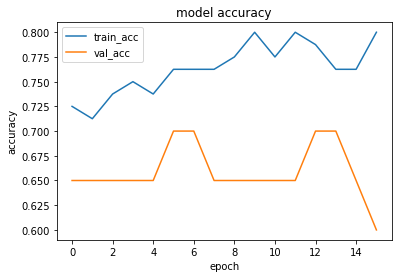

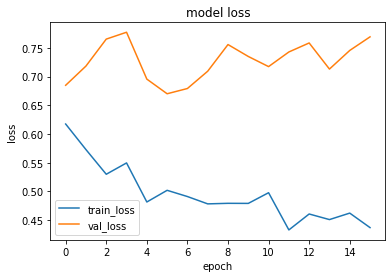

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.41707313]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.25580078]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_2.mov is [[0.6842994]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.30598685]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.27340475]]


1it [00:00, 18477.11it/s]


prediction for video control_3.mov is [[0.2677002]]


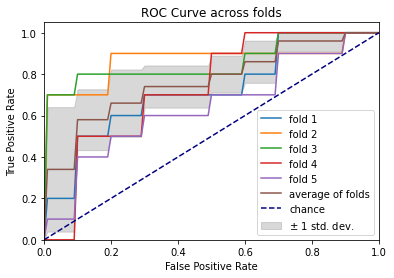

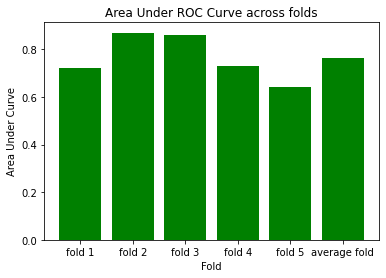

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.8939 - accuracy: 0.5375 - precision: 0.5556 - recall: 0.3750 - val_loss: 0.5980 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6488 - accuracy: 0.5750 - precision: 0.5417 - recall: 0.9750 - val_loss: 0.5941 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6346 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.5858 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6175 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.5560 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 132

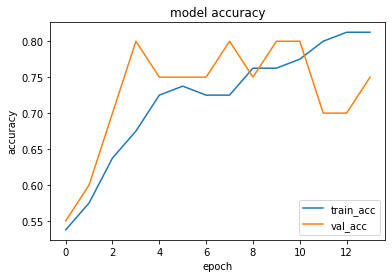

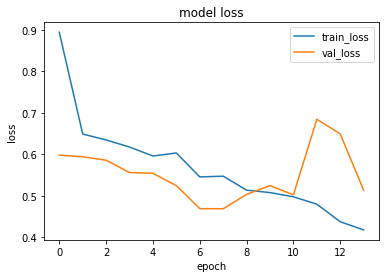

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.5282923]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_3.mov is [[0.42159227]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.5770329]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.47184187]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.42294785]]


1it [00:00, 19328.59it/s]


prediction for video control_3.mov is [[0.44021207]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6678 - accuracy: 0.5375 - precision: 0.5306 - recall: 0.6500 - val_loss: 0.6843 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6734 - accuracy: 0.5875 - precision: 0.5814 - recall: 0.6250 - val_loss: 0.6626 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5785 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6597 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5071 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.6501 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

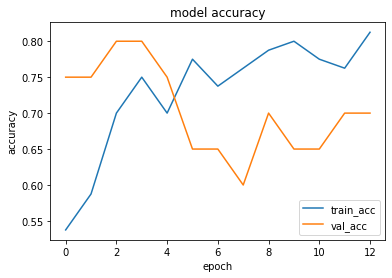

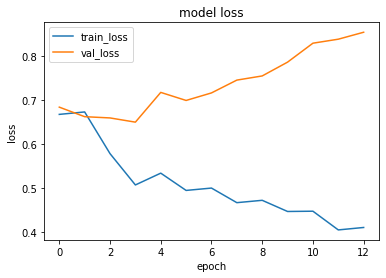

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.3098302]]


1it [00:00, 19972.88it/s]


prediction for video armflapping_3.mov is [[0.7368319]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.8806319]]


1it [00:00, 4634.59it/s]


prediction for video control_1.mov is [[0.21329707]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.2291095]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.21569714]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7261 - accuracy: 0.5500 - precision: 0.5385 - recall: 0.7000 - val_loss: 0.6540 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6494 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.6107 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6100 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5870 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5614 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.5735 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

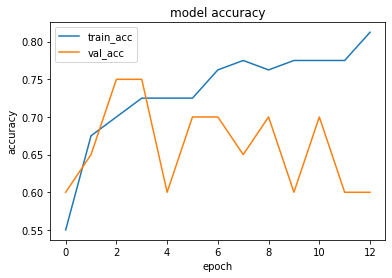

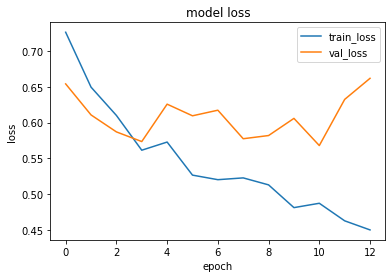

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.73315555]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.60055137]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7439445]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.19236231]]


1it [00:00, 16320.25it/s]


prediction for video control_2.mov is [[0.17612243]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.17387223]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6251 - accuracy: 0.7000 - precision: 0.6379 - recall: 0.9250 - val_loss: 0.7806 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 1.0122 - accuracy: 0.5625 - precision: 0.7273 - recall: 0.2000 - val_loss: 0.7470 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6330 - accuracy: 0.6500 - precision: 0.7143 - recall: 0.5000 - val_loss: 0.7308 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5676 - accuracy: 0.7375 - precision: 0.6792 - recall: 0.9000 - val_loss: 0.7782 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epo

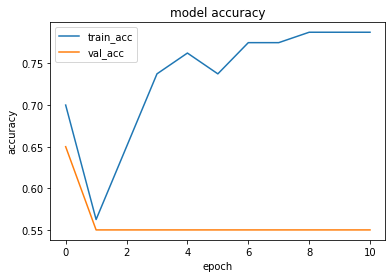

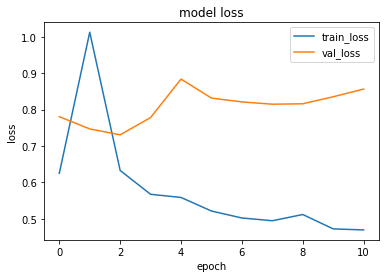

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.47383013]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.34685957]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.86286086]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.22566402]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.20228112]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.2017512]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7393 - accuracy: 0.5625 - precision: 0.5424 - recall: 0.8000 - val_loss: 0.6711 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 1s 206ms/step - loss: 0.7270 - accuracy: 0.5375 - precision: 1.0000 - recall: 0.0750 - val_loss: 0.6076 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6087 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.6124 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6345 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6002 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoc

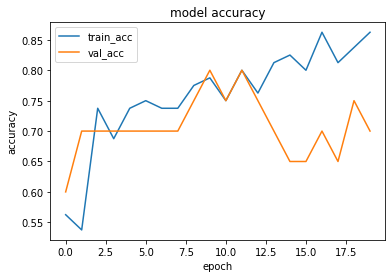

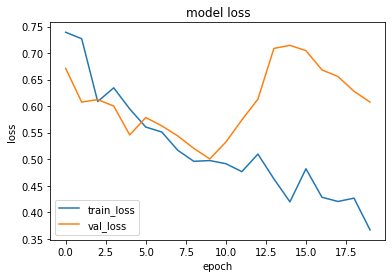

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.84144795]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.84893525]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.91939807]]


1it [00:00, 4739.33it/s]


prediction for video control_1.mov is [[0.5006093]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.26983514]]


1it [00:00, 19691.57it/s]


prediction for video control_3.mov is [[0.27258253]]


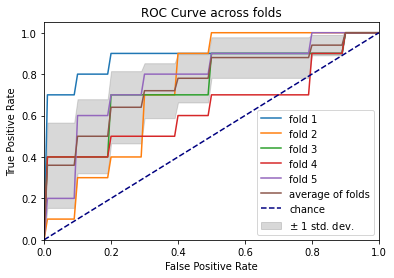

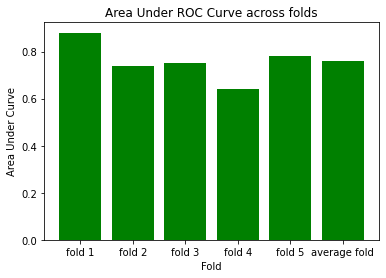

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6943 - accuracy: 0.4625 - precision: 0.4681 - recall: 0.5500 - val_loss: 0.6772 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 1s 208ms/step - loss: 0.6641 - accuracy: 0.6375 - precision: 0.6222 - recall: 0.7000 - val_loss: 0.6956 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5823 - accuracy: 0.7875 - precision: 0.7556 - recall: 0.8500 - val_loss: 0.7197 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5369 - accuracy: 0.8000 - precision: 0.8333 - recall: 0.7500 - val_loss: 0.8681 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 130

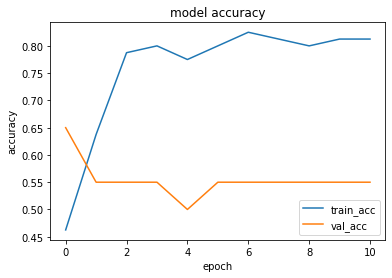

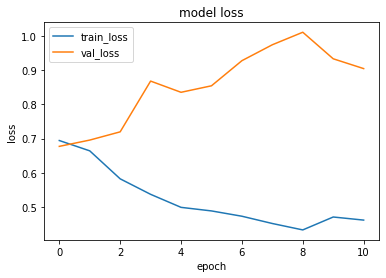

1it [00:00, 13842.59it/s]


prediction for video armflapping_1.mov is [[0.513196]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_3.mov is [[0.47814602]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.56648034]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.49792904]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.4935937]]


1it [00:00, 14768.68it/s]


prediction for video control_3.mov is [[0.49496353]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6878 - accuracy: 0.4750 - precision: 0.4848 - recall: 0.8000 - val_loss: 0.7709 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7365 - accuracy: 0.5250 - precision: 0.6667 - recall: 0.1000 - val_loss: 0.6690 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6355 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6448 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6210 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6040 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.

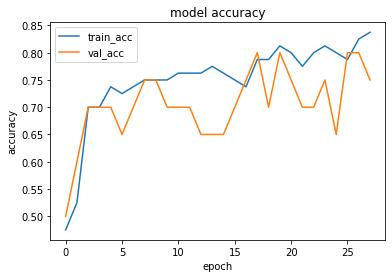

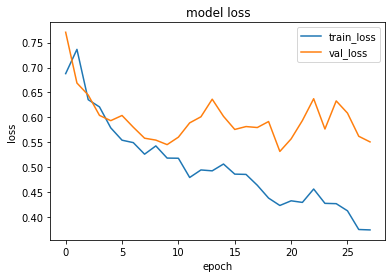

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.73614895]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.61415535]]


1it [00:00, 11491.24it/s]


prediction for video armflapping_2.mov is [[0.8756336]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.20828557]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.2068165]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.20655853]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7260 - accuracy: 0.5625 - precision: 0.6471 - recall: 0.2750 - val_loss: 0.6004 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6600 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.5952 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5901 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5337 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 153ms/step - loss: 0.5794 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.4774 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

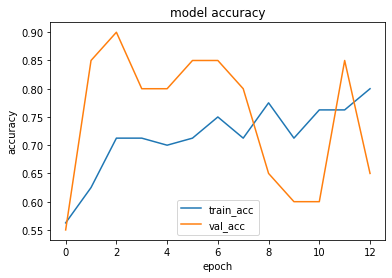

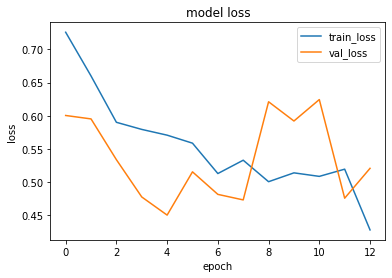

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5030627]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.48314777]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.59085447]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.44999933]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.41885826]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.41957778]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.8152 - accuracy: 0.4375 - precision: 0.4074 - recall: 0.2750 - val_loss: 0.6176 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6870 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.6084 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6766 - accuracy: 0.5875 - precision: 0.5614 - recall: 0.8000 - val_loss: 0.5801 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6365 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.5436 - val_accuracy: 0.9500 - val_precision: 0.9091 - val_recall: 1.0000
Epo

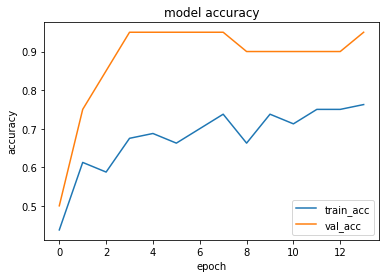

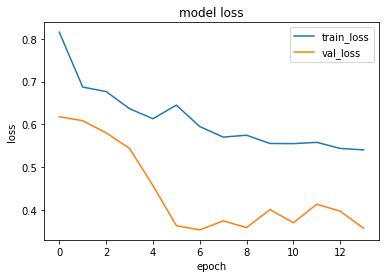

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.4823815]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.54345995]]


1it [00:00, 12520.31it/s]


prediction for video armflapping_2.mov is [[0.5556463]]


1it [00:00, 16710.37it/s]


prediction for video control_1.mov is [[0.4451309]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.42419583]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.4236786]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6682 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.7687 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6188 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.7344 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5373 - accuracy: 0.8125 - precision: 0.7778 - recall: 0.8750 - val_loss: 0.7781 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5111 - accuracy: 0.8000 - precision: 0.8000 - recall: 0.8000 - val_loss: 0.8886 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoc

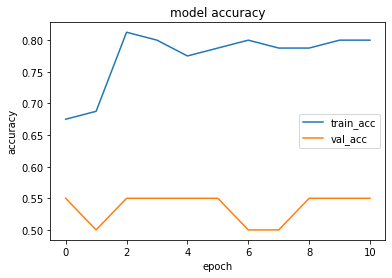

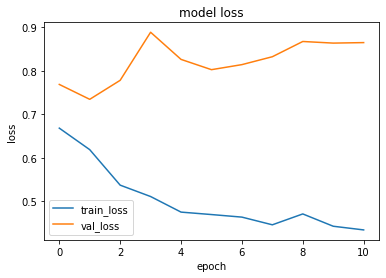

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.46963334]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.30418152]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.6858052]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.16262448]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.1500268]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.15104622]]


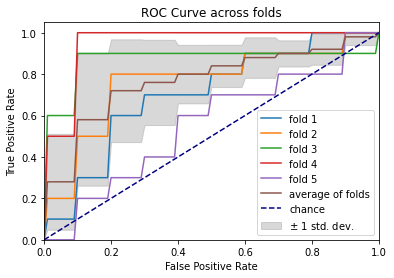

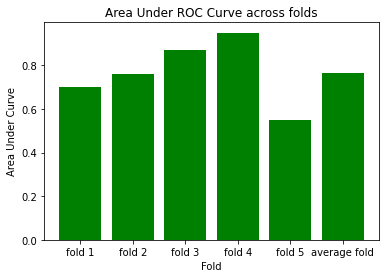

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.8341 - accuracy: 0.5625 - precision: 0.5373 - recall: 0.9000 - val_loss: 0.7608 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6498 - accuracy: 0.6625 - precision: 0.6585 - recall: 0.6750 - val_loss: 0.6823 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5867 - accuracy: 0.7875 - precision: 0.8286 - recall: 0.7250 - val_loss: 0.7343 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5726 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.7951 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 133

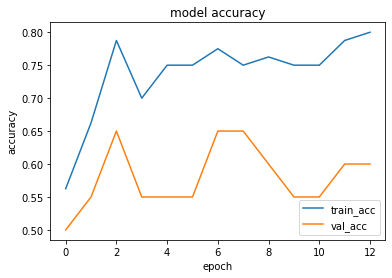

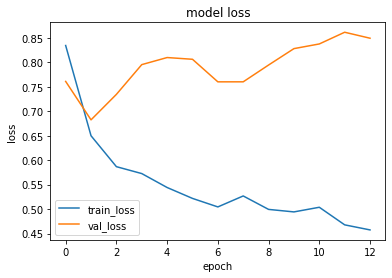

1it [00:00, 12945.38it/s]


prediction for video armflapping_1.mov is [[0.5207237]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.5296223]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6097018]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.2667297]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.21626621]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.18727022]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7231 - accuracy: 0.5500 - precision: 0.5476 - recall: 0.5750 - val_loss: 0.6249 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6341 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6104 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5862 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.5935 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5648 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.5721 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

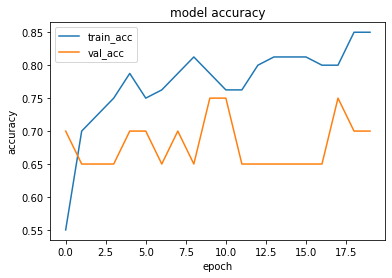

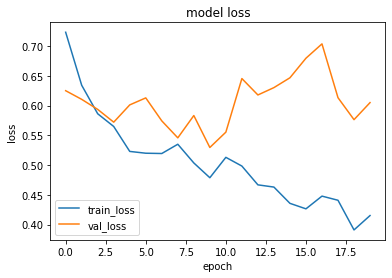

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.5187697]]


1it [00:00, 18641.35it/s]


prediction for video armflapping_3.mov is [[0.26874053]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.78538823]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.3751913]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.24586958]]


1it [00:00, 11618.57it/s]


prediction for video control_3.mov is [[0.29170758]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6386 - accuracy: 0.6000 - precision: 0.5909 - recall: 0.6500 - val_loss: 0.8175 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5943 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.6215 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5383 - accuracy: 0.7750 - precision: 0.8056 - recall: 0.7250 - val_loss: 0.6251 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5248 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.7004 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

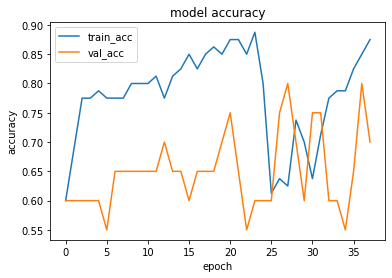

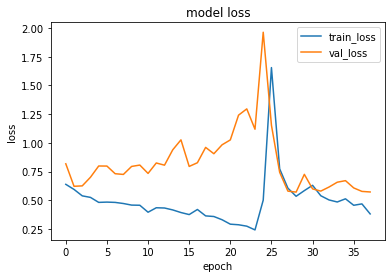

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.66196114]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.8189546]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.3534659]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.39998215]]


1it [00:00, 19239.93it/s]


prediction for video control_2.mov is [[0.5487071]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.09546751]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7370 - accuracy: 0.5375 - precision: 0.5600 - recall: 0.3500 - val_loss: 0.6140 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6871 - accuracy: 0.5500 - precision: 0.5263 - recall: 1.0000 - val_loss: 0.6090 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6330 - accuracy: 0.6875 - precision: 0.6271 - recall: 0.9250 - val_loss: 0.6125 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6192 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.5757 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

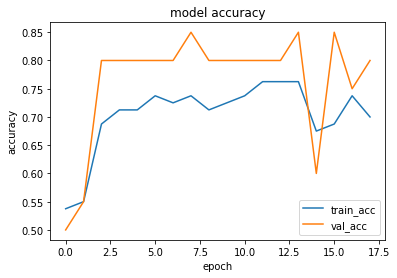

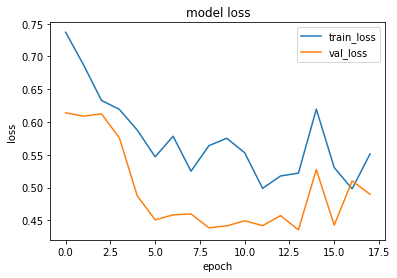

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.66150403]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.6178182]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.77206135]]


1it [00:00, 16644.06it/s]


prediction for video control_1.mov is [[0.2926801]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.2923068]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.29423705]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 215ms/step - loss: 0.7821 - accuracy: 0.4500 - precision: 0.4500 - recall: 0.4500 - val_loss: 0.6362 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6539 - accuracy: 0.6375 - precision: 0.6341 - recall: 0.6500 - val_loss: 0.6044 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6233 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.5823 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6177 - accuracy: 0.6500 - precision: 0.6500 - recall: 0.6500 - val_loss: 0.5253 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

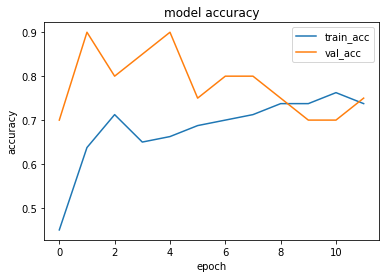

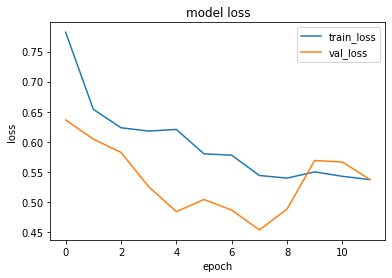

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.51290554]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5088241]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5516527]]


1it [00:00, 16578.28it/s]


prediction for video control_1.mov is [[0.4970089]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.49040183]]


1it [00:00, 14563.56it/s]


prediction for video control_3.mov is [[0.4885588]]


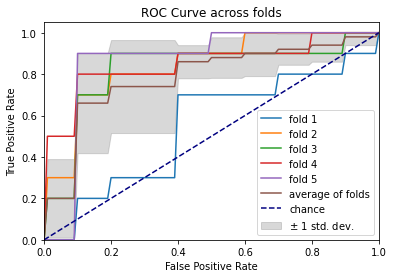

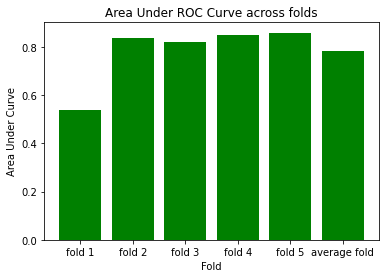

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.7208 - accuracy: 0.4625 - precision: 0.4634 - recall: 0.4750 - val_loss: 0.8845 - val_accuracy: 0.4500 - val_precision: 0.4615 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6572 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.7849 - val_accuracy: 0.4000 - val_precision: 0.3750 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6076 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.7799 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5641 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.8241 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 5/75
3/3 [==============================] - 0s 133

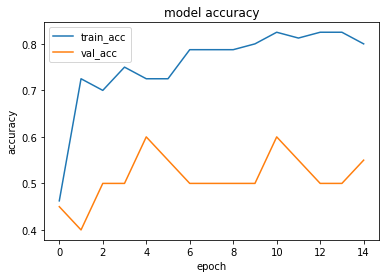

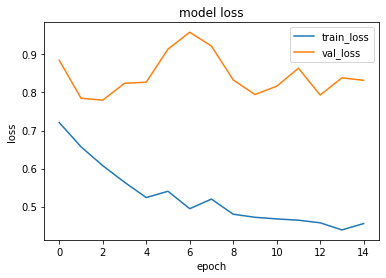

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.567165]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.61409605]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.6985377]]


1it [00:00, 16448.25it/s]


prediction for video control_1.mov is [[0.19059601]]


1it [00:00, 13706.88it/s]


prediction for video control_2.mov is [[0.14589837]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.14400244]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.8130 - accuracy: 0.4875 - precision: 0.4906 - recall: 0.6500 - val_loss: 0.6575 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6567 - accuracy: 0.6125 - precision: 0.6552 - recall: 0.4750 - val_loss: 0.6092 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6256 - accuracy: 0.6000 - precision: 0.5714 - recall: 0.8000 - val_loss: 0.5641 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6097 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.5580 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

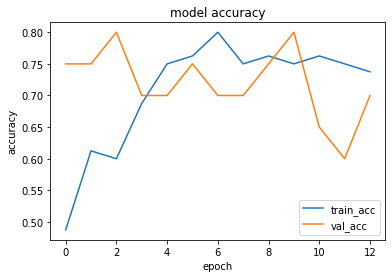

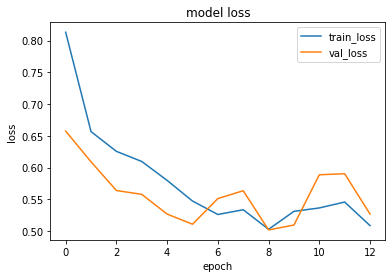

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.57614976]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_3.mov is [[0.5968888]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.68374836]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.5093452]]


1it [00:00, 14027.77it/s]


prediction for video control_2.mov is [[0.46669716]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.45988417]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7020 - accuracy: 0.4375 - precision: 0.4561 - recall: 0.6500 - val_loss: 0.6644 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 194ms/step - loss: 0.6299 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.5879 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6277 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.6180 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5491 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.5799 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

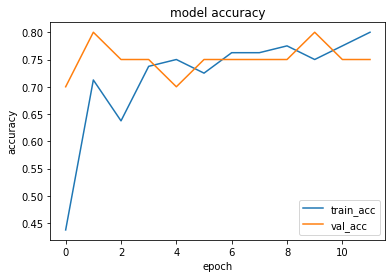

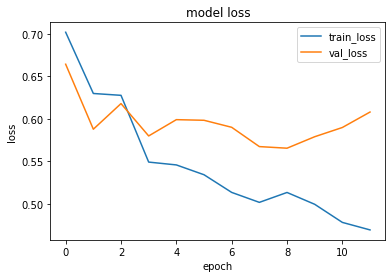

1it [00:00, 13530.01it/s]


prediction for video armflapping_1.mov is [[0.4438926]]


1it [00:00, 14768.68it/s]


prediction for video armflapping_3.mov is [[0.7506969]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.81934476]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.2701378]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.24936575]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.24603075]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7424 - accuracy: 0.5750 - precision: 0.5938 - recall: 0.4750 - val_loss: 0.6718 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6436 - accuracy: 0.5625 - precision: 0.5362 - recall: 0.9250 - val_loss: 0.6628 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5845 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6431 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5815 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.7594 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epo

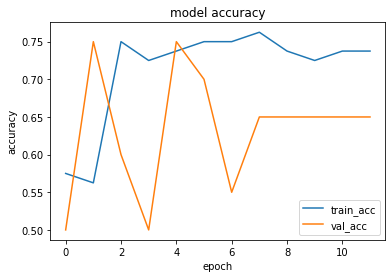

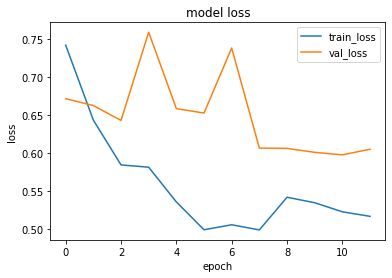

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.49349836]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.33683577]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.60932624]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.3637374]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.34215358]]


1it [00:00, 14122.24it/s]


prediction for video control_3.mov is [[0.3134271]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.8013 - accuracy: 0.5500 - precision: 0.5333 - recall: 0.8000 - val_loss: 0.6599 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6578 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.6424 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6566 - accuracy: 0.6500 - precision: 0.7000 - recall: 0.5250 - val_loss: 0.6076 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6136 - accuracy: 0.7250 - precision: 0.7500 - recall: 0.6750 - val_loss: 0.5737 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoc

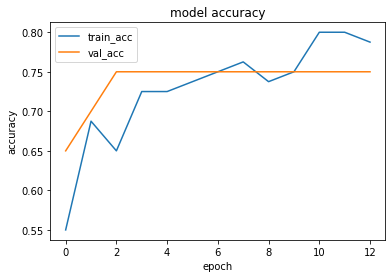

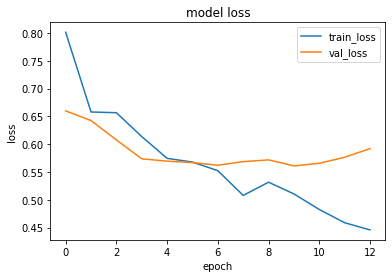

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.58781654]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_3.mov is [[0.36207575]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.83533394]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.1981135]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.15347913]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.15209764]]


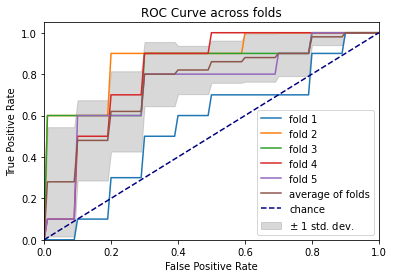

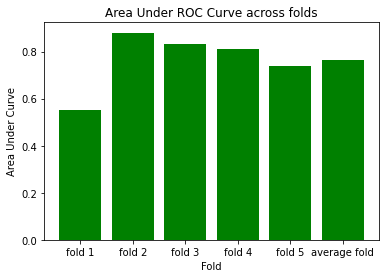

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.8685 - accuracy: 0.4875 - precision: 0.4932 - recall: 0.9000 - val_loss: 0.7066 - val_accuracy: 0.4500 - val_precision: 0.4706 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6349 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6695 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5948 - accuracy: 0.8000 - precision: 0.8000 - recall: 0.8000 - val_loss: 0.7812 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5841 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.8257 - val_accuracy: 0.5500 - val_precision: 0.5333 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 137

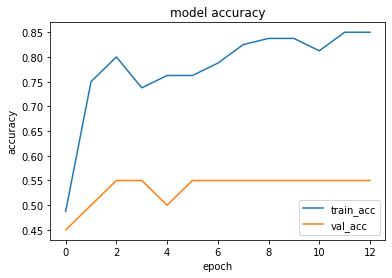

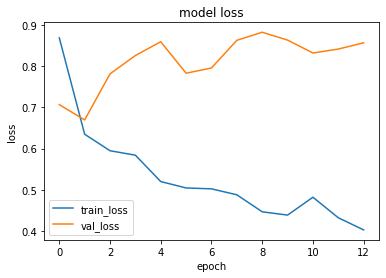

1it [00:00, 12985.46it/s]


prediction for video armflapping_1.mov is [[0.5954374]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.54413396]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6694826]]


1it [00:00, 5262.61it/s]


prediction for video control_1.mov is [[0.31164843]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.16440606]]


1it [00:00, 15477.14it/s]


prediction for video control_3.mov is [[0.14476302]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6834 - accuracy: 0.6125 - precision: 0.5957 - recall: 0.7000 - val_loss: 0.7166 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6556 - accuracy: 0.5500 - precision: 0.5769 - recall: 0.3750 - val_loss: 0.5878 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.5807 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5438 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5733 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.5041 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

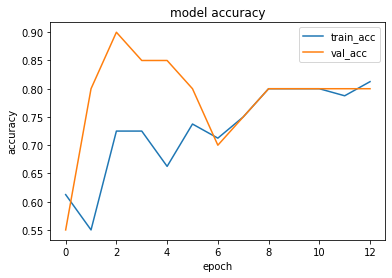

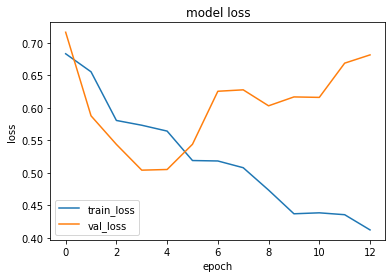

1it [00:00, 10645.44it/s]


prediction for video armflapping_1.mov is [[0.5357959]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.5527286]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.6003419]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.46165758]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.41304088]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.4052866]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6893 - accuracy: 0.6125 - precision: 0.5849 - recall: 0.7750 - val_loss: 0.5519 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6320 - accuracy: 0.6125 - precision: 0.6154 - recall: 0.6000 - val_loss: 0.5880 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5840 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.5869 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5643 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5046 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoc

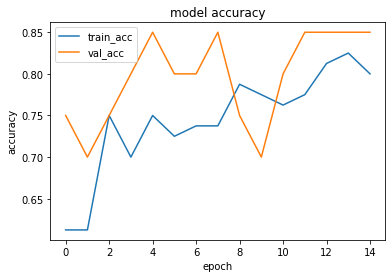

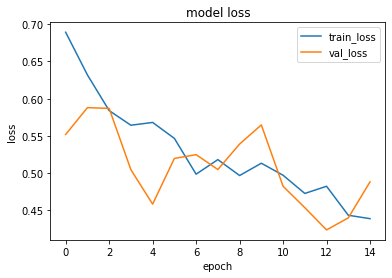

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.31933904]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.38920388]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.8711508]]


1it [00:00, 16384.00it/s]


prediction for video control_1.mov is [[0.1786637]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.16705126]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.16512194]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6353 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6778 - val_accuracy: 0.6500 - val_precision: 0.5882 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6330 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6729 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5994 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6929 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5652 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.6712 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

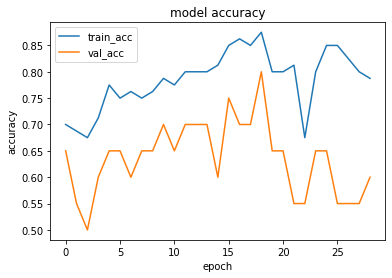

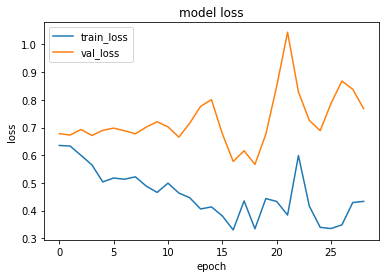

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.40478152]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.17089286]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.8160949]]


1it [00:00, 16448.25it/s]


prediction for video control_1.mov is [[0.31000447]]


1it [00:00, 12483.05it/s]


prediction for video control_2.mov is [[0.48562682]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.35828954]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7615 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9000 - val_loss: 0.7068 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6456 - accuracy: 0.6375 - precision: 0.7391 - recall: 0.4250 - val_loss: 0.6979 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6122 - accuracy: 0.6625 - precision: 0.6970 - recall: 0.5750 - val_loss: 0.7096 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6021 - accuracy: 0.6500 - precision: 0.6034 - recall: 0.8750 - val_loss: 0.7463 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

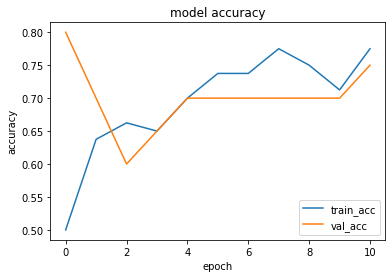

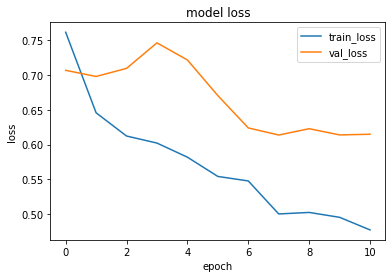

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.48600706]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.5351044]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.69310653]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.2758743]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.239137]]


1it [00:00, 15196.75it/s]


prediction for video control_3.mov is [[0.22986573]]


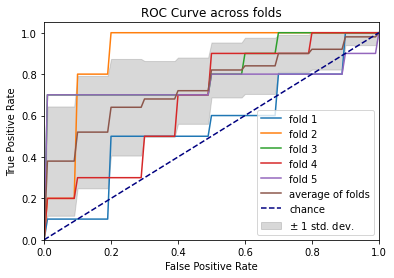

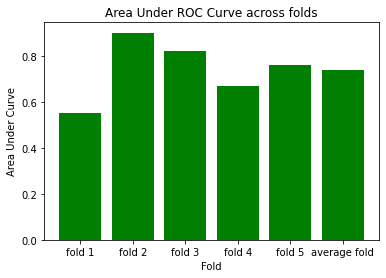

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7400 - accuracy: 0.5500 - precision: 0.5625 - recall: 0.4500 - val_loss: 0.6790 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.7241 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.6508 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6452 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.6236 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6325 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5981 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 133

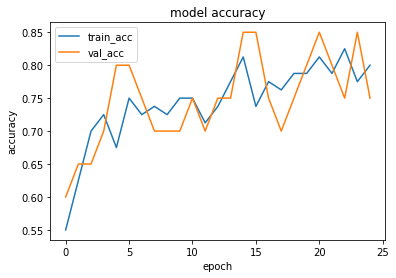

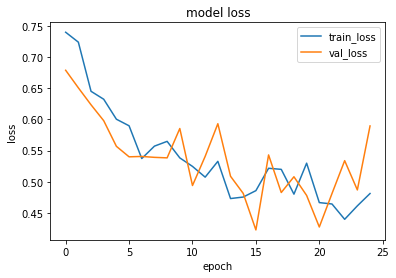

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.6700303]]


1it [00:00, 13662.23it/s]


prediction for video armflapping_3.mov is [[0.40476426]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.8026404]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.4138419]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.16131613]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.22920707]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6802 - accuracy: 0.4625 - precision: 0.4746 - recall: 0.7000 - val_loss: 0.6745 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6695 - accuracy: 0.7000 - precision: 0.7857 - recall: 0.5500 - val_loss: 0.6336 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5939 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6853 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5720 - accuracy: 0.7375 - precision: 0.6863 - recall: 0.8750 - val_loss: 0.6700 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

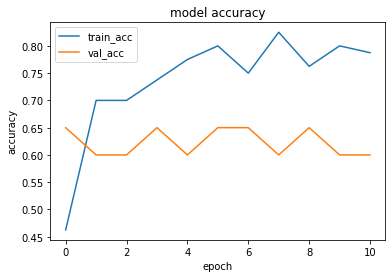

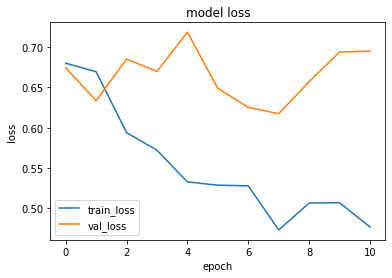

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.8021078]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_3.mov is [[0.7358697]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8690201]]


1it [00:00, 17549.39it/s]


prediction for video control_1.mov is [[0.20950615]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.19552466]]


1it [00:00, 13888.42it/s]


prediction for video control_3.mov is [[0.19416013]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 145ms/step - loss: 0.8345 - accuracy: 0.5625 - precision: 0.5455 - recall: 0.7500 - val_loss: 0.6451 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6453 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.5759 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6213 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.4930 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6184 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.4731 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

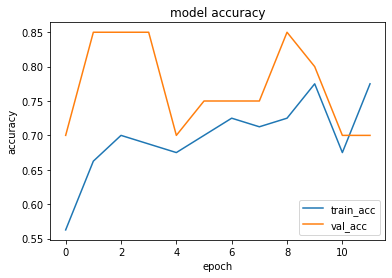

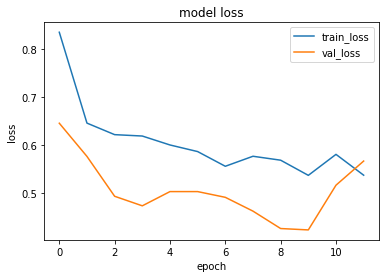

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.2657646]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.33230877]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.5531052]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.25755954]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.2556306]]


1it [00:00, 16070.13it/s]


prediction for video control_3.mov is [[0.25349063]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7103 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.8433 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 128ms/step - loss: 0.6138 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6515 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6001 - accuracy: 0.7000 - precision: 0.8077 - recall: 0.5250 - val_loss: 0.6656 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5296 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.6896 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

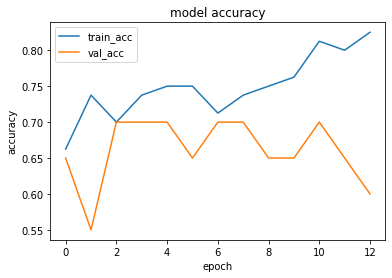

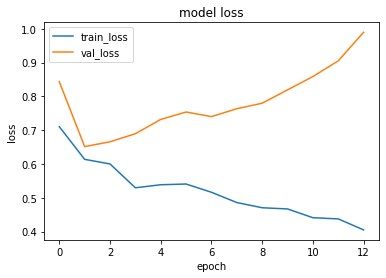

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.4063458]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.3813296]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.70311856]]


1it [00:00, 1862.48it/s]


prediction for video control_1.mov is [[0.26005238]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2552328]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.23140818]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7617 - accuracy: 0.5250 - precision: 0.5294 - recall: 0.4500 - val_loss: 0.6498 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6235 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.6337 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5838 - accuracy: 0.7375 - precision: 0.6939 - recall: 0.8500 - val_loss: 0.6067 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5389 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6094 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

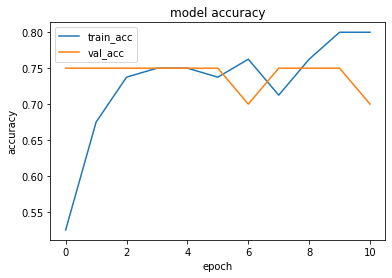

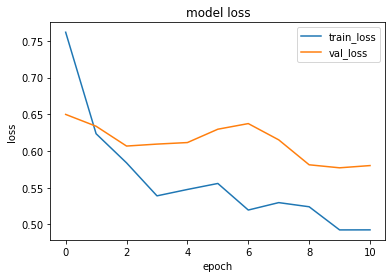

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.26195228]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.25705215]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.7138625]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.17987481]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.16408283]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.16253138]]


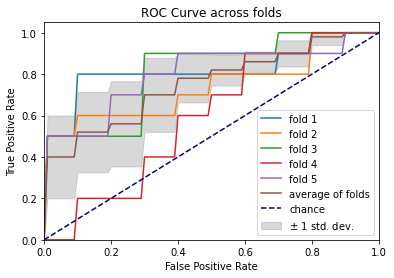

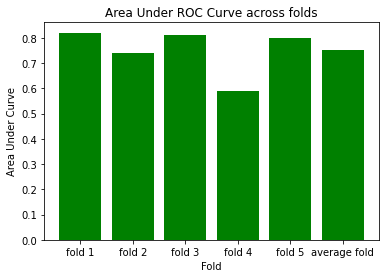

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6956 - accuracy: 0.5625 - precision: 0.5676 - recall: 0.5250 - val_loss: 0.6028 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6251 - accuracy: 0.7250 - precision: 0.6800 - recall: 0.8500 - val_loss: 0.6009 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 1s 140ms/step - loss: 0.6154 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.5400 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5489 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5094 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 139

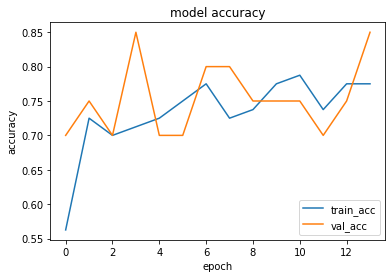

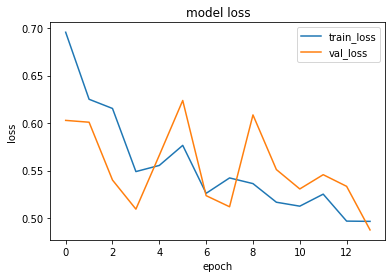

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.55355626]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.3780634]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.6661725]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.35570687]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.21249592]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.22552475]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6892 - accuracy: 0.5500 - precision: 0.5526 - recall: 0.5250 - val_loss: 0.7695 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6337 - accuracy: 0.7250 - precision: 0.6731 - recall: 0.8750 - val_loss: 0.6913 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5711 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.8087 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5696 - accuracy: 0.7125 - precision: 0.6545 - recall: 0.9000 - val_loss: 0.7819 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epo

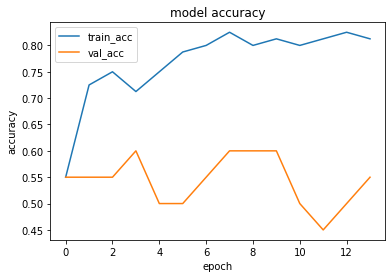

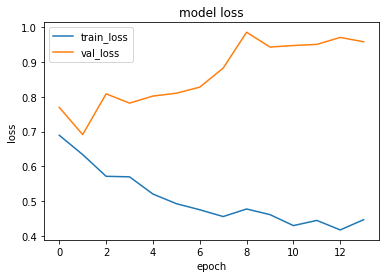

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.6009297]]


1it [00:00, 11618.57it/s]


prediction for video armflapping_3.mov is [[0.45601192]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.775304]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.15209892]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.16427231]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.16266438]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6850 - accuracy: 0.6125 - precision: 0.6000 - recall: 0.6750 - val_loss: 0.6676 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6310 - accuracy: 0.6625 - precision: 0.6327 - recall: 0.7750 - val_loss: 0.5995 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5836 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.5667 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5807 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.5567 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

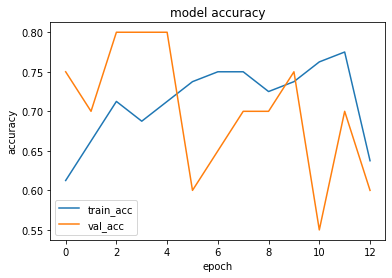

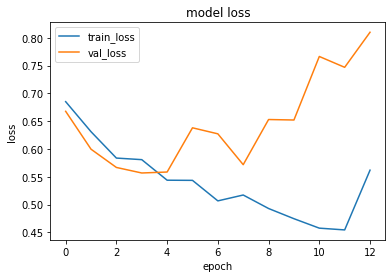

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.514216]]


1it [00:00, 19152.07it/s]


prediction for video armflapping_3.mov is [[0.8980857]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.608657]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.46164823]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.53550524]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.5095455]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 138ms/step - loss: 0.7182 - accuracy: 0.5500 - precision: 0.5455 - recall: 0.6000 - val_loss: 0.6679 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6639 - accuracy: 0.5875 - precision: 0.5593 - recall: 0.8250 - val_loss: 0.6255 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5751 - accuracy: 0.7625 - precision: 0.8182 - recall: 0.6750 - val_loss: 0.6594 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5889 - accuracy: 0.7500 - precision: 0.8571 - recall: 0.6000 - val_loss: 0.6422 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoc

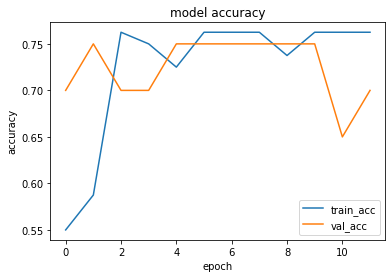

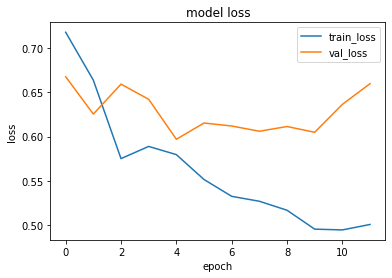

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.76338613]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.229597]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.8546799]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.5113493]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.25228488]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.24330407]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.7653 - accuracy: 0.4750 - precision: 0.4773 - recall: 0.5250 - val_loss: 0.6460 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6556 - accuracy: 0.6625 - precision: 0.6970 - recall: 0.5750 - val_loss: 0.6192 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6312 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.5933 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6013 - accuracy: 0.7125 - precision: 0.6735 - recall: 0.8250 - val_loss: 0.5693 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

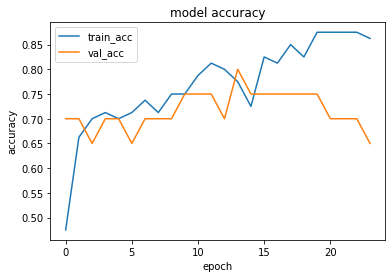

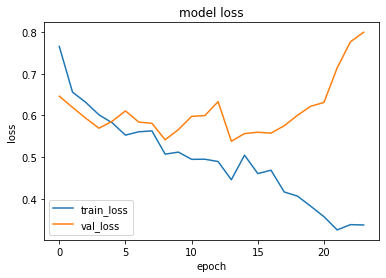

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.2834076]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.8416312]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.9105358]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.14342329]]


1it [00:00, 16980.99it/s]


prediction for video control_2.mov is [[0.17516366]]


1it [00:00, 14027.77it/s]


prediction for video control_3.mov is [[0.18146831]]


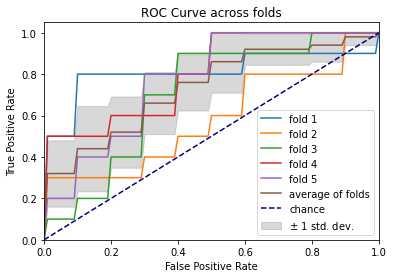

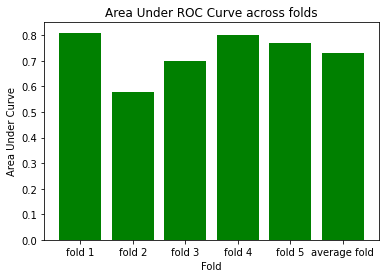

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.6653 - accuracy: 0.6375 - precision: 0.6571 - recall: 0.5750 - val_loss: 1.0143 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.8265 - accuracy: 0.6500 - precision: 0.5938 - recall: 0.9500 - val_loss: 0.6548 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6012 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6650 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5932 - accuracy: 0.7875 - precision: 0.8286 - recall: 0.7250 - val_loss: 0.6689 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 134

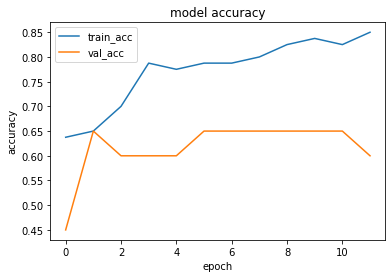

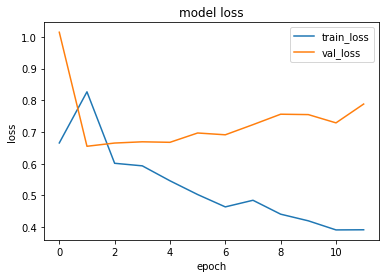

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.55100304]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.49067312]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.6281501]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.4832711]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.3981339]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.42106298]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7958 - accuracy: 0.4250 - precision: 0.4464 - recall: 0.6250 - val_loss: 0.6218 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 1s 216ms/step - loss: 0.6386 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.5985 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6088 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.5379 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6057 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.4720 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

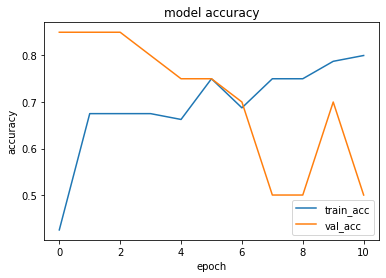

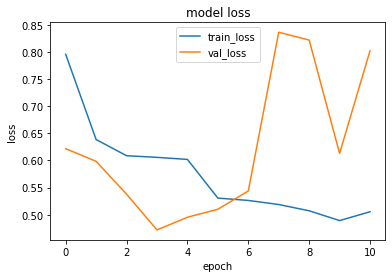

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5224103]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.52688897]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.559717]]


1it [00:00, 19239.93it/s]


prediction for video control_1.mov is [[0.49940634]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.49003437]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.4896838]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7029 - accuracy: 0.5500 - precision: 0.6111 - recall: 0.2750 - val_loss: 0.8186 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.7632 - accuracy: 0.5750 - precision: 0.5405 - recall: 1.0000 - val_loss: 0.6499 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6134 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.7066 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5769 - accuracy: 0.7500 - precision: 0.7941 - recall: 0.6750 - val_loss: 0.7433 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoc

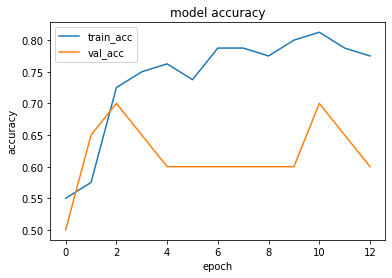

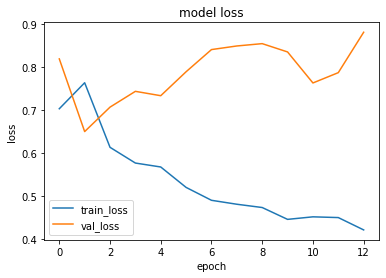

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.741065]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.36885816]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.81323195]]


1it [00:00, 6034.97it/s]


prediction for video control_1.mov is [[0.30197376]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.28033662]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.28464845]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7781 - accuracy: 0.4250 - precision: 0.4211 - recall: 0.4000 - val_loss: 0.6469 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6289 - accuracy: 0.7625 - precision: 0.7234 - recall: 0.8500 - val_loss: 0.6151 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5940 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6072 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5446 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6168 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epo

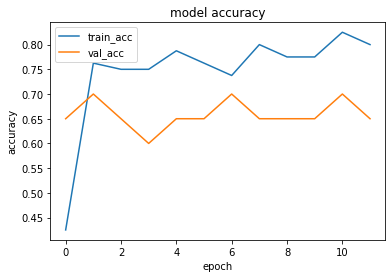

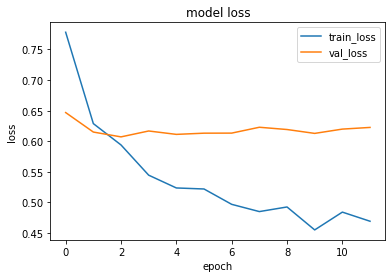

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.5304304]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.5073446]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.8313773]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.23214495]]


1it [00:00, 5753.50it/s]


prediction for video control_2.mov is [[0.21067828]]


1it [00:00, 11125.47it/s]


prediction for video control_3.mov is [[0.20770326]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6718 - accuracy: 0.5125 - precision: 0.5094 - recall: 0.6750 - val_loss: 0.7181 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6681 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.6012 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5954 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.5363 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5899 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5160 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

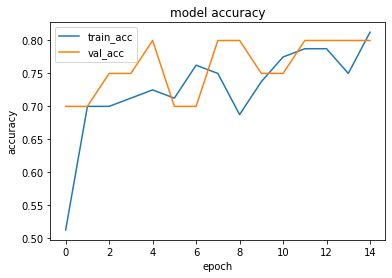

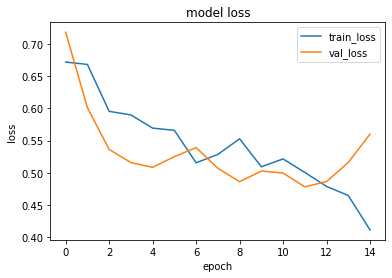

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.82039165]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.3471743]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.85449755]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.57408667]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.32083452]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.49400648]]


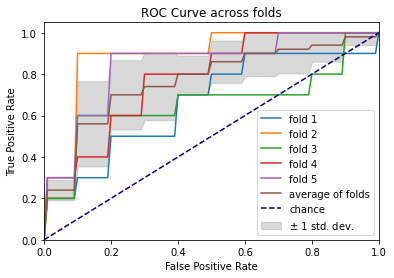

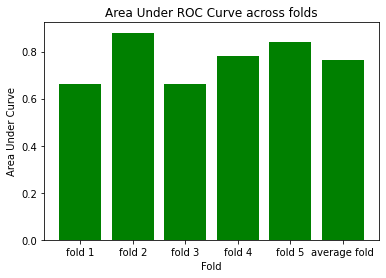

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.6883 - accuracy: 0.6625 - precision: 0.6667 - recall: 0.6500 - val_loss: 0.6500 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5955 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.5950 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5676 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.5787 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5644 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5984 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 133

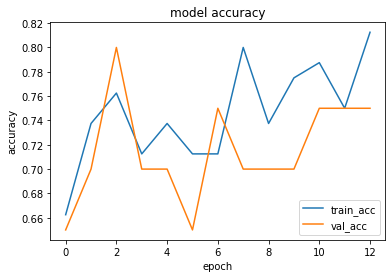

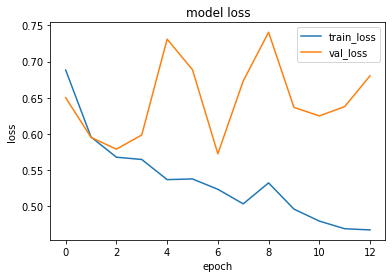

1it [00:00, 13888.42it/s]


prediction for video armflapping_1.mov is [[0.5024308]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.39688626]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.6772552]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.35235554]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.22015443]]


1it [00:00, 13662.23it/s]


prediction for video control_3.mov is [[0.27034473]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7220 - accuracy: 0.5875 - precision: 0.5574 - recall: 0.8500 - val_loss: 0.6961 - val_accuracy: 0.6000 - val_precision: 1.0000 - val_recall: 0.2000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6318 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.6911 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5629 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6672 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5318 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.6855 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

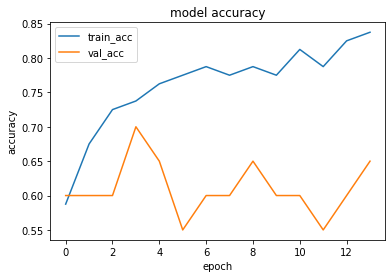

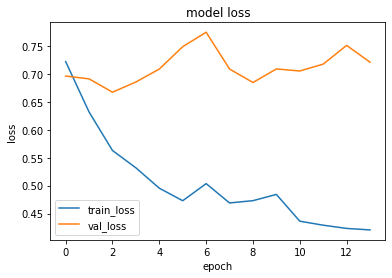

1it [00:00, 16644.06it/s]


prediction for video armflapping_1.mov is [[0.4956811]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.16058421]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.8461952]]


1it [00:00, 16131.94it/s]


prediction for video control_1.mov is [[0.2509678]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.24820715]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.24790722]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7490 - accuracy: 0.4250 - precision: 0.4500 - recall: 0.6750 - val_loss: 0.6671 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.7072 - accuracy: 0.5125 - precision: 0.5333 - recall: 0.2000 - val_loss: 0.6201 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6336 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5875 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6259 - accuracy: 0.7000 - precision: 0.6538 - recall: 0.8500 - val_loss: 0.5792 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

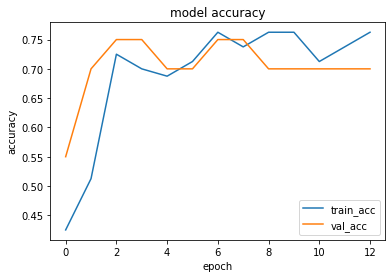

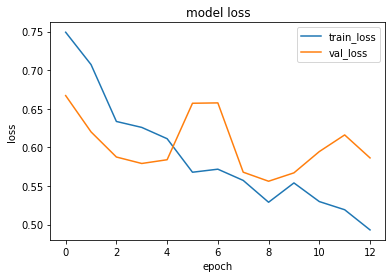

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.5518051]]


1it [00:00, 19599.55it/s]


prediction for video armflapping_3.mov is [[0.31792903]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.6899481]]


1it [00:00, 19239.93it/s]


prediction for video control_1.mov is [[0.23534831]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.16738853]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.14560056]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6703 - accuracy: 0.5625 - precision: 0.5472 - recall: 0.7250 - val_loss: 0.5385 - val_accuracy: 0.9500 - val_precision: 0.9091 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6606 - accuracy: 0.6000 - precision: 0.6429 - recall: 0.4500 - val_loss: 0.5363 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6519 - accuracy: 0.6375 - precision: 0.6000 - recall: 0.8250 - val_loss: 0.4364 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6072 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.4395 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epo

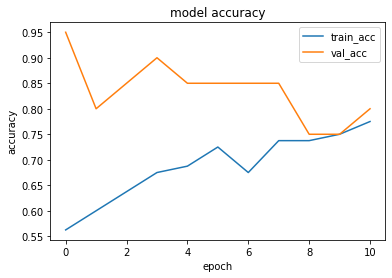

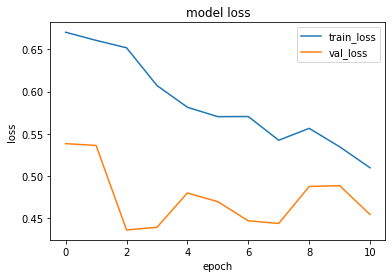

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.53300005]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.6039918]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.64338255]]


1it [00:00, 5924.16it/s]


prediction for video control_1.mov is [[0.4894318]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.47433156]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.46560085]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6377 - accuracy: 0.6125 - precision: 0.6047 - recall: 0.6500 - val_loss: 0.7540 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6275 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.6130 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5351 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.5815 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5519 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.5992 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

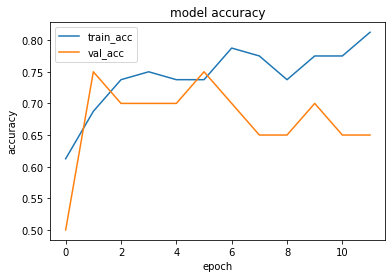

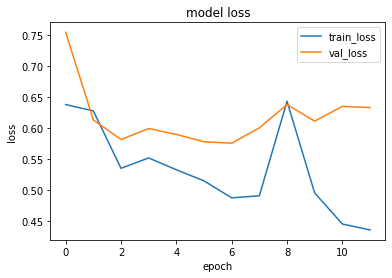

1it [00:00, 18157.16it/s]


prediction for video armflapping_1.mov is [[0.3463034]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.5451533]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.7258488]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.30123237]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.2829371]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.28072333]]


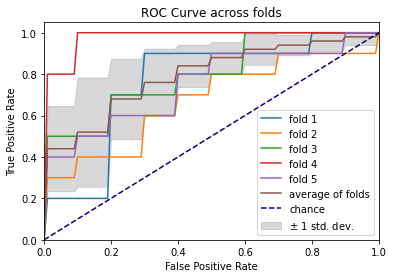

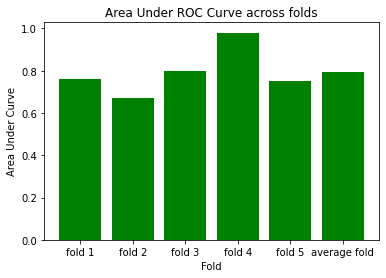

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 164ms/step - loss: 0.7399 - accuracy: 0.5375 - precision: 0.5517 - recall: 0.4000 - val_loss: 0.6520 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6513 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.6450 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6026 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6310 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5500 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.6197 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 131

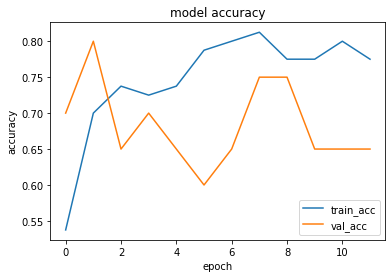

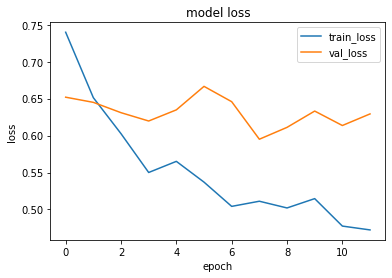

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.5493724]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.44492766]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_2.mov is [[0.61604893]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.49529642]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.46091387]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.46608186]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6538 - accuracy: 0.5500 - precision: 0.5455 - recall: 0.6000 - val_loss: 1.0178 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5624 - accuracy: 0.7875 - precision: 0.7447 - recall: 0.8750 - val_loss: 0.7714 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5559 - accuracy: 0.7750 - precision: 0.8056 - recall: 0.7250 - val_loss: 0.7670 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5046 - accuracy: 0.7875 - precision: 0.7805 - recall: 0.8000 - val_loss: 0.7848 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epo

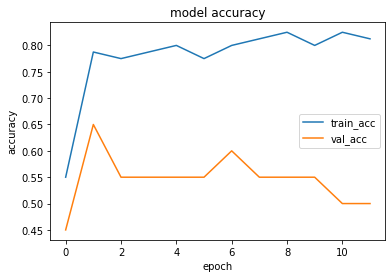

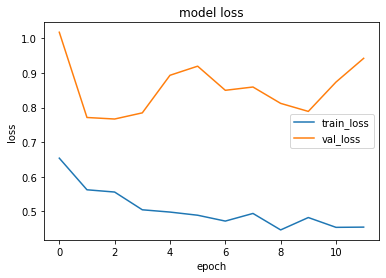

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.4525483]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.77883565]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.90843487]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.19551125]]


1it [00:00, 18724.57it/s]


prediction for video control_2.mov is [[0.22829086]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.19373488]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.8007 - accuracy: 0.4875 - precision: 0.4898 - recall: 0.6000 - val_loss: 0.7526 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6557 - accuracy: 0.6625 - precision: 0.6857 - recall: 0.6000 - val_loss: 0.7236 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6352 - accuracy: 0.7125 - precision: 0.7742 - recall: 0.6000 - val_loss: 0.7126 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.2000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5971 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6907 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

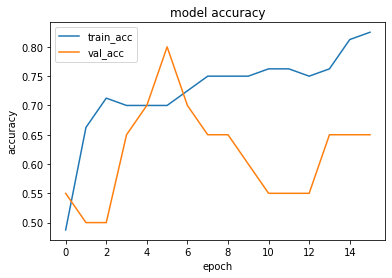

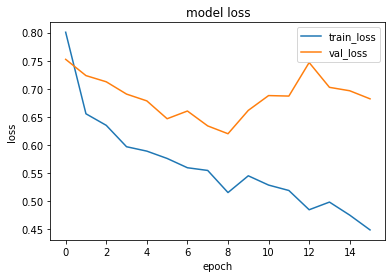

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.620878]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.3721145]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_2.mov is [[0.69928944]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.46460274]]


1it [00:00, 14266.34it/s]


prediction for video control_2.mov is [[0.2549346]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.28688157]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6982 - accuracy: 0.5625 - precision: 0.5532 - recall: 0.6500 - val_loss: 0.6239 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6561 - accuracy: 0.6125 - precision: 0.6800 - recall: 0.4250 - val_loss: 0.5684 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6056 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.5389 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5606 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.5770 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

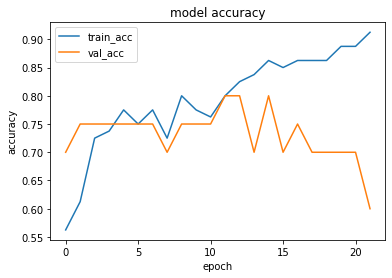

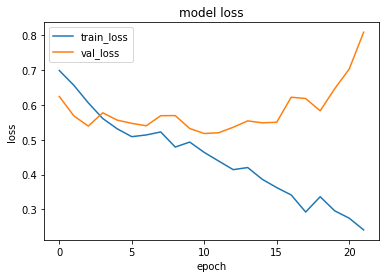

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.46256143]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.85936666]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.980334]]


1it [00:00, 16194.22it/s]


prediction for video control_1.mov is [[0.812135]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.10562775]]


1it [00:00, 18558.87it/s]


prediction for video control_3.mov is [[0.40238836]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7022 - accuracy: 0.5375 - precision: 0.5517 - recall: 0.4000 - val_loss: 0.6655 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6215 - accuracy: 0.6875 - precision: 0.6415 - recall: 0.8500 - val_loss: 0.5994 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5966 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5372 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5752 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5833 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epo

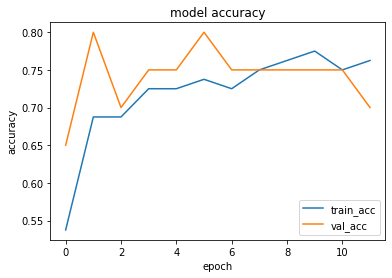

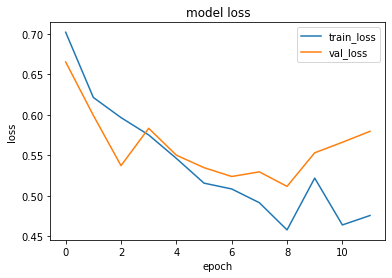

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.42912275]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.38915497]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.7299677]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.27622184]]


1it [00:00, 13530.01it/s]


prediction for video control_2.mov is [[0.23060316]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.30323943]]


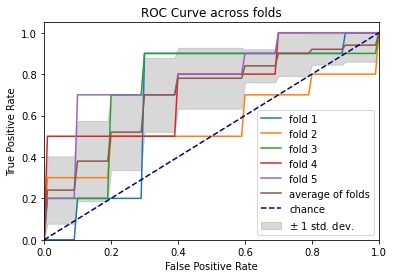

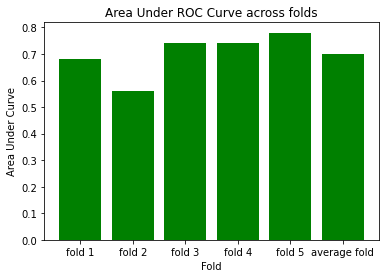

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 220ms/step - loss: 0.6914 - accuracy: 0.6375 - precision: 0.6038 - recall: 0.8000 - val_loss: 0.6313 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6231 - accuracy: 0.7125 - precision: 0.7179 - recall: 0.7000 - val_loss: 0.5824 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5822 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.5154 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5576 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.5391 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 135

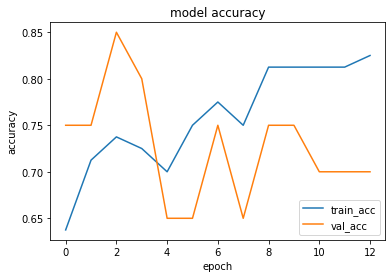

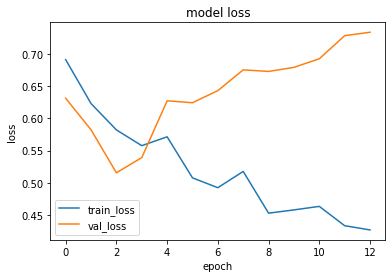

1it [00:00, 14217.98it/s]


prediction for video armflapping_1.mov is [[0.3922925]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.57446593]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.6522597]]


1it [00:00, 6754.11it/s]


prediction for video control_1.mov is [[0.23408064]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.1986061]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.19125792]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6364 - accuracy: 0.6375 - precision: 0.6170 - recall: 0.7250 - val_loss: 0.8934 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5905 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.7229 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.5634 - accuracy: 0.7375 - precision: 0.8276 - recall: 0.6000 - val_loss: 0.7210 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5368 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.6963 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

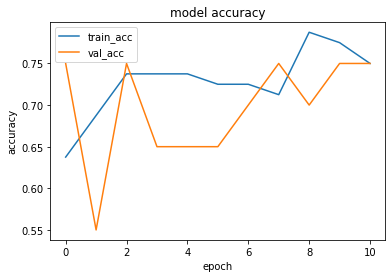

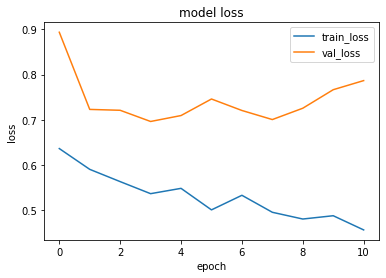

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.38016552]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.556523]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6201448]]


1it [00:00, 17189.77it/s]


prediction for video control_1.mov is [[0.2964603]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.2806334]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.2734955]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7296 - accuracy: 0.5500 - precision: 0.5667 - recall: 0.4250 - val_loss: 0.6757 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6450 - accuracy: 0.5750 - precision: 0.5455 - recall: 0.9000 - val_loss: 0.6580 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5980 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6388 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5534 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6333 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoc

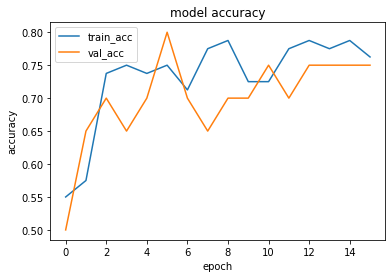

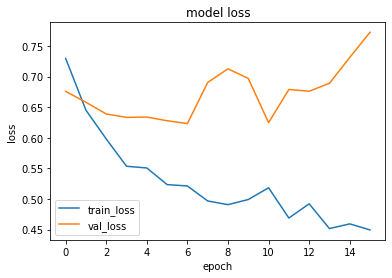

1it [00:00, 16070.13it/s]


prediction for video armflapping_1.mov is [[0.5538734]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.75359845]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.6764503]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.43086985]]


1it [00:00, 16710.37it/s]


prediction for video control_2.mov is [[0.2506565]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.30574432]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6692 - accuracy: 0.5500 - precision: 0.5400 - recall: 0.6750 - val_loss: 0.5727 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5975 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6123 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6128 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.6281 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5339 - accuracy: 0.7875 - precision: 0.7674 - recall: 0.8250 - val_loss: 0.6217 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

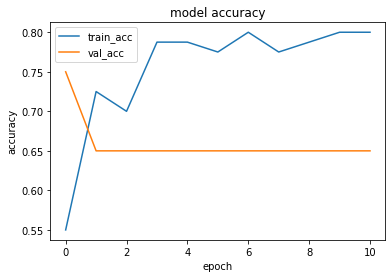

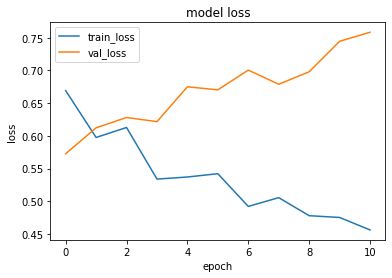

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.27746898]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.16342276]]


1it [00:00, 14217.98it/s]


prediction for video armflapping_2.mov is [[0.7951131]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.20755652]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.13018131]]


1it [00:00, 12633.45it/s]


prediction for video control_3.mov is [[0.16965929]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7214 - accuracy: 0.5250 - precision: 0.5179 - recall: 0.7250 - val_loss: 0.6391 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6258 - accuracy: 0.7500 - precision: 0.8125 - recall: 0.6500 - val_loss: 0.6248 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6185 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.5933 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5862 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6515 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

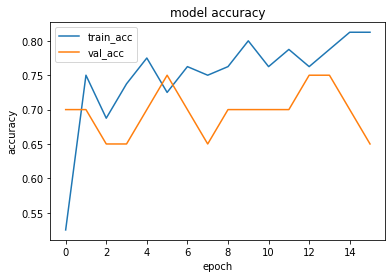

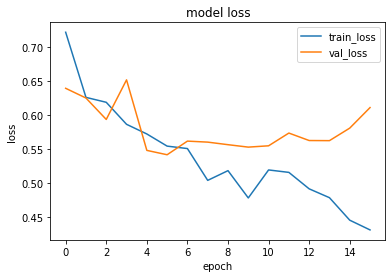

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.8022073]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.8441961]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.88819987]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.22824782]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.21196717]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.21096218]]


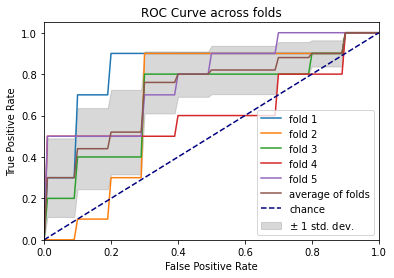

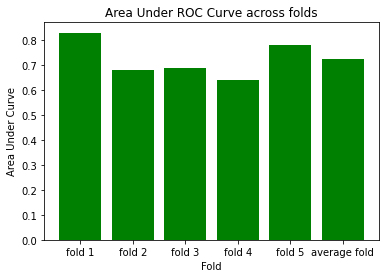

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.8043 - accuracy: 0.4375 - precision: 0.4510 - recall: 0.5750 - val_loss: 0.6376 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6872 - accuracy: 0.6125 - precision: 0.6000 - recall: 0.6750 - val_loss: 0.6229 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6513 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.5786 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6262 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.5393 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 5/75
3/3 [==============================] - 0s 137

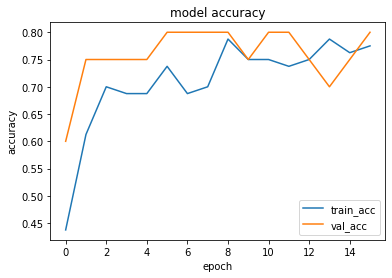

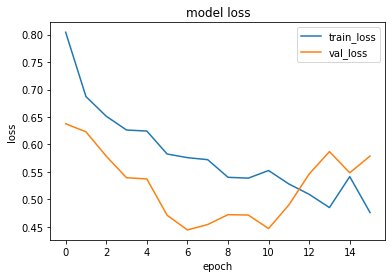

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.553079]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_3.mov is [[0.45335132]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.708719]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.4388716]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.3144846]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.3334237]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7339 - accuracy: 0.5500 - precision: 0.5909 - recall: 0.3250 - val_loss: 0.7712 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6479 - accuracy: 0.6000 - precision: 0.5667 - recall: 0.8500 - val_loss: 0.7990 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 152ms/step - loss: 0.5716 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.8371 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5352 - accuracy: 0.7750 - precision: 0.7391 - recall: 0.8500 - val_loss: 0.8900 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoc

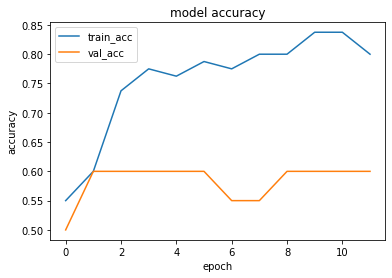

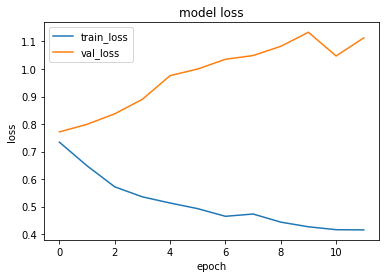

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.57114017]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.03724205]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.5144982]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.18250665]]


1it [00:00, 15477.14it/s]


prediction for video control_2.mov is [[0.23723978]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.20489615]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.8001 - accuracy: 0.4500 - precision: 0.4697 - recall: 0.7750 - val_loss: 0.8601 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6293 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7362 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6196 - accuracy: 0.6875 - precision: 0.7778 - recall: 0.5250 - val_loss: 0.7139 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5393 - accuracy: 0.7500 - precision: 0.8571 - recall: 0.6000 - val_loss: 0.8125 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epo

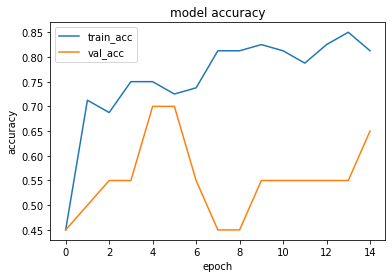

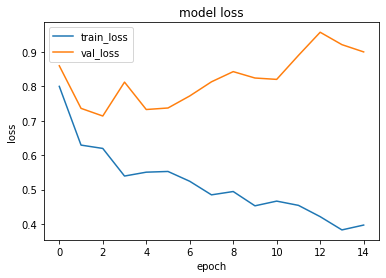

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.68322223]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.5840715]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.87273073]]


1it [00:00, 6492.73it/s]


prediction for video control_1.mov is [[0.4827831]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.24137014]]


1it [00:00, 17623.13it/s]


prediction for video control_3.mov is [[0.24176389]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6711 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.7228 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6723 - accuracy: 0.6125 - precision: 0.6216 - recall: 0.5750 - val_loss: 0.5401 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5719 - accuracy: 0.7750 - precision: 0.7391 - recall: 0.8500 - val_loss: 0.5034 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5916 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.4865 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

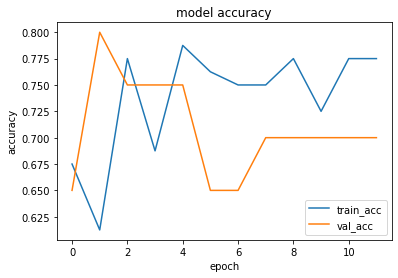

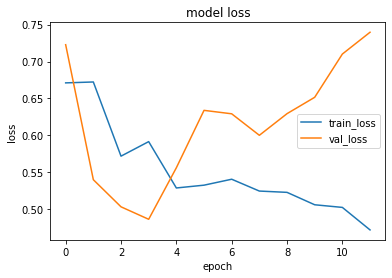

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.627892]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.33867335]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.78621376]]


1it [00:00, 6808.94it/s]


prediction for video control_1.mov is [[0.45888078]]


1it [00:00, 14513.16it/s]


prediction for video control_2.mov is [[0.13297012]]


1it [00:00, 14315.03it/s]


prediction for video control_3.mov is [[0.37209296]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6844 - accuracy: 0.4625 - precision: 0.4571 - recall: 0.4000 - val_loss: 0.8033 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.7400 - accuracy: 0.6125 - precision: 0.5714 - recall: 0.9000 - val_loss: 0.5896 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6345 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5748 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6295 - accuracy: 0.6875 - precision: 0.7419 - recall: 0.5750 - val_loss: 0.5474 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

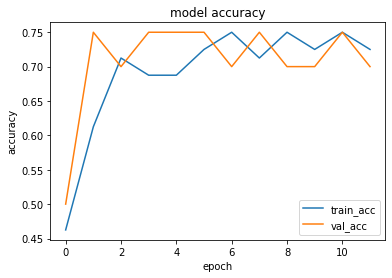

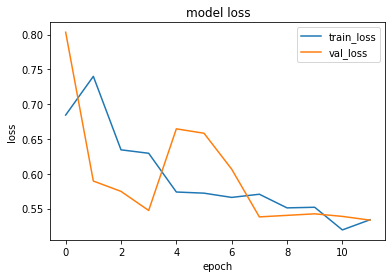

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.5080705]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.4836186]]


1it [00:00, 12787.51it/s]


prediction for video armflapping_2.mov is [[0.6423683]]


1it [00:00, 1837.99it/s]


prediction for video control_1.mov is [[0.17353454]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.16909546]]


1it [00:00, 16912.52it/s]


prediction for video control_3.mov is [[0.16907641]]


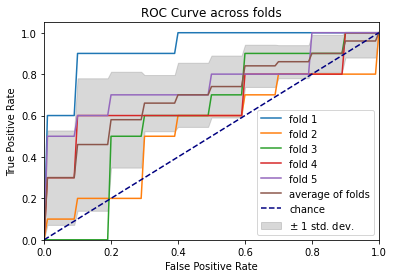

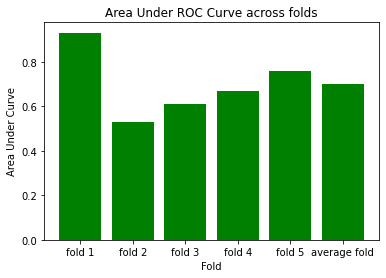

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6950 - accuracy: 0.5625 - precision: 0.5385 - recall: 0.8750 - val_loss: 0.6013 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6406 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.5515 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6194 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5187 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5512 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.5095 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 131

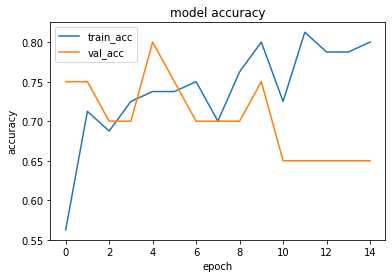

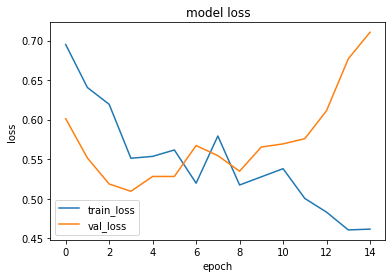

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.68912774]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.7162411]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.836428]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.40714052]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.32282782]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.30702066]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7288 - accuracy: 0.5125 - precision: 0.5075 - recall: 0.8500 - val_loss: 0.6773 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 142ms/step - loss: 0.6503 - accuracy: 0.6750 - precision: 0.6522 - recall: 0.7500 - val_loss: 0.6985 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6034 - accuracy: 0.7125 - precision: 0.8148 - recall: 0.5500 - val_loss: 0.6539 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5484 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.5976 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

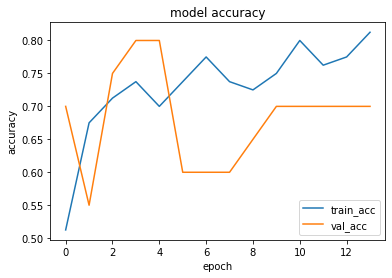

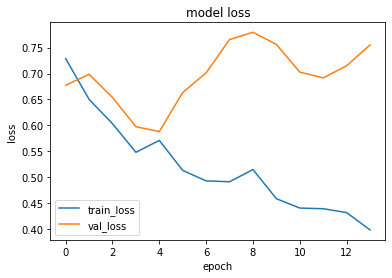

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.46826103]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.23273954]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.6046596]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.2819968]]


1it [00:00, 14463.12it/s]


prediction for video control_2.mov is [[0.2987243]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.27750707]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 160ms/step - loss: 0.6781 - accuracy: 0.5875 - precision: 0.5778 - recall: 0.6500 - val_loss: 0.6259 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6524 - accuracy: 0.6375 - precision: 0.6279 - recall: 0.6750 - val_loss: 0.6044 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5795 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5663 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5567 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5730 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

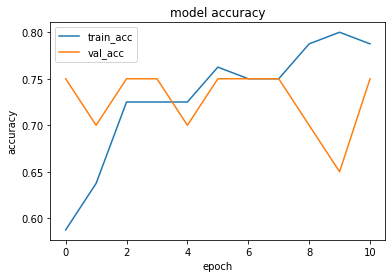

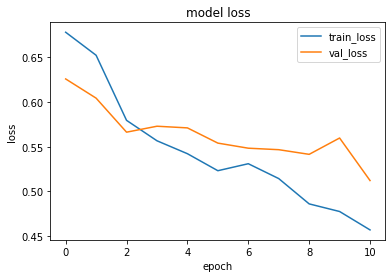

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.38987067]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.22157666]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.6574981]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.27581]]


1it [00:00, 17924.38it/s]


prediction for video control_2.mov is [[0.2554068]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.2559598]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 162ms/step - loss: 0.7135 - accuracy: 0.5375 - precision: 0.5306 - recall: 0.6500 - val_loss: 0.7268 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6812 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.6259 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5980 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6515 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5363 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7853 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

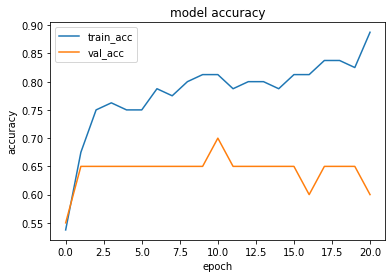

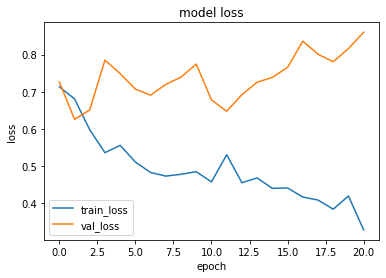

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.83074015]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_3.mov is [[0.2145657]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7933723]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.13616419]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.17311782]]


1it [00:00, 17549.39it/s]


prediction for video control_3.mov is [[0.17173472]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7719 - accuracy: 0.5125 - precision: 0.5200 - recall: 0.3250 - val_loss: 0.6959 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6754 - accuracy: 0.5250 - precision: 0.5135 - recall: 0.9500 - val_loss: 0.6468 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6078 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6260 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5702 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.6368 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

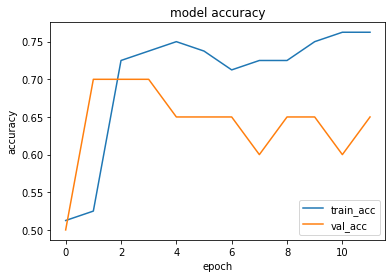

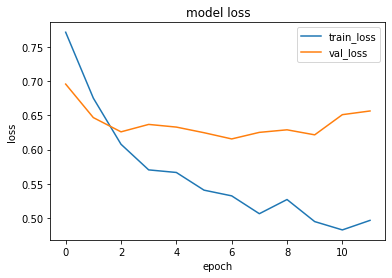

1it [00:00, 17476.27it/s]


prediction for video armflapping_1.mov is [[0.24462268]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.77998525]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.83887124]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.24630737]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.20706198]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.15728554]]


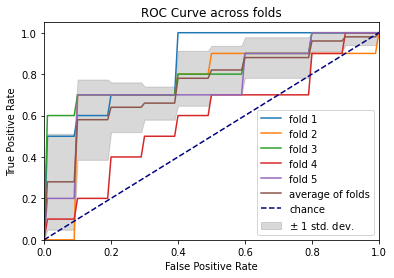

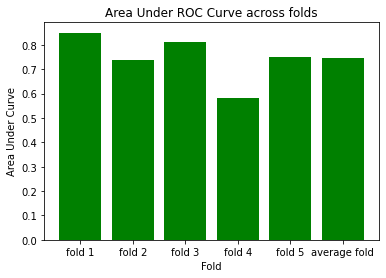

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.7091 - accuracy: 0.5500 - precision: 0.5385 - recall: 0.7000 - val_loss: 0.6760 - val_accuracy: 0.7500 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6439 - accuracy: 0.6625 - precision: 0.7407 - recall: 0.5000 - val_loss: 0.7192 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5524 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.7737 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5395 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.7547 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 132

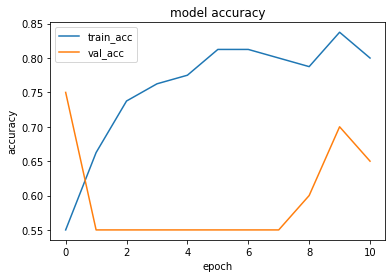

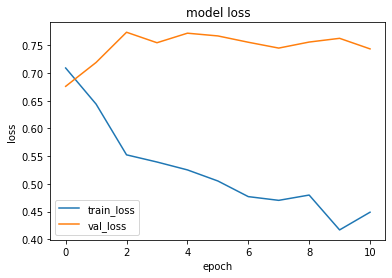

1it [00:00, 16644.06it/s]


prediction for video armflapping_1.mov is [[0.4811366]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.41124916]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.51061296]]


1it [00:00, 18893.26it/s]


prediction for video control_1.mov is [[0.4602027]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.45091638]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.45493028]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6495 - accuracy: 0.6375 - precision: 0.6341 - recall: 0.6500 - val_loss: 0.5033 - val_accuracy: 0.8500 - val_precision: 0.7692 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6195 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.4633 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5880 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.4924 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5679 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.4861 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epo

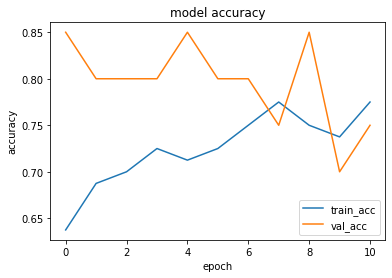

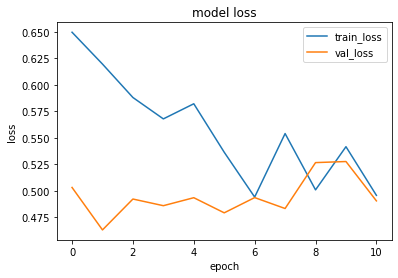

1it [00:00, 14027.77it/s]


prediction for video armflapping_1.mov is [[0.587146]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_3.mov is [[0.5671437]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.70280296]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.47953632]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.4356499]]


1it [00:00, 14217.98it/s]


prediction for video control_3.mov is [[0.41647258]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6828 - accuracy: 0.5625 - precision: 0.5490 - recall: 0.7000 - val_loss: 0.6342 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6466 - accuracy: 0.6875 - precision: 0.6744 - recall: 0.7250 - val_loss: 0.5648 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5896 - accuracy: 0.7000 - precision: 0.6667 - recall: 0.8000 - val_loss: 0.5078 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5473 - accuracy: 0.7750 - precision: 0.7895 - recall: 0.7500 - val_loss: 0.5429 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epo

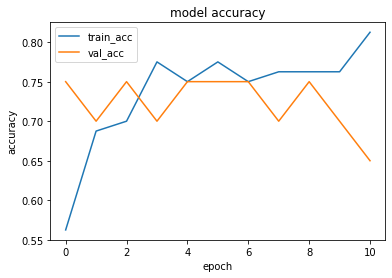

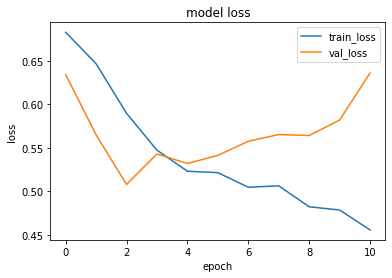

1it [00:00, 16070.13it/s]


prediction for video armflapping_1.mov is [[0.27499664]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.8754772]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.7257754]]


1it [00:00, 6177.18it/s]


prediction for video control_1.mov is [[0.24014693]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.22537398]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.22632933]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7582 - accuracy: 0.3875 - precision: 0.4182 - recall: 0.5750 - val_loss: 0.6976 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6253 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.7001 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5724 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.7122 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5930 - accuracy: 0.7375 - precision: 0.6863 - recall: 0.8750 - val_loss: 0.7521 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epo

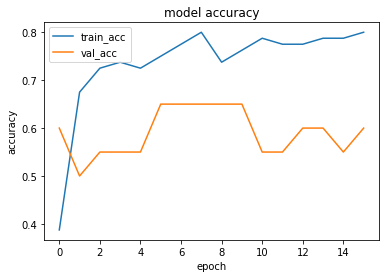

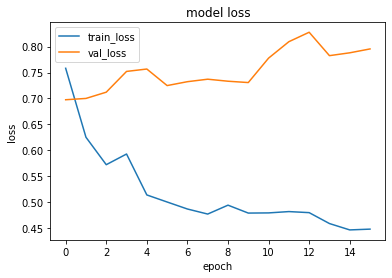

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.1846416]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5174605]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.64014053]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.1739547]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.17038223]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.17017335]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7049 - accuracy: 0.5250 - precision: 0.5143 - recall: 0.9000 - val_loss: 0.6444 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6256 - accuracy: 0.6875 - precision: 0.8000 - recall: 0.5000 - val_loss: 0.5286 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6210 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.5444 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5987 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.4951 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

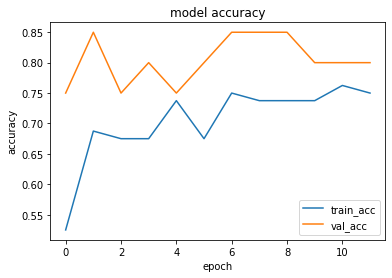

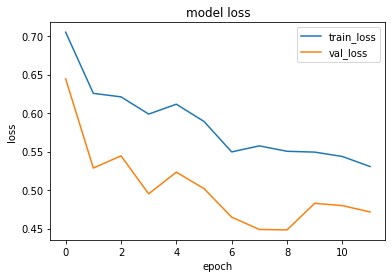

1it [00:00, 15477.14it/s]


prediction for video armflapping_1.mov is [[0.47847122]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.510662]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.6858032]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.33797196]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.31264433]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.29904377]]


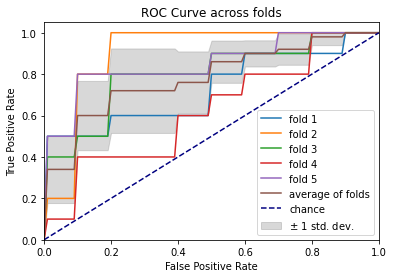

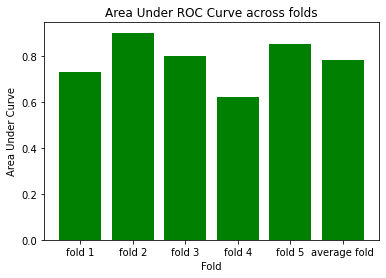

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.7217 - accuracy: 0.5625 - precision: 0.5806 - recall: 0.4500 - val_loss: 0.6361 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5819 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.6505 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5513 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6171 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5553 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5959 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 133

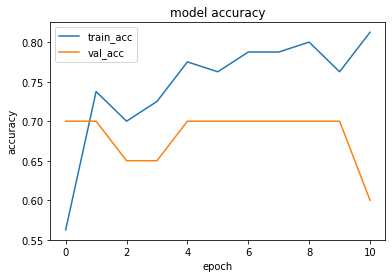

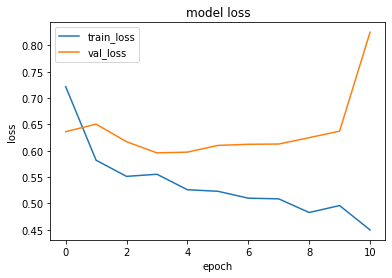

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.54962206]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.5674645]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.62590915]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.5062186]]


1it [00:00, 19599.55it/s]


prediction for video control_2.mov is [[0.48742005]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.47482702]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.8122 - accuracy: 0.4000 - precision: 0.4286 - recall: 0.6000 - val_loss: 0.7451 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6403 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.6335 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6246 - accuracy: 0.7375 - precision: 0.7879 - recall: 0.6500 - val_loss: 0.6172 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6188 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.5583 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

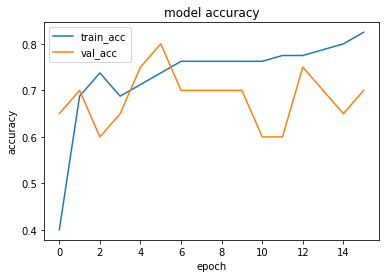

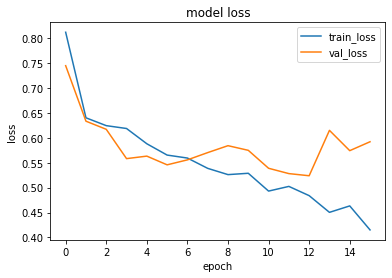

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.5901187]]


1it [00:00, 11915.64it/s]


prediction for video armflapping_3.mov is [[0.5936028]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.73128617]]


1it [00:00, 6543.38it/s]


prediction for video control_1.mov is [[0.45731482]]


1it [00:00, 13357.66it/s]


prediction for video control_2.mov is [[0.3369481]]


1it [00:00, 16320.25it/s]


prediction for video control_3.mov is [[0.37687668]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7557 - accuracy: 0.4625 - precision: 0.4634 - recall: 0.4750 - val_loss: 0.6700 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6328 - accuracy: 0.6250 - precision: 0.5806 - recall: 0.9000 - val_loss: 0.6751 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6226 - accuracy: 0.7250 - precision: 0.6800 - recall: 0.8500 - val_loss: 0.6943 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5638 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.7045 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epo

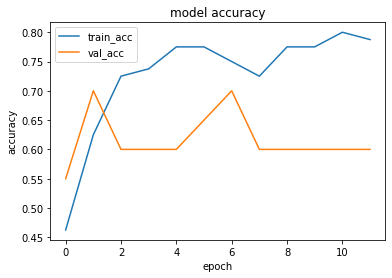

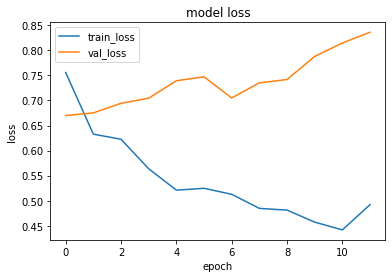

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.53489715]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.21636888]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.68999505]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.18208829]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.15549806]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.15331668]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7262 - accuracy: 0.4500 - precision: 0.4615 - recall: 0.6000 - val_loss: 0.6930 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6664 - accuracy: 0.6625 - precision: 0.6032 - recall: 0.9500 - val_loss: 0.6737 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6012 - accuracy: 0.6625 - precision: 0.6585 - recall: 0.6750 - val_loss: 0.6277 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5647 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6311 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epo

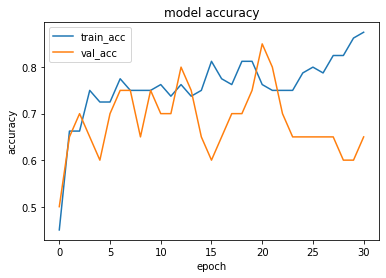

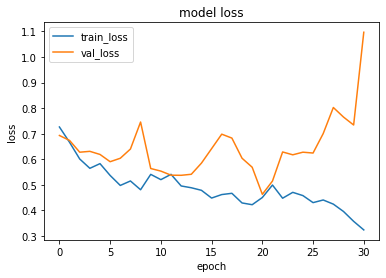

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.4526537]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.12728024]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.51335454]]


1it [00:00, 6668.21it/s]


prediction for video control_1.mov is [[0.21786192]]


1it [00:00, 18808.54it/s]


prediction for video control_2.mov is [[0.17954591]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.17336416]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.8371 - accuracy: 0.4875 - precision: 0.4918 - recall: 0.7500 - val_loss: 0.6428 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6587 - accuracy: 0.6500 - precision: 0.6579 - recall: 0.6250 - val_loss: 0.6415 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6567 - accuracy: 0.6500 - precision: 0.8333 - recall: 0.3750 - val_loss: 0.5826 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6065 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.5561 - val_accuracy: 0.7500 - val_precision: 0.8571 - val_recall: 0.6000
Epo

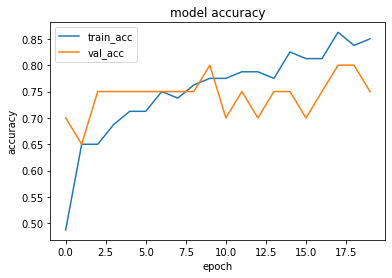

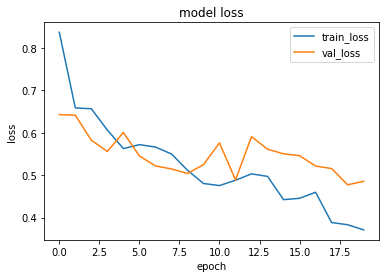

1it [00:00, 16448.25it/s]


prediction for video armflapping_1.mov is [[0.24942449]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_3.mov is [[0.2398054]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_2.mov is [[0.8166814]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.24613091]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.2448771]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.24486533]]


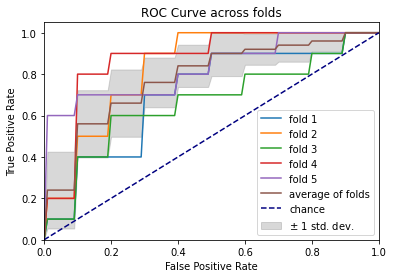

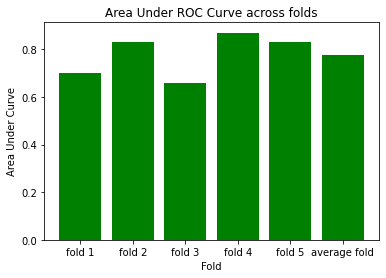

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 163ms/step - loss: 0.8418 - accuracy: 0.4750 - precision: 0.4643 - recall: 0.3250 - val_loss: 0.7381 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6158 - accuracy: 0.7000 - precision: 0.6481 - recall: 0.8750 - val_loss: 0.7695 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5855 - accuracy: 0.7625 - precision: 0.7234 - recall: 0.8500 - val_loss: 0.7757 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5285 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.7761 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 133

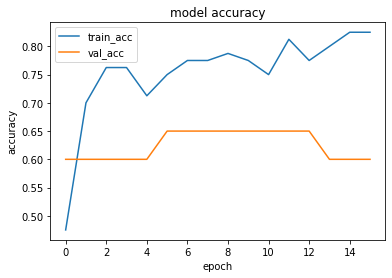

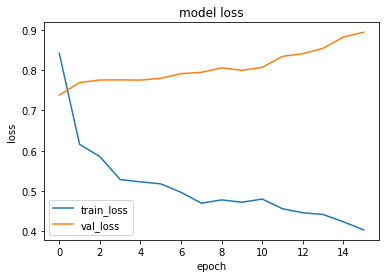

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5626335]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.5270975]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.6621251]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.31188458]]


1it [00:00, 12483.05it/s]


prediction for video control_2.mov is [[0.22557953]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.21367198]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7366 - accuracy: 0.4875 - precision: 0.4872 - recall: 0.4750 - val_loss: 0.6092 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6401 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.5768 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5939 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5103 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5717 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.4713 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

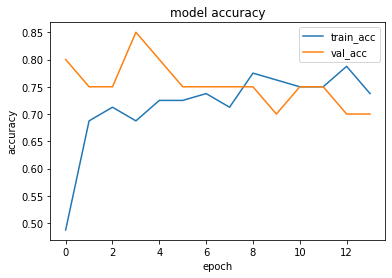

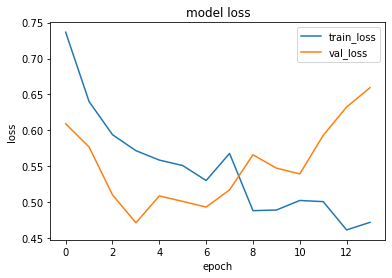

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5272404]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.59285176]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.6954109]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.27619663]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.21821585]]


1it [00:00, 16194.22it/s]


prediction for video control_3.mov is [[0.19306669]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6906 - accuracy: 0.5375 - precision: 0.5306 - recall: 0.6500 - val_loss: 0.6313 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6442 - accuracy: 0.6875 - precision: 0.7273 - recall: 0.6000 - val_loss: 0.6050 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5578 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.5906 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 143ms/step - loss: 0.5813 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.6324 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

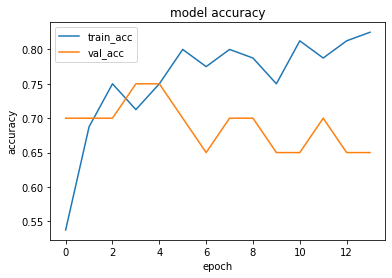

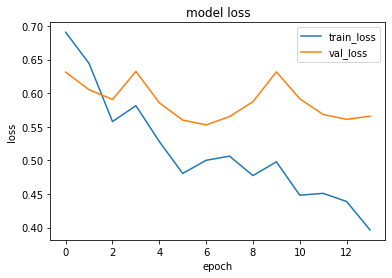

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.70814437]]


1it [00:00, 9341.43it/s]


prediction for video armflapping_3.mov is [[0.5232031]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.76846755]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.18527845]]


1it [00:00, 17189.77it/s]


prediction for video control_2.mov is [[0.16363099]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.16322348]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7016 - accuracy: 0.5750 - precision: 0.5600 - recall: 0.7000 - val_loss: 0.6540 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6117 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.6753 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5781 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.7002 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5292 - accuracy: 0.8000 - precision: 0.8158 - recall: 0.7750 - val_loss: 0.7320 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epo

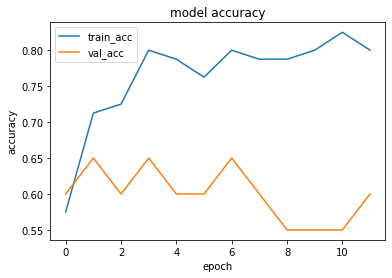

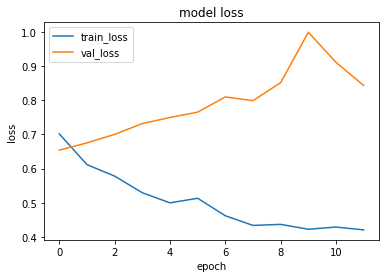

1it [00:00, 12052.60it/s]


prediction for video armflapping_1.mov is [[0.19302174]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_3.mov is [[0.4207393]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.80341125]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.14824331]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.15553331]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.15115902]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6919 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6500 - val_loss: 0.5554 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6991 - accuracy: 0.5125 - precision: 0.5116 - recall: 0.5500 - val_loss: 0.6691 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6262 - accuracy: 0.6500 - precision: 0.6875 - recall: 0.5500 - val_loss: 0.5022 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6056 - accuracy: 0.6625 - precision: 0.6383 - recall: 0.7500 - val_loss: 0.4240 - val_accuracy: 0.8500 - val_precision: 0.8889 - val_recall: 0.8000
Epo

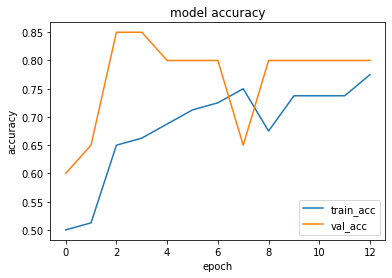

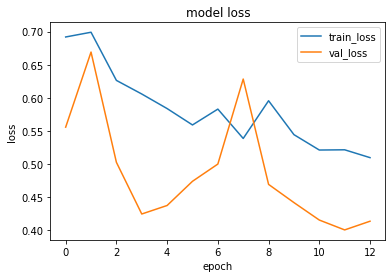

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.45811754]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_3.mov is [[0.35686594]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.78823304]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.230515]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.22321698]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.21275607]]


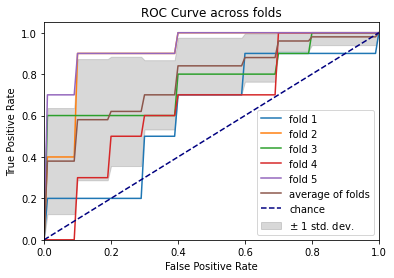

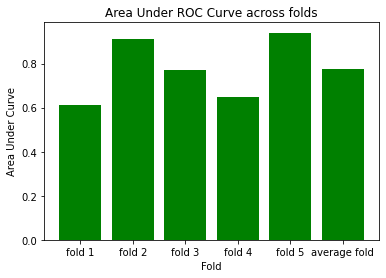

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 178ms/step - loss: 0.7613 - accuracy: 0.5250 - precision: 0.5185 - recall: 0.7000 - val_loss: 0.6742 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6059 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6843 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5726 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.8225 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5589 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.8022 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 131

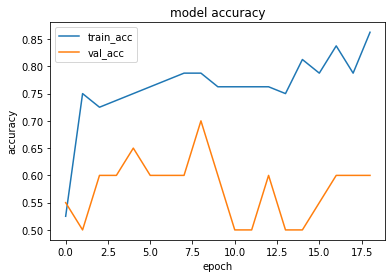

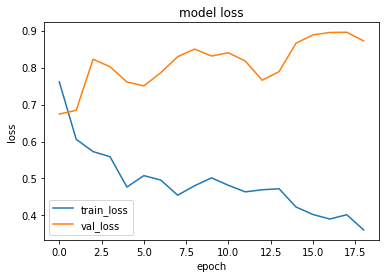

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.64130753]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.5738552]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_2.mov is [[0.73016465]]


1it [00:00, 15592.21it/s]


prediction for video control_1.mov is [[0.1360175]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.12579635]]


1it [00:00, 16578.28it/s]


prediction for video control_3.mov is [[0.12529787]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6959 - accuracy: 0.4375 - precision: 0.4490 - recall: 0.5500 - val_loss: 0.6887 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6620 - accuracy: 0.6375 - precision: 0.7200 - recall: 0.4500 - val_loss: 0.6166 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5892 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6384 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5580 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6522 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

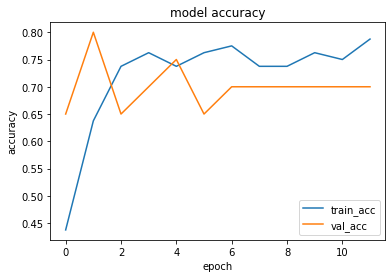

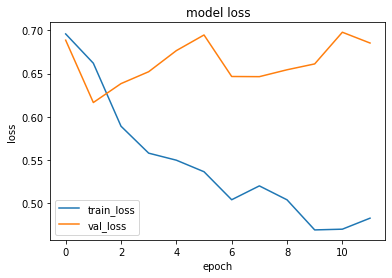

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.57170516]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_3.mov is [[0.55660444]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.66576105]]


1it [00:00, 16448.25it/s]


prediction for video control_1.mov is [[0.5094429]]


1it [00:00, 14315.03it/s]


prediction for video control_2.mov is [[0.47483632]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.47833732]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7069 - accuracy: 0.4125 - precision: 0.4186 - recall: 0.4500 - val_loss: 0.6228 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6644 - accuracy: 0.6125 - precision: 0.6098 - recall: 0.6250 - val_loss: 0.6256 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6124 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.5772 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5767 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5396 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

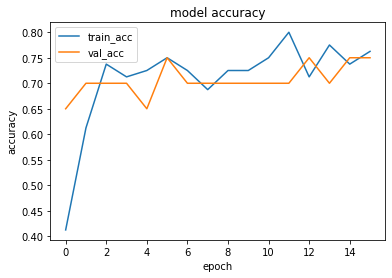

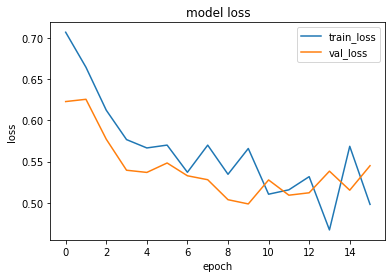

1it [00:00, 12826.62it/s]


prediction for video armflapping_1.mov is [[0.6899083]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.24378201]]


1it [00:00, 18477.11it/s]


prediction for video armflapping_2.mov is [[0.67016023]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.5231067]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.2308119]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.30625838]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 153ms/step - loss: 0.7387 - accuracy: 0.5125 - precision: 0.5172 - recall: 0.3750 - val_loss: 0.6490 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6535 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6140 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6145 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.5828 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5625 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.5437 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

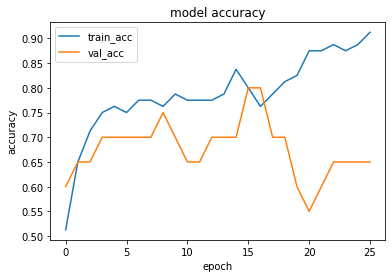

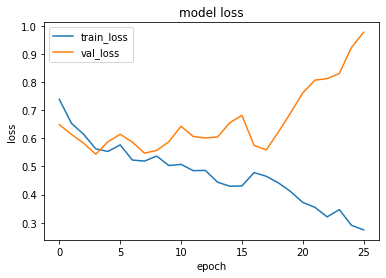

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.6145608]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.18206453]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.9611745]]


1it [00:00, 13357.66it/s]


prediction for video control_1.mov is [[0.1711159]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.21723396]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.19702819]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.8179 - accuracy: 0.4500 - precision: 0.4375 - recall: 0.3500 - val_loss: 0.6209 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6409 - accuracy: 0.5500 - precision: 0.5270 - recall: 0.9750 - val_loss: 0.5947 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6161 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.5960 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5993 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.5399 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

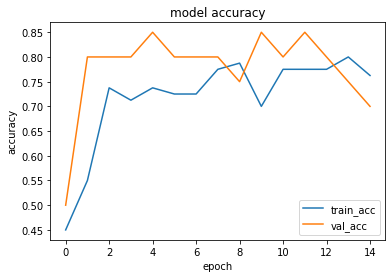

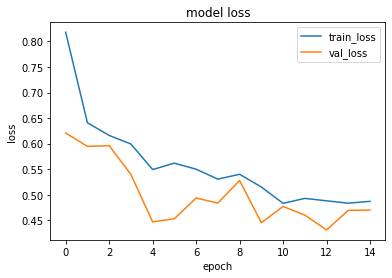

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.5504184]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.43204954]]


1it [00:00, 13357.66it/s]


prediction for video armflapping_2.mov is [[0.735059]]


1it [00:00, 14716.86it/s]


prediction for video control_1.mov is [[0.31315076]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.23290005]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.21773008]]


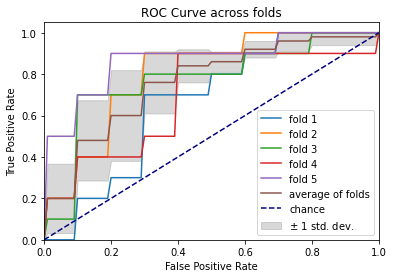

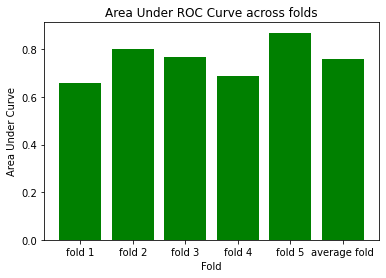

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 179ms/step - loss: 0.7093 - accuracy: 0.5125 - precision: 0.5079 - recall: 0.8000 - val_loss: 0.6163 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 215ms/step - loss: 0.6730 - accuracy: 0.6250 - precision: 0.6316 - recall: 0.6000 - val_loss: 0.5433 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6298 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.4990 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5881 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.5120 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 142

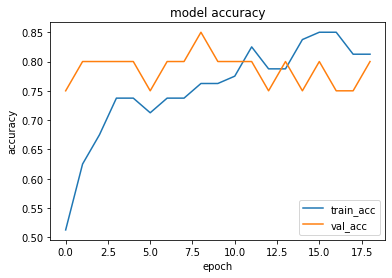

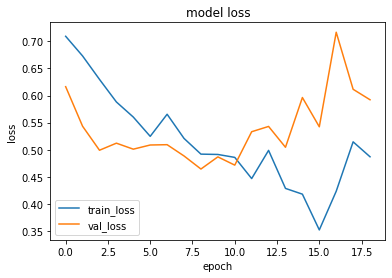

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.75674474]]


1it [00:00, 13315.25it/s]


prediction for video armflapping_3.mov is [[0.87041664]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.82041806]]


1it [00:00, 17772.47it/s]


prediction for video control_1.mov is [[0.28730297]]


1it [00:00, 12633.45it/s]


prediction for video control_2.mov is [[0.23495343]]


1it [00:00, 14716.86it/s]


prediction for video control_3.mov is [[0.23256263]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7089 - accuracy: 0.4375 - precision: 0.4419 - recall: 0.4750 - val_loss: 0.8093 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6309 - accuracy: 0.7000 - precision: 0.6429 - recall: 0.9000 - val_loss: 0.7043 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5857 - accuracy: 0.7375 - precision: 0.7714 - recall: 0.6750 - val_loss: 0.7277 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5183 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.7938 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

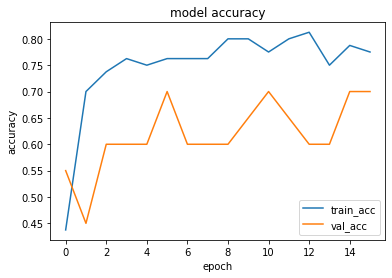

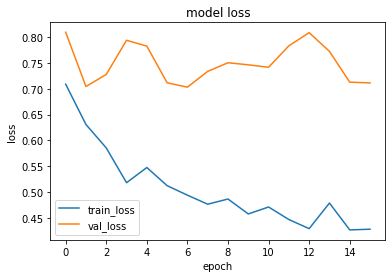

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.44316918]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_3.mov is [[0.22944123]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.57747585]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.23505169]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.21497151]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.21039936]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6864 - accuracy: 0.4875 - precision: 0.4889 - recall: 0.5500 - val_loss: 0.7275 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.1000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6474 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.6633 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5734 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.7098 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5711 - accuracy: 0.7125 - precision: 0.7576 - recall: 0.6250 - val_loss: 0.6785 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

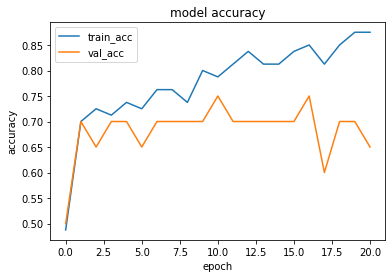

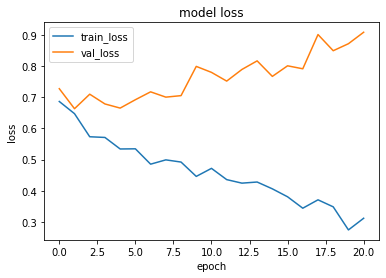

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.8200375]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_3.mov is [[0.14967194]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_2.mov is [[0.8661473]]


1it [00:00, 15420.24it/s]


prediction for video control_1.mov is [[0.30862948]]


1it [00:00, 16912.52it/s]


prediction for video control_2.mov is [[0.19542864]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.36537364]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 142ms/step - loss: 0.7251 - accuracy: 0.5750 - precision: 0.5789 - recall: 0.5500 - val_loss: 0.6254 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6415 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.5496 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6222 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.4975 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5877 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.4821 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

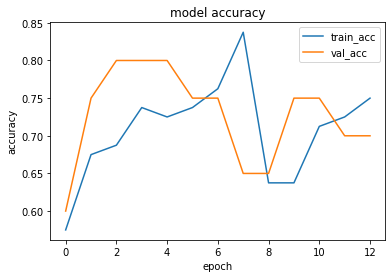

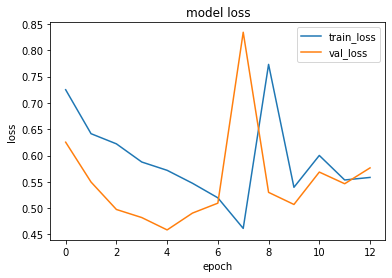

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.48425117]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.75199693]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_2.mov is [[0.56698096]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.47036913]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.4672962]]


1it [00:00, 17924.38it/s]


prediction for video control_3.mov is [[0.46707463]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7260 - accuracy: 0.5125 - precision: 0.5111 - recall: 0.5750 - val_loss: 0.7004 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6602 - accuracy: 0.6500 - precision: 0.6250 - recall: 0.7500 - val_loss: 0.6809 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5865 - accuracy: 0.7625 - precision: 0.7838 - recall: 0.7250 - val_loss: 0.6394 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5608 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6422 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

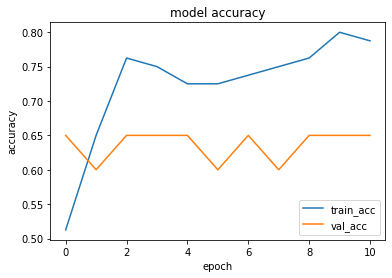

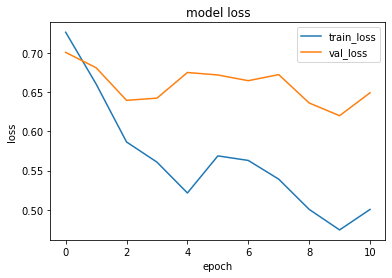

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.56623745]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.33045015]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.6994039]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.3051975]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.17502668]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.14969525]]


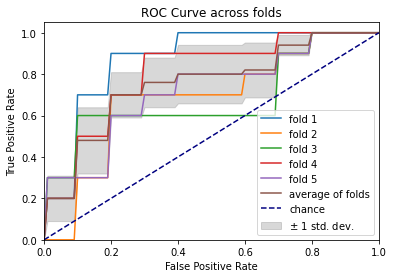

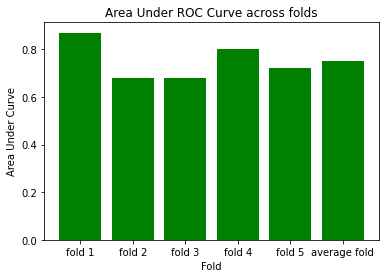

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 172ms/step - loss: 0.6639 - accuracy: 0.6375 - precision: 0.6486 - recall: 0.6000 - val_loss: 0.8730 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6492 - accuracy: 0.6500 - precision: 0.6304 - recall: 0.7250 - val_loss: 0.6187 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6147 - accuracy: 0.6625 - precision: 0.6757 - recall: 0.6250 - val_loss: 0.6855 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6135 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.6225 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 5/75
3/3 [==============================] - 0s 136

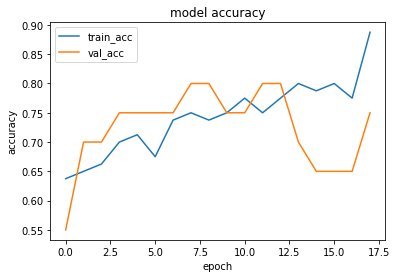

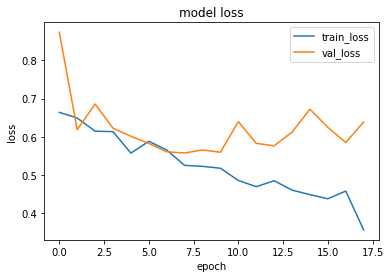

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.5368306]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.5718131]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.6616921]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.38817644]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.3246028]]


1it [00:00, 18236.10it/s]


prediction for video control_3.mov is [[0.29026055]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6909 - accuracy: 0.5750 - precision: 0.5536 - recall: 0.7750 - val_loss: 0.6825 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6238 - accuracy: 0.6750 - precision: 0.6296 - recall: 0.8500 - val_loss: 0.6459 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5780 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.6172 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5472 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.6341 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

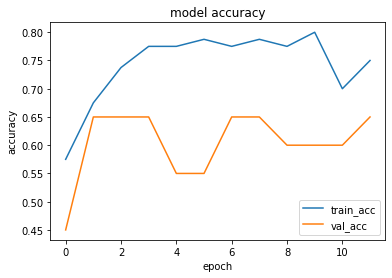

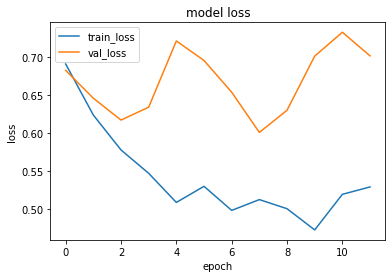

1it [00:00, 16710.37it/s]


prediction for video armflapping_1.mov is [[0.3243272]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.20435175]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_2.mov is [[0.5501877]]


1it [00:00, 18157.16it/s]


prediction for video control_1.mov is [[0.2843284]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2685407]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.26921332]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7797 - accuracy: 0.4750 - precision: 0.4688 - recall: 0.3750 - val_loss: 0.6210 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.7075 - accuracy: 0.6000 - precision: 0.5625 - recall: 0.9000 - val_loss: 0.6334 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6432 - accuracy: 0.6500 - precision: 0.6304 - recall: 0.7250 - val_loss: 0.6159 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6122 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.6083 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

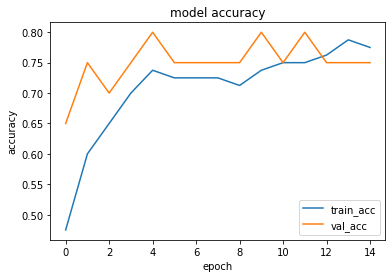

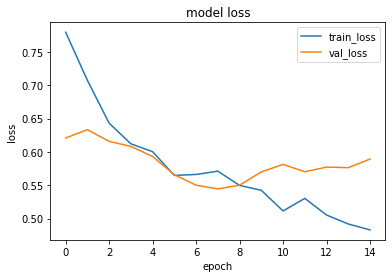

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.75337625]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_3.mov is [[0.64508724]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.8262981]]


1it [00:00, 20068.44it/s]


prediction for video control_1.mov is [[0.39091942]]


1it [00:00, 12052.60it/s]


prediction for video control_2.mov is [[0.4245962]]


1it [00:00, 17476.27it/s]


prediction for video control_3.mov is [[0.1861107]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7023 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.8500 - val_loss: 0.6644 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6630 - accuracy: 0.6500 - precision: 0.8000 - recall: 0.4000 - val_loss: 0.6543 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6001 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.6371 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5625 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5920 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoc

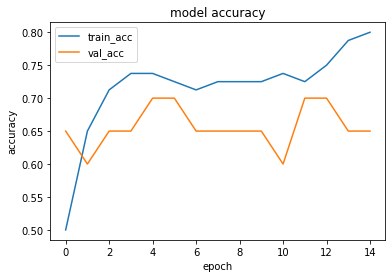

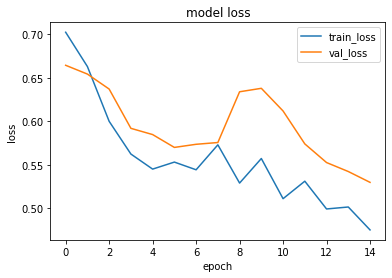

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.6362949]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.3989783]]


1it [00:00, 14873.42it/s]


prediction for video armflapping_2.mov is [[0.7954407]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.34882018]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.2465924]]


1it [00:00, 18641.35it/s]


prediction for video control_3.mov is [[0.18654048]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7333 - accuracy: 0.4500 - precision: 0.4643 - recall: 0.6500 - val_loss: 0.6748 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6725 - accuracy: 0.5750 - precision: 0.5500 - recall: 0.8250 - val_loss: 0.6439 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6128 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.6781 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6058 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.6532 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

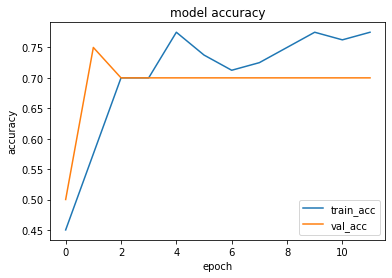

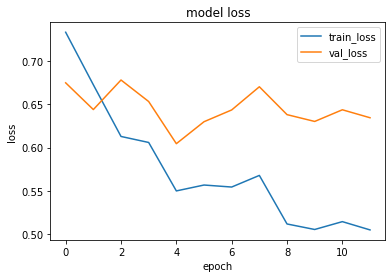

1it [00:00, 10727.12it/s]


prediction for video armflapping_1.mov is [[0.38567168]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.30061698]]


1it [00:00, 16448.25it/s]


prediction for video armflapping_2.mov is [[0.7265495]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.25499535]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.19492486]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.21300119]]


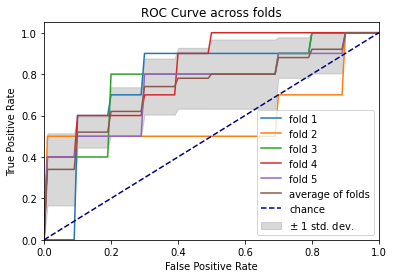

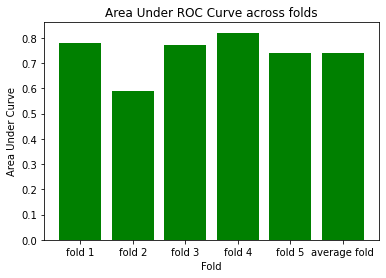

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 172ms/step - loss: 0.8820 - accuracy: 0.4000 - precision: 0.2143 - recall: 0.0750 - val_loss: 0.7211 - val_accuracy: 0.4500 - val_precision: 0.4667 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 1s 213ms/step - loss: 0.6469 - accuracy: 0.5250 - precision: 0.5152 - recall: 0.8500 - val_loss: 0.7069 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6140 - accuracy: 0.6500 - precision: 0.5968 - recall: 0.9250 - val_loss: 0.6794 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5874 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.6655 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 131

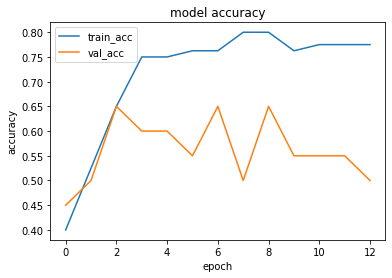

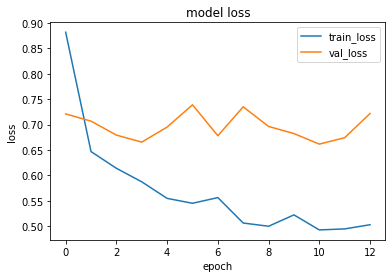

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.58692914]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.4771288]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.6788965]]


1it [00:00, 6335.81it/s]


prediction for video control_1.mov is [[0.51138794]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.440593]]


1it [00:00, 16070.13it/s]


prediction for video control_3.mov is [[0.46369088]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6774 - accuracy: 0.6000 - precision: 0.6250 - recall: 0.5000 - val_loss: 0.8168 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.7113 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.6047 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6062 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6089 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5411 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.7873 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epo

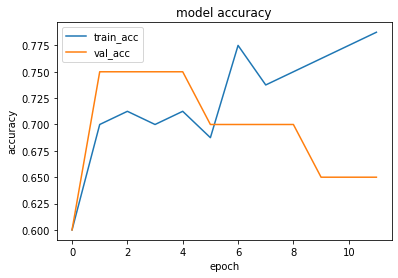

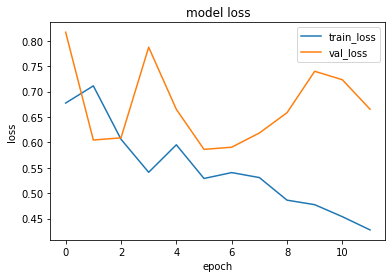

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.48529726]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.54655665]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_2.mov is [[0.55054337]]


1it [00:00, 15196.75it/s]


prediction for video control_1.mov is [[0.44701412]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.43343452]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.43159387]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.7045 - accuracy: 0.6000 - precision: 0.6000 - recall: 0.6000 - val_loss: 0.5746 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6712 - accuracy: 0.6125 - precision: 0.5849 - recall: 0.7750 - val_loss: 0.5225 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6071 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.4932 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5796 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.4845 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

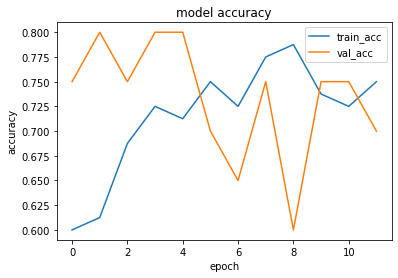

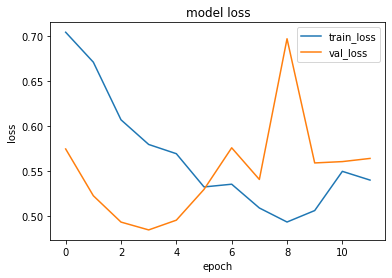

1it [00:00, 12710.01it/s]


prediction for video armflapping_1.mov is [[0.5740332]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.65853393]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7190661]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.4595676]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.40289342]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.3753635]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7810 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.7250 - val_loss: 0.6736 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6563 - accuracy: 0.6375 - precision: 0.7895 - recall: 0.3750 - val_loss: 0.6331 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6086 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.6051 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6005 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.5599 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoc

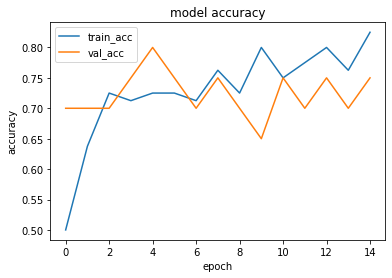

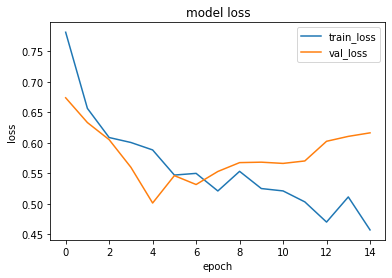

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5820609]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.26109773]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_2.mov is [[0.8577941]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.2819992]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.28004366]]


1it [00:00, 14266.34it/s]


prediction for video control_3.mov is [[0.27597272]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6632 - accuracy: 0.6250 - precision: 0.6042 - recall: 0.7250 - val_loss: 0.6916 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6275 - accuracy: 0.6875 - precision: 0.8261 - recall: 0.4750 - val_loss: 0.6677 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5930 - accuracy: 0.7250 - precision: 0.6957 - recall: 0.8000 - val_loss: 0.6724 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5291 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6548 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

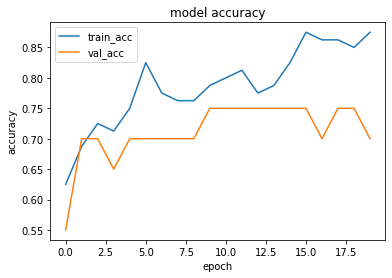

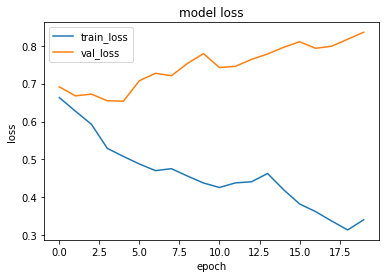

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.8113241]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.57345015]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.90743345]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.6697319]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.33220166]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.33383557]]


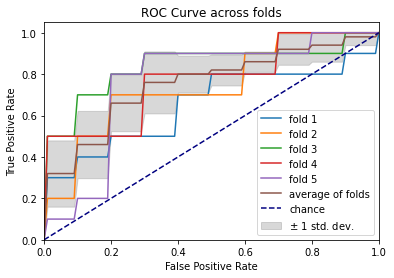

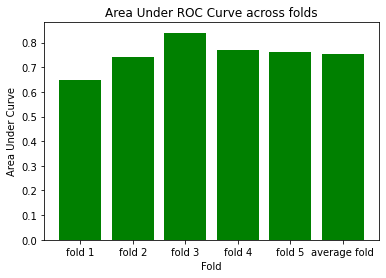

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 168ms/step - loss: 0.6536 - accuracy: 0.4750 - precision: 0.4815 - recall: 0.6500 - val_loss: 0.8567 - val_accuracy: 0.4500 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6722 - accuracy: 0.5750 - precision: 0.7143 - recall: 0.2500 - val_loss: 0.7507 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5604 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7069 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5741 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.7076 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] 

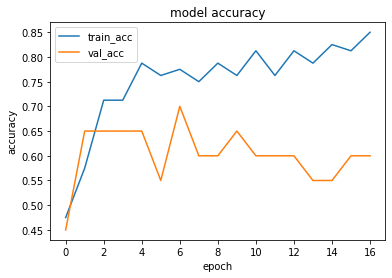

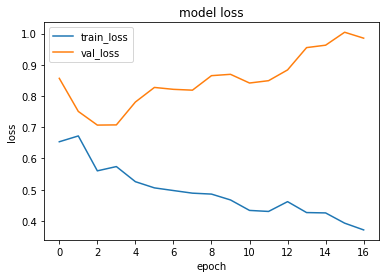

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.76760036]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_3.mov is [[0.7437505]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.8232071]]


1it [00:00, 12018.06it/s]


prediction for video control_1.mov is [[0.52289945]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.27112883]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.36257747]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 139ms/step - loss: 0.8133 - accuracy: 0.4750 - precision: 0.4815 - recall: 0.6500 - val_loss: 0.6427 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6332 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.5936 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5889 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.6543 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5606 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6709 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

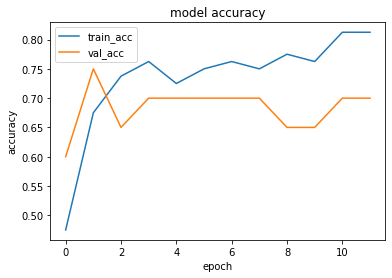

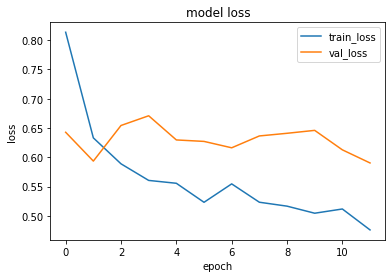

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.5655635]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.5041859]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.6083668]]


1it [00:00, 4609.13it/s]


prediction for video control_1.mov is [[0.3934017]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.28563073]]


1it [00:00, 16384.00it/s]


prediction for video control_3.mov is [[0.28331196]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 147ms/step - loss: 0.7063 - accuracy: 0.4625 - precision: 0.4595 - recall: 0.4250 - val_loss: 0.6169 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6478 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.5487 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6129 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.4984 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5633 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.5446 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

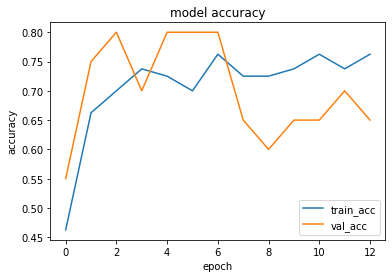

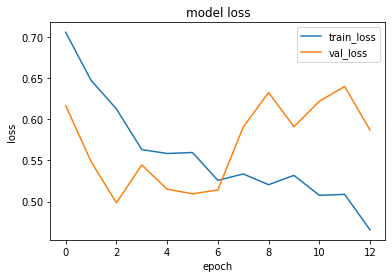

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.47142234]]


1it [00:00, 17549.39it/s]


prediction for video armflapping_3.mov is [[0.46306226]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.6957264]]


1it [00:00, 13842.59it/s]


prediction for video control_1.mov is [[0.39962274]]


1it [00:00, 18893.26it/s]


prediction for video control_2.mov is [[0.31484762]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.3585658]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 157ms/step - loss: 0.6754 - accuracy: 0.5625 - precision: 0.5581 - recall: 0.6000 - val_loss: 0.6021 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5878 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.5936 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6373 - accuracy: 0.6375 - precision: 0.7037 - recall: 0.4750 - val_loss: 0.5992 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5321 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6003 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoc

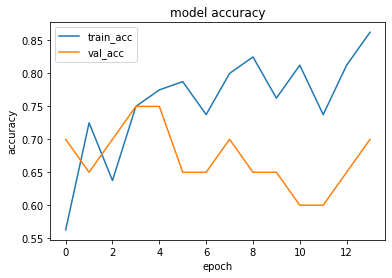

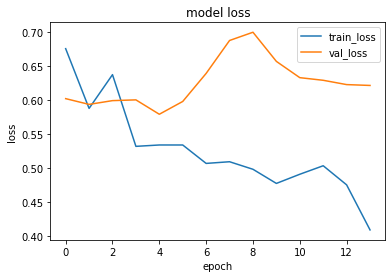

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.8051077]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.5669978]]


1it [00:00, 15196.75it/s]


prediction for video armflapping_2.mov is [[0.8048341]]


1it [00:00, 1837.99it/s]


prediction for video control_1.mov is [[0.17253035]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.15234822]]


1it [00:00, 19328.59it/s]


prediction for video control_3.mov is [[0.15396875]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6676 - accuracy: 0.5250 - precision: 0.5217 - recall: 0.6000 - val_loss: 0.7786 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6350 - accuracy: 0.6625 - precision: 0.6066 - recall: 0.9250 - val_loss: 0.6909 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5938 - accuracy: 0.7125 - precision: 0.8400 - recall: 0.5250 - val_loss: 0.7875 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5827 - accuracy: 0.7250 - precision: 0.8214 - recall: 0.5750 - val_loss: 0.8003 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epo

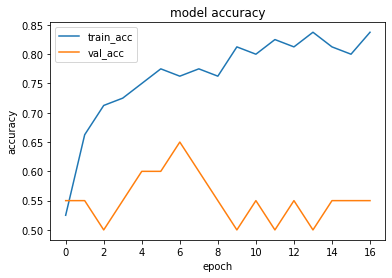

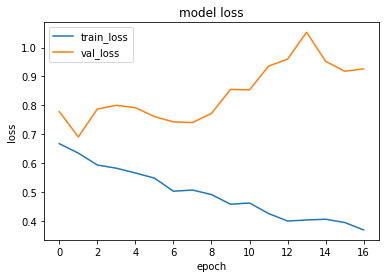

1it [00:00, 15827.56it/s]


prediction for video armflapping_1.mov is [[0.42800355]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.72286654]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_2.mov is [[0.91600466]]


1it [00:00, 14513.16it/s]


prediction for video control_1.mov is [[0.27275783]]


1it [00:00, 16131.94it/s]


prediction for video control_2.mov is [[0.22510737]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.22836083]]


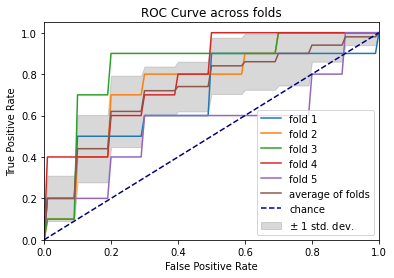

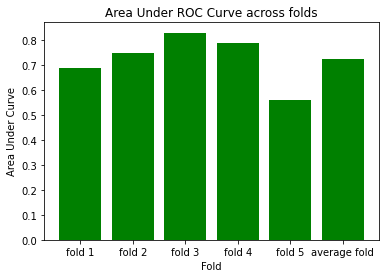

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 171ms/step - loss: 0.7942 - accuracy: 0.4625 - precision: 0.3846 - recall: 0.1250 - val_loss: 0.7001 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.7279 - accuracy: 0.5125 - precision: 0.5063 - recall: 1.0000 - val_loss: 0.6846 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6684 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.6427 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6353 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6299 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 131

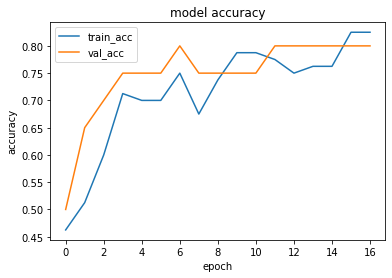

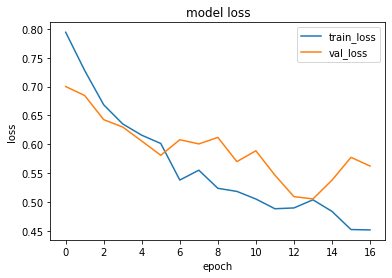

1it [00:00, 16980.99it/s]


prediction for video armflapping_1.mov is [[0.42911303]]


1it [00:00, 15827.56it/s]


prediction for video armflapping_3.mov is [[0.32032794]]


1it [00:00, 15087.42it/s]


prediction for video armflapping_2.mov is [[0.6437932]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.29578277]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.21070904]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.21700954]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.9181 - accuracy: 0.4625 - precision: 0.4754 - recall: 0.7250 - val_loss: 0.6214 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.7053 - accuracy: 0.5625 - precision: 0.5676 - recall: 0.5250 - val_loss: 0.6880 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6582 - accuracy: 0.6625 - precision: 0.7241 - recall: 0.5250 - val_loss: 0.6690 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6125 - accuracy: 0.6625 - precision: 0.6444 - recall: 0.7250 - val_loss: 0.6478 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epo

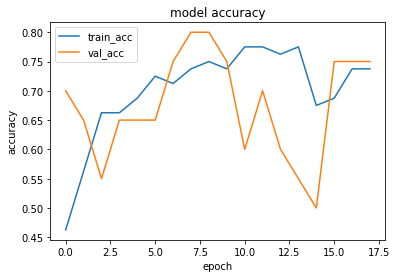

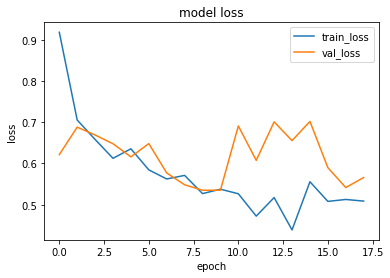

1it [00:00, 14463.12it/s]


prediction for video armflapping_1.mov is [[0.5549092]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_3.mov is [[0.41941378]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.67633337]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.394687]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.3319391]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.30981314]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7010 - accuracy: 0.6125 - precision: 0.5763 - recall: 0.8500 - val_loss: 0.7287 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6357 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.6559 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6251 - accuracy: 0.6250 - precision: 0.7273 - recall: 0.4000 - val_loss: 0.6263 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6097 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.5714 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epo

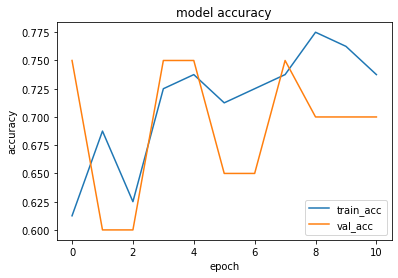

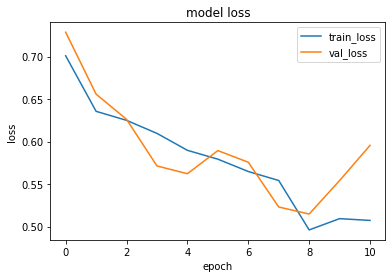

1it [00:00, 14665.40it/s]


prediction for video armflapping_1.mov is [[0.3541842]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.33152366]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.62850744]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.29215252]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.26875347]]


1it [00:00, 12985.46it/s]


prediction for video control_3.mov is [[0.26946664]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6679 - accuracy: 0.6000 - precision: 0.5952 - recall: 0.6250 - val_loss: 0.6885 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5801 - accuracy: 0.7375 - precision: 0.7111 - recall: 0.8000 - val_loss: 0.7270 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 155ms/step - loss: 0.5678 - accuracy: 0.7625 - precision: 0.7838 - recall: 0.7250 - val_loss: 0.7428 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5347 - accuracy: 0.7125 - precision: 0.8400 - recall: 0.5250 - val_loss: 0.7464 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

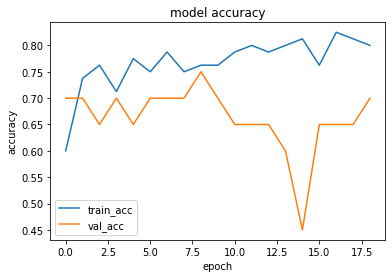

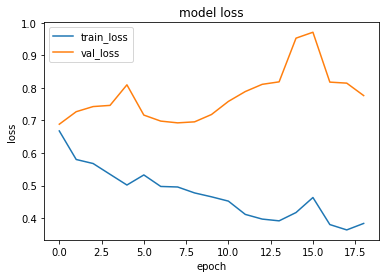

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.302185]]


1it [00:00, 19599.55it/s]


prediction for video armflapping_3.mov is [[0.23696351]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.33732513]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.20922258]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.2617036]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.2589832]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 141ms/step - loss: 0.7252 - accuracy: 0.5125 - precision: 0.5098 - recall: 0.6500 - val_loss: 0.6261 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6303 - accuracy: 0.7125 - precision: 0.6809 - recall: 0.8000 - val_loss: 0.6029 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5816 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.6949 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5504 - accuracy: 0.7500 - precision: 0.7083 - recall: 0.8500 - val_loss: 0.6993 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoc

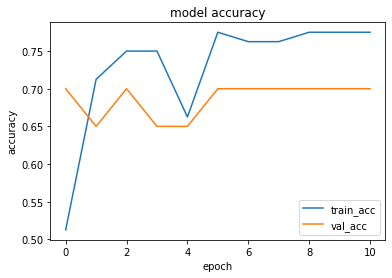

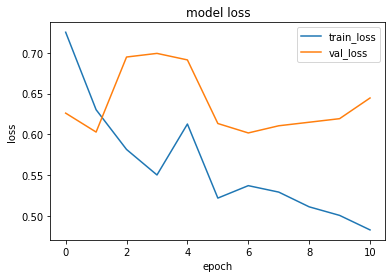

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.6837776]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.511066]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.80339885]]


1it [00:00, 5497.12it/s]


prediction for video control_1.mov is [[0.47029448]]


1it [00:00, 18558.87it/s]


prediction for video control_2.mov is [[0.26023376]]


1it [00:00, 14873.42it/s]


prediction for video control_3.mov is [[0.20321566]]


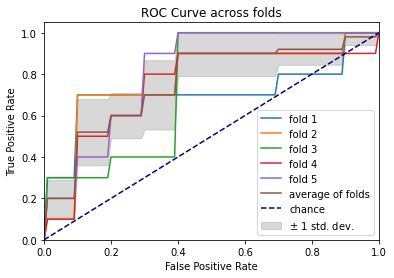

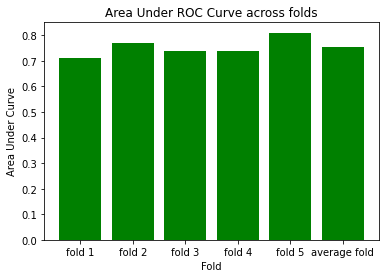

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6540 - accuracy: 0.5625 - precision: 0.5472 - recall: 0.7250 - val_loss: 0.7181 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6161 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5167 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6048 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.4795 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5803 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5066 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 130

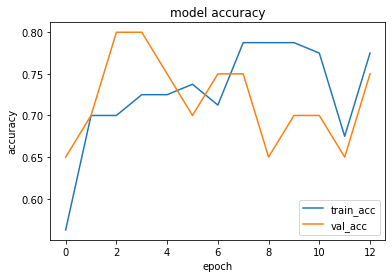

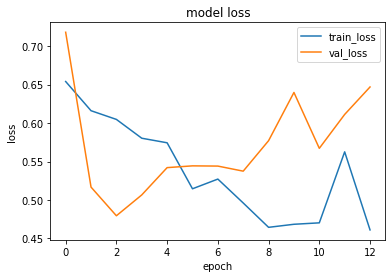

1it [00:00, 16131.94it/s]


prediction for video armflapping_1.mov is [[0.5005607]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.51709086]]


1it [00:00, 17189.77it/s]


prediction for video armflapping_2.mov is [[0.638294]]


1it [00:00, 14768.68it/s]


prediction for video control_1.mov is [[0.39535752]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.31658715]]


1it [00:00, 19599.55it/s]


prediction for video control_3.mov is [[0.31857067]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7258 - accuracy: 0.5875 - precision: 0.5854 - recall: 0.6000 - val_loss: 0.6759 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6712 - accuracy: 0.6125 - precision: 0.5672 - recall: 0.9500 - val_loss: 0.6233 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5852 - accuracy: 0.7500 - precision: 0.7381 - recall: 0.7750 - val_loss: 0.6344 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 151ms/step - loss: 0.5922 - accuracy: 0.7000 - precision: 0.6905 - recall: 0.7250 - val_loss: 0.7817 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

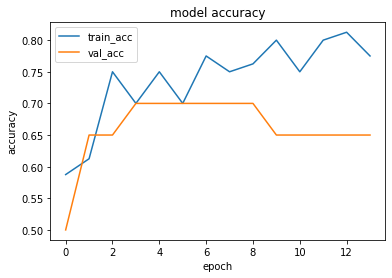

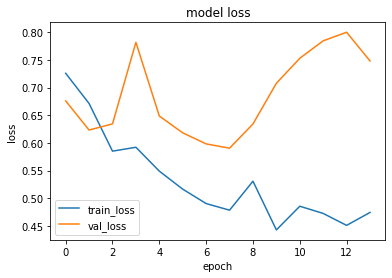

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.7259474]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.2408604]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_2.mov is [[0.8482103]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.4052769]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.14771792]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.14413777]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 150ms/step - loss: 0.7158 - accuracy: 0.6375 - precision: 0.5965 - recall: 0.8500 - val_loss: 0.6606 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6115 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.6723 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5433 - accuracy: 0.7375 - precision: 0.7317 - recall: 0.7500 - val_loss: 0.6750 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5874 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.7126 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

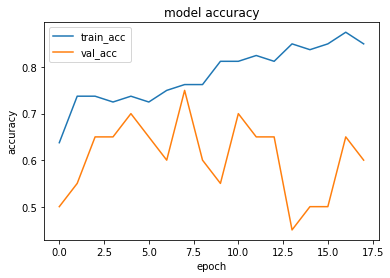

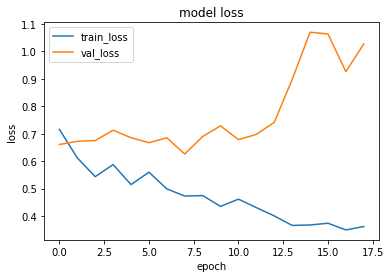

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.30123755]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_3.mov is [[0.6114082]]


1it [00:00, 14027.77it/s]


prediction for video armflapping_2.mov is [[0.3500749]]


1it [00:00, 15477.14it/s]


prediction for video control_1.mov is [[0.30825233]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.3094766]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.31009632]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6789 - accuracy: 0.4625 - precision: 0.4706 - recall: 0.6000 - val_loss: 0.8076 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5719 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.8983 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5467 - accuracy: 0.7500 - precision: 0.7174 - recall: 0.8250 - val_loss: 0.7839 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5597 - accuracy: 0.6750 - precision: 0.7917 - recall: 0.4750 - val_loss: 0.7680 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

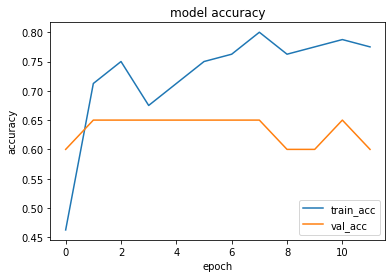

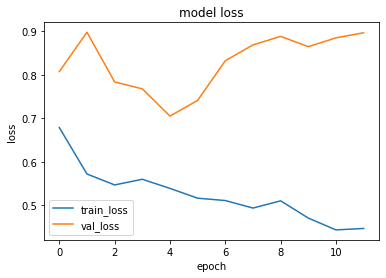

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.48320162]]


1it [00:00, 12787.51it/s]


prediction for video armflapping_3.mov is [[0.20866162]]


1it [00:00, 14716.86it/s]


prediction for video armflapping_2.mov is [[0.6614302]]


1it [00:00, 5236.33it/s]


prediction for video control_1.mov is [[0.31340757]]


1it [00:00, 12228.29it/s]


prediction for video control_2.mov is [[0.2330052]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.23669317]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7577 - accuracy: 0.4875 - precision: 0.4857 - recall: 0.4250 - val_loss: 0.6174 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.7140 - accuracy: 0.6375 - precision: 0.6078 - recall: 0.7750 - val_loss: 0.6053 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6504 - accuracy: 0.6625 - precision: 0.6512 - recall: 0.7000 - val_loss: 0.5781 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6236 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.5357 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epo

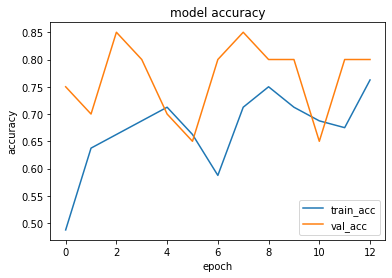

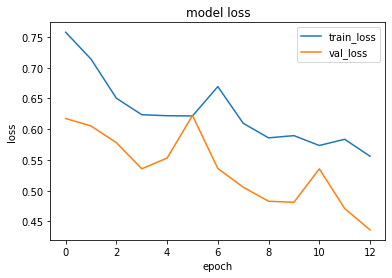

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.49186757]]


1it [00:00, 16980.99it/s]


prediction for video armflapping_3.mov is [[0.51970947]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_2.mov is [[0.56701237]]


1it [00:00, 14315.03it/s]


prediction for video control_1.mov is [[0.45921788]]


1it [00:00, 17476.27it/s]


prediction for video control_2.mov is [[0.43591827]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.44252566]]


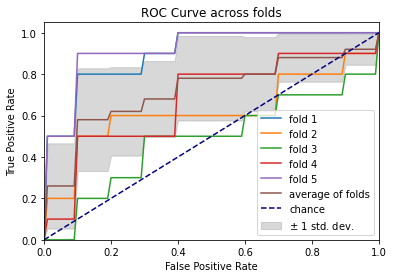

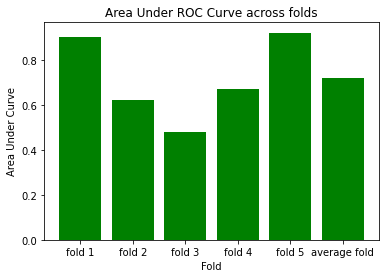

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 169ms/step - loss: 0.6599 - accuracy: 0.4750 - precision: 0.4762 - recall: 0.5000 - val_loss: 0.7925 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6310 - accuracy: 0.7625 - precision: 0.7143 - recall: 0.8750 - val_loss: 0.7046 - val_accuracy: 0.5500 - val_precision: 0.6667 - val_recall: 0.2000
Epoch 3/75
3/3 [==============================] - 0s 139ms/step - loss: 0.7361 - accuracy: 0.5500 - precision: 0.7000 - recall: 0.1750 - val_loss: 0.6355 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5718 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.6297 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 130

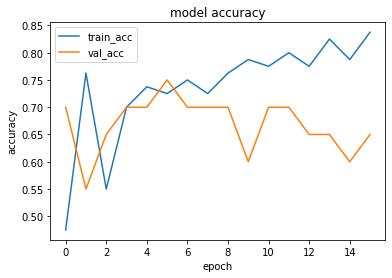

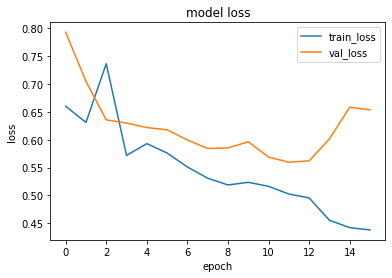

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.51533145]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.42110363]]


1it [00:00, 16070.13it/s]


prediction for video armflapping_2.mov is [[0.64493454]]


1it [00:00, 16578.28it/s]


prediction for video control_1.mov is [[0.40933058]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.2962499]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.33691552]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 140ms/step - loss: 0.7247 - accuracy: 0.5875 - precision: 0.5946 - recall: 0.5500 - val_loss: 0.5606 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6737 - accuracy: 0.6875 - precision: 0.6667 - recall: 0.7500 - val_loss: 0.5603 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.6023 - accuracy: 0.7125 - precision: 0.7429 - recall: 0.6500 - val_loss: 0.5116 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6182 - accuracy: 0.7375 - precision: 0.7209 - recall: 0.7750 - val_loss: 0.5038 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epo

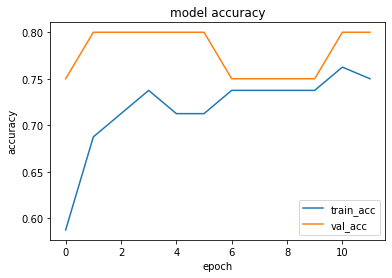

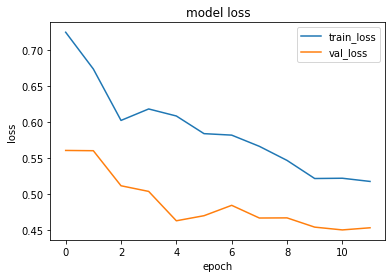

1it [00:00, 17189.77it/s]


prediction for video armflapping_1.mov is [[0.527033]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.498734]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.56110823]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.48056147]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.44525102]]


1it [00:00, 16644.06it/s]


prediction for video control_3.mov is [[0.43678614]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6640 - accuracy: 0.6250 - precision: 0.6190 - recall: 0.6500 - val_loss: 0.6208 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6644 - accuracy: 0.6750 - precision: 0.6346 - recall: 0.8250 - val_loss: 0.6000 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6183 - accuracy: 0.6500 - precision: 0.7143 - recall: 0.5000 - val_loss: 0.6124 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5833 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5921 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epo

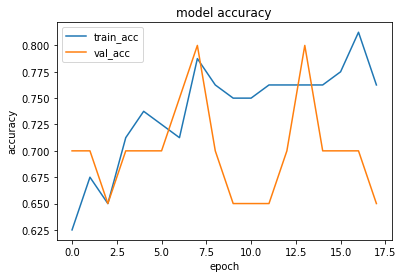

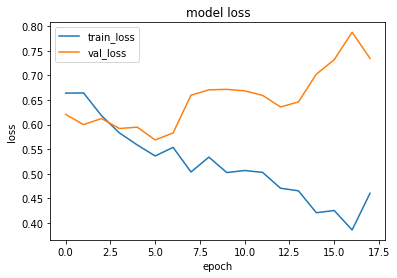

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.29640958]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.43259355]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.2745465]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.28168774]]


1it [00:00, 17476.27it/s]


prediction for video control_2.mov is [[0.27329907]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.27082503]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.6803 - accuracy: 0.6125 - precision: 0.5882 - recall: 0.7500 - val_loss: 0.7351 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.5679 - accuracy: 0.6875 - precision: 0.6596 - recall: 0.7750 - val_loss: 0.6961 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5451 - accuracy: 0.7875 - precision: 0.7949 - recall: 0.7750 - val_loss: 0.7482 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.4745 - accuracy: 0.7625 - precision: 0.8000 - recall: 0.7000 - val_loss: 0.9195 - val_accuracy: 0.5500 - val_precision: 0.6000 - val_recall: 0.3000
Epo

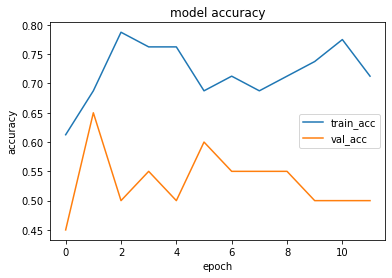

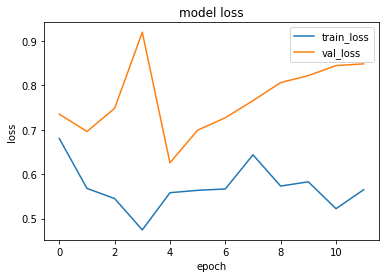

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.21465302]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_3.mov is [[0.13523823]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.546712]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.19030109]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.18475616]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.18412977]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.7139 - accuracy: 0.6375 - precision: 0.6486 - recall: 0.6000 - val_loss: 0.5812 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6027 - accuracy: 0.6875 - precision: 0.6829 - recall: 0.7000 - val_loss: 0.5464 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5682 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.5365 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5440 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.5551 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epo

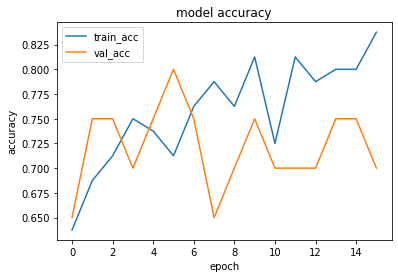

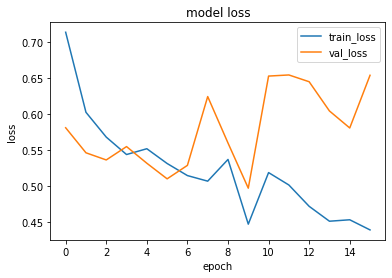

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.66113657]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.8314713]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.8848616]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.43698776]]


1it [00:00, 14926.35it/s]


prediction for video control_2.mov is [[0.40443876]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.3249861]]


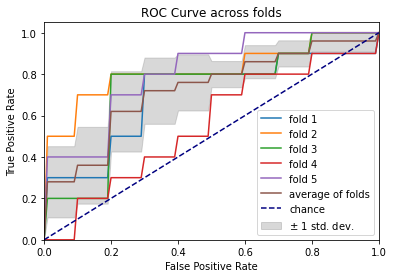

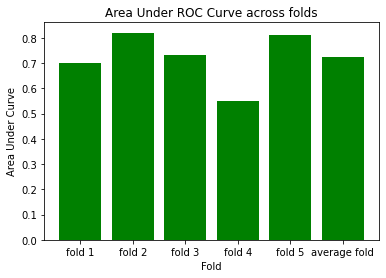

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 172ms/step - loss: 0.7518 - accuracy: 0.6125 - precision: 0.6000 - recall: 0.6750 - val_loss: 0.7001 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 150ms/step - loss: 0.6059 - accuracy: 0.7875 - precision: 0.8286 - recall: 0.7250 - val_loss: 0.7076 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5513 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.8195 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.5097 - accuracy: 0.7750 - precision: 0.7895 - recall: 0.7500 - val_loss: 0.8932 - val_accuracy: 0.4500 - val_precision: 0.4444 - val_recall: 0.4000
Epoch 5/75
3/3 [==============================] - 0s 146

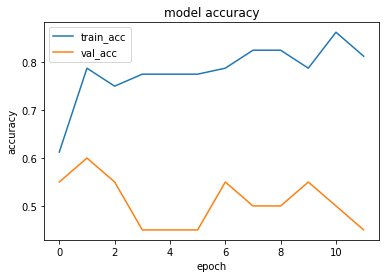

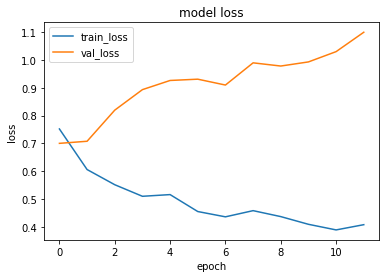

1it [00:00, 11915.64it/s]


prediction for video armflapping_1.mov is [[0.58365047]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_3.mov is [[0.49791825]]


1it [00:00, 13888.42it/s]


prediction for video armflapping_2.mov is [[0.6395846]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.49455076]]


1it [00:00, 14768.68it/s]


prediction for video control_2.mov is [[0.45230103]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.41881284]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7079 - accuracy: 0.5375 - precision: 0.5306 - recall: 0.6500 - val_loss: 0.5982 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6438 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.5673 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.6269 - accuracy: 0.6625 - precision: 0.7097 - recall: 0.5500 - val_loss: 0.5000 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5856 - accuracy: 0.6875 - precision: 0.7143 - recall: 0.6250 - val_loss: 0.4473 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

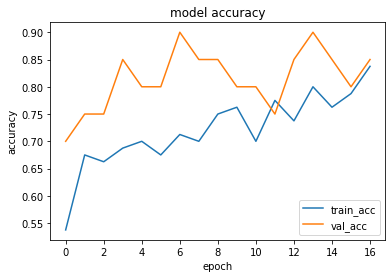

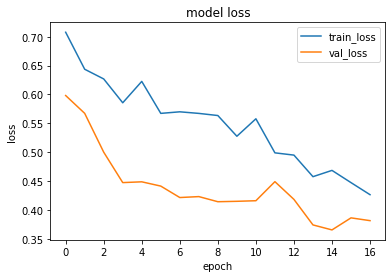

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.53941625]]


1it [00:00, 19239.93it/s]


prediction for video armflapping_3.mov is [[0.5514244]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6454668]]


1it [00:00, 15650.39it/s]


prediction for video control_1.mov is [[0.36506143]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.3317613]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.32854116]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7076 - accuracy: 0.5625 - precision: 0.5439 - recall: 0.7750 - val_loss: 0.7538 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6210 - accuracy: 0.6750 - precision: 0.7500 - recall: 0.5250 - val_loss: 0.7286 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5522 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.7509 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5567 - accuracy: 0.7375 - precision: 0.7021 - recall: 0.8250 - val_loss: 0.7858 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

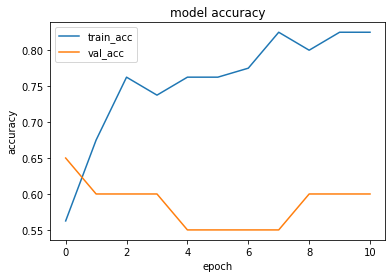

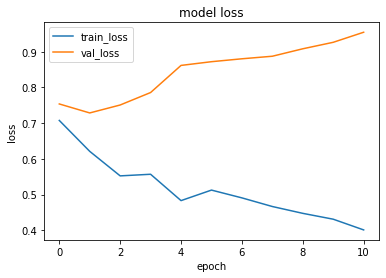

1it [00:00, 14266.34it/s]


prediction for video armflapping_1.mov is [[0.4704786]]


1it [00:00, 18558.87it/s]


prediction for video armflapping_3.mov is [[0.05975991]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.7662326]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.23980707]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.21992889]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.22181383]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 152ms/step - loss: 0.8098 - accuracy: 0.4875 - precision: 0.4839 - recall: 0.3750 - val_loss: 0.6175 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6593 - accuracy: 0.6000 - precision: 0.5645 - recall: 0.8750 - val_loss: 0.5933 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6267 - accuracy: 0.6750 - precision: 0.6458 - recall: 0.7750 - val_loss: 0.5589 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6028 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.5289 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

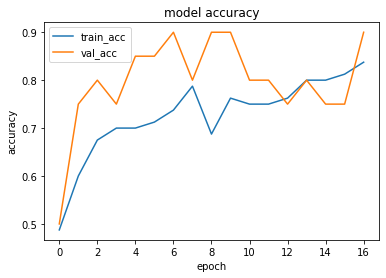

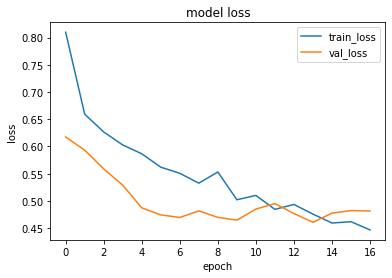

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.64726955]]


1it [00:00, 17260.51it/s]


prediction for video armflapping_3.mov is [[0.52458715]]


1it [00:00, 14266.34it/s]


prediction for video armflapping_2.mov is [[0.7614808]]


1it [00:00, 14926.35it/s]


prediction for video control_1.mov is [[0.15807074]]


1it [00:00, 19972.88it/s]


prediction for video control_2.mov is [[0.15486151]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.15633121]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 155ms/step - loss: 0.7461 - accuracy: 0.5375 - precision: 0.5405 - recall: 0.5000 - val_loss: 0.6298 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6382 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.5904 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6187 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.5536 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5832 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.4766 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epo

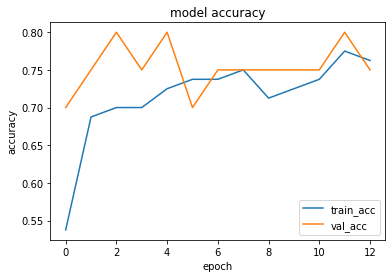

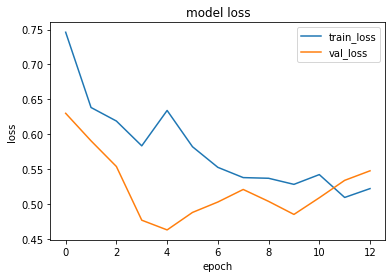

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.3667642]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.6088945]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.8621253]]


1it [00:00, 6061.13it/s]


prediction for video control_1.mov is [[0.28590095]]


1it [00:00, 17924.38it/s]


prediction for video control_2.mov is [[0.26153594]]


1it [00:00, 14463.12it/s]


prediction for video control_3.mov is [[0.25970128]]


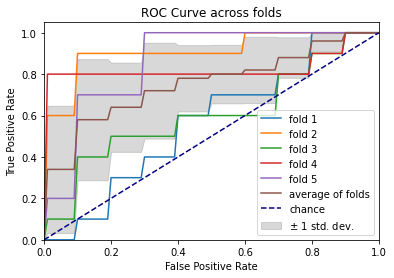

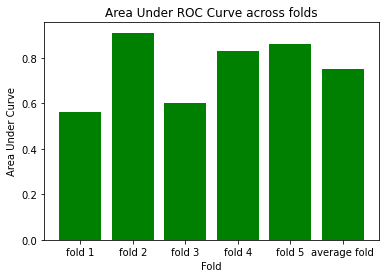

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 170ms/step - loss: 0.6963 - accuracy: 0.4500 - precision: 0.4286 - recall: 0.3000 - val_loss: 0.8116 - val_accuracy: 0.6500 - val_precision: 0.6154 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6588 - accuracy: 0.6625 - precision: 0.6102 - recall: 0.9000 - val_loss: 0.6568 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5969 - accuracy: 0.7375 - precision: 0.7436 - recall: 0.7250 - val_loss: 0.6668 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5547 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.7235 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 134

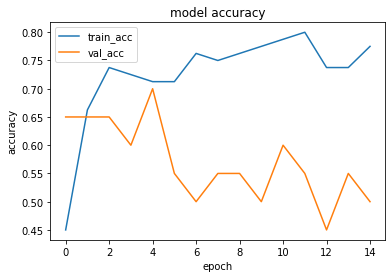

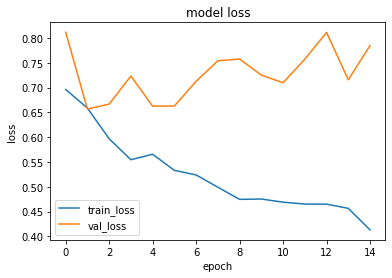

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.6113066]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.6254809]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.6771272]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.3008528]]


1it [00:00, 11366.68it/s]


prediction for video control_2.mov is [[0.18128198]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.16995412]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.8045 - accuracy: 0.5375 - precision: 0.5484 - recall: 0.4250 - val_loss: 0.6000 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6850 - accuracy: 0.5625 - precision: 0.5410 - recall: 0.8250 - val_loss: 0.5827 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6391 - accuracy: 0.6500 - precision: 0.6200 - recall: 0.7750 - val_loss: 0.5832 - val_accuracy: 0.9000 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6372 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.5700 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epo

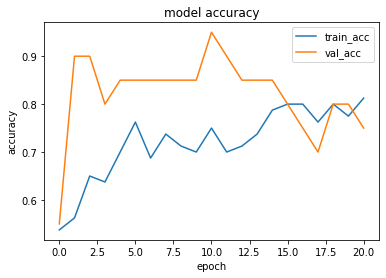

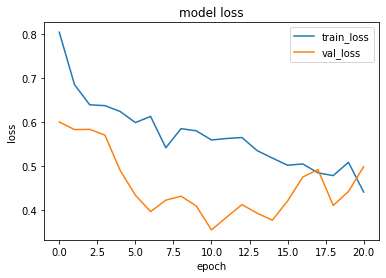

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.6281601]]


1it [00:00, 17476.27it/s]


prediction for video armflapping_3.mov is [[0.6064998]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.79046047]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.30095965]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.2771261]]


1it [00:00, 15592.21it/s]


prediction for video control_3.mov is [[0.276043]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7050 - accuracy: 0.5750 - precision: 0.5714 - recall: 0.6000 - val_loss: 0.7552 - val_accuracy: 0.5500 - val_precision: 0.5714 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5973 - accuracy: 0.7000 - precision: 0.7353 - recall: 0.6250 - val_loss: 0.7379 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5376 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.8353 - val_accuracy: 0.5500 - val_precision: 0.5455 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 144ms/step - loss: 0.5251 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.8269 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch

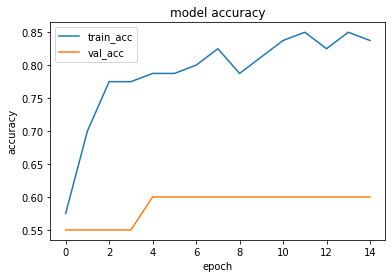

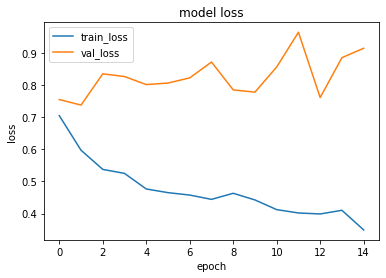

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.7034875]]


1it [00:00, 19152.07it/s]


prediction for video armflapping_3.mov is [[0.53012186]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.8574525]]


1it [00:00, 17476.27it/s]


prediction for video control_1.mov is [[0.31725088]]


1it [00:00, 13888.42it/s]


prediction for video control_2.mov is [[0.20365685]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.16066715]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6927 - accuracy: 0.4375 - precision: 0.4444 - recall: 0.5000 - val_loss: 0.5612 - val_accuracy: 0.6000 - val_precision: 0.5556 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6380 - accuracy: 0.5875 - precision: 0.5636 - recall: 0.7750 - val_loss: 0.6249 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6119 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.5260 - val_accuracy: 0.8000 - val_precision: 0.7143 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5921 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.4907 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

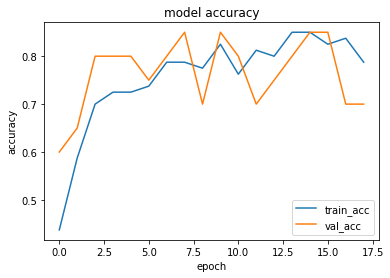

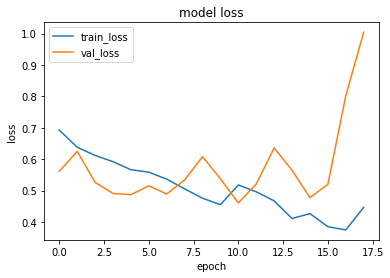

1it [00:00, 15420.24it/s]


prediction for video armflapping_1.mov is [[0.6009628]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.96809757]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.97114074]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.315089]]


1it [00:00, 17848.10it/s]


prediction for video control_2.mov is [[0.23167822]]


1it [00:00, 18893.26it/s]


prediction for video control_3.mov is [[0.24126413]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.7335 - accuracy: 0.5625 - precision: 0.6667 - recall: 0.2500 - val_loss: 0.7571 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6439 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.6517 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6026 - accuracy: 0.7625 - precision: 0.7838 - recall: 0.7250 - val_loss: 0.6417 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5887 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6329 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epo

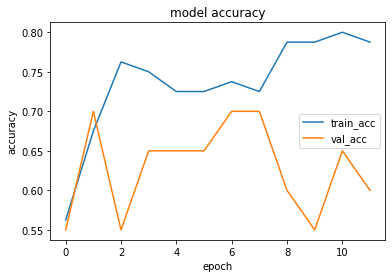

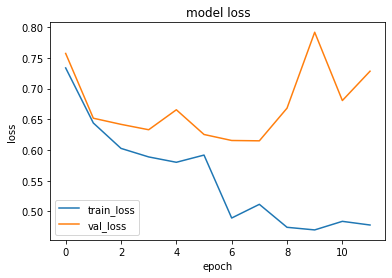

1it [00:00, 14873.42it/s]


prediction for video armflapping_1.mov is [[0.5854987]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_3.mov is [[0.4040831]]


1it [00:00, 14463.12it/s]


prediction for video armflapping_2.mov is [[0.8064189]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.24193192]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.21076679]]


1it [00:00, 16448.25it/s]


prediction for video control_3.mov is [[0.21018115]]


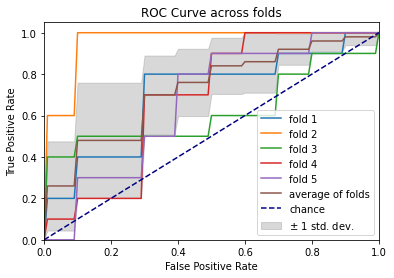

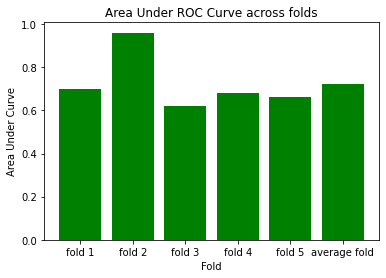

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 171ms/step - loss: 0.7187 - accuracy: 0.3375 - precision: 0.2759 - recall: 0.2000 - val_loss: 0.7046 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6295 - accuracy: 0.6250 - precision: 0.5833 - recall: 0.8750 - val_loss: 0.7513 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5676 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.7973 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 137ms/step - loss: 0.5254 - accuracy: 0.8000 - precision: 0.8158 - recall: 0.7750 - val_loss: 0.7899 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 5/75
3/3 [==============================] - 0s 136

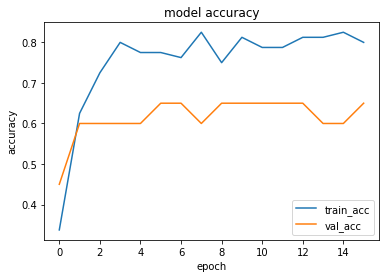

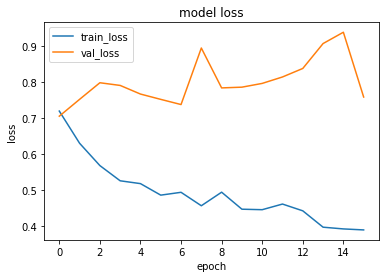

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.48222873]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_3.mov is [[0.16620469]]


1it [00:00, 14979.66it/s]


prediction for video armflapping_2.mov is [[0.73639154]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.28828102]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.21353054]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.21954194]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.8365 - accuracy: 0.5250 - precision: 0.5132 - recall: 0.9750 - val_loss: 0.6817 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6777 - accuracy: 0.6375 - precision: 0.6774 - recall: 0.5250 - val_loss: 0.6333 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 137ms/step - loss: 0.6607 - accuracy: 0.6750 - precision: 0.6944 - recall: 0.6250 - val_loss: 0.5485 - val_accuracy: 0.9000 - val_precision: 0.8333 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6351 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.5084 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epo

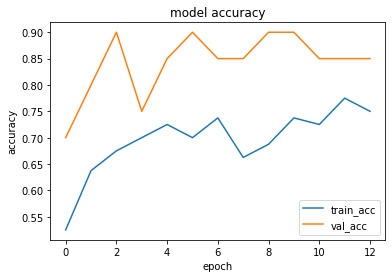

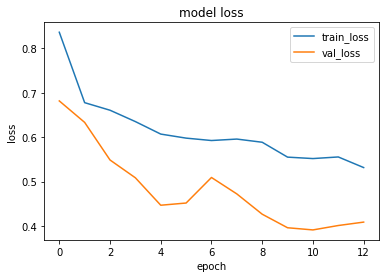

1it [00:00, 13706.88it/s]


prediction for video armflapping_1.mov is [[0.52497387]]


1it [00:00, 12671.61it/s]


prediction for video armflapping_3.mov is [[0.5907188]]


1it [00:00, 13706.88it/s]


prediction for video armflapping_2.mov is [[0.59949946]]


1it [00:00, 14463.12it/s]


prediction for video control_1.mov is [[0.49297458]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.46912977]]


1it [00:00, 15141.89it/s]


prediction for video control_3.mov is [[0.46163774]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.6737 - accuracy: 0.5500 - precision: 0.5400 - recall: 0.6750 - val_loss: 0.6071 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6127 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.5839 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 145ms/step - loss: 0.5761 - accuracy: 0.7625 - precision: 0.7561 - recall: 0.7750 - val_loss: 0.5650 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5751 - accuracy: 0.7000 - precision: 0.7105 - recall: 0.6750 - val_loss: 0.5250 - val_accuracy: 0.8000 - val_precision: 0.7500 - val_recall: 0.9000
Epo

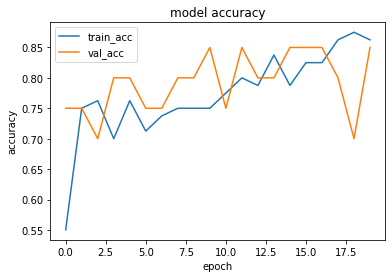

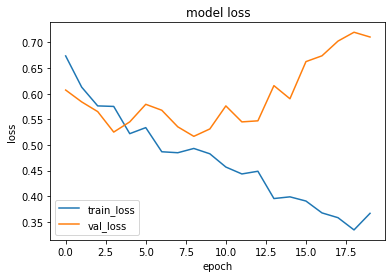

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.6366494]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.26188076]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.89965194]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.2220769]]


1it [00:00, 14074.85it/s]


prediction for video control_2.mov is [[0.25580895]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.26741162]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.7189 - accuracy: 0.5375 - precision: 0.5882 - recall: 0.2500 - val_loss: 0.7222 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6560 - accuracy: 0.6625 - precision: 0.6182 - recall: 0.8500 - val_loss: 0.6380 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5882 - accuracy: 0.7625 - precision: 0.7442 - recall: 0.8000 - val_loss: 0.6133 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5697 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.6174 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

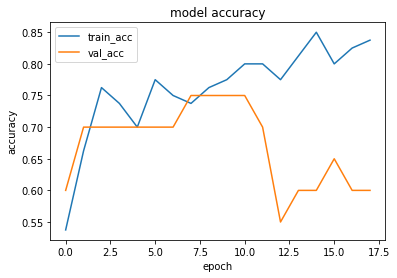

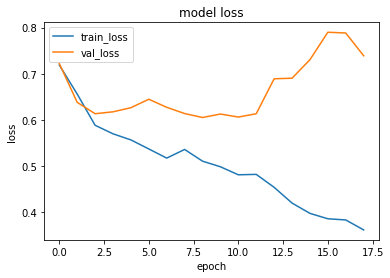

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.50375634]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.40748352]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_2.mov is [[0.7875856]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.21198797]]


1it [00:00, 18236.10it/s]


prediction for video control_2.mov is [[0.20388252]]


1it [00:00, 16194.22it/s]


prediction for video control_3.mov is [[0.20222694]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6940 - accuracy: 0.5750 - precision: 0.5714 - recall: 0.6000 - val_loss: 0.6906 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5917 - accuracy: 0.7750 - precision: 0.7292 - recall: 0.8750 - val_loss: 0.6185 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 128ms/step - loss: 0.5931 - accuracy: 0.6875 - precision: 0.7027 - recall: 0.6500 - val_loss: 0.6740 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5871 - accuracy: 0.6750 - precision: 0.6400 - recall: 0.8000 - val_loss: 0.8192 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

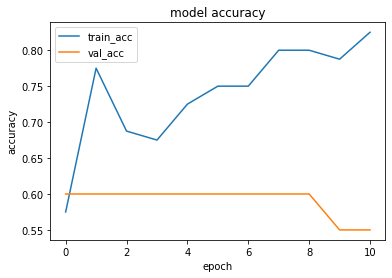

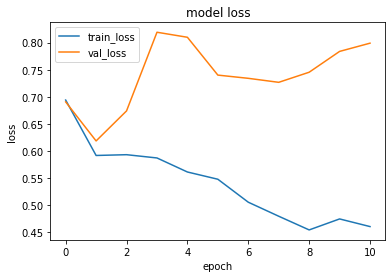

1it [00:00, 19239.93it/s]


prediction for video armflapping_1.mov is [[0.20211196]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.20347458]]


1it [00:00, 13486.51it/s]


prediction for video armflapping_2.mov is [[0.7182374]]


1it [00:00, 14979.66it/s]


prediction for video control_1.mov is [[0.14189169]]


1it [00:00, 14665.40it/s]


prediction for video control_2.mov is [[0.12657645]]


1it [00:00, 14926.35it/s]


prediction for video control_3.mov is [[0.12909049]]


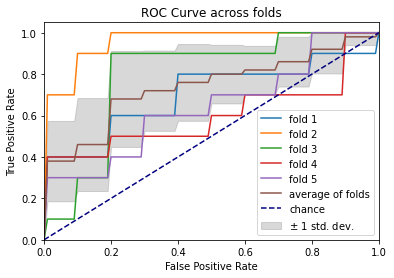

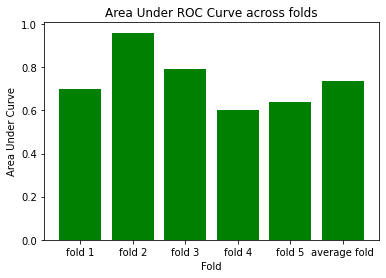

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 173ms/step - loss: 0.6779 - accuracy: 0.6000 - precision: 0.5769 - recall: 0.7500 - val_loss: 0.6208 - val_accuracy: 0.7000 - val_precision: 0.6429 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6382 - accuracy: 0.7000 - precision: 0.6600 - recall: 0.8250 - val_loss: 0.5477 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5633 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.5490 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5199 - accuracy: 0.7500 - precision: 0.7273 - recall: 0.8000 - val_loss: 0.5332 - val_accuracy: 0.7500 - val_precision: 0.7778 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 134

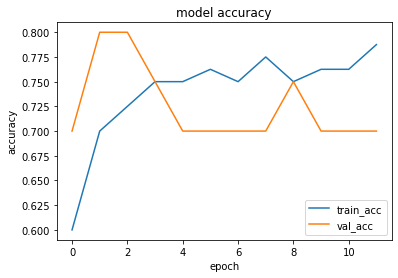

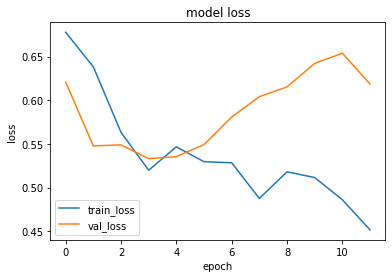

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5112202]]


1it [00:00, 19599.55it/s]


prediction for video armflapping_3.mov is [[0.58964527]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_2.mov is [[0.6401498]]


1it [00:00, 16644.06it/s]


prediction for video control_1.mov is [[0.41365767]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.34858137]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.347314]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6641 - accuracy: 0.5500 - precision: 0.5476 - recall: 0.5750 - val_loss: 0.7683 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 140ms/step - loss: 0.7340 - accuracy: 0.6000 - precision: 0.5625 - recall: 0.9000 - val_loss: 0.6436 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6218 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6542 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 1s 208ms/step - loss: 0.6097 - accuracy: 0.7000 - precision: 0.7667 - recall: 0.5750 - val_loss: 0.6066 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch

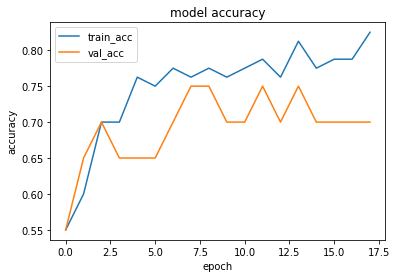

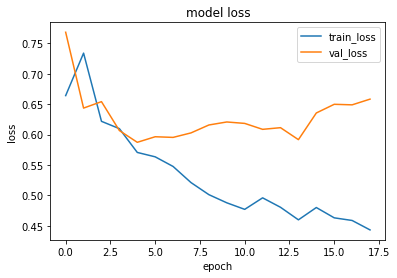

1it [00:00, 14768.68it/s]


prediction for video armflapping_1.mov is [[0.5622899]]


1it [00:00, 18157.16it/s]


prediction for video armflapping_3.mov is [[0.2283498]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.76080763]]


1it [00:00, 14873.42it/s]


prediction for video control_1.mov is [[0.3238771]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.26656926]]


1it [00:00, 14563.56it/s]


prediction for video control_3.mov is [[0.33285803]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.6824 - accuracy: 0.4875 - precision: 0.4894 - recall: 0.5750 - val_loss: 0.6556 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6394 - accuracy: 0.6750 - precision: 0.7333 - recall: 0.5500 - val_loss: 0.6247 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5676 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6096 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5524 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6076 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

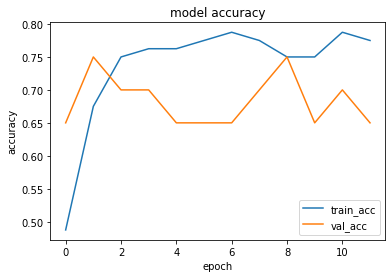

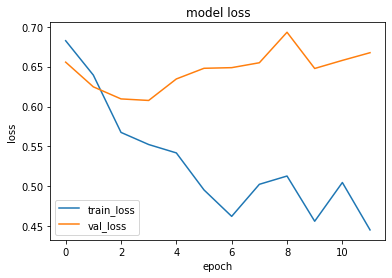

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.6600278]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_3.mov is [[0.59784454]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.7606628]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.26836568]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.23899704]]


1it [00:00, 18236.10it/s]


prediction for video control_3.mov is [[0.23478717]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6803 - accuracy: 0.5875 - precision: 0.5814 - recall: 0.6250 - val_loss: 0.6867 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.7302 - accuracy: 0.6125 - precision: 0.5634 - recall: 1.0000 - val_loss: 0.6291 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6078 - accuracy: 0.7000 - precision: 0.7500 - recall: 0.6000 - val_loss: 0.6587 - val_accuracy: 0.6000 - val_precision: 0.7500 - val_recall: 0.3000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6199 - accuracy: 0.6625 - precision: 0.8095 - recall: 0.4250 - val_loss: 0.6332 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

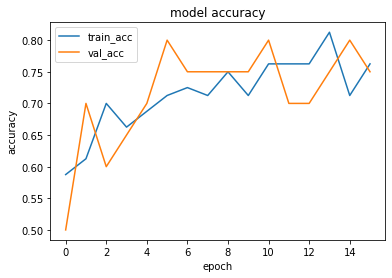

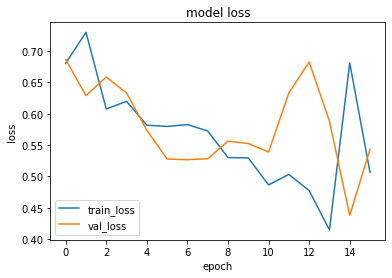

1it [00:00, 15592.21it/s]


prediction for video armflapping_1.mov is [[0.5420539]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.2593953]]


1it [00:00, 12985.46it/s]


prediction for video armflapping_2.mov is [[0.62215364]]


1it [00:00, 18236.10it/s]


prediction for video control_1.mov is [[0.2720176]]


1it [00:00, 15887.52it/s]


prediction for video control_2.mov is [[0.37646127]]


1it [00:00, 14979.66it/s]


prediction for video control_3.mov is [[0.21002007]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6907 - accuracy: 0.4375 - precision: 0.4510 - recall: 0.5750 - val_loss: 0.6555 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6389 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6528 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5590 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.6426 - val_accuracy: 0.7000 - val_precision: 0.7500 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5757 - accuracy: 0.6875 - precision: 0.8261 - recall: 0.4750 - val_loss: 0.6505 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epo

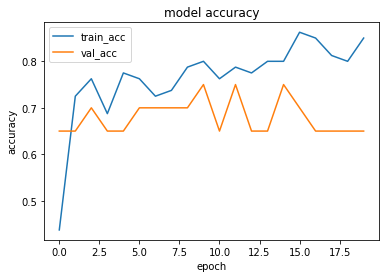

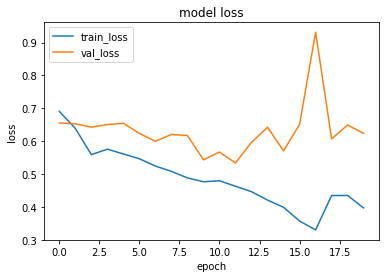

1it [00:00, 12192.74it/s]


prediction for video armflapping_1.mov is [[0.5678558]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.4469906]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.889439]]


1it [00:00, 18477.11it/s]


prediction for video control_1.mov is [[0.5549769]]


1it [00:00, 18477.11it/s]


prediction for video control_2.mov is [[0.1592463]]


1it [00:00, 11915.64it/s]


prediction for video control_3.mov is [[0.47285068]]


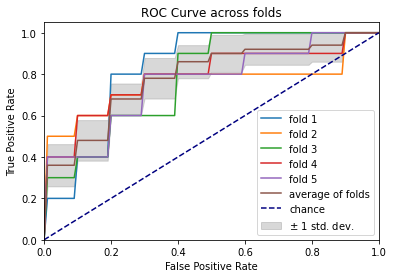

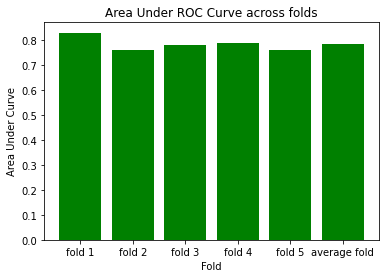

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.8702 - accuracy: 0.4875 - precision: 0.4706 - recall: 0.2000 - val_loss: 0.7660 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 153ms/step - loss: 0.6185 - accuracy: 0.6625 - precision: 0.6066 - recall: 0.9250 - val_loss: 0.7802 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5979 - accuracy: 0.7750 - precision: 0.7500 - recall: 0.8250 - val_loss: 0.7810 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 130ms/step - loss: 0.5424 - accuracy: 0.7875 - precision: 0.7674 - recall: 0.8250 - val_loss: 0.7940 - val_accuracy: 0.5500 - val_precision: 0.5385 - val_recall: 0.7000
Epoch 5/75
3/3 [==============================] - 0s 135

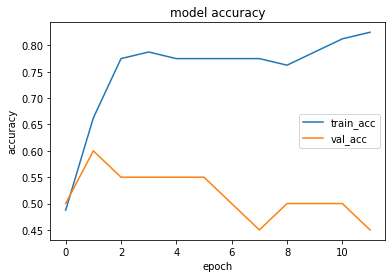

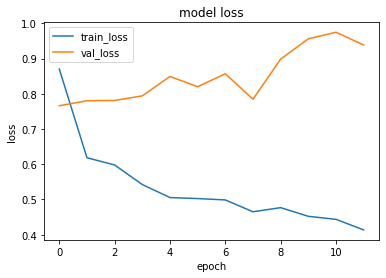

1it [00:00, 14979.66it/s]


prediction for video armflapping_1.mov is [[0.5678682]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_3.mov is [[0.59496313]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.65596306]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.51370907]]


1it [00:00, 15592.21it/s]


prediction for video control_2.mov is [[0.48057693]]


1it [00:00, 15887.52it/s]


prediction for video control_3.mov is [[0.48045516]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.7873 - accuracy: 0.5250 - precision: 0.5312 - recall: 0.4250 - val_loss: 0.5892 - val_accuracy: 0.5500 - val_precision: 0.5263 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6715 - accuracy: 0.5625 - precision: 0.5333 - recall: 1.0000 - val_loss: 0.5563 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6460 - accuracy: 0.6625 - precision: 0.6275 - recall: 0.8000 - val_loss: 0.5822 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6271 - accuracy: 0.7250 - precision: 0.7647 - recall: 0.6500 - val_loss: 0.5674 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epo

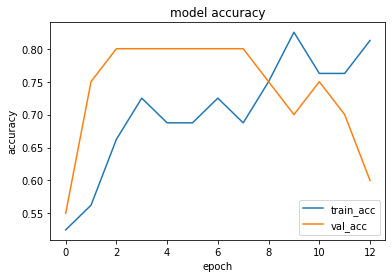

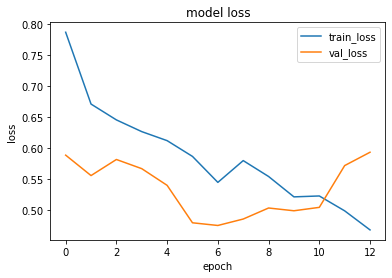

1it [00:00, 14716.86it/s]


prediction for video armflapping_1.mov is [[0.4875614]]


1it [00:00, 16710.37it/s]


prediction for video armflapping_3.mov is [[0.52708054]]


1it [00:00, 15887.52it/s]


prediction for video armflapping_2.mov is [[0.5380364]]


1it [00:00, 6288.31it/s]


prediction for video control_1.mov is [[0.4659508]]


1it [00:00, 18157.16it/s]


prediction for video control_2.mov is [[0.4524428]]


1it [00:00, 18157.16it/s]


prediction for video control_3.mov is [[0.4571341]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 206ms/step - loss: 0.6475 - accuracy: 0.6500 - precision: 0.6071 - recall: 0.8500 - val_loss: 0.6628 - val_accuracy: 0.5000 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6934 - accuracy: 0.6125 - precision: 0.6957 - recall: 0.4000 - val_loss: 0.5355 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5700 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5310 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 142ms/step - loss: 0.5672 - accuracy: 0.7250 - precision: 0.7250 - recall: 0.7250 - val_loss: 0.4707 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8

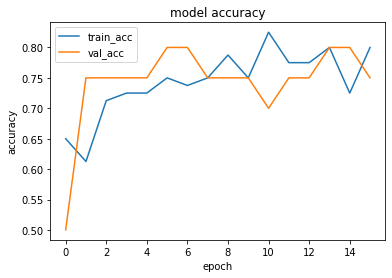

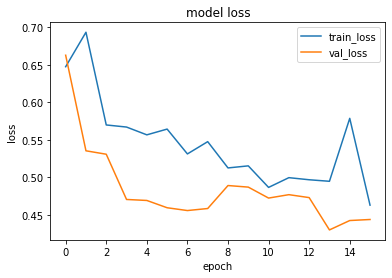

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.4163004]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.5348698]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_2.mov is [[0.69893837]]


1it [00:00, 15363.75it/s]


prediction for video control_1.mov is [[0.23804247]]


1it [00:00, 15363.75it/s]


prediction for video control_2.mov is [[0.24894449]]


1it [00:00, 17848.10it/s]


prediction for video control_3.mov is [[0.25146654]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 154ms/step - loss: 0.6775 - accuracy: 0.5625 - precision: 0.5806 - recall: 0.4500 - val_loss: 0.8591 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.7684 - accuracy: 0.5875 - precision: 0.5522 - recall: 0.9250 - val_loss: 0.6594 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5876 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.7261 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5821 - accuracy: 0.7250 - precision: 0.7812 - recall: 0.6250 - val_loss: 0.7234 - val_accuracy: 0.6000 - val_precision: 0.6250 - val_recall: 0.5000
Epo

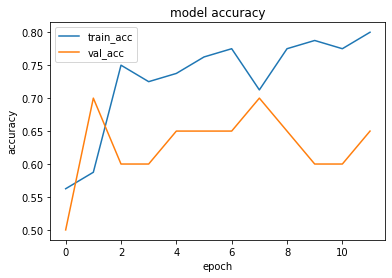

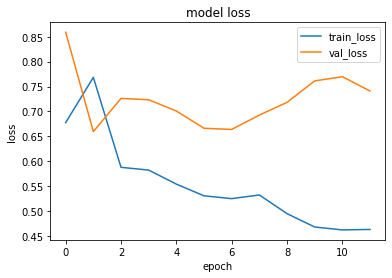

1it [00:00, 14315.03it/s]


prediction for video armflapping_1.mov is [[0.6570407]]


1it [00:00, 15363.75it/s]


prediction for video armflapping_3.mov is [[0.30302173]]


1it [00:00, 16194.22it/s]


prediction for video armflapping_2.mov is [[0.71739805]]


1it [00:00, 13888.42it/s]


prediction for video control_1.mov is [[0.48330528]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.24829605]]


1it [00:00, 15420.24it/s]


prediction for video control_3.mov is [[0.31218264]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 143ms/step - loss: 0.6995 - accuracy: 0.5750 - precision: 0.5789 - recall: 0.5500 - val_loss: 0.6549 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6718 - accuracy: 0.6250 - precision: 0.5862 - recall: 0.8500 - val_loss: 0.6136 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 130ms/step - loss: 0.6276 - accuracy: 0.6500 - precision: 0.6429 - recall: 0.6750 - val_loss: 0.5414 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5783 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.5609 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epo

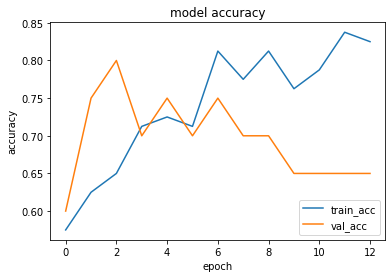

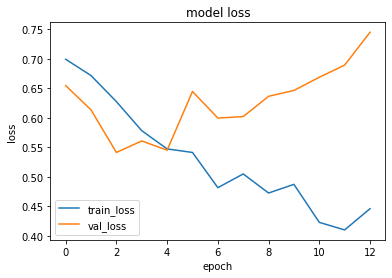

1it [00:00, 15887.52it/s]


prediction for video armflapping_1.mov is [[0.6985476]]


1it [00:00, 18236.10it/s]


prediction for video armflapping_3.mov is [[0.80362827]]


1it [00:00, 13148.29it/s]


prediction for video armflapping_2.mov is [[0.87836146]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.14012322]]


1it [00:00, 19239.93it/s]


prediction for video control_2.mov is [[0.20039141]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.38336396]]


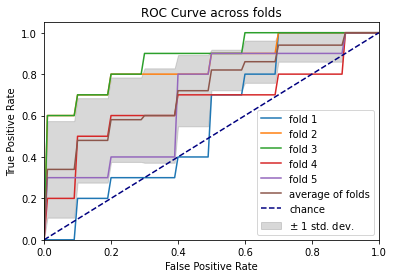

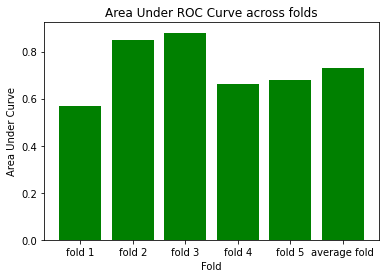

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 228ms/step - loss: 0.6968 - accuracy: 0.4375 - precision: 0.4390 - recall: 0.4500 - val_loss: 0.7369 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5919 - accuracy: 0.7125 - precision: 0.6977 - recall: 0.7500 - val_loss: 0.7232 - val_accuracy: 0.7500 - val_precision: 0.6923 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5944 - accuracy: 0.7000 - precision: 0.6739 - recall: 0.7750 - val_loss: 0.7160 - val_accuracy: 0.7000 - val_precision: 0.6667 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.5673 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6875 - val_accuracy: 0.5500 - val_precision: 0.5556 - val_recall: 0.5000
Epoch 5/75
3/3 [==============================] - 0s 131

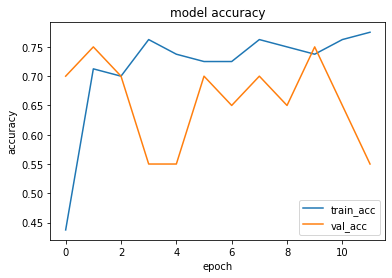

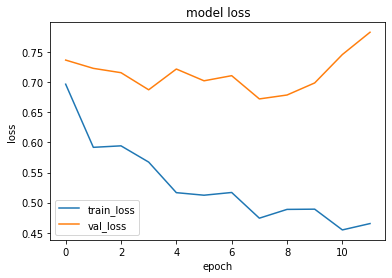

1it [00:00, 13662.23it/s]


prediction for video armflapping_1.mov is [[0.5370675]]


1it [00:00, 9098.27it/s]


prediction for video armflapping_3.mov is [[0.5571614]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.6303253]]


1it [00:00, 14665.40it/s]


prediction for video control_1.mov is [[0.48831844]]


1it [00:00, 15650.39it/s]


prediction for video control_2.mov is [[0.47355705]]


1it [00:00, 13148.29it/s]


prediction for video control_3.mov is [[0.47165373]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.6591 - accuracy: 0.6250 - precision: 0.6087 - recall: 0.7000 - val_loss: 0.6562 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6334 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.6189 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 148ms/step - loss: 0.5787 - accuracy: 0.7500 - precision: 0.7500 - recall: 0.7500 - val_loss: 0.6540 - val_accuracy: 0.6000 - val_precision: 0.6667 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 139ms/step - loss: 0.5669 - accuracy: 0.7500 - precision: 0.7778 - recall: 0.7000 - val_loss: 0.6229 - val_accuracy: 0.6500 - val_precision: 0.7143 - val_recall: 0.5000
Epo

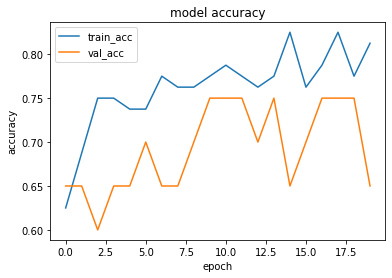

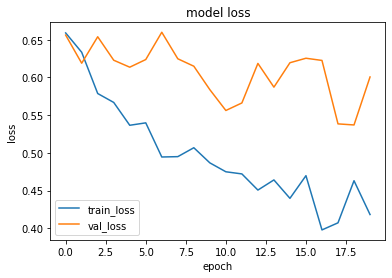

1it [00:00, 15650.39it/s]


prediction for video armflapping_1.mov is [[0.65633625]]


1it [00:00, 16912.52it/s]


prediction for video armflapping_3.mov is [[0.58424]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_2.mov is [[0.88683444]]


1it [00:00, 12052.60it/s]


prediction for video control_1.mov is [[0.44449407]]


1it [00:00, 14873.42it/s]


prediction for video control_2.mov is [[0.22125328]]


1it [00:00, 13706.88it/s]


prediction for video control_3.mov is [[0.19797668]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7609 - accuracy: 0.6375 - precision: 0.6122 - recall: 0.7500 - val_loss: 0.6749 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6483 - accuracy: 0.6750 - precision: 0.6842 - recall: 0.6500 - val_loss: 0.6766 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6055 - accuracy: 0.6875 - precision: 0.6531 - recall: 0.8000 - val_loss: 0.6675 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6137 - accuracy: 0.6250 - precision: 0.5758 - recall: 0.9500 - val_loss: 0.8264 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epo

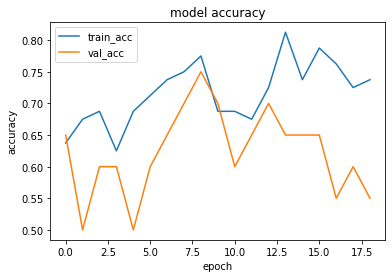

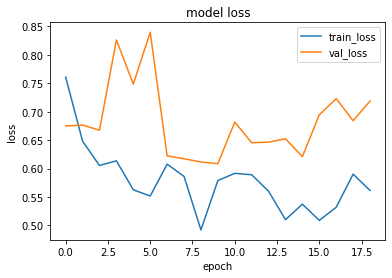

1it [00:00, 16194.22it/s]


prediction for video armflapping_1.mov is [[0.7241138]]


1it [00:00, 18893.26it/s]


prediction for video armflapping_3.mov is [[0.88189983]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_2.mov is [[0.80825436]]


1it [00:00, 16980.99it/s]


prediction for video control_1.mov is [[0.60799754]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.58475363]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.5782395]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 146ms/step - loss: 0.7653 - accuracy: 0.4375 - precision: 0.4000 - recall: 0.2500 - val_loss: 0.6585 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6555 - accuracy: 0.5500 - precision: 0.5278 - recall: 0.9500 - val_loss: 0.5903 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 3/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6136 - accuracy: 0.7250 - precision: 0.7143 - recall: 0.7500 - val_loss: 0.5576 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoch 4/75
3/3 [==============================] - 0s 134ms/step - loss: 0.5814 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.5541 - val_accuracy: 0.7500 - val_precision: 0.6667 - val_recall: 1.0000
Epoc

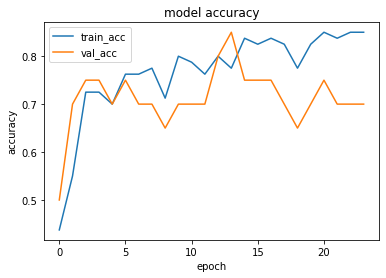

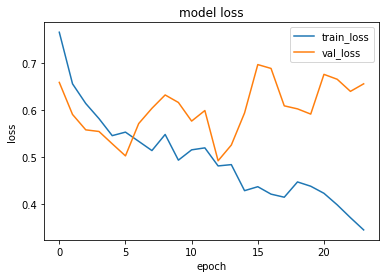

1it [00:00, 12483.05it/s]


prediction for video armflapping_1.mov is [[0.40660155]]


1it [00:00, 15592.21it/s]


prediction for video armflapping_3.mov is [[0.5979494]]


1it [00:00, 14665.40it/s]


prediction for video armflapping_2.mov is [[0.6961734]]


1it [00:00, 16912.52it/s]


prediction for video control_1.mov is [[0.27039307]]


1it [00:00, 16448.25it/s]


prediction for video control_2.mov is [[0.24914262]]


1it [00:00, 16131.94it/s]


prediction for video control_3.mov is [[0.25577655]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 158ms/step - loss: 0.7550 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.9500 - val_loss: 0.6439 - val_accuracy: 0.6500 - val_precision: 1.0000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6731 - accuracy: 0.5875 - precision: 0.7059 - recall: 0.3000 - val_loss: 0.5949 - val_accuracy: 0.8000 - val_precision: 0.8750 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6386 - accuracy: 0.7375 - precision: 0.7568 - recall: 0.7000 - val_loss: 0.5321 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6262 - accuracy: 0.6875 - precision: 0.6471 - recall: 0.8250 - val_loss: 0.4874 - val_accuracy: 0.8500 - val_precision: 0.8182 - val_recall: 0.9000
Epo

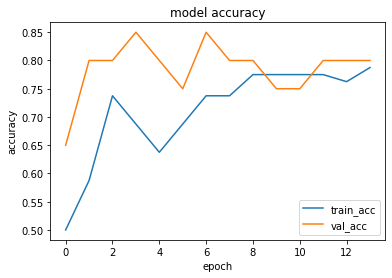

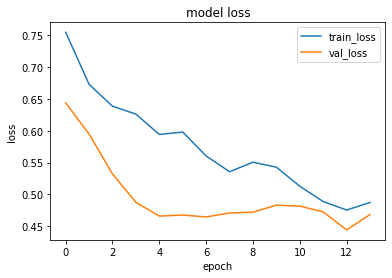

1it [00:00, 11748.75it/s]


prediction for video armflapping_1.mov is [[0.6755659]]


1it [00:00, 15420.24it/s]


prediction for video armflapping_3.mov is [[0.84107006]]


1it [00:00, 15141.89it/s]


prediction for video armflapping_2.mov is [[0.788893]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.19393134]]


1it [00:00, 15420.24it/s]


prediction for video control_2.mov is [[0.16034576]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.15544942]]


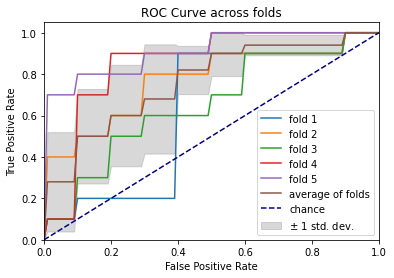

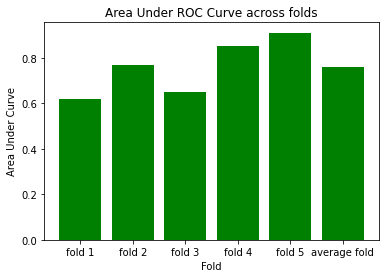

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 165ms/step - loss: 0.7144 - accuracy: 0.4625 - precision: 0.4746 - recall: 0.7000 - val_loss: 0.5700 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 136ms/step - loss: 0.6655 - accuracy: 0.6875 - precision: 0.6923 - recall: 0.6750 - val_loss: 0.5507 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 1s 133ms/step - loss: 0.6240 - accuracy: 0.6750 - precision: 0.6591 - recall: 0.7250 - val_loss: 0.5377 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5744 - accuracy: 0.7125 - precision: 0.6667 - recall: 0.8500 - val_loss: 0.5278 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 129

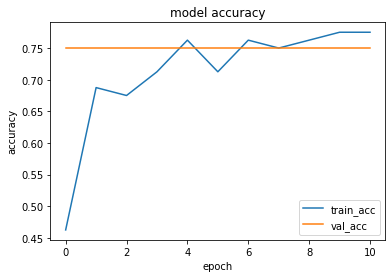

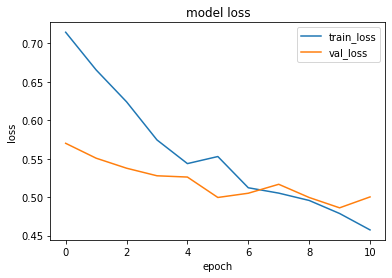

1it [00:00, 14122.24it/s]


prediction for video armflapping_1.mov is [[0.538235]]


1it [00:00, 15650.39it/s]


prediction for video armflapping_3.mov is [[0.5700891]]


1it [00:00, 8612.53it/s]


prediction for video armflapping_2.mov is [[0.5924061]]


1it [00:00, 6502.80it/s]


prediction for video control_1.mov is [[0.5070659]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.48622304]]


1it [00:00, 13530.01it/s]


prediction for video control_3.mov is [[0.49306023]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 156ms/step - loss: 0.6249 - accuracy: 0.6250 - precision: 0.5962 - recall: 0.7750 - val_loss: 1.0961 - val_accuracy: 0.6000 - val_precision: 0.5625 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 139ms/step - loss: 0.6744 - accuracy: 0.6375 - precision: 0.5932 - recall: 0.8750 - val_loss: 0.8550 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 146ms/step - loss: 0.5584 - accuracy: 0.7750 - precision: 0.8438 - recall: 0.6750 - val_loss: 0.8415 - val_accuracy: 0.4500 - val_precision: 0.4545 - val_recall: 0.5000
Epoch 4/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5381 - accuracy: 0.7500 - precision: 0.8333 - recall: 0.6250 - val_loss: 0.9010 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.6000
Epo

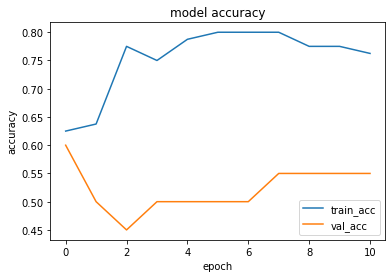

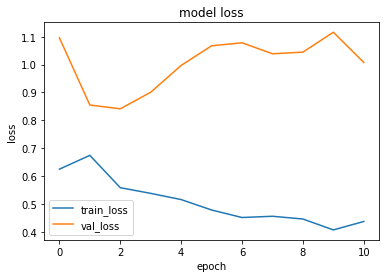

1it [00:00, 14513.16it/s]


prediction for video armflapping_1.mov is [[0.48241863]]


1it [00:00, 16320.25it/s]


prediction for video armflapping_3.mov is [[0.0644947]]


1it [00:00, 15477.14it/s]


prediction for video armflapping_2.mov is [[0.813346]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.1596803]]


1it [00:00, 16644.06it/s]


prediction for video control_2.mov is [[0.18296924]]


1it [00:00, 16980.99it/s]


prediction for video control_3.mov is [[0.16137716]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 207ms/step - loss: 0.6641 - accuracy: 0.5000 - precision: 0.5000 - recall: 0.6000 - val_loss: 0.8016 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 129ms/step - loss: 0.6105 - accuracy: 0.7250 - precision: 0.8000 - recall: 0.6000 - val_loss: 0.7382 - val_accuracy: 0.6000 - val_precision: 0.5714 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 135ms/step - loss: 0.5821 - accuracy: 0.7250 - precision: 0.6875 - recall: 0.8250 - val_loss: 0.6609 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 138ms/step - loss: 0.5252 - accuracy: 0.7750 - precision: 0.7619 - recall: 0.8000 - val_loss: 0.6519 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epo

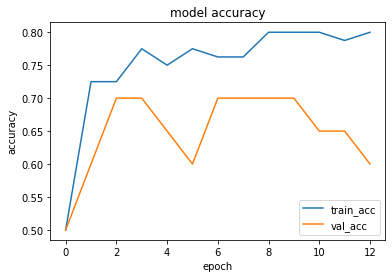

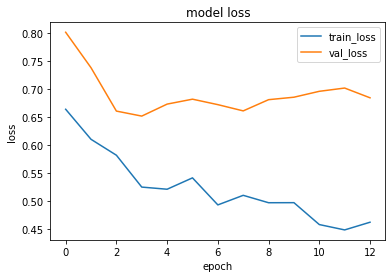

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.53649575]]


1it [00:00, 16384.00it/s]


prediction for video armflapping_3.mov is [[0.7119894]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.8165227]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.30305338]]


1it [00:00, 13315.25it/s]


prediction for video control_2.mov is [[0.24104306]]


1it [00:00, 15363.75it/s]


prediction for video control_3.mov is [[0.23875761]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.7194 - accuracy: 0.5125 - precision: 0.5143 - recall: 0.4500 - val_loss: 0.6846 - val_accuracy: 0.7000 - val_precision: 0.6250 - val_recall: 1.0000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6121 - accuracy: 0.7250 - precision: 0.7045 - recall: 0.7750 - val_loss: 0.6286 - val_accuracy: 0.7000 - val_precision: 0.7000 - val_recall: 0.7000
Epoch 3/75
3/3 [==============================] - 0s 136ms/step - loss: 0.5966 - accuracy: 0.7250 - precision: 0.7368 - recall: 0.7000 - val_loss: 0.6285 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.5736 - accuracy: 0.7625 - precision: 0.7692 - recall: 0.7500 - val_loss: 0.6055 - val_accuracy: 0.6500 - val_precision: 0.6000 - val_recall: 0.9000
Epo

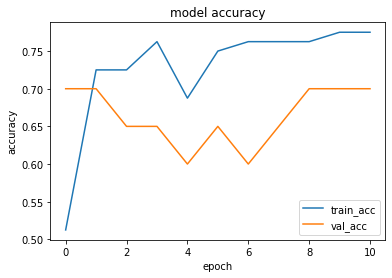

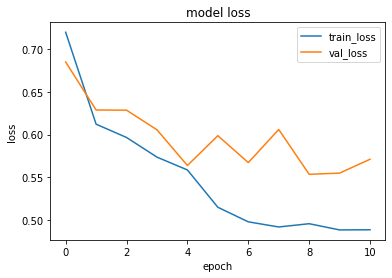

1it [00:00, 15196.75it/s]


prediction for video armflapping_1.mov is [[0.45028812]]


1it [00:00, 13934.56it/s]


prediction for video armflapping_3.mov is [[0.3662455]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_2.mov is [[0.6946386]]


1it [00:00, 13706.88it/s]


prediction for video control_1.mov is [[0.28952327]]


1it [00:00, 16384.00it/s]


prediction for video control_2.mov is [[0.29091185]]


1it [00:00, 15650.39it/s]


prediction for video control_3.mov is [[0.29163378]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 148ms/step - loss: 0.7386 - accuracy: 0.4500 - precision: 0.4231 - recall: 0.2750 - val_loss: 0.5856 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6517 - accuracy: 0.7000 - precision: 0.7000 - recall: 0.7000 - val_loss: 0.5266 - val_accuracy: 0.9000 - val_precision: 1.0000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 133ms/step - loss: 0.6604 - accuracy: 0.6250 - precision: 0.6000 - recall: 0.7500 - val_loss: 0.5398 - val_accuracy: 0.8500 - val_precision: 1.0000 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6479 - accuracy: 0.6750 - precision: 0.6750 - recall: 0.6750 - val_loss: 0.4965 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.6000
Epo

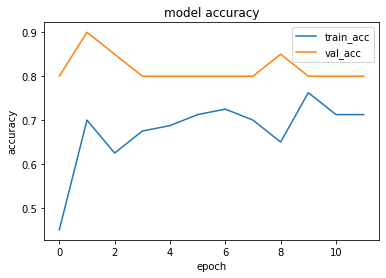

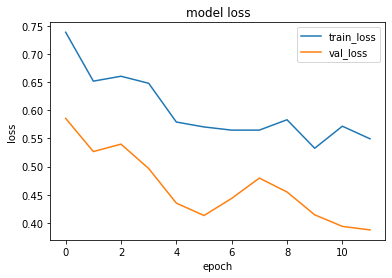

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.5360948]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_3.mov is [[0.55475014]]


1it [00:00, 14074.85it/s]


prediction for video armflapping_2.mov is [[0.6094626]]


1it [00:00, 15887.52it/s]


prediction for video control_1.mov is [[0.49967867]]


1it [00:00, 17260.51it/s]


prediction for video control_2.mov is [[0.4868446]]


1it [00:00, 14074.85it/s]


prediction for video control_3.mov is [[0.48642203]]


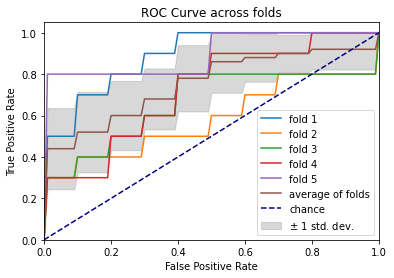

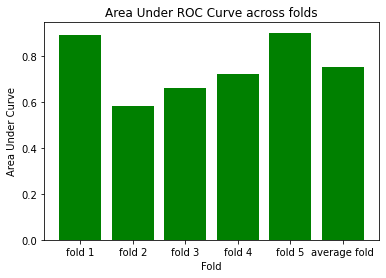

(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 167ms/step - loss: 0.6888 - accuracy: 0.4750 - precision: 0.4808 - recall: 0.6250 - val_loss: 0.6532 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 2/75
3/3 [==============================] - 0s 134ms/step - loss: 0.6541 - accuracy: 0.6625 - precision: 0.8095 - recall: 0.4250 - val_loss: 0.5866 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 141ms/step - loss: 0.5826 - accuracy: 0.7125 - precision: 0.7073 - recall: 0.7250 - val_loss: 0.5761 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 133ms/step - loss: 0.5746 - accuracy: 0.7000 - precision: 0.6818 - recall: 0.7500 - val_loss: 0.5688 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 5/75
3/3 [==============================] - 0s 136

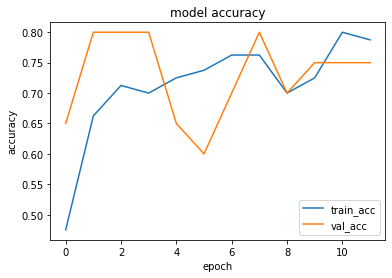

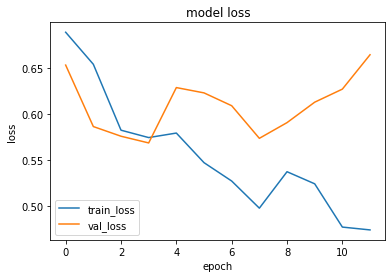

1it [00:00, 18558.87it/s]


prediction for video armflapping_1.mov is [[0.52910113]]


1it [00:00, 16644.06it/s]


prediction for video armflapping_3.mov is [[0.5850058]]


1it [00:00, 14926.35it/s]


prediction for video armflapping_2.mov is [[0.622437]]


1it [00:00, 17848.10it/s]


prediction for video control_1.mov is [[0.4806807]]


1it [00:00, 15827.56it/s]


prediction for video control_2.mov is [[0.46397611]]


1it [00:00, 17260.51it/s]


prediction for video control_3.mov is [[0.4575429]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 145ms/step - loss: 0.8699 - accuracy: 0.4625 - precision: 0.2857 - recall: 0.0500 - val_loss: 0.7458 - val_accuracy: 0.4000 - val_precision: 0.4444 - val_recall: 0.8000
Epoch 2/75
3/3 [==============================] - 0s 138ms/step - loss: 0.6156 - accuracy: 0.6000 - precision: 0.5571 - recall: 0.9750 - val_loss: 0.7275 - val_accuracy: 0.4500 - val_precision: 0.4737 - val_recall: 0.9000
Epoch 3/75
3/3 [==============================] - 0s 147ms/step - loss: 0.6121 - accuracy: 0.6750 - precision: 0.6250 - recall: 0.8750 - val_loss: 0.7397 - val_accuracy: 0.6000 - val_precision: 0.5833 - val_recall: 0.7000
Epoch 4/75
3/3 [==============================] - 0s 147ms/step - loss: 0.5660 - accuracy: 0.7625 - precision: 0.7333 - recall: 0.8250 - val_loss: 0.7651 - val_accuracy: 0.6500 - val_precision: 0.6364 - val_recall: 0.7000
Epoc

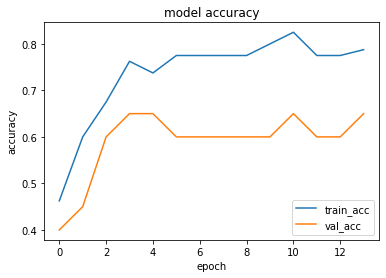

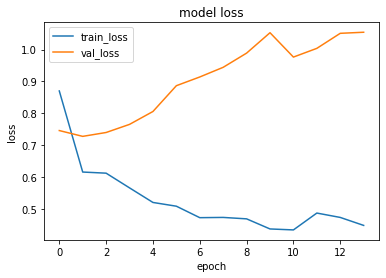

1it [00:00, 16912.52it/s]


prediction for video armflapping_1.mov is [[0.56555533]]


1it [00:00, 14122.24it/s]


prediction for video armflapping_3.mov is [[0.12997386]]


1it [00:00, 14563.56it/s]


prediction for video armflapping_2.mov is [[0.7220086]]


1it [00:00, 18558.87it/s]


prediction for video control_1.mov is [[0.25269997]]


1it [00:00, 15141.89it/s]


prediction for video control_2.mov is [[0.20918885]]


1it [00:00, 19239.93it/s]


prediction for video control_3.mov is [[0.19774139]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 1s 141ms/step - loss: 0.7165 - accuracy: 0.6125 - precision: 0.5818 - recall: 0.8000 - val_loss: 0.9083 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.7000
Epoch 2/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6427 - accuracy: 0.7125 - precision: 0.6604 - recall: 0.8750 - val_loss: 0.6653 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6148 - accuracy: 0.6750 - precision: 0.7188 - recall: 0.5750 - val_loss: 0.6403 - val_accuracy: 0.6500 - val_precision: 0.6667 - val_recall: 0.6000
Epoch 4/75
3/3 [==============================] - 0s 132ms/step - loss: 0.5700 - accuracy: 0.7000 - precision: 0.7222 - recall: 0.6500 - val_loss: 0.7062 - val_accuracy: 0.6000 - val_precision: 0.6000 - val_recall: 0.6000
Epo

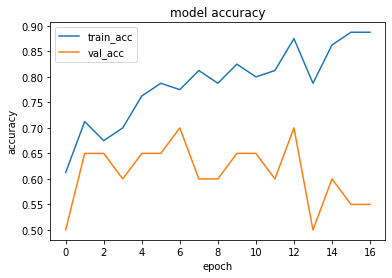

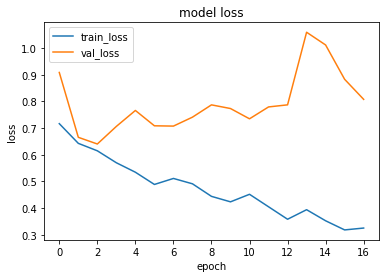

1it [00:00, 15141.89it/s]


prediction for video armflapping_1.mov is [[0.6641884]]


1it [00:00, 14513.16it/s]


prediction for video armflapping_3.mov is [[0.7308315]]


1it [00:00, 17848.10it/s]


prediction for video armflapping_2.mov is [[0.96349275]]


1it [00:00, 17924.38it/s]


prediction for video control_1.mov is [[0.13764969]]


1it [00:00, 15196.75it/s]


prediction for video control_2.mov is [[0.34635156]]


1it [00:00, 14513.16it/s]


prediction for video control_3.mov is [[0.2759105]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 144ms/step - loss: 0.8863 - accuracy: 0.5375 - precision: 0.5200 - recall: 0.9750 - val_loss: 0.7074 - val_accuracy: 0.5000 - val_precision: 0.5000 - val_recall: 0.3000
Epoch 2/75
3/3 [==============================] - 0s 135ms/step - loss: 0.6991 - accuracy: 0.5375 - precision: 0.5882 - recall: 0.2500 - val_loss: 0.6914 - val_accuracy: 0.5500 - val_precision: 1.0000 - val_recall: 0.1000
Epoch 3/75
3/3 [==============================] - 0s 132ms/step - loss: 0.6657 - accuracy: 0.6375 - precision: 0.8667 - recall: 0.3250 - val_loss: 0.6383 - val_accuracy: 0.6500 - val_precision: 0.8000 - val_recall: 0.4000
Epoch 4/75
3/3 [==============================] - 0s 131ms/step - loss: 0.6360 - accuracy: 0.7125 - precision: 0.7297 - recall: 0.6750 - val_loss: 0.6051 - val_accuracy: 0.7000 - val_precision: 0.8333 - val_recall: 0.5000
Epoc

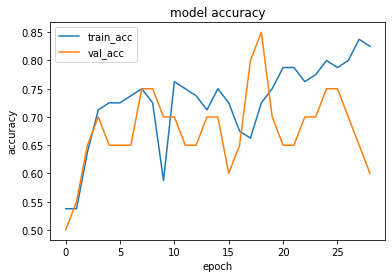

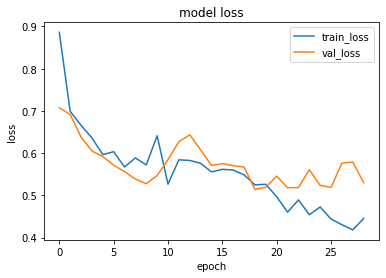

1it [00:00, 15363.75it/s]


prediction for video armflapping_1.mov is [[0.5389148]]


1it [00:00, 14315.03it/s]


prediction for video armflapping_3.mov is [[0.48505]]


1it [00:00, 13530.01it/s]


prediction for video armflapping_2.mov is [[0.64382166]]


1it [00:00, 15141.89it/s]


prediction for video control_1.mov is [[0.45012197]]


1it [00:00, 14716.86it/s]


prediction for video control_2.mov is [[0.42481568]]


1it [00:00, 16710.37it/s]


prediction for video control_3.mov is [[0.32659578]]
(40, 90, 126) (40, 90, 126)
(10, 90, 126) (10, 90, 126)
Epoch 1/75
3/3 [==============================] - 0s 149ms/step - loss: 0.6973 - accuracy: 0.5250 - precision: 0.5161 - recall: 0.8000 - val_loss: 0.6025 - val_accuracy: 0.5500 - val_precision: 0.5294 - val_recall: 0.9000
Epoch 2/75
3/3 [==============================] - 0s 151ms/step - loss: 0.6677 - accuracy: 0.5500 - precision: 0.5303 - recall: 0.8750 - val_loss: 0.5674 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epoch 3/75
3/3 [==============================] - 0s 162ms/step - loss: 0.6135 - accuracy: 0.7125 - precision: 0.6889 - recall: 0.7750 - val_loss: 0.5783 - val_accuracy: 0.8000 - val_precision: 0.8000 - val_recall: 0.8000
Epoch 4/75
3/3 [==============================] - 0s 140ms/step - loss: 0.6154 - accuracy: 0.6750 - precision: 0.7692 - recall: 0.5000 - val_loss: 0.5451 - val_accuracy: 0.7500 - val_precision: 0.7273 - val_recall: 0.8000
Epo

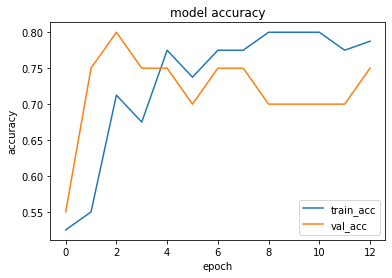

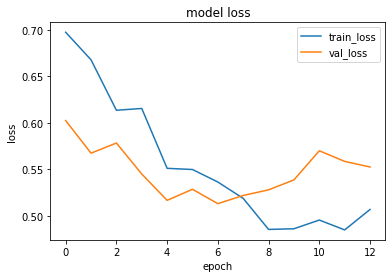

1it [00:00, 14926.35it/s]


prediction for video armflapping_1.mov is [[0.60943407]]


1it [00:00, 17924.38it/s]


prediction for video armflapping_3.mov is [[0.7013744]]


1it [00:00, 16131.94it/s]


prediction for video armflapping_2.mov is [[0.752008]]


1it [00:00, 17772.47it/s]


prediction for video control_1.mov is [[0.36281818]]


1it [00:00, 17623.13it/s]


prediction for video control_2.mov is [[0.29606748]]


1it [00:00, 15827.56it/s]


prediction for video control_3.mov is [[0.26351124]]


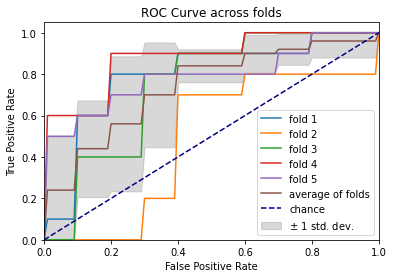

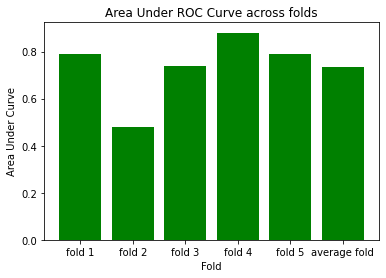

In [52]:
for seed in SEEDS:
    """ the only problem with this is that it's a basically 100 seed loop, which will take around 500 minutes of running"""
    np.random.seed(seed) # set seed 
    
    # first sort all of the folds 
    N = np.random.permutation(ARMFLAPPING_FRAMES.shape[0])
    ARMFLAPPING_FRAMES = ARMFLAPPING_FRAMES[N]
    CONTROL_FRAMES = CONTROL_FRAMES[N]

    # split them into 5 folds 
    ARMFLAPPING_FRAMES_SPLIT = np.array_split(ARMFLAPPING_FRAMES, 5)
    CONTROL_FRAMES_SPLIT = np.array_split(CONTROL_FRAMES, 5)

    # then run them 5x 
    checkpoint = tf.keras.callbacks.ModelCheckpoint("best.h5", save_best_only=True, monitor = "val_accuracy")
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor = "val_accuracy", patience=10)
    cross_validate(make_model, epochs = 75, callbacks=[checkpoint, early_stopping]) 

In [53]:
with open("all_landmarks_hundred_seeds_results", 'wb') as f: 
    pickle.dump((META_RESULT_MATRIX, AVERAGE_AUROCS, AVERAGE_TPRS), f)

In [54]:
import pickle, numpy as np
with open("all_landmarks_hundred_seeds_results", 'rb') as f: 
 (META_RESULT_MATRIX, AVERAGE_AUROCS, AVERAGE_TPRS) = pickle.load(f)

In [61]:
META_RESULT_MATRIX = np.array(META_RESULT_MATRIX)
np.mean(META_RESULT_MATRIX, axis=0)

array([0.7974    , 0.82427261, 0.76515   , 0.79016187, 0.68      ,
       0.70331545, 0.65340001, 0.6665203 ])

In [62]:
for i in range(8): 
    print(np.mean(META_RESULT_MATRIX[:, i], axis=0), np.std(META_RESULT_MATRIX[:, i], axis=0))

0.7974000008106231 0.04148180388661237
0.8242726101875305 0.06254192219227882
0.7651499993801117 0.06840487996789042
0.79016187475284 0.04312999529741701
0.6799999994635582 0.09208691549166285
0.7033154502511024 0.11941966232126151
0.6534000050276518 0.14672572596167438
0.6665203006999109 0.1057620944349184


In [63]:
METRICS = []
for fold_results in np.array_split(META_RESULT_MATRIX, 100):
    METRICS.append(np.mean(fold_results, axis = 0)) 

METRICS = np.around(np.array(METRICS), 3)

print(f"training accuracy : {np.mean(METRICS[:, 0])} +/- {np.std(METRICS[:, 0])}")
print(f"training precision : {np.mean(METRICS[:, 1])} +/- {np.std(METRICS[:, 1])}")
print(f"training recall : {np.mean(METRICS[:, 2])} +/- {np.std(METRICS[:, 2])}")
print(f"training f1 : {np.mean(METRICS[:, 3])} +/- {np.std(METRICS[:, 3])}")
print(f"validation accuracy : {np.mean(METRICS[:, 4])} +/- {np.std(METRICS[:, 4])}")
print(f"validation precision : {np.mean(METRICS[:, 5])} +/- {np.std(METRICS[:, 5])}")
print(f"validation recall : {np.mean(METRICS[:, 6])} +/- {np.std(METRICS[:, 6])}")
print(f"validation f1 : {np.mean(METRICS[:, 7])} +/- {np.std(METRICS[:, 7])}")

training accuracy : 0.79745 +/- 0.016492043536202525
training precision : 0.8243 +/- 0.026738174956417633
training recall : 0.7651500000000001 +/- 0.02985343363836061
training f1 : 0.7901700000000002 +/- 0.017332659922816226
validation accuracy : 0.6800000000000002 +/- 0.02660826939130012
validation precision : 0.7033300000000001 +/- 0.036492480047264526
validation recall : 0.6534 +/- 0.049884266056543315
validation f1 : 0.66646 +/- 0.033536374282262534


In [14]:
# create plots of evreything 

training_acc = np.mean(META_RESULT_MATRIX[:, 0], axis=0)

labels = ['Accuracy', "Precision", "Recall", "F1"]

x = np.arange(len(labels))  # the label locations
width = 0.4  # the width of the bars

fig, ax = plt.subplots()
fig.set_size_inches(7, 6)
rects1 = ax.bar(x - width/2, [training_acc, training_precision, training_recall, training_f1], width, label='Training', color = "tab:blue")
rects2 = ax.bar(x + width/2, [validation_acc, validation_precision, validation_recall, validation_f1], width, label='Validation', color="tab:green")

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Metric')
if FOLD_NUMBER != 5: 
    ax.set_title(f"Training vs. Testing Metrics: Fold {FOLD_NUMBER + 1} (No Aug)")
else: 
    ax.set_title("Training vs. Testing Metrics All Folds (No Aug)")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend(loc="upper right")

array([[0.80000001, 0.80000001, 0.80000001, 0.80000001, 0.60000002,
        0.60000002, 0.60000002, 0.60000002],
       [0.77499998, 0.76190478, 0.80000001, 0.78048782, 0.64999998,
        0.66666669, 0.60000002, 0.63157897],
       [0.75      , 0.72727275, 0.80000001, 0.76190478, 0.69999999,
        0.69999999, 0.69999999, 0.69999999],
       [0.85000002, 0.8888889 , 0.80000001, 0.84210527, 0.69999999,
        0.69999999, 0.69999999, 0.69999999],
       [0.72500002, 0.72500002, 0.72500002, 0.72500002, 0.85000002,
        0.81818181, 0.89999998, 0.85714284]])

0.7636873058008137


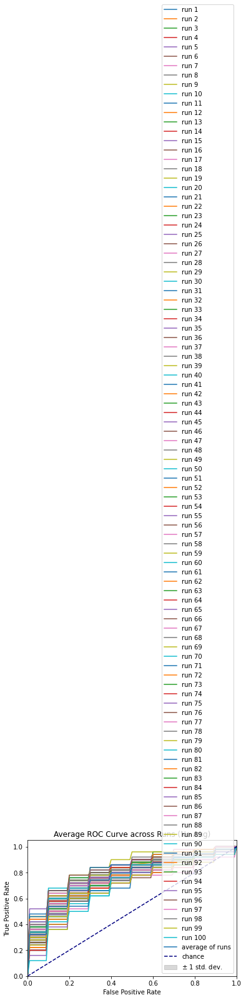

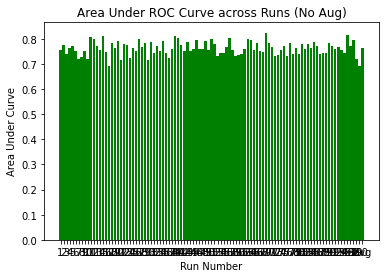

In [39]:
# REEE RUN THIS STUFF 
plot_meta_roc_auroc(AVERAGE_AUROCS, AVERAGE_TPRS, np.linspace(0, 1, 101)) # save the images here 

In [40]:
np.mean(AVERAGE_AUROCS), np.std(AVERAGE_AUROCS)

(0.76189, 0.026550118867552906)

In [41]:
def interpret(metrics_string):
     metrics = []
     for i in range(len(metrics_string)):
         try:
             index = metrics_string.index(":")
             metrics.append(metrics_string[index + 2 : index + 8])
             metrics_string = metrics_string[index + 9:]
         except Exception as e:
             return [float(m) for m in metrics][1:]

In [42]:
METRICS = [] # training acc, training pres, training recall, validation acc, validation pres, validation recall 

# for all of the 50 runs have a (50, 6 + 2) matrix, and then use that to store data and compute scores 
import numpy as np
meta_results = []
meta_results.append("3/3 [==============================] - 0s 143ms/step - loss: 0.5490 - accuracy: 0.7625 - precision_127: 0.7692 - recall_127: 0.7500 - val_loss: 0.6196 - val_accuracy: 0.7000 - val_precision_127: 0.6429 - val_recall_127: 0.9000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.5468 - accuracy: 0.7500 - precision_128: 0.7381 - recall_128: 0.7750 - val_loss: 0.4929 - val_accuracy: 0.7500 - val_precision_128: 0.7778 - val_recall_128: 0.7000")
meta_results.append("3/3 [==============================] - 0s 148ms/step - loss: 0.5195 - accuracy: 0.7875 - precision_129: 0.8485 - recall_129: 0.7000 - val_loss: 0.6768 - val_accuracy: 0.6500 - val_precision_129: 0.7143 - val_recall_129: 0.5000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5528 - accuracy: 0.7375 - precision_130: 0.8800 - recall_130: 0.5500 - val_loss: 0.6188 - val_accuracy: 0.7000 - val_precision_130: 0.7500 - val_recall_130: 0.6000")
meta_results.append("3/3 [==============================] - 0s 136ms/step - loss: 0.5276 - accuracy: 0.7500 - precision_131: 0.7500 - recall_131: 0.7500 - val_loss: 0.5546 - val_accuracy: 0.7500 - val_precision_131: 0.7778 - val_recall_131: 0.7000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.3641 - accuracy: 0.8250 - precision_133: 0.9333 - recall_133: 0.7000 - val_loss: 0.8364 - val_accuracy: 0.7000 - val_precision_133: 0.6429 - val_recall_133: 0.9000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.5302 - accuracy: 0.7750 - precision_134: 0.7750 - recall_134: 0.7750 - val_loss: 0.5209 - val_accuracy: 0.8000 - val_precision_134: 0.8000 - val_recall_134: 0.8000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5198 - accuracy: 0.7375 - precision_135: 0.7209 - recall_135: 0.7750 - val_loss: 0.6696 - val_accuracy: 0.5500 - val_precision_135: 0.5714 - val_recall_135: 0.4000")
meta_results.append('3/3 [==============================] - 0s 142ms/step - loss: 0.5037 - accuracy: 0.7875 - precision_136: 0.8108 - recall_136: 0.7500 - val_loss: 0.5018 - val_accuracy: 0.7500 - val_precision_136: 0.7273 - val_recall_136: 0.8000')
meta_results.append("3/3 [==============================] - 0s 128ms/step - loss: 0.6638 - accuracy: 0.6000 - precision_137: 0.6053 - recall_137: 0.5750 - val_loss: 0.6271 - val_accuracy: 0.6000 - val_precision_137: 0.6250 - val_recall_137: 0.5000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4704 - accuracy: 0.7875 - precision_139: 0.8485 - recall_139: 0.7000 - val_loss: 0.6656 - val_accuracy: 0.7000 - val_precision_139: 0.6667 - val_recall_139: 0.8000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.6160 - accuracy: 0.6500 - precision_140: 0.6875 - recall_140: 0.5500 - val_loss: 0.5326 - val_accuracy: 0.8500 - val_precision_140: 0.8182 - val_recall_140: 0.9000")
meta_results.append("3/3 [==============================] - 0s 134ms/step - loss: 0.4795 - accuracy: 0.7625 - precision_141: 0.7838 - recall_141: 0.7250 - val_loss: 0.7107 - val_accuracy: 0.6500 - val_precision_141: 0.8000 - val_recall_141: 0.4000")
meta_results.append("3/3 [==============================] - 0s 121ms/step - loss: 0.5433 - accuracy: 0.7375 - precision_142: 0.9130 - recall_142: 0.5250 - val_loss: 0.5958 - val_accuracy: 0.7000 - val_precision_142: 0.7000 - val_recall_142: 0.7000")
meta_results.append("3/3 [==============================] - 0s 181ms/step - loss: 0.4387 - accuracy: 0.8375 - precision_143: 0.9091 - recall_143: 0.7500 - val_loss: 0.8756 - val_accuracy: 0.7000 - val_precision_143: 0.6429 - val_recall_143: 0.9000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.5071 - accuracy: 0.7750 - precision_145: 0.8235 - recall_145: 0.7000 - val_loss: 0.6108 - val_accuracy: 0.7000 - val_precision_145: 0.6429 - val_recall_145: 0.9000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.4103 - accuracy: 0.7875 - precision_146: 0.7674 - recall_146: 0.8250 - val_loss: 0.6352 - val_accuracy: 0.7500 - val_precision_146: 0.7273 - val_recall_146: 0.8000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5201 - accuracy: 0.7375 - precision_147: 0.8065 - recall_147: 0.6250 - val_loss: 0.7552 - val_accuracy: 0.5500 - val_precision_147: 0.6000 - val_recall_147: 0.3000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4809 - accuracy: 0.7750 - precision_148: 0.7750 - recall_148: 0.7750 - val_loss: 0.5301 - val_accuracy: 0.7500 - val_precision_148: 0.7273 - val_recall_148: 0.8000")
meta_results.append("3/3 [==============================] - 0s 135ms/step - loss: 0.6238 - accuracy: 0.7250 - precision_149: 0.6957 - recall_149: 0.8000 - val_loss: 0.5609 - val_accuracy: 0.7000 - val_precision_149: 0.7500 - val_recall_149: 0.6000")
meta_results.append("3/3 [==============================] - 0s 147ms/step - loss: 0.4444 - accuracy: 0.8125 - precision_151: 0.8571 - recall_151: 0.7500 - val_loss: 0.6537 - val_accuracy: 0.7000 - val_precision_151: 0.6667 - val_recall_151: 0.8000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.4550 - accuracy: 0.8000 - precision_152: 0.7500 - recall_152: 0.9000 - val_loss: 0.6105 - val_accuracy: 0.7500 - val_precision_152: 0.7778 - val_recall_152: 0.7000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.4810 - accuracy: 0.7625 - precision_153: 0.8000 - recall_153: 0.7000 - val_loss: 0.6956 - val_accuracy: 0.6500 - val_precision_153: 0.7143 - val_recall_153: 0.5000")
meta_results.append("3/3 [==============================] - 0s 135ms/step - loss: 0.4951 - accuracy: 0.7625 - precision_154: 0.7692 - recall_154: 0.7500 - val_loss: 0.5621 - val_accuracy: 0.7500 - val_precision_154: 0.7273 - val_recall_154: 0.8000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4192 - accuracy: 0.8250 - precision_155: 0.8421 - recall_155: 0.8000 - val_loss: 0.5144 - val_accuracy: 0.7500 - val_precision_155: 0.7778 - val_recall_155: 0.7000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.5146 - accuracy: 0.7375 - precision_157: 0.7568 - recall_157: 0.7000 - val_loss: 0.6470 - val_accuracy: 0.7000 - val_precision_157: 0.6429 - val_recall_157: 0.9000")
meta_results.append("3/3 [==============================] - 0s 136ms/step - loss: 0.5297 - accuracy: 0.7750 - precision_158: 0.7895 - recall_158: 0.7500 - val_loss: 0.5801 - val_accuracy: 0.7500 - val_precision_158: 0.7778 - val_recall_158: 0.7000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4522 - accuracy: 0.7750 - precision_159: 0.8056 - recall_159: 0.7250 - val_loss: 0.6115 - val_accuracy: 0.6000 - val_precision_159: 0.7500 - val_recall_159: 0.3000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.5559 - accuracy: 0.7250 - precision_160: 0.6957 - recall_160: 0.8000 - val_loss: 0.5596 - val_accuracy: 0.7000 - val_precision_160: 0.6667 - val_recall_160: 0.8000")
meta_results.append("3/3 [==============================] - 0s 175ms/step - loss: 0.5519 - accuracy: 0.7750 - precision_161: 0.8438 - recall_161: 0.6750 - val_loss: 0.5466 - val_accuracy: 0.6500 - val_precision_161: 0.7143 - val_recall_161: 0.5000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4980 - accuracy: 0.7750 - precision_163: 0.8235 - recall_163: 0.7000 - val_loss: 0.6757 - val_accuracy: 0.6500 - val_precision_163: 0.6154 - val_recall_163: 0.8000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4898 - accuracy: 0.7750 - precision_164: 0.7895 - recall_164: 0.7500 - val_loss: 0.6056 - val_accuracy: 0.7000 - val_precision_164: 0.7000 - val_recall_164: 0.7000")
meta_results.append("3/3 [==============================] - 0s 181ms/step - loss: 0.5320 - accuracy: 0.7375 - precision_165: 0.7209 - recall_165: 0.7750 - val_loss: 0.7340 - val_accuracy: 0.6500 - val_precision_165: 0.6364 - val_recall_165: 0.7000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.4484 - accuracy: 0.7750 - precision_166: 0.7895 - recall_166: 0.7500 - val_loss: 0.5302 - val_accuracy: 0.7500 - val_precision_166: 0.7273 - val_recall_166: 0.8000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.6792 - accuracy: 0.6750 - precision_167: 0.6522 - recall_167: 0.7500 - val_loss: 0.6917 - val_accuracy: 0.5500 - val_precision_167: 0.5556 - val_recall_167: 0.5000")
meta_results.append("3/3 [==============================] - 0s 128ms/step - loss: 0.4365 - accuracy: 0.8125 - precision_169: 0.8788 - recall_169: 0.7250 - val_loss: 0.7150 - val_accuracy: 0.6500 - val_precision_169: 0.6364 - val_recall_169: 0.7000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.5207 - accuracy: 0.7750 - precision_170: 0.7750 - recall_170: 0.7750 - val_loss: 0.5656 - val_accuracy: 0.7500 - val_precision_170: 0.7778 - val_recall_170: 0.7000")
meta_results.append("3/3 [==============================] - 0s 131ms/step - loss: 0.4846 - accuracy: 0.7625 - precision_171: 0.7692 - recall_171: 0.7500 - val_loss: 0.7023 - val_accuracy: 0.6500 - val_precision_171: 0.6667 - val_recall_171: 0.6000")
meta_results.append("3/3 [==============================] - 0s 129ms/step - loss: 0.4192 - accuracy: 0.8250 - precision_172: 0.8824 - recall_172: 0.7500 - val_loss: 0.8445 - val_accuracy: 0.7000 - val_precision_172: 0.7500 - val_recall_172: 0.6000")
meta_results.append("3/3 [==============================] - 0s 125ms/step - loss: 0.6846 - accuracy: 0.5750 - precision_173: 0.5682 - recall_173: 0.6250 - val_loss: 0.6460 - val_accuracy: 0.6000 - val_precision_173: 0.6250 - val_recall_173: 0.5000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.4731 - accuracy: 0.7625 - precision_175: 0.7838 - recall_175: 0.7250 - val_loss: 0.6003 - val_accuracy: 0.7500 - val_precision_175: 0.6923 - val_recall_175: 0.9000")
meta_results.append("3/3 [==============================] - 0s 122ms/step - loss: 0.6343 - accuracy: 0.6875 - precision_176: 0.6744 - recall_176: 0.7250 - val_loss: 0.6167 - val_accuracy: 0.7000 - val_precision_176: 1.0000 - val_recall_176: 0.4000")
meta_results.append("3/3 [==============================] - 0s 126ms/step - loss: 0.6491 - accuracy: 0.5875 - precision_177: 0.6061 - recall_177: 0.5000 - val_loss: 0.6270 - val_accuracy: 0.6000 - val_precision_177: 1.0000 - val_recall_177: 0.2000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.4416 - accuracy: 0.8000 - precision_178: 0.8333 - recall_178: 0.7500 - val_loss: 0.6544 - val_accuracy: 0.6500 - val_precision_178: 0.7143 - val_recall_178: 0.5000")
meta_results.append("3/3 [==============================] - 0s 127ms/step - loss: 0.4658 - accuracy: 0.8125 - precision_179: 0.9032 - recall_179: 0.7000 - val_loss: 0.6116 - val_accuracy: 0.7500 - val_precision_179: 0.7778 - val_recall_179: 0.7000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.4735 - accuracy: 0.8000 - precision_181: 0.8750 - recall_181: 0.7000 - val_loss: 0.6479 - val_accuracy: 0.6500 - val_precision_181: 0.6667 - val_recall_181: 0.6000")
meta_results.append("3/3 [==============================] - 0s 153ms/step - loss: 0.5056 - accuracy: 0.7750 - precision_182: 0.7895 - recall_182: 0.7500 - val_loss: 0.4801 - val_accuracy: 0.7500 - val_precision_182: 0.7778 - val_recall_182: 0.7000")
meta_results.append("3/3 [==============================] - 0s 123ms/step - loss: 0.4631 - accuracy: 0.8000 - precision_183: 0.8000 - recall_183: 0.8000 - val_loss: 0.7841 - val_accuracy: 0.5000 - val_precision_183: 0.5000 - val_recall_183: 0.3000")
meta_results.append("3/3 [==============================] - 0s 129ms/step - loss: 0.4344 - accuracy: 0.8500 - precision_184: 0.8684 - recall_184: 0.8250 - val_loss: 0.6026 - val_accuracy: 0.7000 - val_precision_184: 0.6667 - val_recall_184: 0.8000")
meta_results.append("3/3 [==============================] - 0s 135ms/step - loss: 0.5167 - accuracy: 0.7375 - precision_185: 0.7111 - recall_185: 0.8000 - val_loss: 0.5716 - val_accuracy: 0.7000 - val_precision_185: 0.7500 - val_recall_185: 0.6000")

METRICS = [interpret(result) for result in meta_results]

In [43]:
METRICS = np.array(METRICS)

METRICS = np.delete(METRICS, obj=3, axis=1)
METRICS.shape

(50, 6)

In [44]:
train_acc = METRICS[:, 0]
train_pres = METRICS[:, 1]
train_recall = METRICS[:, 2]
val_acc = METRICS[:, 3]
val_pres = METRICS[:, 4]
val_recall = METRICS[:, 5]

print(f"training accuracy : {round(train_acc.mean(), 3)} ± {round(train_acc.std(), 3)}")
print(f"training precision : {round(train_pres.mean(), 3)} ± {round(train_pres.std(), 3)}")
print(f"training recall : {round(train_recall.mean(), 3)} ± {round(train_recall.std(), 3)}")
print(f"validation accuracy : {round(val_acc.mean(), 3)} ± {round(val_acc.std(), 3)}")
print(f"validation precision : {round(val_pres.mean(), 3)} ± {round(val_pres.std(), 3)}")
print(f"validation recall : {round(val_recall.mean(), 3)} ± {round(val_recall.std(), 3)}")


training accuracy : 0.759 ± 0.058
training precision : 0.785 ± 0.081
training recall : 0.725 ± 0.078
validation accuracy : 0.688 ± 0.068
validation precision : 0.711 ± 0.091
validation recall : 0.658 ± 0.181


In [45]:
def hmean(pres, recall):
    return 2 * pres * recall / (pres + recall)

train_f1 = hmean(train_pres, train_recall)
val_f1 = hmean(val_pres, val_recall)
print(f"training F1 : {round(train_f1.mean(), 3)} ± {round(train_f1.std(), 3)}")
print(f"validation F1 : {round(val_f1.mean(), 3)} ± {round(val_f1.std(), 3)}")

training F1 : 0.75 ± 0.06
validation F1 : 0.665 ± 0.115


In [46]:
METRICS_DICT = {i : [] for i in range(5)}

for i, metric in enumerate(METRICS): 
    METRICS_DICT[i % 5].append(metric)

for i, value in METRICS_DICT.items():
    METRICS_DICT[i] = np.array(METRICS_DICT[i])

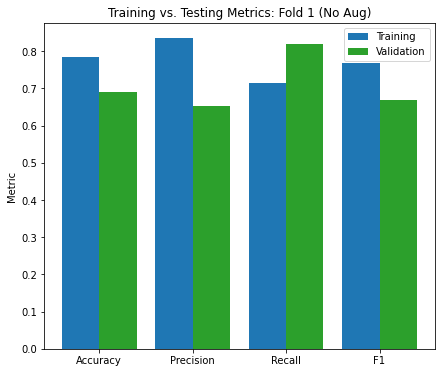

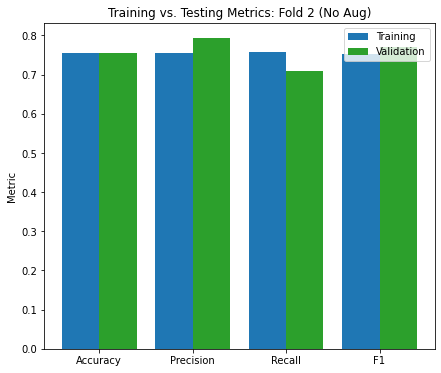

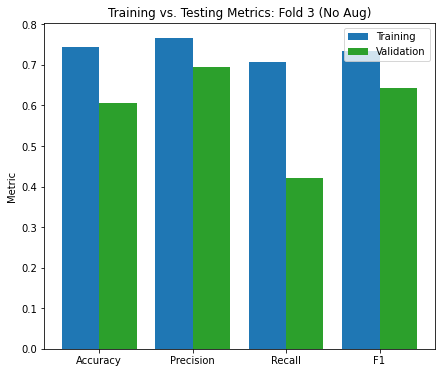

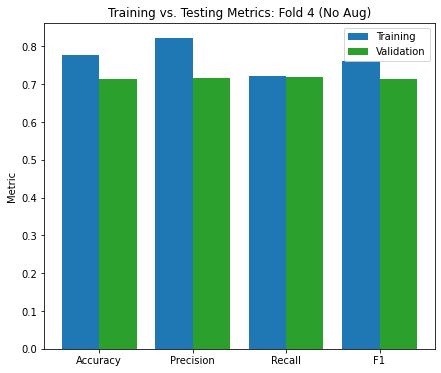

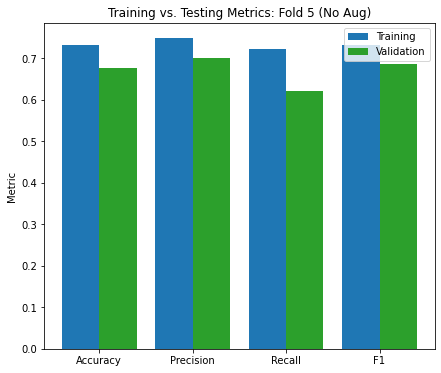

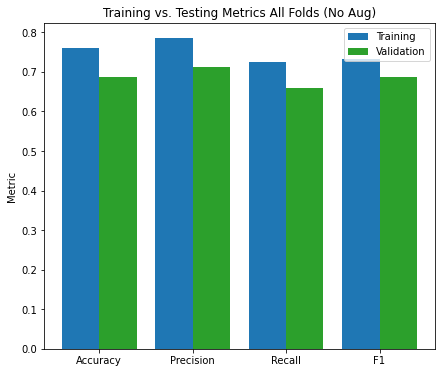

In [47]:
import matplotlib.pyplot as plt
import numpy as np

for FOLD_NUMBER in range(6): 
    
    if FOLD_NUMBER == 5: 
        training_acc = round(METRICS[:, 0].mean(), 3)
        training_precision = round(METRICS[:, 1].mean(), 3)
        training_recall = round(METRICS[:, 2].mean(), 3)
        validation_acc = round(METRICS[:, 3].mean(), 3)
        validation_precision = round(METRICS[:, 4].mean(), 3)
        validation_recall = round(METRICS[:, 5].mean(), 3)

        train_f1 = hmean(training_precision, train_recall)
        val_f1 = hmean(validation_precision, validation_recall)
    
    else : 
        metrics = METRICS_DICT[FOLD_NUMBER]
        training_acc = round(metrics[:, 0].mean(), 3)
        training_precision = round(metrics[:, 1].mean(), 3)
        training_recall = round(metrics[:, 2].mean(), 3)
        validation_acc = round(metrics[:, 3].mean(), 3)
        validation_precision = round(metrics[:, 4].mean(), 3)
        validation_recall = round(metrics[:, 5].mean(), 3)


        training_f1 = hmean(metrics[:, 1], metrics[:, 2]).mean()
        validation_f1 = hmean(metrics[:, 3], metrics[:, 4]).mean()

    labels = ['Accuracy', "Precision", "Recall", "F1"]

    x = np.arange(len(labels))  # the label locations
    width = 0.4  # the width of the bars

    fig, ax = plt.subplots()
    fig.set_size_inches(7, 6)
    rects1 = ax.bar(x - width/2, [training_acc, training_precision, training_recall, training_f1], width, label='Training', color = "tab:blue")
    rects2 = ax.bar(x + width/2, [validation_acc, validation_precision, validation_recall, validation_f1], width, label='Validation', color="tab:green")

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_ylabel('Metric')
    if FOLD_NUMBER != 5: 
        ax.set_title(f"Training vs. Testing Metrics: Fold {FOLD_NUMBER + 1} (No Aug)")
    else: 
        ax.set_title("Training vs. Testing Metrics All Folds (No Aug)")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.legend(loc="upper right")

    #ax.bar_label(rects1, padding=3)
    #ax.bar_label(rects2, padding=3)

    if FOLD_NUMBER != 5 : 
        plt.savefig(f"balanced_plots/train_vs_test_{FOLD_NUMBER + 1}_naug.png")

    else: 
        plt.savefig("balanced_plots/train_vs_test_all_naug.png")
    plt.show()